# Transfomer(年齢予測)

## import ライブラリー

In [1]:
"""%%bash
python3 -m pip install --user torch
python3 -m pip install --user scikit-learn"""

'%%bash\npython3 -m pip install --user torch\npython3 -m pip install --user scikit-learn'

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold

from scipy.stats import pearsonr
from scipy.stats import norm

import torch
import torch.nn as nn

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.cuda.device_count()
#torch.set_default_tensor_type('torch.cuda.FloatTensor')

1

In [3]:
device

device(type='cuda')

## Data定義

In [4]:
%%time
#6分ぐらいかかる
df_aal = pd.read_csv('../02_data_analysis/roi_timeseries/timeseries_aal.csv')
df_ho = pd.read_csv('../02_data_analysis/roi_timeseries/timeseries_ho.csv')

#df_dynamic_aal = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_aal.csv')
#df_dynamic_ho = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_ho.csv')

df_subjects_info = pd.read_csv('../02_data_analysis/subjects_info/subjects_info.csv')

CPU times: user 3.18 s, sys: 201 ms, total: 3.39 s
Wall time: 3.39 s


In [5]:
def make_info_data(df = df_subjects_info,col = ['Age','Sex','やる気スコア(Apathy scale)']):
    subID = np.array(df.subID)
    subjects_info_list = []
    for ID in subID:
        data = np.array(df[df.subID == ID][col])[0]
        if 'Sex' in col:
            idx_sex = col.index('Sex')
            if data[idx_sex] == '男':
                data[idx_sex] = 0
            else:
                data[idx_sex] = 1
        
        subjects_info_list.append(data)
    subjects_info = np.array(subjects_info_list)
    
    if 'Age' in col:
        idx_age = col.index('Age')
    for i in range(len(col)):
        if i == idx_age:
            subjects_info[:,i] = (subjects_info[:,i] - \
                                  np.mean(subjects_info[:,i]))/np.std(subjects_info[:,i])
    return subjects_info.astype(np.float)

def make_data(df, subID = df_subjects_info.subID ,remove_list = ['time','subID']):
    data_list = []
    df_cols = list(df.columns)
    for r in remove_list:
        try:
            df_cols.remove(r)
        except:
            pass
    for ID in df_subjects_info.subID:
        data = df[df.subID == ID][df_cols]
        data = np.array(data)
        data_list.append(data)
    data = np.array(data_list)
    return data

In [6]:
%%time
data_label = make_info_data()
data_aal = make_data(df_aal)
data_ho = make_data(df_ho)

age_mean = df_subjects_info.Age.mean()
age_std = df_subjects_info.Age.std()

CPU times: user 10.1 s, sys: 29.6 ms, total: 10.1 s
Wall time: 10.1 s


In [7]:
data_label.shape
data_aal.shape
data_ho.shape

(615, 3)

(615, 140, 116)

(615, 140, 110)

In [8]:
#30秒ぐらいかかる
#data_dynamic_aal = make_data(df_dynamic_aal)
#data_dynamic_ho = make_data(df_dynamic_ho)

#data_dynamic_aal.shape
#data_dynamic_ho.shape

## Model作成

In [9]:
import math
class PositionalEncoding(nn.Module):

    def __init__(self, d_model: int, dropout: float = 0.1, max_len: int = 5000):
        super(PositionalEncoding, self).__init__()
        
        self.dropout = nn.Dropout(p=dropout)
        # Not a parameter
        self.register_buffer('pe', self._pe_table(d_model, max_len))

    def _pe_table(self, d_model: int, max_len: int) -> torch.Tensor:
        pos = torch.arange(0, max_len).unsqueeze(1)
        pe_denominator = torch.exp(
            torch.arange(0, d_model, 2) * math.log(10000) / d_model
        )

        pe = torch.zeros(max_len, d_model)
        pe[:, 0::2] = torch.sin(pos / pe_denominator)  # 偶数項にはsin
        pe[:, 1::2] = torch.cos(pos / pe_denominator)  # 奇数項にはcos

        pe = pe.unsqueeze(0)  # バッチに対応するため
        return pe

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.dropout(x + self.pe[:, :x.size(1)].clone().detach())

In [10]:
class Model(nn.Module):    
    def __init__(self,
                 input_dim,
                 d_model,
                 hidden_dim,
                 time_len,
                 nhead,
                 output_dim,
                 hidden_dim_transformer,
                 pos_drop,
                 trans_drop,
                 fc_drop
                ):
        super(Model, self).__init__()
        self.fc0  = nn.Linear(input_dim,d_model)
        self.pos  = PositionalEncoding(d_model = d_model,dropout=pos_drop)
        self.transformer_encoder_layer = nn.TransformerEncoderLayer(d_model,
                                                                    nhead,
                                                                    dropout=trans_drop,
                                                                    dim_feedforward=hidden_dim,
                                                                    batch_first=True)
        self.transformer_encoder       = nn.TransformerEncoder(self.transformer_encoder_layer,
                                                               num_layers=hidden_dim_transformer)
        self.fc_age1  = nn.Linear(d_model,1)
        self.fc_sex1  = nn.Linear(d_model,1)
        self.fc_age2  = nn.Linear(time_len,1)
        self.fc_sex2  = nn.Linear(time_len,1)
        self.drop  = nn.Dropout(fc_drop)
        self.time_len = time_len
        self.sigmoid = nn.Sigmoid()
        
    def forward(self,x):
        x = self.fc0(x)
        x = self.pos(x)
        x = self.transformer_encoder(x)
        age = self.fc_age1(x)
        sex = self.fc_sex1(x)
        
        age = self.drop(age)
        sex = self.drop(sex)
        
        age = torch.reshape(age, (-1, self.time_len))
        sex = torch.reshape(sex, (-1, self.time_len))
        
        age = self.fc_age2(age)
        sex = self.fc_sex2(sex)
        sex = self.sigmoid(sex)
        return age,sex

In [11]:
class MyDataset(torch.utils.data.Dataset):
    def __init__(self, data, label=None):
        self.data = data
        self.label = label
        self.test = label is None
        self.length = data.shape[0]
    def __len__(self):
        return self.length
    def __getitem__(self,idx):
        if self.test:
            data = torch.tensor(self.data[idx])
            return data
        else:
            data = torch.tensor(self.data[idx])
            label = torch.tensor(self.label[idx])
            return data, label

In [12]:
def compute_loss_age(y, t):
    criterion = nn.MSELoss()
    return criterion(y, t)

def compute_loss_sex(y, t):
    criterion = nn.BCELoss()
    return criterion(y, t)

def train_step(x,t,model,optimizer):
    model.train()
    preds_age,preds_sex = model(x)
    age = t[:,0:1]
    sex = t[:,1:]
    loss_age = compute_loss_age(preds_age, age)
    loss_sex = compute_loss_sex(preds_sex, sex)
    loss = (4/5) * loss_age + (1/5) * loss_sex

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return loss, preds_age, preds_sex

def val_step(x,t,model):
    model.eval()
    preds_age,preds_sex = model(x)
    age = t[:,0:1]
    sex = t[:,1:]
    loss_age = compute_loss_age(preds_age, age)
    loss_sex = compute_loss_sex(preds_sex, sex)
    loss = loss_age
    
    return loss, preds_age, preds_sex

def test_step(x,model):
    model.eval()
    preds_age,preds_sex = model(x)
    return preds_age, preds_sex

def seed_worker(seed=0):
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [13]:
class EarlyStopping:
    '''
    早期終了 (early stopping)
    '''
    def __init__(self, patience=0, verbose=0, mode='loss'):
        self._step = 0
        self.patience = patience
        self.verbose = verbose
        
        self.mode = mode
        
        if self.mode == 'loss':
            self._loss = float('inf')
        elif self.mode == 'score':
            self._score = 0.
        else:
            raise Exception('error')

    def __call__(self, value):
        if self.mode == 'loss':
            if self._loss < value:
                self._step += 1
                if self._step > self.patience:
                    if self.verbose:
                        print('early stopping')
                    return True
            else:
                self._step = 0
                self._loss = value

            return False
        
        elif self.mode == 'score':
            if self._score > value:
                self._step += 1
                if self._step > self.patience:
                    if self.verbose:
                        print('early stopping')
                    return True
            else:
                self._step = 0
                self._score = value

            return False

In [14]:
def train_model(data,
                label,
                train_idx,
                test_idx,
                n_splits,
                epochs     = 750,
                d_model    = 128,
                hidden_dim = 512,
                nhead      = 32,
                hidden_dim_transformer = 2,
                pos_drop    = 0.1,
                trans_drop = 0.1,
                fc_drop = 0.1,
                title = ''
                ):
    
    epochs = epochs
    seed_worker()
    label = label[:,0:2]

    train_all = data[train_idx]
    test  = data[test_idx]
    
    train_label_all = label[train_idx]
    test_label  = label[test_idx]
    
    input_dim  = data.shape[2]
    time_len   = data.shape[1]
    output_dim = data_label.shape[1]
    d_model    = d_model
    hidden_dim = hidden_dim
    nhead      = nhead
    hidden_dim_transformer = hidden_dim_transformer
    pos_drop    = pos_drop
    trans_drop = trans_drop
    fc_drop = fc_drop
    
    test_dataset = MyDataset(test)
    test_dataloader = torch.utils.data.DataLoader(test_dataset,batch_size=32)
    
    kf = KFold(n_splits=n_splits,shuffle=False)
    test_pred_all = []
    test_pred_all_corrected = []
    
    model_path = '../02_data_analysis/model/model_.pth'
    if torch.cuda.device_count() > 1:
        batch_size = 32 * torch.cuda.device_count()
    else:
        batch_size = 32

    for n_fold, (train_index, val_index) in enumerate(kf.split(train_all)):
        save_epochs = 0
        
        train_loss_plot = []
        val_loss_plot = []
        
        train, train_label = train_all[train_index], train_label_all[train_index]
        val,   val_label   = train_all[val_index],   train_label_all[val_index]
        
        train_dataset    = MyDataset(train,train_label)
        train_dataloader = torch.utils.data.DataLoader(train_dataset,batch_size=batch_size,shuffle=True)

        val_dataset      = MyDataset(val,val_label)
        val_dataloader   = torch.utils.data.DataLoader(val_dataset,batch_size=batch_size)
        
        model = Model(input_dim = input_dim,
                      d_model  = d_model,
                      hidden_dim = hidden_dim,
                      time_len = time_len,
                      nhead = nhead,
                      output_dim = output_dim,
                      hidden_dim_transformer = hidden_dim_transformer,
                      pos_drop = pos_drop,
                      trans_drop = trans_drop,
                      fc_drop = fc_drop
                     )
        
        if torch.cuda.device_count() > 1:
            print("Let's use", torch.cuda.device_count(), "GPUs!")
            # dim = 0 [30, xxx] -> [10, ...], [10, ...], [10, ...] on 3 GPUs
            model = nn.DataParallel(model)

        model.to(device)
        
        optimizer = torch.optim.AdamW(model.parameters(),lr=1e-4)
        
        es = EarlyStopping(patience=200, verbose=1, mode='loss')
        best_val_loss = 1e5
        
        for epoch in range(epochs):
            train_loss = 0.
            val_loss = 0.

            for (x, t) in train_dataloader:
                x, t = x.to(device), t.to(device)
                x = x.float()
                t = t.float()
                loss, preds_age, preds_sex = train_step(x,t,model,optimizer)
                train_loss += loss.item()
            train_loss /= len(train_dataloader)
            
            for (x, t) in val_dataloader:
                x, t = x.to(device), t.to(device)
                x = x.float()
                t = t.float()
                loss, preds_age, preds_sex = val_step(x,t,model)
                val_loss += loss.item()
            val_loss /= len(val_dataloader)
            
            if (epoch+1) % 100 == 0:
                print(f'Kfold: {n_fold+1} ::: epoch: {epoch+1}, loss: {train_loss}, val loss: {val_loss}')
                
            #early stopping
            if epoch <=200:
                pass
            elif es(val_loss):
                break

            # modelの保存
            if epoch <=200:
                pass
            elif val_loss < best_val_loss:
                save_epochs = epoch+1
                best_val_loss = val_loss
                torch.save(model.state_dict(), model_path)
        
            train_loss_plot.append(train_loss)
            val_loss_plot.append(val_loss)
        
        model.load_state_dict(torch.load(model_path))
        print(f'save_epochs:{save_epochs}')
        print(f'best val loss:{best_val_loss}')
        
        train_loss_plot = np.array(train_loss_plot)
        val_loss_plot   = np.array(val_loss_plot)
        x               = np.linspace(0, len(train_loss_plot), len(train_loss_plot))
        
        plt.figure(figsize=(6, 4), dpi=80)
        plt.plot(x, train_loss_plot, label="train loss")
        plt.plot(x, val_loss_plot, label="val loss")
        plt.title('Loss Curves' + ' ' + title, fontsize=14)   # 図のタイトル
        plt.xlabel('Epochs',fontsize=14) # x軸のラベル
        plt.ylabel('MSELoss',fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()

        train_pred_age = []
        train_pred_sex = []
        train_label = []
        
        for (x, t) in train_dataloader:
            x, t = x.to(device), t.to(device)
            x = x.float()
            t = t.float()
            loss, preds_age, preds_sex= val_step(x,t,model)
            train_pred_age.append(preds_age)
            train_pred_sex.append(preds_sex)
            train_label.append(t)
        
        val_pred_age = []
        val_pred_sex = []
        for (x, t) in val_dataloader:
            x, t = x.to(device), t.to(device)
            x = x.float()
            t = t.float()
            loss, preds_age, preds_sex= val_step(x,t,model)
            val_pred_age.append(preds_age)
            val_pred_sex.append(preds_sex)
        
        train_pred_age = torch.cat(train_pred_age)
        train_pred_age = train_pred_age.to('cpu').detach().numpy().copy()
        train_pred_sex = torch.cat(train_pred_sex)
        train_pred_sex = train_pred_sex.to('cpu').detach().numpy().copy()
        
        train_label = torch.cat(train_label)
        train_label = train_label.to('cpu').detach().numpy().copy()
        
        val_pred_age = torch.cat(val_pred_age)
        val_pred_age = val_pred_age.to('cpu').detach().numpy().copy()
        val_pred_sex = torch.cat(val_pred_sex)
        val_pred_sex = val_pred_sex.to('cpu').detach().numpy().copy()
        
        new_line = '\n'
        
        corr,p = pearsonr(train_label[:,0],np.array(train_pred_age[:,0]))
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter((train_label[:,0]*age_std)+age_mean,(np.array(train_pred_age[:,0])*age_std)+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'scatter train', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        print('r^2 train data: ', r2_score(train_label[:,0],np.array(train_pred_age[:,0])))
        
        corr,p = pearsonr(val_label[:,0],np.array(val_pred_age[:,0]))
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter((val_label[:,0]*age_std)+age_mean,(np.array(val_pred_age[:,0])*age_std)+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'scatter val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        print('r^2 val data: ', r2_score(val_label[:,0],np.array(val_pred_age[:,0])))
        
        acc = 0
        for i,c in enumerate(train_label[:,1]):
            if c == 1:
                if train_pred_sex[:,0][i] >= 0.5:
                    acc += 1
            else:
                if train_pred_sex[:,0][i] < 0.5:
                    acc += 1
        q = 1/2
        n = len(train_label[:,1])
        z = (acc - n*q)/np.sqrt(n*q*(1-q))
        p = norm.sf(z)
        acc = acc/len(train_label[:,1])
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(train_label[:,1],train_pred_sex[:,0],
                   label = f'train accuracy : {acc:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'sex train', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological sex', fontsize=14) # x軸のラベル
        plt.ylabel('predicted probability', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        
        acc = 0
        for i,c in enumerate(val_label[:,1]):
            if c == 1:
                if val_pred_sex[:,0][i] >= 0.5:
                    acc += 1
            else:
                if val_pred_sex[:,0][i] < 0.5:
                    acc += 1
        q = 1/2
        n = len(val_label[:,1])
        z = (acc - n*q)/np.sqrt(n*q*(1-q))
        p = norm.sf(z)
        acc = acc/len(val_label[:,1])
                    
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(val_label[:,1],val_pred_sex[:,0],
                   label = f'val accuracy : {acc:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'sex val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological sex', fontsize=14) # x軸のラベル
        plt.ylabel('predicted probability', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        
        lr = LinearRegression()
        lr.fit(val_label[:,0:1]*age_std+age_mean,val_pred_age[:,0]*age_std+age_mean)
        corr,p = pearsonr(val_label[:,0],np.array(val_pred_age[:,0]))
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(val_label[:,0]*age_std+age_mean,val_pred_age[:,0]*age_std+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')#散布図をプロット
        plt.plot(val_label[:,0]*age_std + age_mean,
                 lr.predict(val_label[:,0:1]*age_std+age_mean), color = 'red',#回帰直線をプロット
                label = f'y = {lr.coef_[0]:.3f}x + {lr.intercept_:.3f}')#回帰直線をプロット
        
        plt.title(title + ' ' + 'val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()  # グリッド線を表示
        plt.show()  # 図の表示
        print('切片:', lr.intercept_)
        print('傾き:', lr.coef_[0])
                
        test_pred_age = []
        test_pred_sex = []
        
        for x in test_dataloader:
            x = x.to(device)
            x = x.float()
            preds_age, preds_sex = test_step(x,model)
            test_pred_age.append(preds_age)
            test_pred_sex.append(preds_sex)
        test_pred_age = torch.cat(test_pred_age)
        test_pred_sex = torch.cat(test_pred_sex)
        test_pred_age = test_pred_age.to('cpu').detach().numpy().copy()
        test_pred_sex = test_pred_sex.to('cpu').detach().numpy().copy()
        test_pred_corrected = (test_pred - lr.intercept_/ lr.coef_[0])
        test_pred     = np.concatenate([test_pred_age, test_pred_sex],1)
        test_pred_corrected  = np.concatenate([test_pred_age_corrected, test_pred_sex],1)
        if lr.coef_[0] > 0.25:
            test_pred_all.append(test_pred)
            test_pred_all_corrected.append(test_pred_corrected)

    return np.array(test_pred_all),np.array(test_pred_all_corrected),test_label

In [15]:
n_splits = 5

## 学習(AAL)

### ROI 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.052147652953863144, val loss: 0.7839677631855011
Kfold: 1 ::: epoch: 200, loss: 0.018004542574859582, val loss: 0.7099004834890366
Kfold: 1 ::: epoch: 300, loss: 0.01630634470627858, val loss: 0.6540172547101974
Kfold: 1 ::: epoch: 400, loss: 0.009715935895935847, val loss: 0.6464081704616547
Kfold: 1 ::: epoch: 500, loss: 0.00921052791034946, val loss: 0.6382671892642975
Kfold: 1 ::: epoch: 600, loss: 0.007695638037358339, val loss: 0.6284864246845245
Kfold: 1 ::: epoch: 700, loss: 0.006781988275738863, val loss: 0.6012955829501152
Kfold: 1 ::: epoch: 800, loss: 0.0051866434693623046, val loss: 0.5951317548751831
Kfold: 1 ::: epoch: 900, loss: 0.004992812585372191, val loss: 0.5826121717691422
Kfold: 1 ::: epoch: 1000, loss: 0.004433112935378001, val loss: 0.5765621364116669
save_epochs:892
best val loss:0.5652597472071648


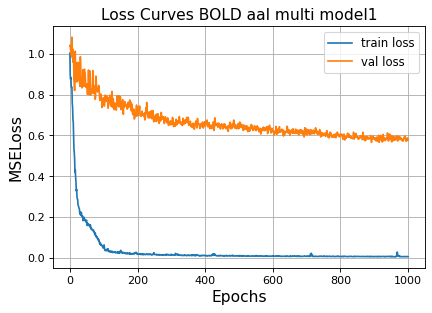

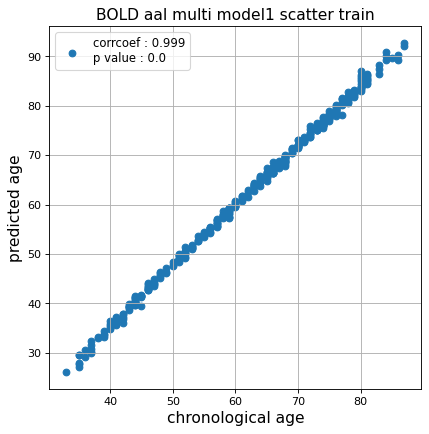

r^2 train data:  0.9495859296582095


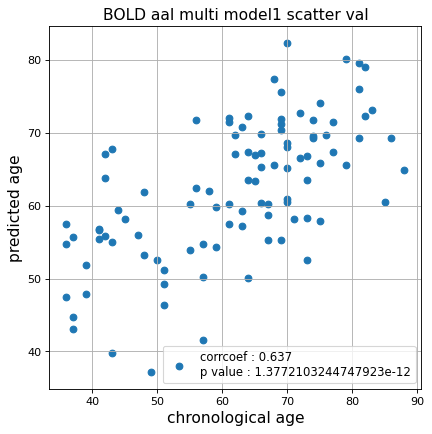

r^2 val data:  0.4031421087653605


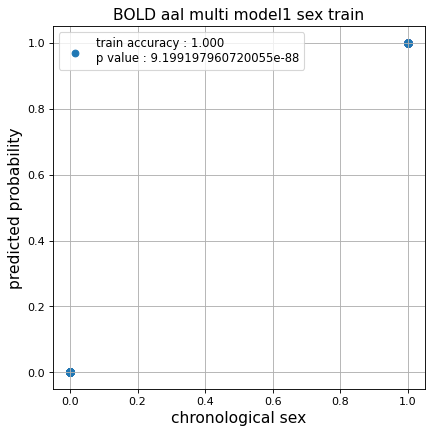

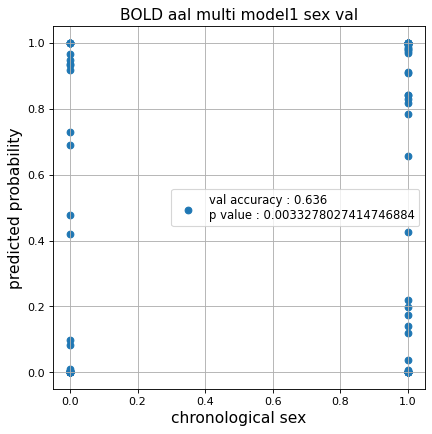

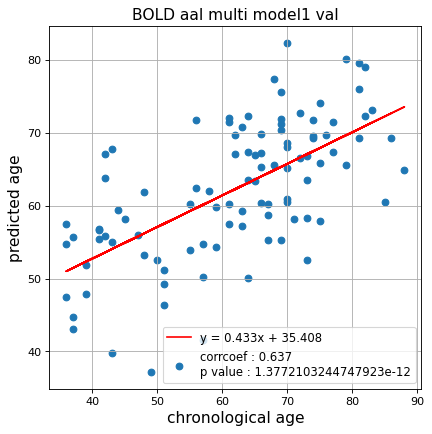

切片: 35.40780031625616
傾き: 0.43336085801489743
Kfold: 2 ::: epoch: 100, loss: 0.0450419052862204, val loss: 0.5839339047670364
Kfold: 2 ::: epoch: 200, loss: 0.016437009944079015, val loss: 0.5727737694978714
Kfold: 2 ::: epoch: 300, loss: 0.01164981171202201, val loss: 0.5413325503468513
Kfold: 2 ::: epoch: 400, loss: 0.010440002697018476, val loss: 0.5080101862549782
Kfold: 2 ::: epoch: 500, loss: 0.007372709994132702, val loss: 0.49091174453496933
Kfold: 2 ::: epoch: 600, loss: 0.008736010748319901, val loss: 0.49485352635383606
Kfold: 2 ::: epoch: 700, loss: 0.00682476506783412, val loss: 0.48399700969457626
Kfold: 2 ::: epoch: 800, loss: 0.006075387605680869, val loss: 0.44613153487443924
Kfold: 2 ::: epoch: 900, loss: 0.004903360180413494, val loss: 0.460991770029068
Kfold: 2 ::: epoch: 1000, loss: 0.004829451710415574, val loss: 0.47087885439395905
save_epochs:929
best val loss:0.4342184364795685


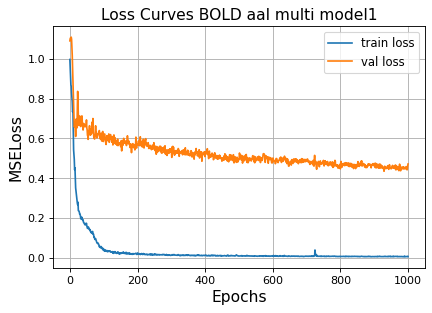

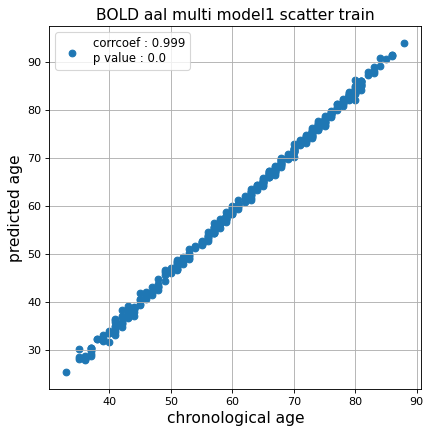

r^2 train data:  0.9290946035126859


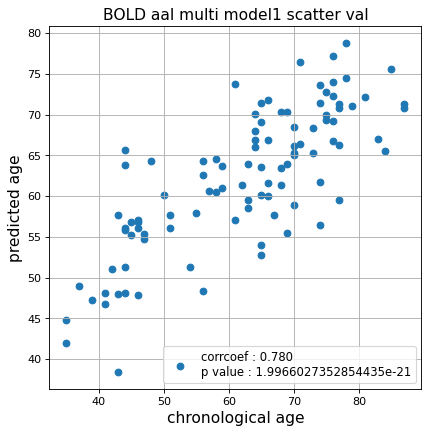

r^2 val data:  0.5870976061604789


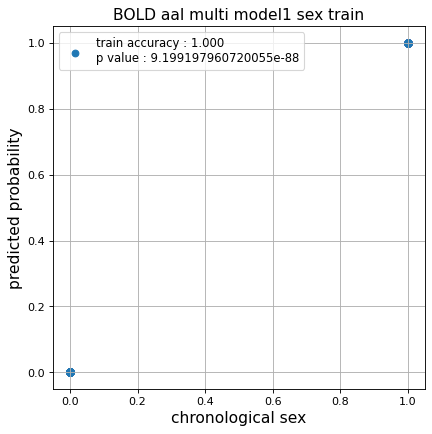

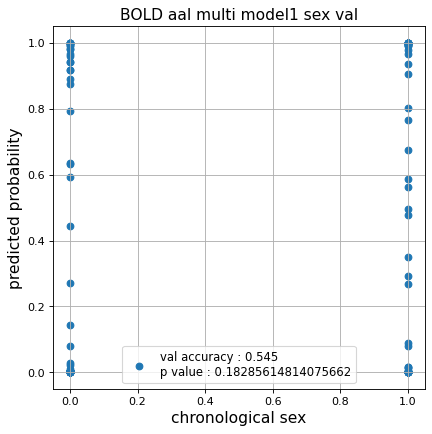

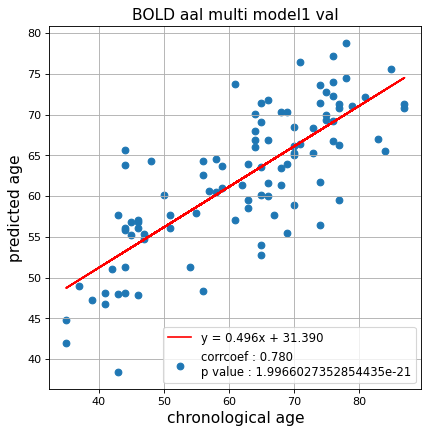

切片: 31.39021913925564
傾き: 0.49578704347117825
Kfold: 3 ::: epoch: 100, loss: 0.0353607704433111, val loss: 0.7016418725252151
Kfold: 3 ::: epoch: 200, loss: 0.020506506857390586, val loss: 0.6752138584852219
Kfold: 3 ::: epoch: 300, loss: 0.012148619951823583, val loss: 0.6705706864595413
Kfold: 3 ::: epoch: 400, loss: 0.009056286671413826, val loss: 0.7118255645036697
Kfold: 3 ::: epoch: 500, loss: 0.008857125774599038, val loss: 0.6436178833246231
Kfold: 3 ::: epoch: 600, loss: 0.006985679053916381, val loss: 0.6691433787345886
Kfold: 3 ::: epoch: 700, loss: 0.005211443246270602, val loss: 0.6320268958806992
Kfold: 3 ::: epoch: 800, loss: 0.004923161459513581, val loss: 0.6097036004066467
early stopping
save_epochs:669
best val loss:0.6051651984453201


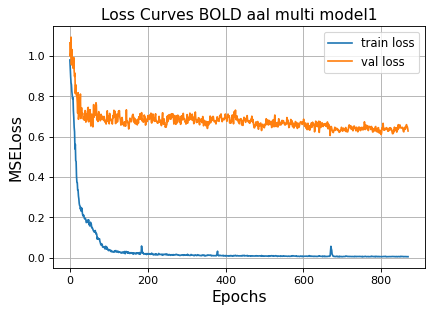

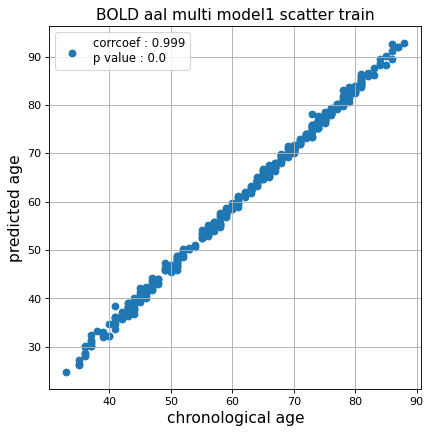

r^2 train data:  0.9385427654722988


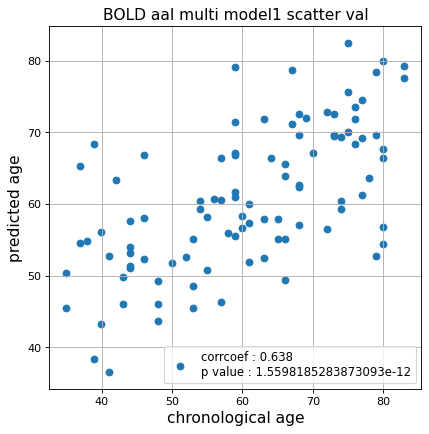

r^2 val data:  0.3968077601098593


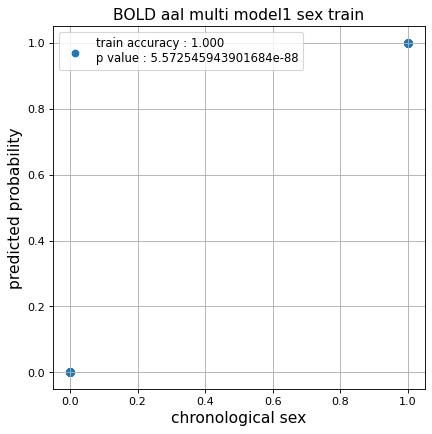

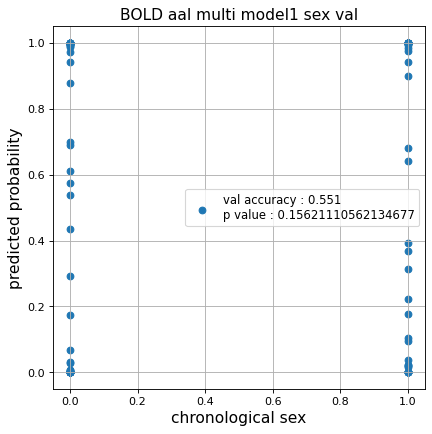

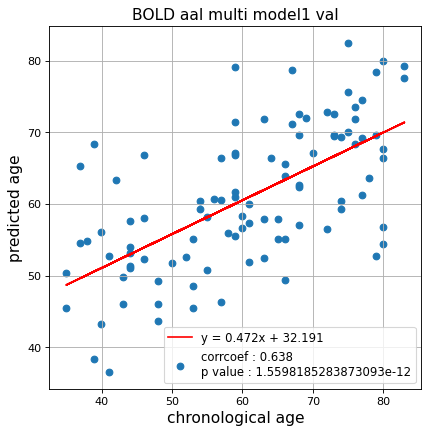

切片: 32.191335844226316
傾き: 0.4722195114012189
Kfold: 4 ::: epoch: 100, loss: 0.04968596794284307, val loss: 1.1268581002950668
Kfold: 4 ::: epoch: 200, loss: 0.01691141566978051, val loss: 1.0252493172883987
Kfold: 4 ::: epoch: 300, loss: 0.014639174601492973, val loss: 0.9732241779565811
Kfold: 4 ::: epoch: 400, loss: 0.01124467750867972, val loss: 0.9826884269714355
Kfold: 4 ::: epoch: 500, loss: 0.008110888553066896, val loss: 0.9273289144039154
Kfold: 4 ::: epoch: 600, loss: 0.005839476361870766, val loss: 0.9146728515625
Kfold: 4 ::: epoch: 700, loss: 0.005912818301182527, val loss: 0.9094714969396591
Kfold: 4 ::: epoch: 800, loss: 0.006656894890161661, val loss: 0.9048908054828644
Kfold: 4 ::: epoch: 900, loss: 0.004754360299557447, val loss: 0.9022462964057922
Kfold: 4 ::: epoch: 1000, loss: 0.004236241981673699, val loss: 0.8684661686420441
save_epochs:952
best val loss:0.8414243459701538


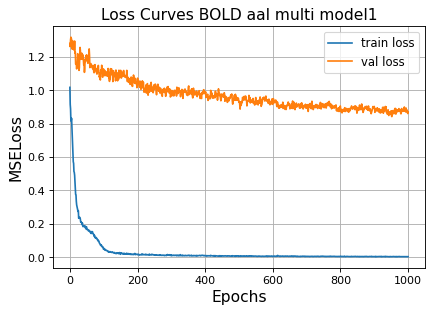

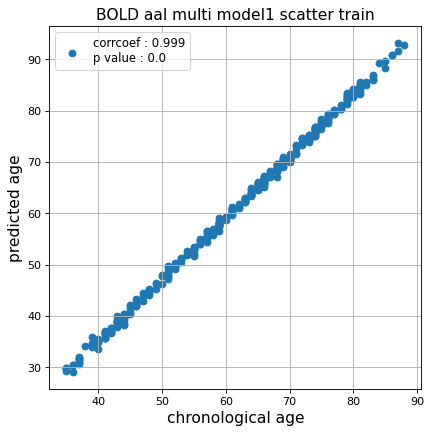

r^2 train data:  0.9558748238108902


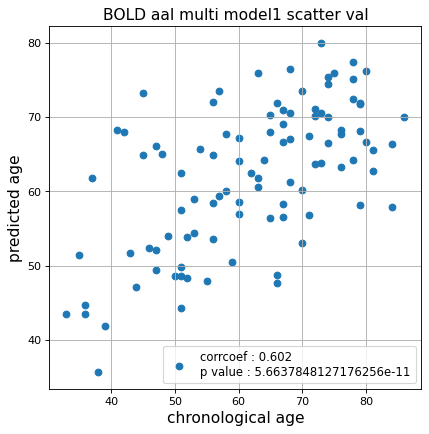

r^2 val data:  0.347657367941963


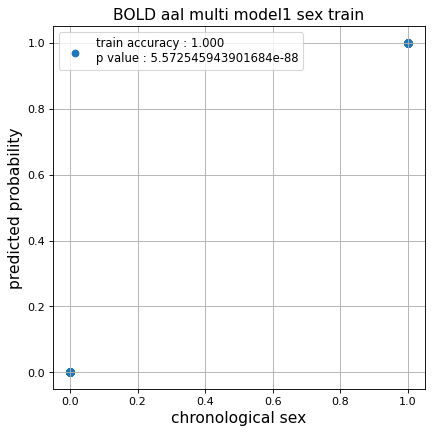

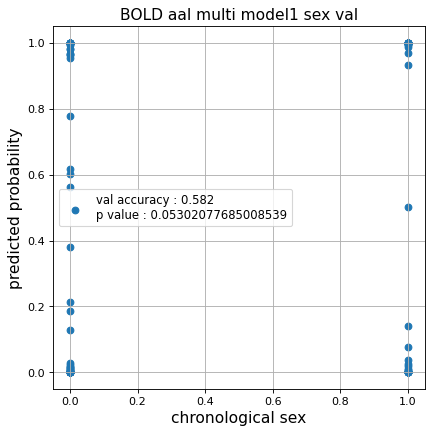

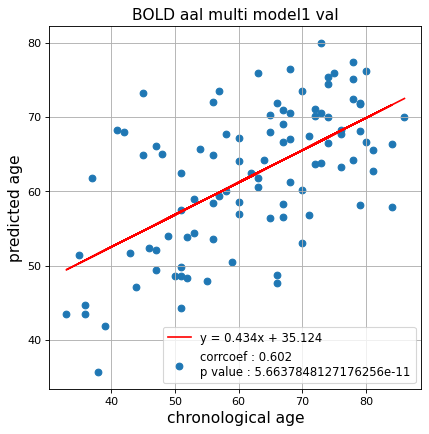

切片: 35.123988202804284
傾き: 0.43417096733995436
Kfold: 5 ::: epoch: 100, loss: 0.04738184895652991, val loss: 0.9291335195302963
Kfold: 5 ::: epoch: 200, loss: 0.01825704934218755, val loss: 0.877098336815834
Kfold: 5 ::: epoch: 300, loss: 0.01121926809159609, val loss: 0.8381992131471634
Kfold: 5 ::: epoch: 400, loss: 0.008032166846812917, val loss: 0.8614076226949692
early stopping
save_epochs:275
best val loss:0.8110095262527466


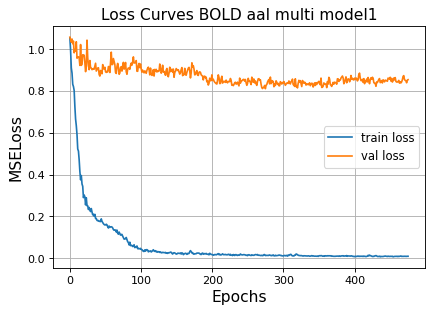

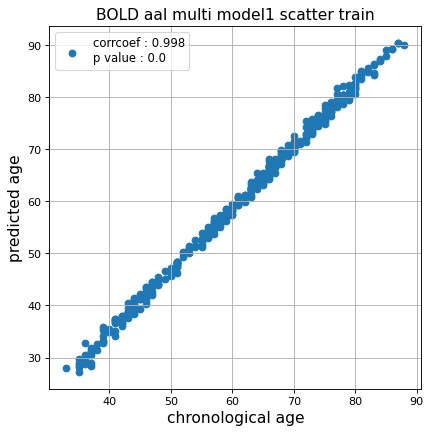

r^2 train data:  0.9555746466185945


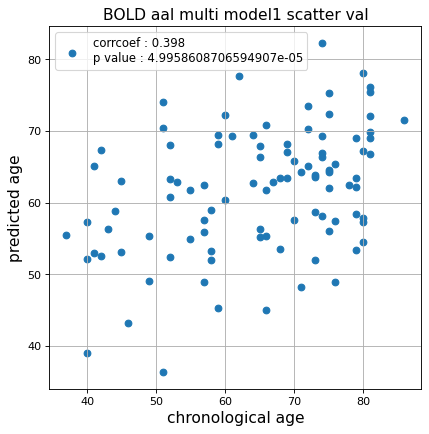

r^2 val data:  0.02248829668937513


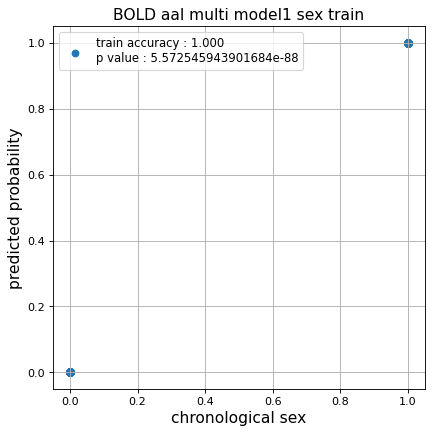

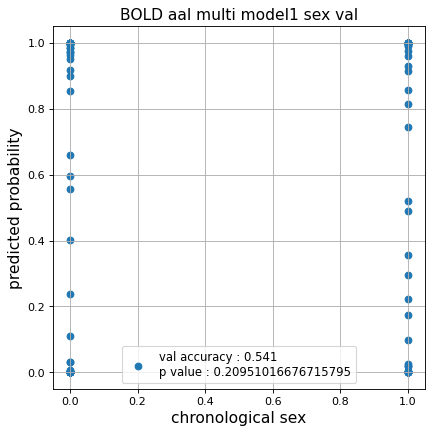

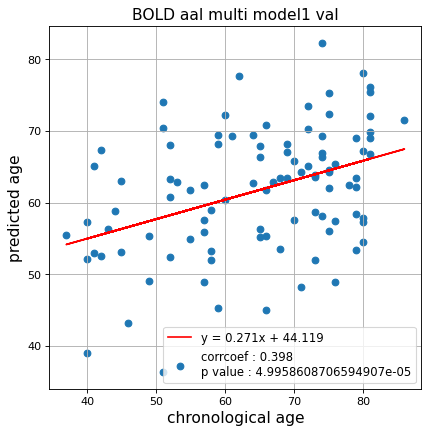

切片: 44.118612295140395
傾き: 0.2714517191681729
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.04943279950664593, val loss: 0.7840549647808075
Kfold: 1 ::: epoch: 200, loss: 0.01615908261961662, val loss: 0.693720206618309
Kfold: 1 ::: epoch: 300, loss: 0.015588815109087871, val loss: 0.7043407559394836
Kfold: 1 ::: epoch: 400, loss: 0.009364665736659216, val loss: 0.6495860517024994
Kfold: 1 ::: epoch: 500, loss: 0.008623526216699528, val loss: 0.6625690013170242
early stopping
save_epochs:381
best val loss:0.6174984872341156


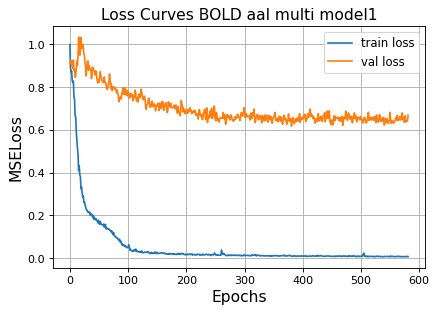

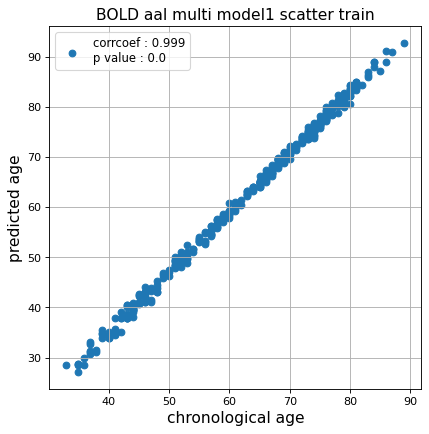

r^2 train data:  0.9557605595389949


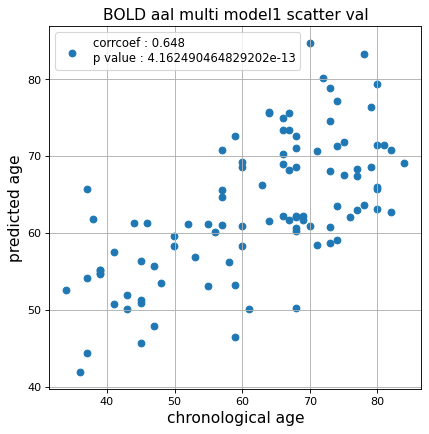

r^2 val data:  0.4121169870642082


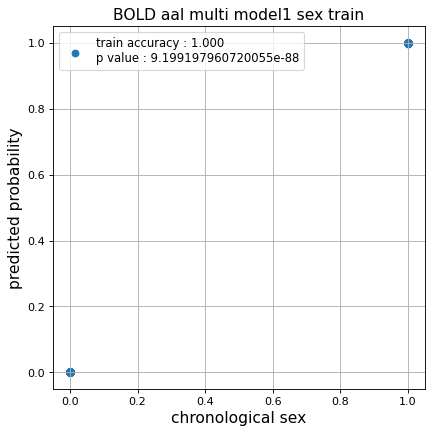

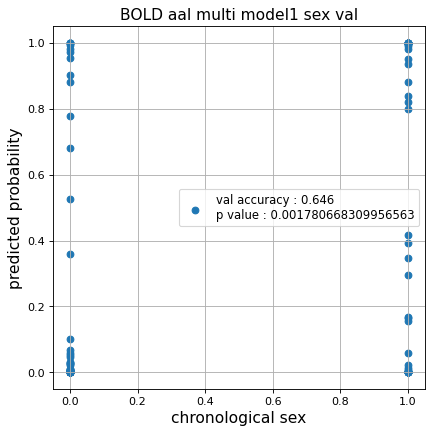

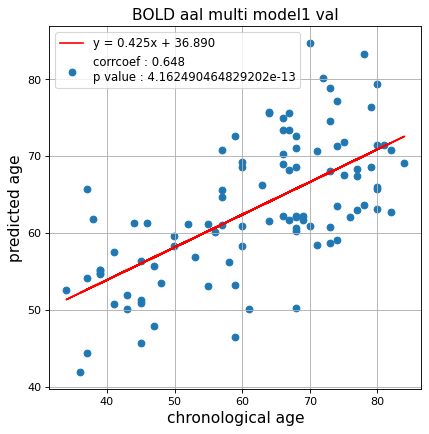

切片: 36.890278589311734
傾き: 0.42459486291257575
Kfold: 2 ::: epoch: 100, loss: 0.05798230234246988, val loss: 0.6496606320142746
Kfold: 2 ::: epoch: 200, loss: 0.021946776156815197, val loss: 0.6687548160552979
Kfold: 2 ::: epoch: 300, loss: 0.013510806199449759, val loss: 0.5537968128919601
Kfold: 2 ::: epoch: 400, loss: 0.007931824666089736, val loss: 0.5246425494551659
Kfold: 2 ::: epoch: 500, loss: 0.00875091884070291, val loss: 0.5120241492986679
Kfold: 2 ::: epoch: 600, loss: 0.007407932936285551, val loss: 0.4903806149959564
Kfold: 2 ::: epoch: 700, loss: 0.004954895291190881, val loss: 0.471681110560894
Kfold: 2 ::: epoch: 800, loss: 0.006166832414097511, val loss: 0.46586666256189346
Kfold: 2 ::: epoch: 900, loss: 0.00471404053342457, val loss: 0.47378550469875336
early stopping
save_epochs:701
best val loss:0.44937586039304733


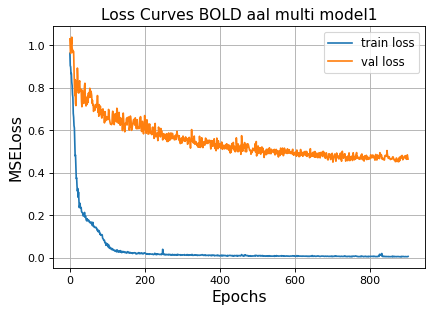

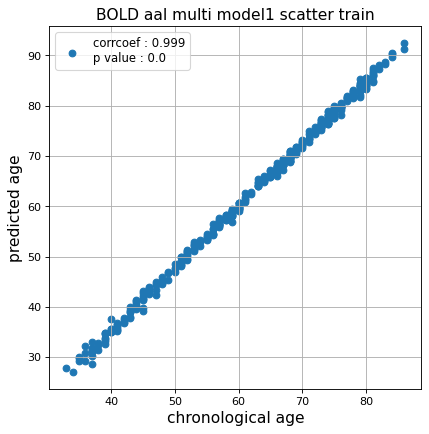

r^2 train data:  0.9384537185945846


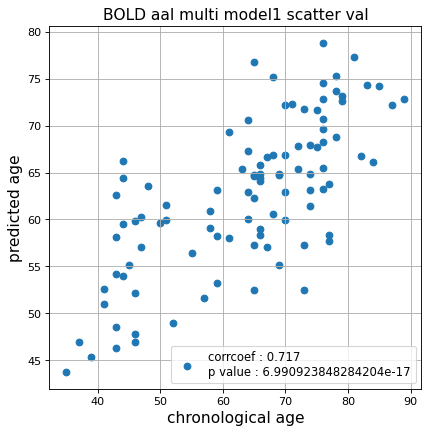

r^2 val data:  0.4935142388908996


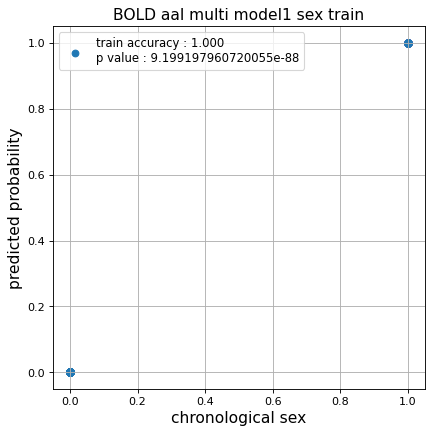

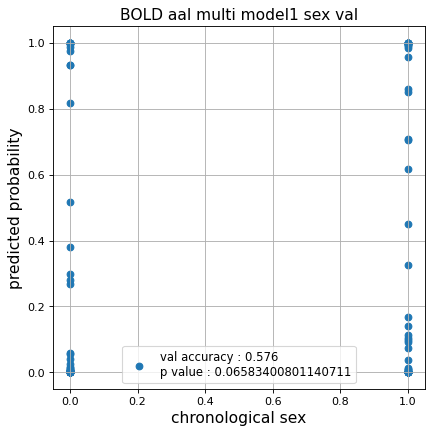

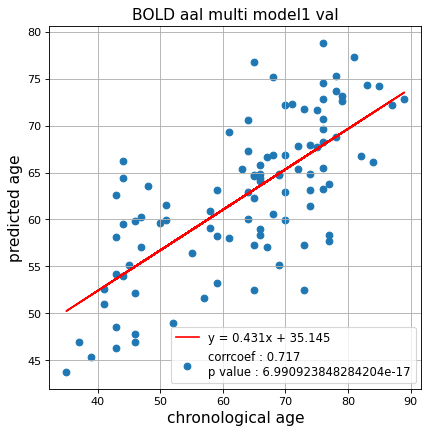

切片: 35.144983393955684
傾き: 0.43144596550055586
Kfold: 3 ::: epoch: 100, loss: 0.039189429237292364, val loss: 0.822096586227417
Kfold: 3 ::: epoch: 200, loss: 0.01680804366389146, val loss: 0.7459801584482193
Kfold: 3 ::: epoch: 300, loss: 0.01365213912840073, val loss: 0.6946489363908768
Kfold: 3 ::: epoch: 400, loss: 0.009430239765116801, val loss: 0.714654415845871
Kfold: 3 ::: epoch: 500, loss: 0.008985048016676536, val loss: 0.6507347822189331
Kfold: 3 ::: epoch: 600, loss: 0.005996405379846692, val loss: 0.6649378687143326
Kfold: 3 ::: epoch: 700, loss: 0.0067264132488232395, val loss: 0.6419564783573151
early stopping
save_epochs:554
best val loss:0.6008233428001404


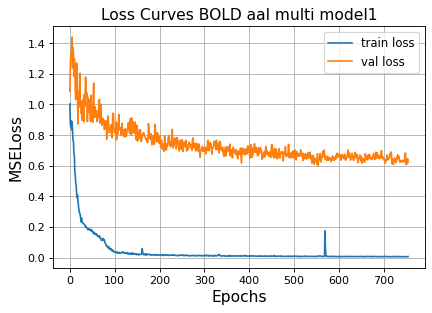

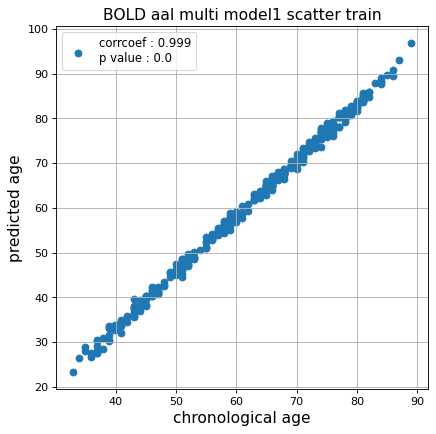

r^2 train data:  0.9258693651781147


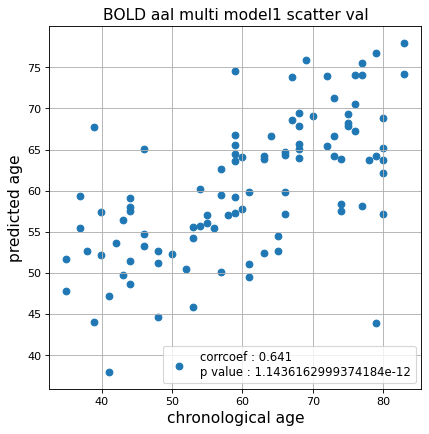

r^2 val data:  0.4106619694058593


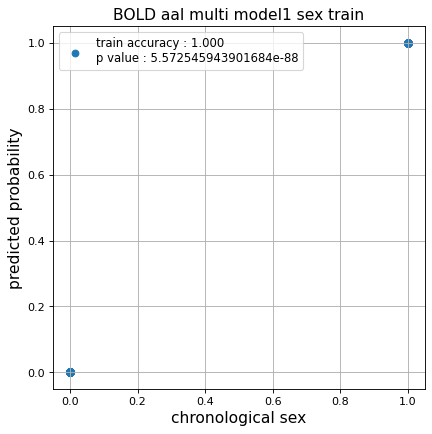

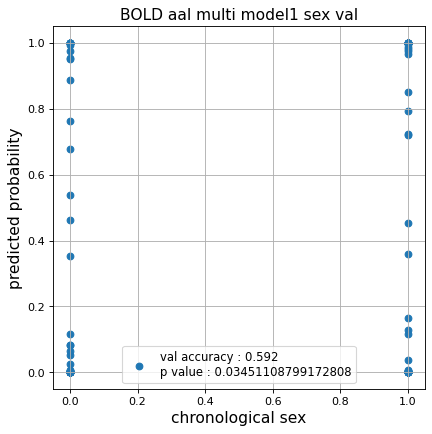

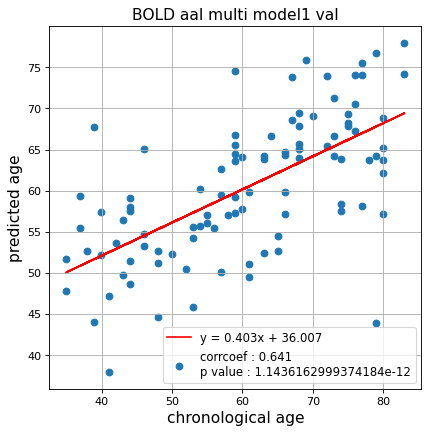

切片: 36.00689603972565
傾き: 0.4025025320360181
Kfold: 4 ::: epoch: 100, loss: 0.03854368455134905, val loss: 1.0700450390577316
Kfold: 4 ::: epoch: 200, loss: 0.020026555857979335, val loss: 0.9885254949331284
Kfold: 4 ::: epoch: 300, loss: 0.012409057324895492, val loss: 1.0065692216157913
Kfold: 4 ::: epoch: 400, loss: 0.010483730548562912, val loss: 0.9831463545560837
Kfold: 4 ::: epoch: 500, loss: 0.008953333474122561, val loss: 0.982773020863533
early stopping
save_epochs:397
best val loss:0.9231746047735214


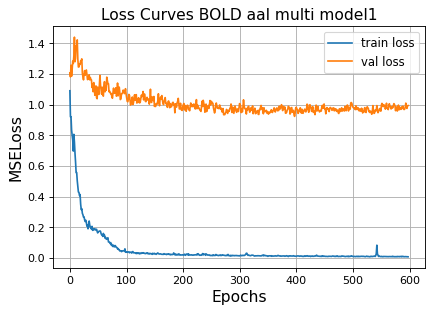

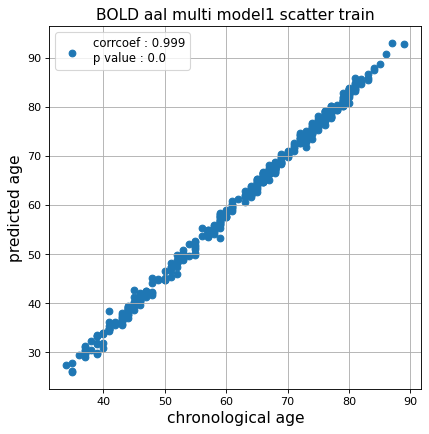

r^2 train data:  0.9346780939801547


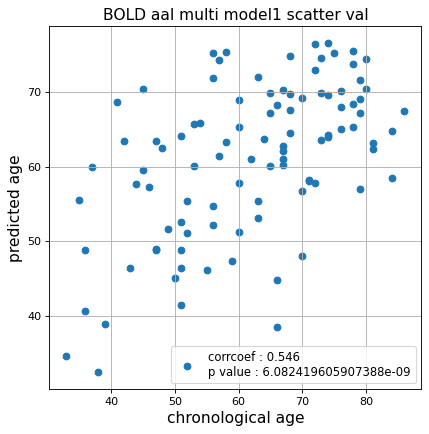

r^2 val data:  0.24286199696356214


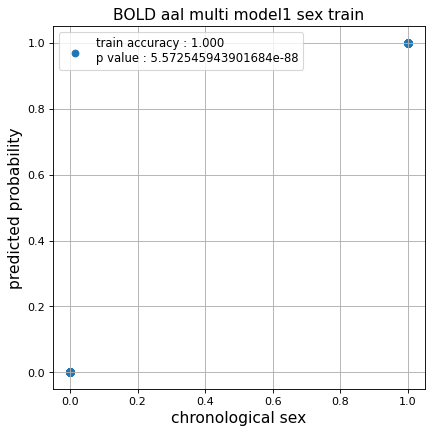

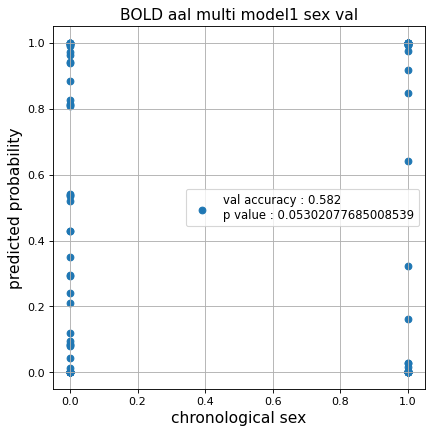

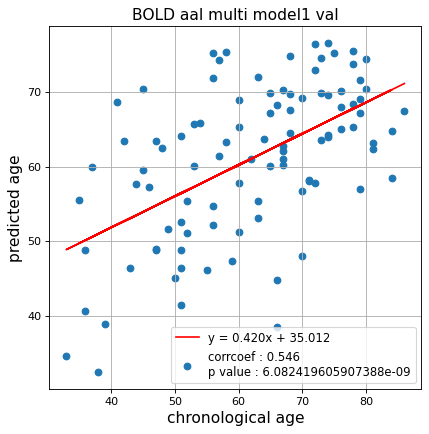

切片: 35.01208369842442
傾き: 0.4203002772350885
Kfold: 5 ::: epoch: 100, loss: 0.04729527836808792, val loss: 1.0368055701255798
Kfold: 5 ::: epoch: 200, loss: 0.016253381466063168, val loss: 0.9024844467639923
Kfold: 5 ::: epoch: 300, loss: 0.012133990306980334, val loss: 0.8567146360874176
Kfold: 5 ::: epoch: 400, loss: 0.010106077346091088, val loss: 0.8372099846601486
Kfold: 5 ::: epoch: 500, loss: 0.010563166525501471, val loss: 0.7979759722948074
Kfold: 5 ::: epoch: 600, loss: 0.006924146123660298, val loss: 0.7916037738323212
Kfold: 5 ::: epoch: 700, loss: 0.006883535104302259, val loss: 0.825379878282547
early stopping
save_epochs:555
best val loss:0.7625253945589066


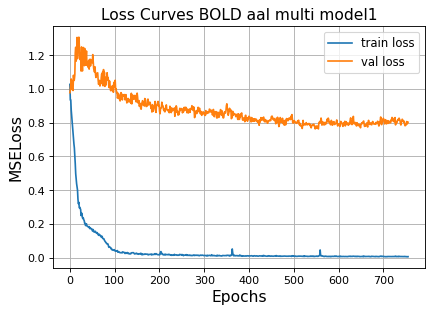

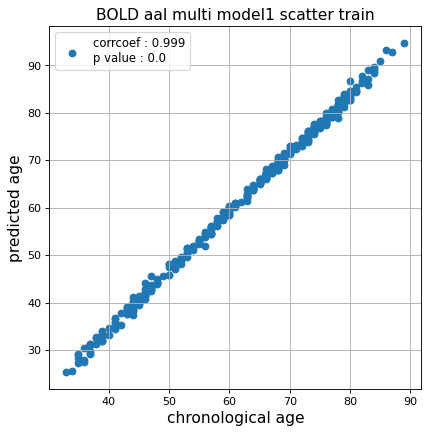

r^2 train data:  0.939333102123301


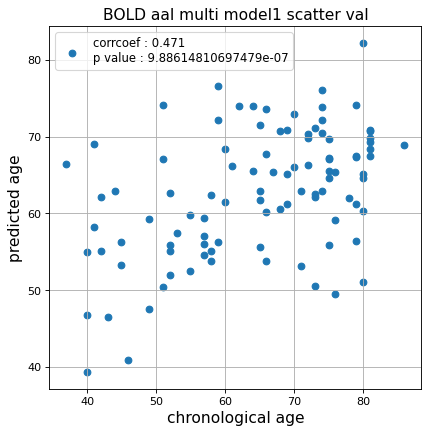

r^2 val data:  0.16844780919293723


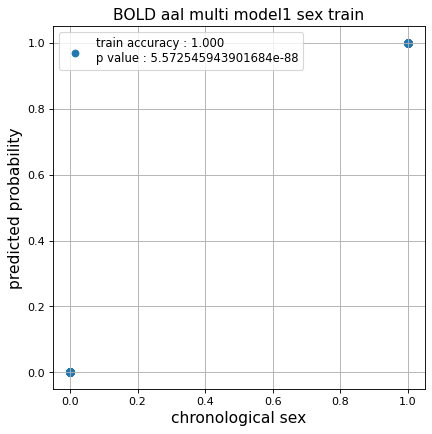

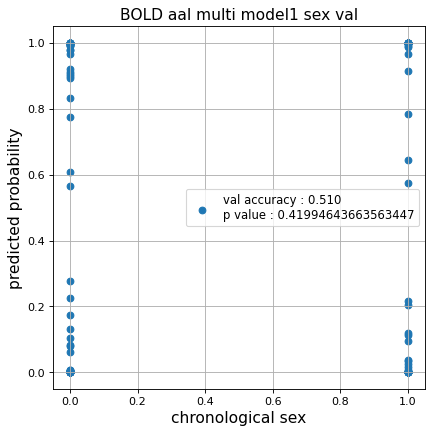

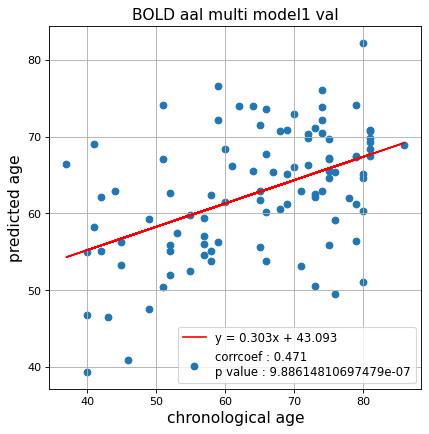

切片: 43.09324374844822
傾き: 0.3032210059629162
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.05197509607443443, val loss: 0.7458376511931419
Kfold: 1 ::: epoch: 200, loss: 0.019029638586709134, val loss: 0.6780969351530075
Kfold: 1 ::: epoch: 300, loss: 0.012779472359957604, val loss: 0.6576283872127533
Kfold: 1 ::: epoch: 400, loss: 0.010358822926019248, val loss: 0.630021333694458
Kfold: 1 ::: epoch: 500, loss: 0.008488131937785791, val loss: 0.5927814841270447
Kfold: 1 ::: epoch: 600, loss: 0.008015942831452075, val loss: 0.6015874743461609
early stopping
save_epochs:469
best val loss:0.5830472707748413


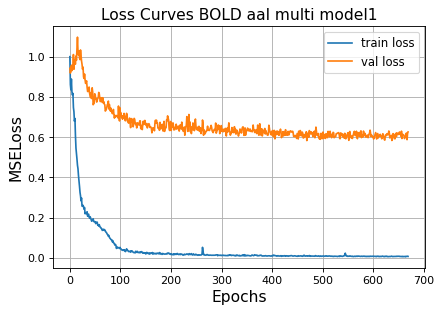

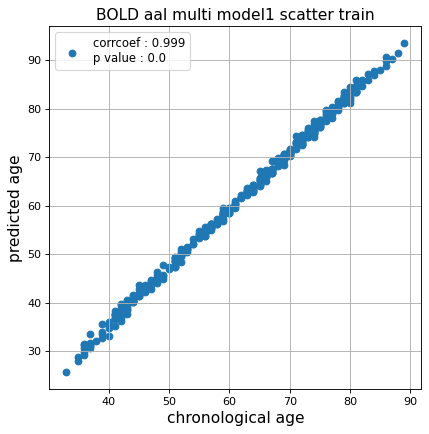

r^2 train data:  0.9624861222878619


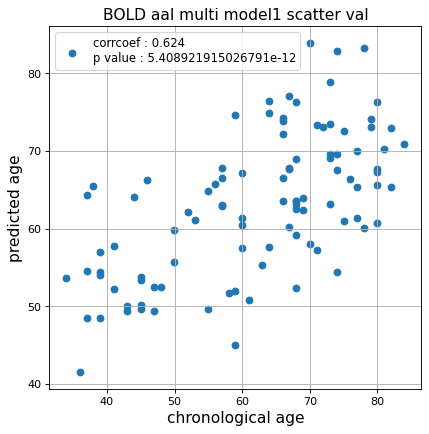

r^2 val data:  0.3811591387693618


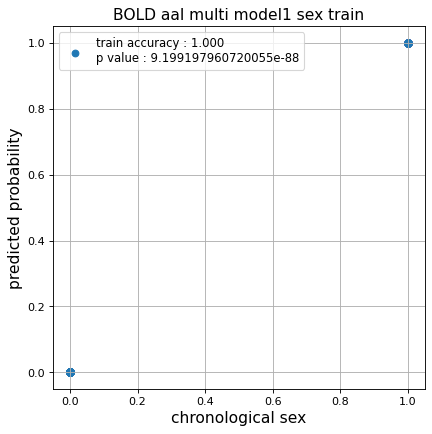

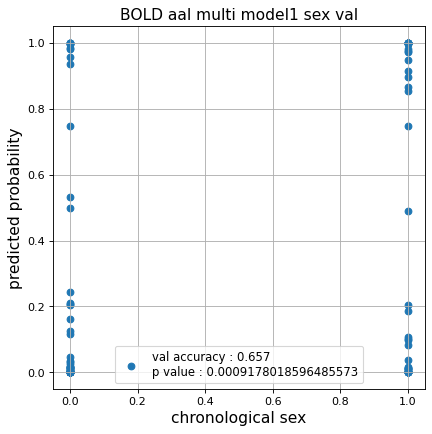

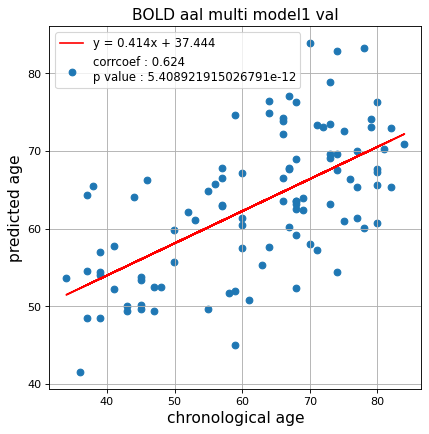

切片: 37.443643438084834
傾き: 0.41356066539897657
Kfold: 2 ::: epoch: 100, loss: 0.03917827801062511, val loss: 0.7554629053920507
Kfold: 2 ::: epoch: 200, loss: 0.019185137934982777, val loss: 0.6611203663051128
Kfold: 2 ::: epoch: 300, loss: 0.011342028621584177, val loss: 0.6389097757637501
Kfold: 2 ::: epoch: 400, loss: 0.010371585161640095, val loss: 0.639206063002348
Kfold: 2 ::: epoch: 500, loss: 0.00749347975047735, val loss: 0.6215718239545822
Kfold: 2 ::: epoch: 600, loss: 0.006722155421112592, val loss: 0.5975095145404339
Kfold: 2 ::: epoch: 700, loss: 0.006458566488268284, val loss: 0.5960925370454788
Kfold: 2 ::: epoch: 800, loss: 0.006088185034549007, val loss: 0.5945424027740955
Kfold: 2 ::: epoch: 900, loss: 0.005430080068226044, val loss: 0.5745506566017866
Kfold: 2 ::: epoch: 1000, loss: 0.004844653563430676, val loss: 0.572598610073328
save_epochs:961
best val loss:0.5640055909752846


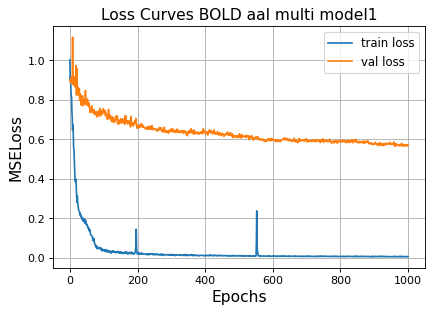

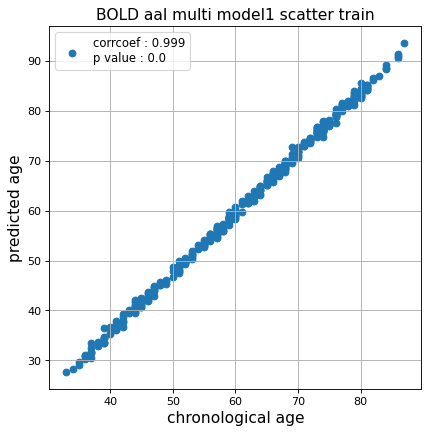

r^2 train data:  0.9555156303728101


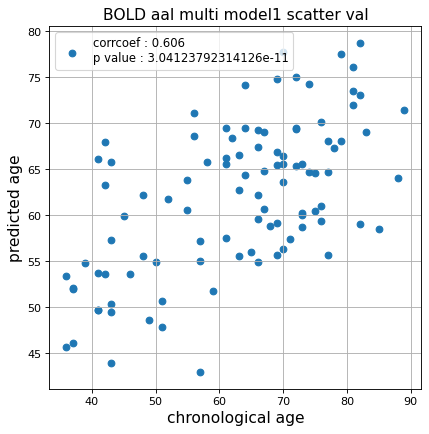

r^2 val data:  0.36421350818220266


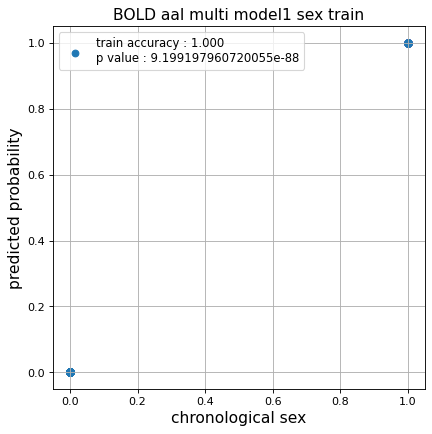

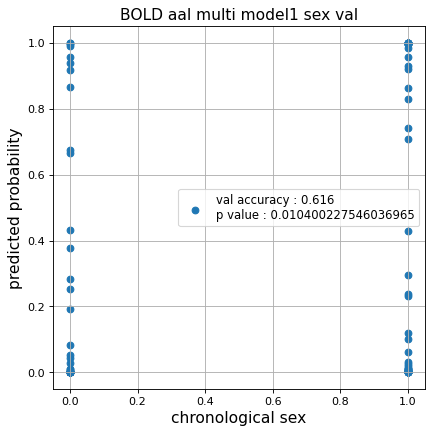

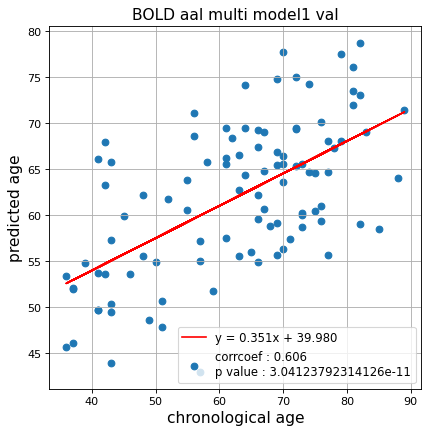

切片: 39.980382113178436
傾き: 0.3512294945420609
Kfold: 3 ::: epoch: 100, loss: 0.03152426597304069, val loss: 1.1634083837270737
Kfold: 3 ::: epoch: 200, loss: 0.021598264933205567, val loss: 0.9367546737194061
Kfold: 3 ::: epoch: 300, loss: 0.014651095709548546, val loss: 0.8846073597669601
Kfold: 3 ::: epoch: 400, loss: 0.009702728452304235, val loss: 0.8729805499315262
Kfold: 3 ::: epoch: 500, loss: 0.009174712109737672, val loss: 0.8839167207479477
Kfold: 3 ::: epoch: 600, loss: 0.007300438574300363, val loss: 0.8719488829374313
Kfold: 3 ::: epoch: 700, loss: 0.007612523121329455, val loss: 0.7982046604156494
Kfold: 3 ::: epoch: 800, loss: 0.006767602350849371, val loss: 0.8299499452114105
Kfold: 3 ::: epoch: 900, loss: 0.005666256935980458, val loss: 0.8153760805726051
Kfold: 3 ::: epoch: 1000, loss: 0.005019526767472808, val loss: 0.8431682288646698
save_epochs:939
best val loss:0.7709429860115051


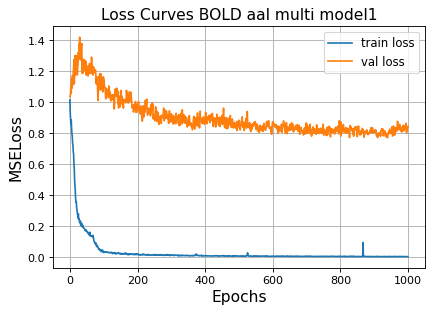

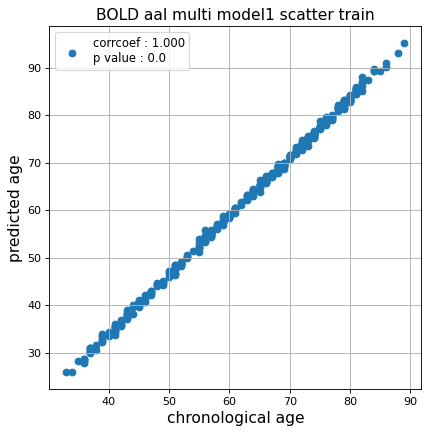

r^2 train data:  0.9384680799040291


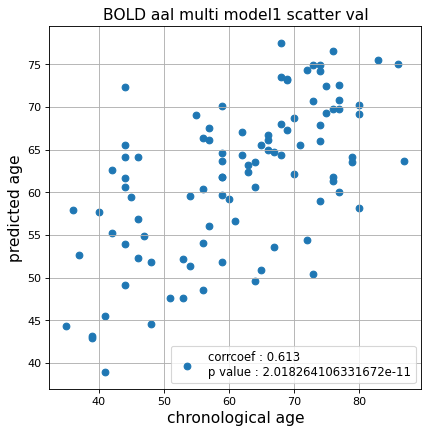

r^2 val data:  0.371704054044118


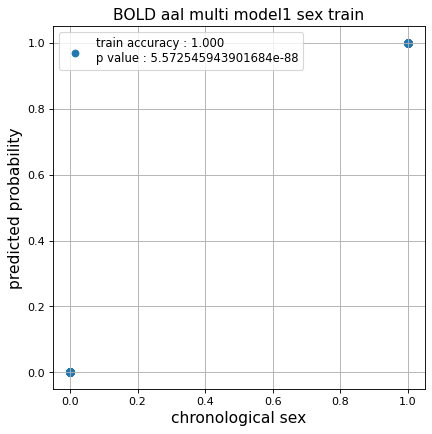

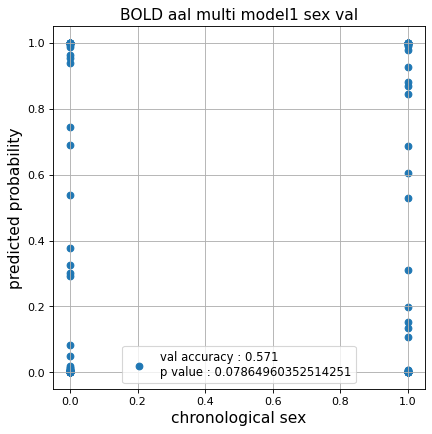

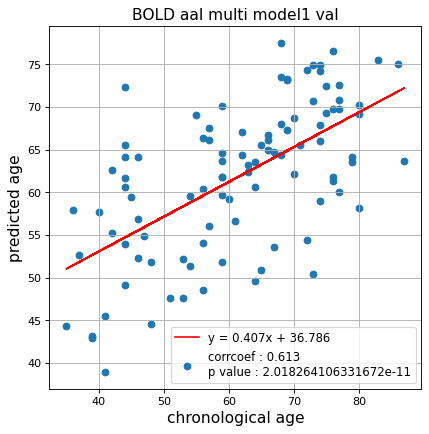

切片: 36.78646215586464
傾き: 0.4074873847090193
Kfold: 4 ::: epoch: 100, loss: 0.039562053978443146, val loss: 1.0685554891824722
Kfold: 4 ::: epoch: 200, loss: 0.016261446504638746, val loss: 0.9806085228919983
Kfold: 4 ::: epoch: 300, loss: 0.011253080115868496, val loss: 0.9737901240587234
Kfold: 4 ::: epoch: 400, loss: 0.00970105816108676, val loss: 0.9782146513462067
Kfold: 4 ::: epoch: 500, loss: 0.007587283204954404, val loss: 0.9694208204746246
early stopping
save_epochs:382
best val loss:0.9209509938955307


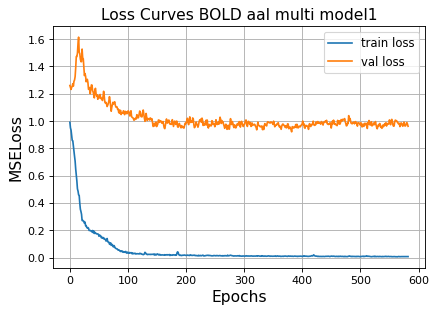

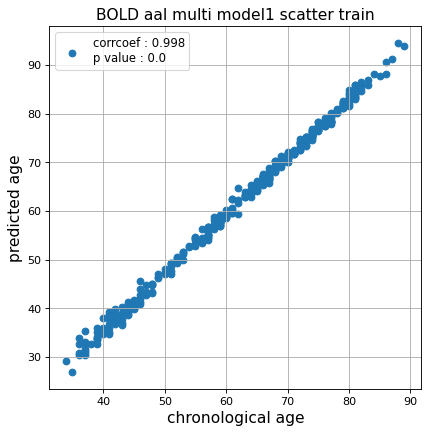

r^2 train data:  0.9612192117352807


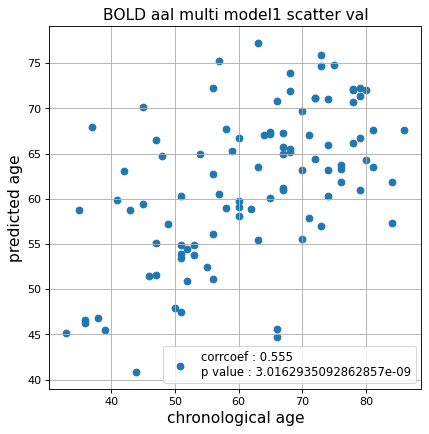

r^2 val data:  0.30309389189195257


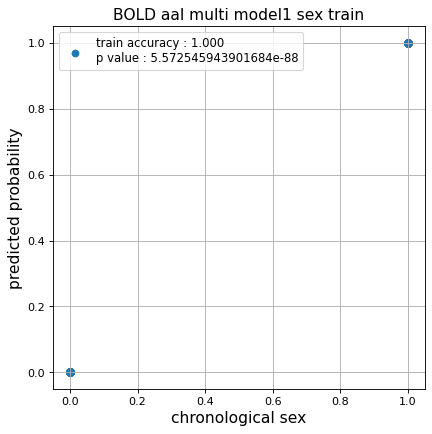

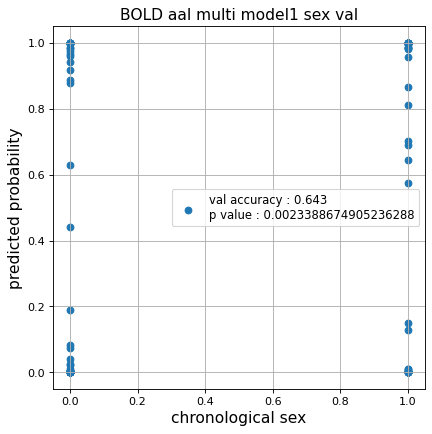

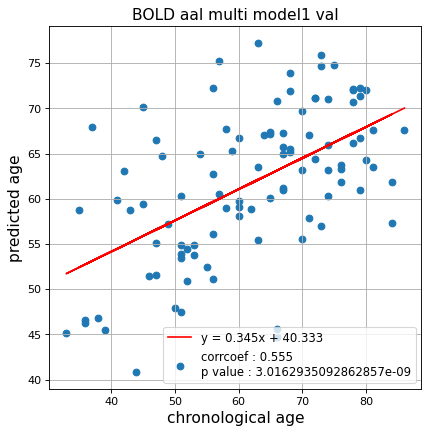

切片: 40.33339517639375
傾き: 0.3451861856128701
Kfold: 5 ::: epoch: 100, loss: 0.033853089866729885, val loss: 0.8746555894613266
Kfold: 5 ::: epoch: 200, loss: 0.020428100529198464, val loss: 0.7649497389793396
Kfold: 5 ::: epoch: 300, loss: 0.01498169258523446, val loss: 0.7025054842233658
Kfold: 5 ::: epoch: 400, loss: 0.00992228420308003, val loss: 0.6961217671632767
Kfold: 5 ::: epoch: 500, loss: 0.009160435758531094, val loss: 0.6627568155527115
Kfold: 5 ::: epoch: 600, loss: 0.0071555117252641, val loss: 0.6703628897666931
Kfold: 5 ::: epoch: 700, loss: 0.006578391023839896, val loss: 0.6567499116063118
Kfold: 5 ::: epoch: 800, loss: 0.00532149407081306, val loss: 0.6439253464341164
Kfold: 5 ::: epoch: 900, loss: 0.005258270163232317, val loss: 0.6339637562632561
early stopping
save_epochs:726
best val loss:0.6259188875555992


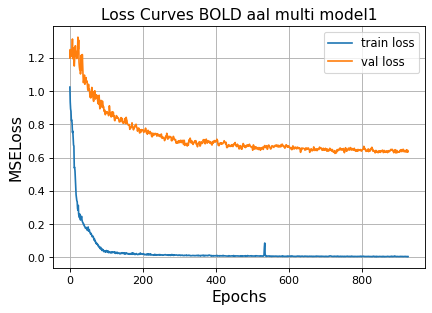

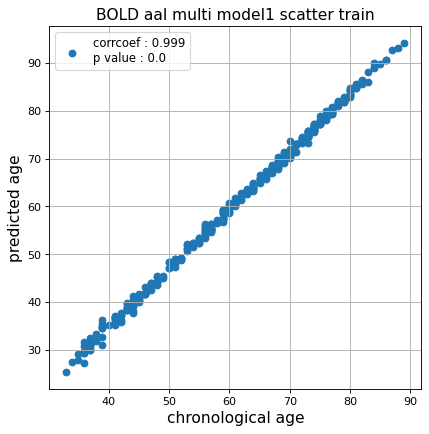

r^2 train data:  0.9492767007692758


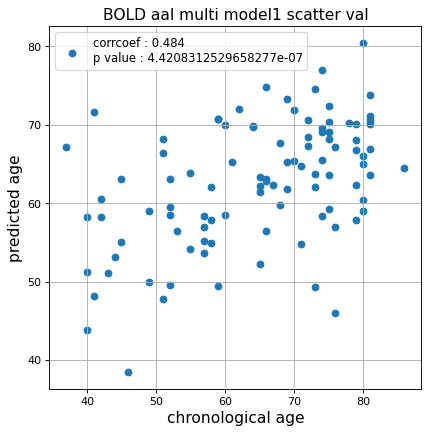

r^2 val data:  0.188905717395352


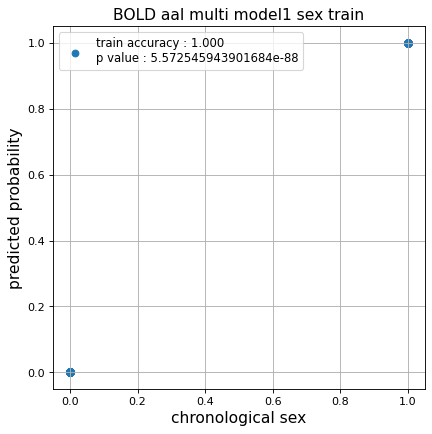

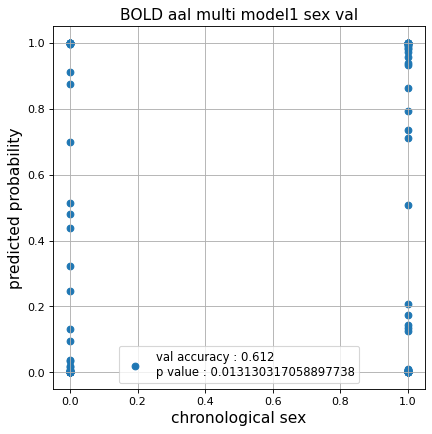

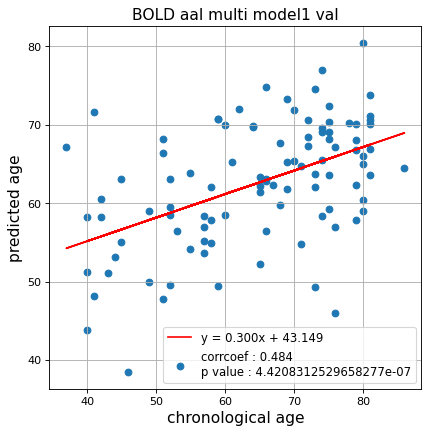

切片: 43.14855566936862
傾き: 0.30022783819798043
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.037400998891546175, val loss: 0.6474441438913345
Kfold: 1 ::: epoch: 200, loss: 0.019519981569968738, val loss: 0.5624329820275307
Kfold: 1 ::: epoch: 300, loss: 0.010912293532433419, val loss: 0.5549745485186577
Kfold: 1 ::: epoch: 400, loss: 0.01152924899584972, val loss: 0.5190337151288986
Kfold: 1 ::: epoch: 500, loss: 0.008389563657916509, val loss: 0.5396215170621872
Kfold: 1 ::: epoch: 600, loss: 0.007277352090638418, val loss: 0.5287556648254395
Kfold: 1 ::: epoch: 700, loss: 0.006547822831914975, val loss: 0.5294308066368103
Kfold: 1 ::: epoch: 800, loss: 0.005816408827041204, val loss: 0.5389999151229858
Kfold: 1 ::: epoch: 900, loss: 0.004899829482802978, val loss: 0.5412130728363991
Kfold: 1 ::: epoch: 1000, loss: 0.004775105169616067, val loss: 0.5244572013616562
save_epochs:829
best val loss:0.5004931166768074


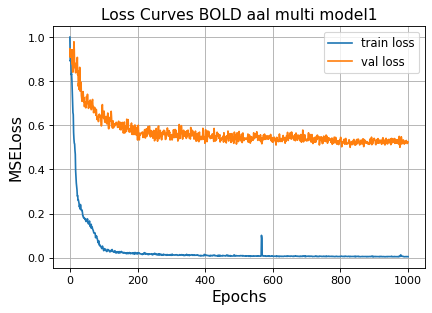

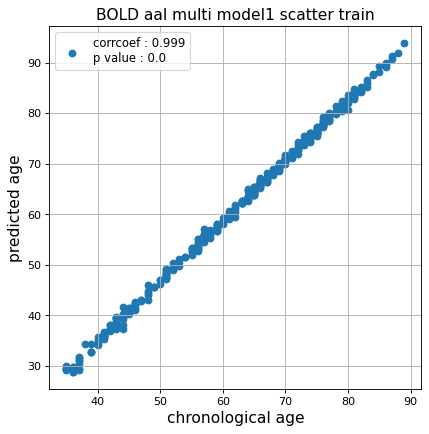

r^2 train data:  0.9584076967021331


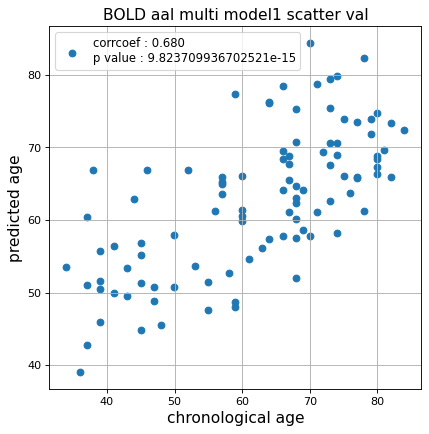

r^2 val data:  0.4601658457506057


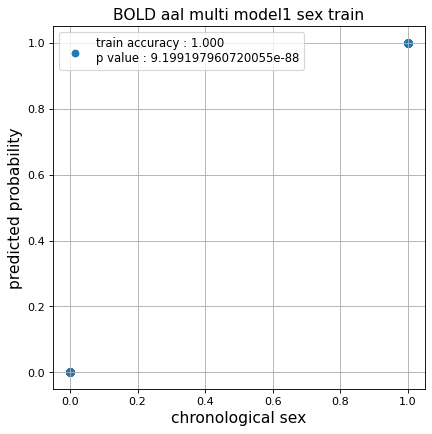

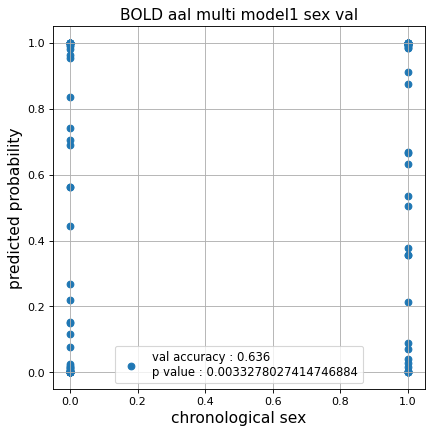

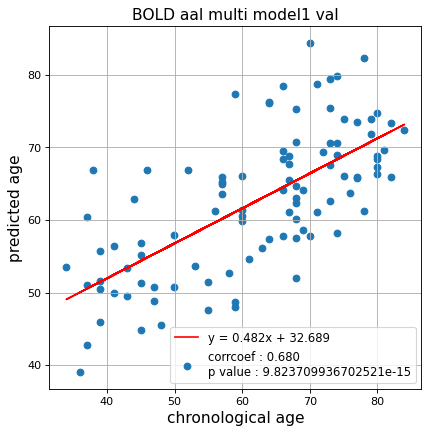

切片: 32.68850040284899
傾き: 0.48166588283757966
Kfold: 2 ::: epoch: 100, loss: 0.041715496577895604, val loss: 0.6116599626839161
Kfold: 2 ::: epoch: 200, loss: 0.01702637218225461, val loss: 0.5882295984774828
Kfold: 2 ::: epoch: 300, loss: 0.01260061046251884, val loss: 0.5676035061478615
Kfold: 2 ::: epoch: 400, loss: 0.008778502233326435, val loss: 0.5623132586479187
Kfold: 2 ::: epoch: 500, loss: 0.01152903063652607, val loss: 0.5527731403708458
Kfold: 2 ::: epoch: 600, loss: 0.00663163776222903, val loss: 0.5526497028768063
early stopping
save_epochs:443
best val loss:0.5392672754824162


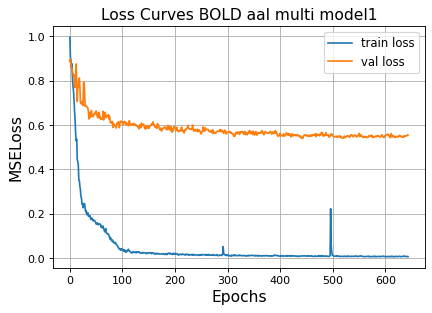

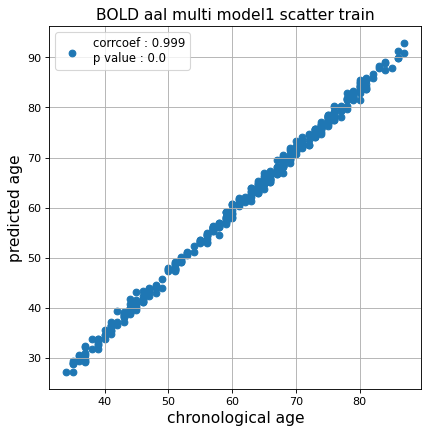

r^2 train data:  0.9471627214204644


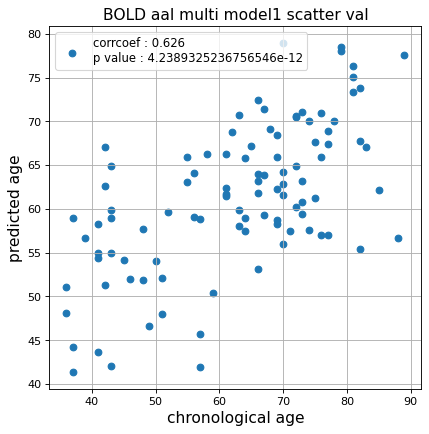

r^2 val data:  0.3828000344507332


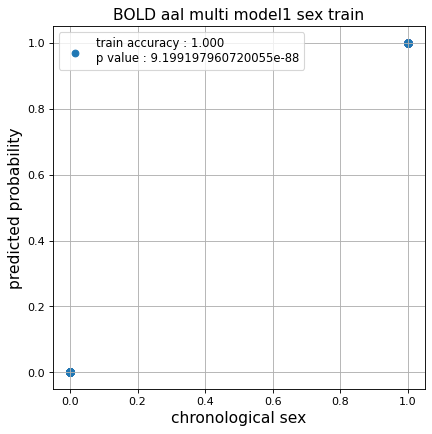

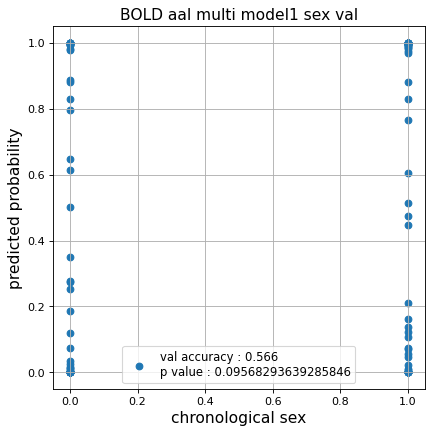

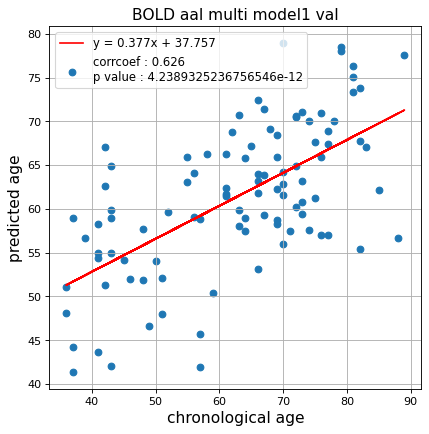

切片: 37.757278192298976
傾き: 0.37654622804345395
Kfold: 3 ::: epoch: 100, loss: 0.0499152595607134, val loss: 0.6256111264228821
Kfold: 3 ::: epoch: 200, loss: 0.01898934641996255, val loss: 0.5825162902474403
Kfold: 3 ::: epoch: 300, loss: 0.013345831718582373, val loss: 0.5509839132428169
Kfold: 3 ::: epoch: 400, loss: 0.0112803762133878, val loss: 0.5358311533927917
Kfold: 3 ::: epoch: 500, loss: 0.007495133994290462, val loss: 0.5212371796369553
Kfold: 3 ::: epoch: 600, loss: 0.006796855264558242, val loss: 0.5221337825059891
Kfold: 3 ::: epoch: 700, loss: 0.006207512190135626, val loss: 0.5080360099673271
Kfold: 3 ::: epoch: 800, loss: 0.006169307547119947, val loss: 0.5069555938243866
Kfold: 3 ::: epoch: 900, loss: 0.005443790479778097, val loss: 0.5097789168357849
Kfold: 3 ::: epoch: 1000, loss: 0.0044618488217775636, val loss: 0.49459007382392883
save_epochs:992
best val loss:0.48414287716150284


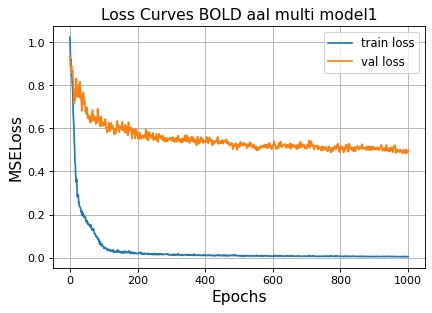

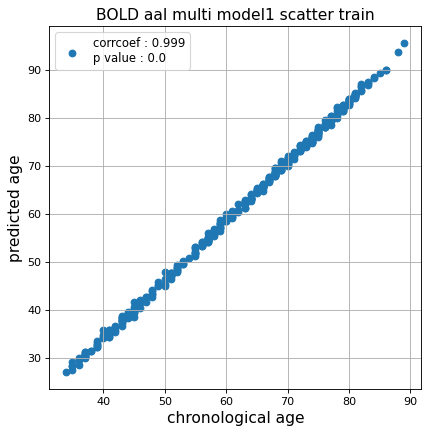

r^2 train data:  0.9414846486601193


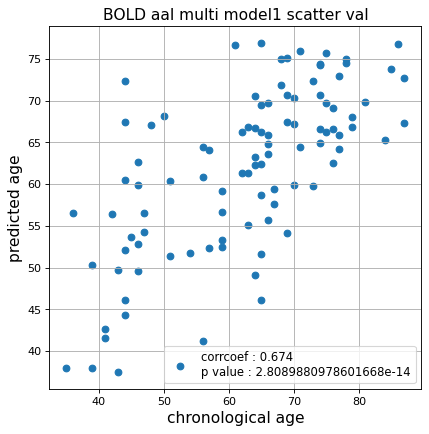

r^2 val data:  0.44789091858369445


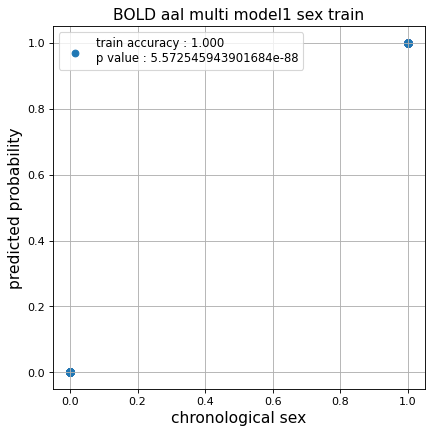

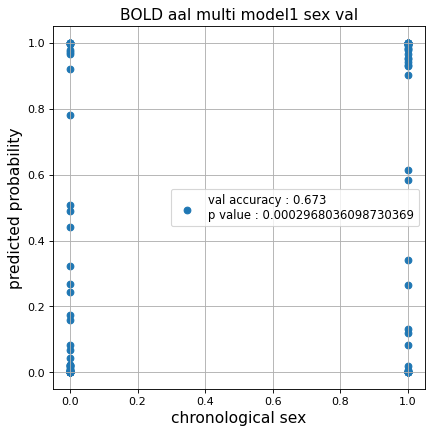

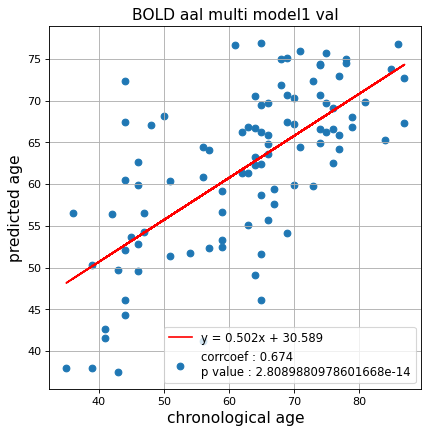

切片: 30.589383514937598
傾き: 0.5023138933582613
Kfold: 4 ::: epoch: 100, loss: 0.041635433928324625, val loss: 1.22004996240139
Kfold: 4 ::: epoch: 200, loss: 0.018158619220440205, val loss: 1.1447109282016754
Kfold: 4 ::: epoch: 300, loss: 0.012132786930753635, val loss: 1.0984268635511398
Kfold: 4 ::: epoch: 400, loss: 0.01036509762231547, val loss: 1.1293586790561676
Kfold: 4 ::: epoch: 500, loss: 0.006954112305090978, val loss: 1.1455248594284058
early stopping
save_epochs:352
best val loss:1.063118889927864


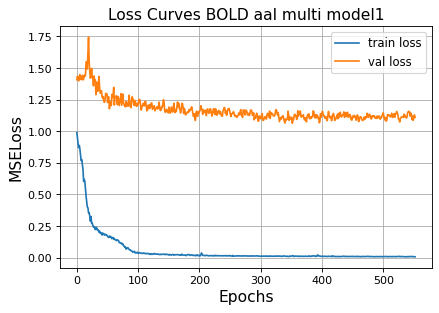

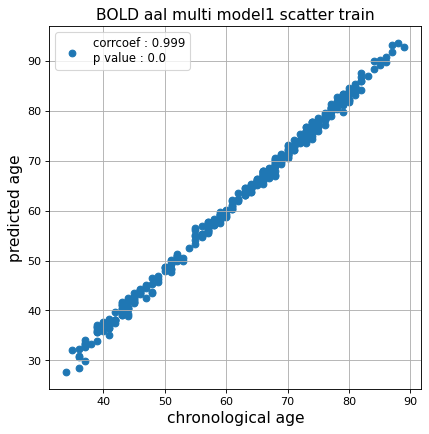

r^2 train data:  0.9627221284218388


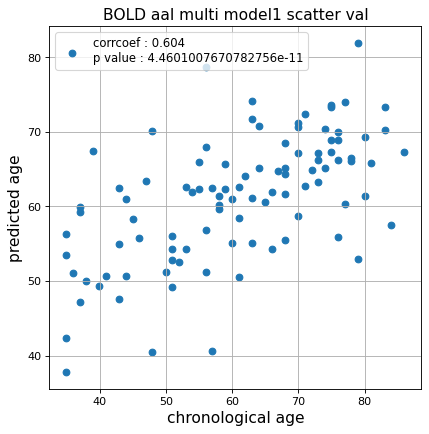

r^2 val data:  0.3643797289861378


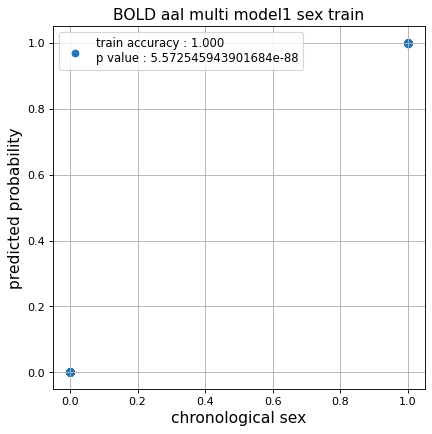

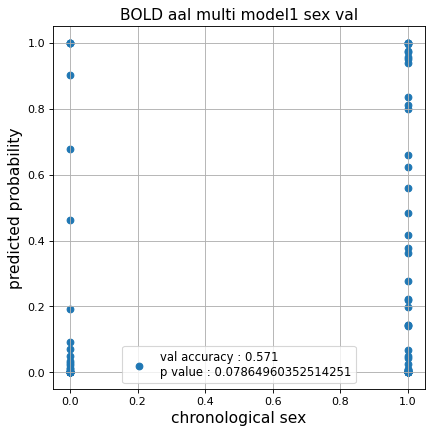

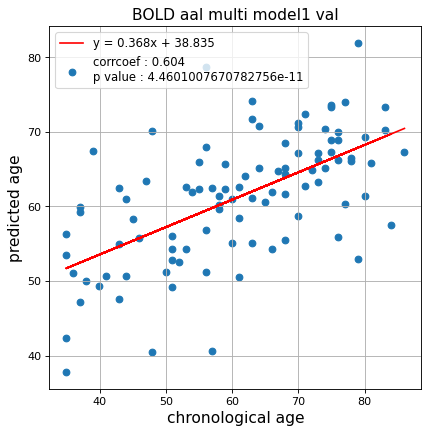

切片: 38.83515464180499
傾き: 0.3677897620196723
Kfold: 5 ::: epoch: 100, loss: 0.06467400376613323, val loss: 0.9115253686904907
Kfold: 5 ::: epoch: 200, loss: 0.018746282403858807, val loss: 0.7708422318100929
Kfold: 5 ::: epoch: 300, loss: 0.013761837107057754, val loss: 0.7358982190489769
Kfold: 5 ::: epoch: 400, loss: 0.010686814999924256, val loss: 0.7127130478620529
Kfold: 5 ::: epoch: 500, loss: 0.008652195835915895, val loss: 0.7022244557738304
Kfold: 5 ::: epoch: 600, loss: 0.006732939599225154, val loss: 0.6722847409546375
Kfold: 5 ::: epoch: 700, loss: 0.006090445443987846, val loss: 0.6827095150947571
Kfold: 5 ::: epoch: 800, loss: 0.0052668104091515905, val loss: 0.6757691651582718
early stopping
save_epochs:633
best val loss:0.6599949523806572


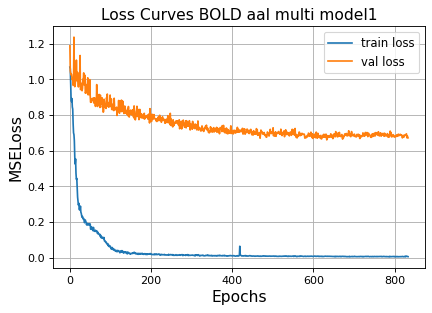

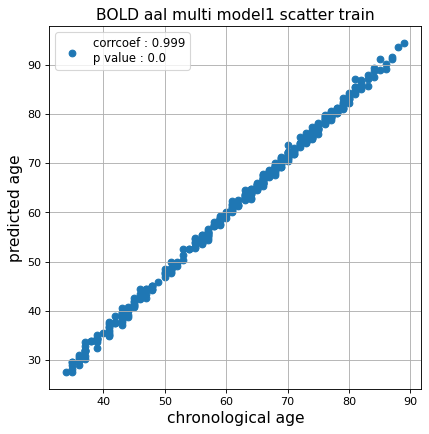

r^2 train data:  0.956582184494029


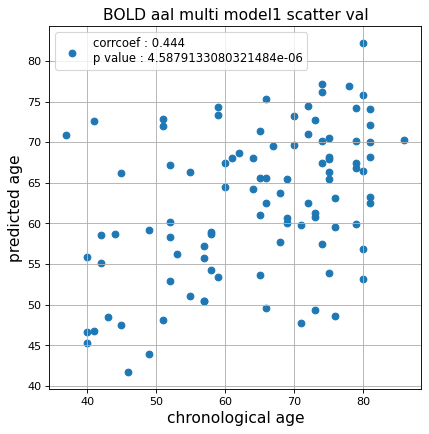

r^2 val data:  0.10409110057193594


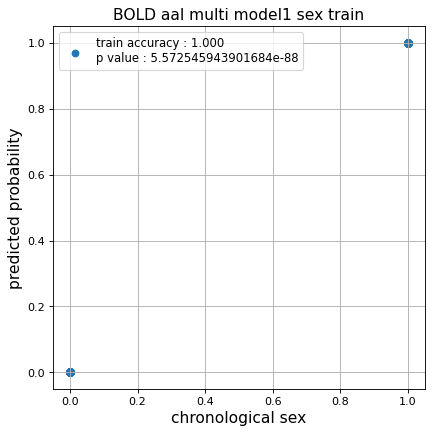

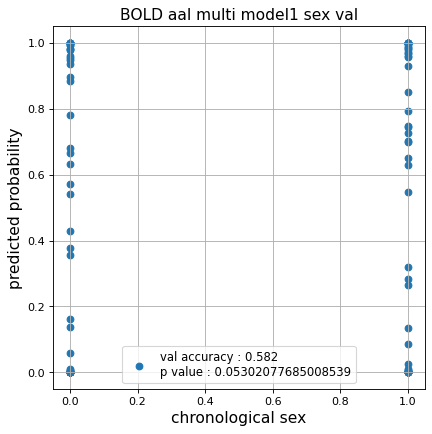

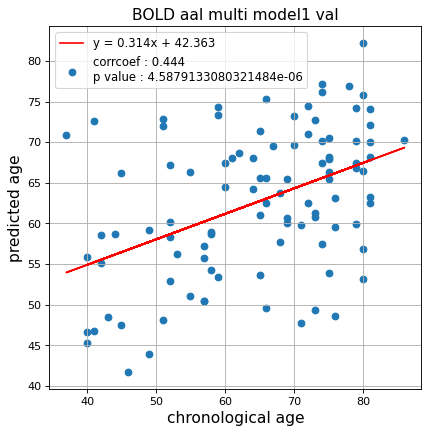

切片: 42.363182483960344
傾き: 0.3135731027952447
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.037737230268808514, val loss: 0.5728644719347358
Kfold: 1 ::: epoch: 200, loss: 0.017423858436254356, val loss: 0.5056299772113562
Kfold: 1 ::: epoch: 300, loss: 0.01134253959529675, val loss: 0.5045941434800625
Kfold: 1 ::: epoch: 400, loss: 0.011299804282876162, val loss: 0.4767369031906128
Kfold: 1 ::: epoch: 500, loss: 0.007798442867799447, val loss: 0.49076657742261887
Kfold: 1 ::: epoch: 600, loss: 0.008368490747391032, val loss: 0.4795236811041832
early stopping
save_epochs:458
best val loss:0.46740517020225525


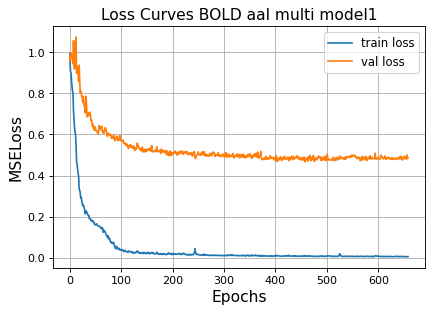

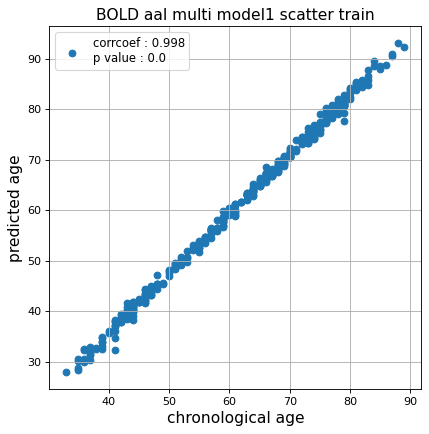

r^2 train data:  0.9632874167720649


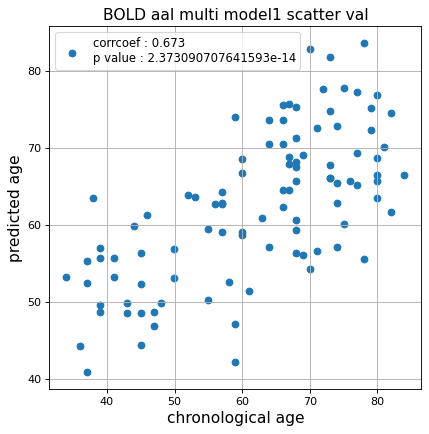

r^2 val data:  0.4505888450538279


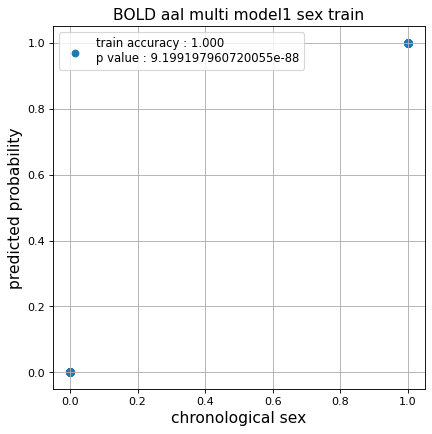

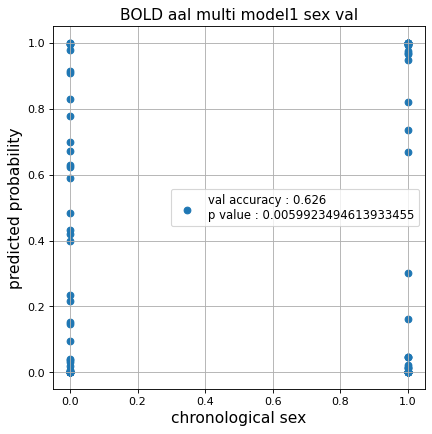

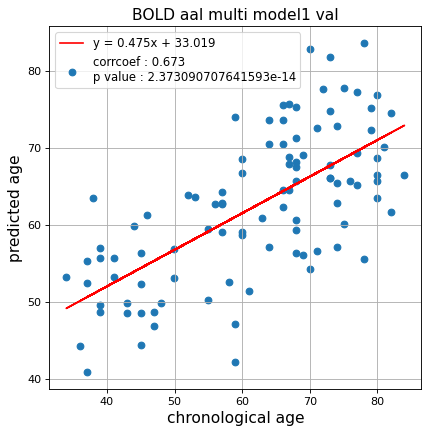

切片: 33.01868746687374
傾き: 0.474937169988851
Kfold: 2 ::: epoch: 100, loss: 0.03595403954386711, val loss: 0.6351840049028397
Kfold: 2 ::: epoch: 200, loss: 0.017583185663590066, val loss: 0.6295752227306366
Kfold: 2 ::: epoch: 300, loss: 0.014809709042310715, val loss: 0.6116226986050606
Kfold: 2 ::: epoch: 400, loss: 0.01025824721616048, val loss: 0.5926250740885735
Kfold: 2 ::: epoch: 500, loss: 0.007003973882931929, val loss: 0.6036736518144608
Kfold: 2 ::: epoch: 600, loss: 0.008048670545506936, val loss: 0.5892254114151001
Kfold: 2 ::: epoch: 700, loss: 0.0070279602749416465, val loss: 0.5804717503488064
Kfold: 2 ::: epoch: 800, loss: 0.005843781866133213, val loss: 0.5751590579748154
Kfold: 2 ::: epoch: 900, loss: 0.005648360623476597, val loss: 0.5752968266606331
Kfold: 2 ::: epoch: 1000, loss: 0.006111914596448724, val loss: 0.5593641400337219
save_epochs:959
best val loss:0.5557170175015926


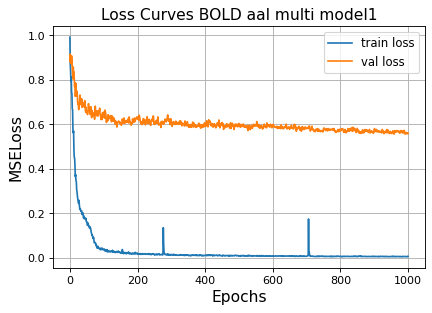

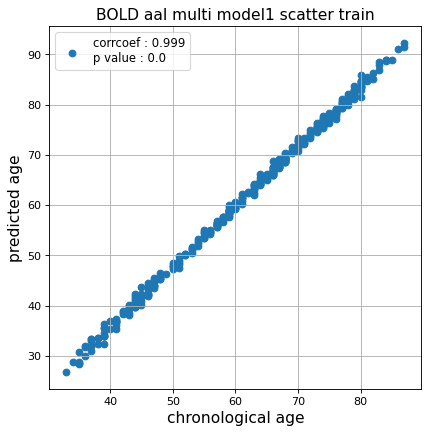

r^2 train data:  0.9597340632742462


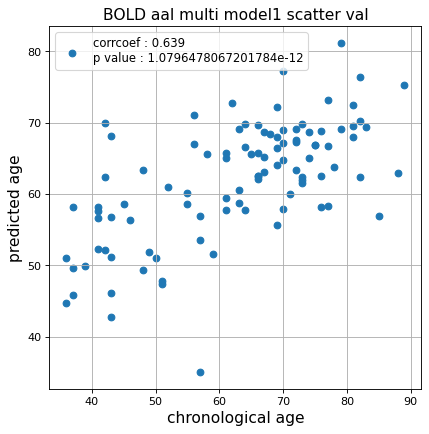

r^2 val data:  0.40366257101129577


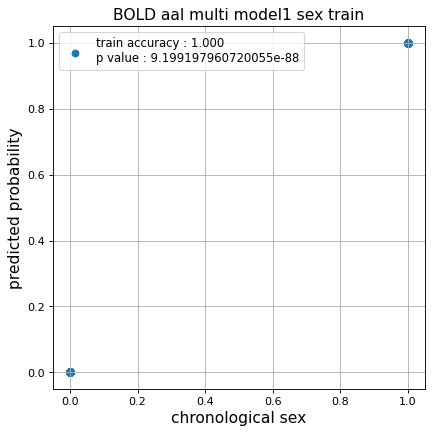

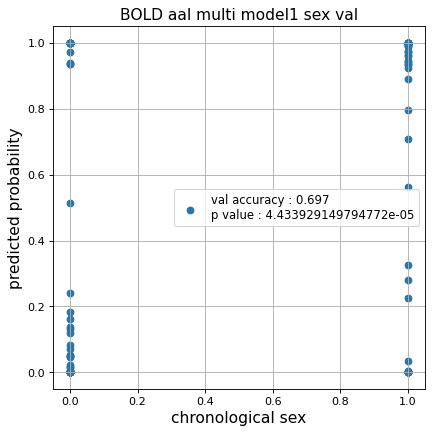

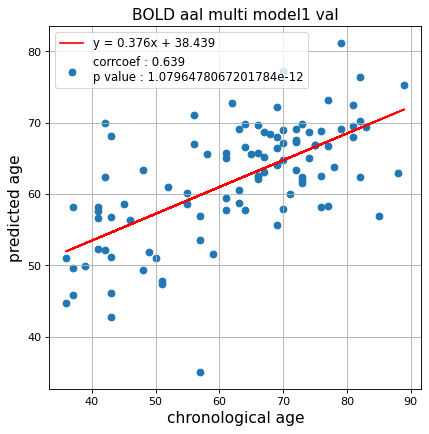

切片: 38.43916667299864
傾き: 0.375678125777175
Kfold: 3 ::: epoch: 100, loss: 0.034841291749706634, val loss: 0.5048314929008484
Kfold: 3 ::: epoch: 200, loss: 0.019630759882812317, val loss: 0.5002745538949966
Kfold: 3 ::: epoch: 300, loss: 0.0119975173416046, val loss: 0.49141309410333633
Kfold: 3 ::: epoch: 400, loss: 0.010534356813877821, val loss: 0.47742266952991486
Kfold: 3 ::: epoch: 500, loss: 0.008017833380458446, val loss: 0.5005334690213203
early stopping
save_epochs:318
best val loss:0.46750442311167717


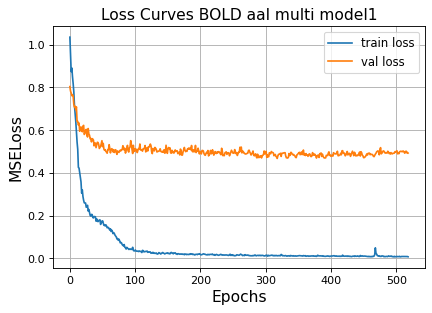

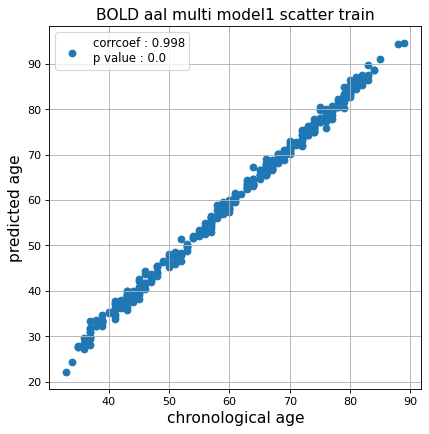

r^2 train data:  0.9365084499007678


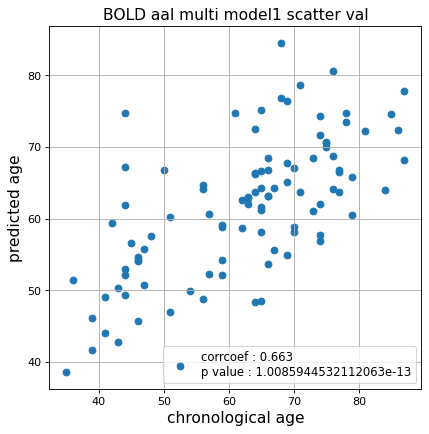

r^2 val data:  0.4335919809530162


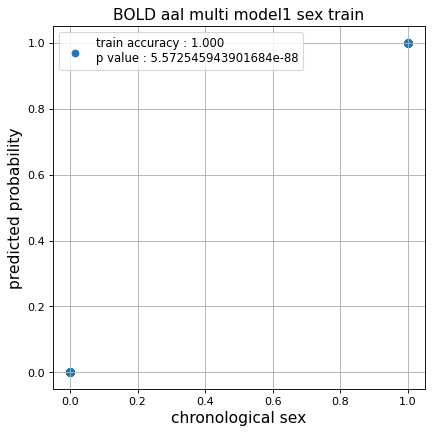

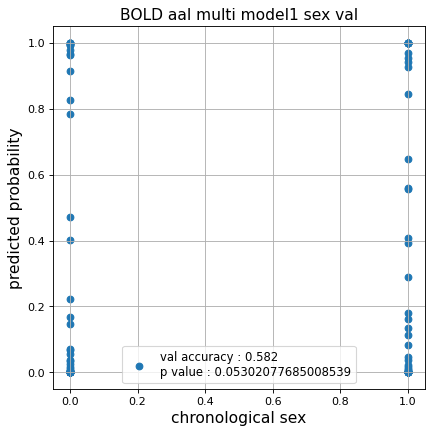

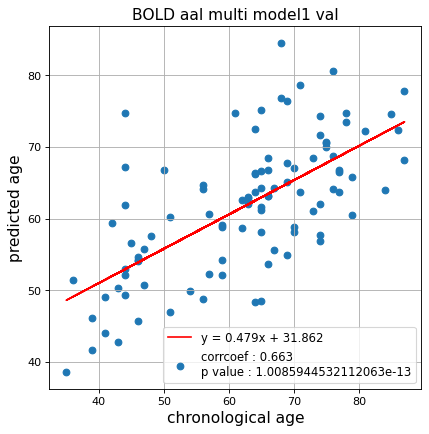

切片: 31.862223282817588
傾き: 0.4786829266656672
Kfold: 4 ::: epoch: 100, loss: 0.045672075966229804, val loss: 0.6072710752487183
Kfold: 4 ::: epoch: 200, loss: 0.015254870164566316, val loss: 0.5557622909545898
Kfold: 4 ::: epoch: 300, loss: 0.01231855286571842, val loss: 0.5320525094866753
Kfold: 4 ::: epoch: 400, loss: 0.009896648044769581, val loss: 0.5226863697171211
Kfold: 4 ::: epoch: 500, loss: 0.008657924795093445, val loss: 0.5126508325338364
Kfold: 4 ::: epoch: 600, loss: 0.006354788533197, val loss: 0.5043621510267258
Kfold: 4 ::: epoch: 700, loss: 0.006336894996750813, val loss: 0.47285813838243484
Kfold: 4 ::: epoch: 800, loss: 0.005765696244242673, val loss: 0.47846660017967224
Kfold: 4 ::: epoch: 900, loss: 0.004277456856261079, val loss: 0.47372840344905853
Kfold: 4 ::: epoch: 1000, loss: 0.003687456760627146, val loss: 0.4681689590215683
save_epochs:846
best val loss:0.45058900117874146


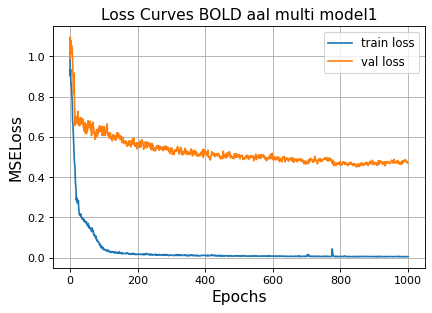

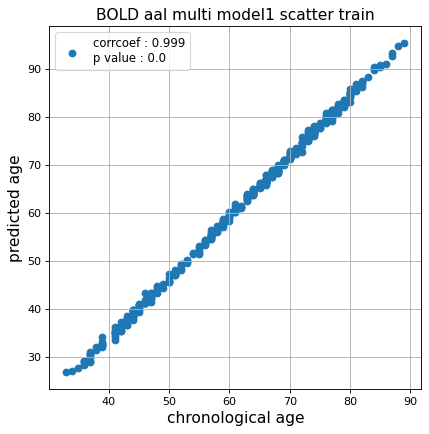

r^2 train data:  0.9282250744708773


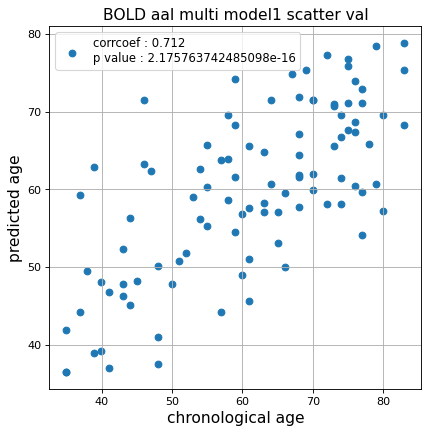

r^2 val data:  0.4902520951679108


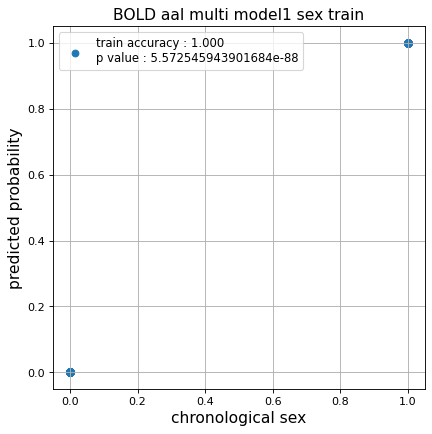

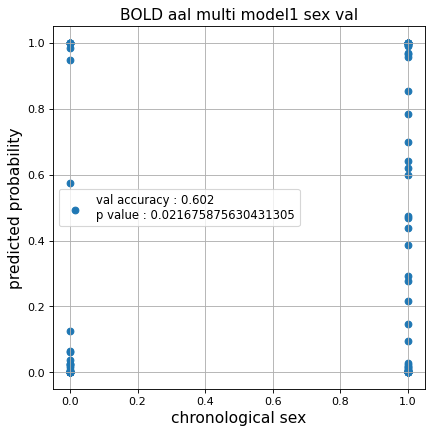

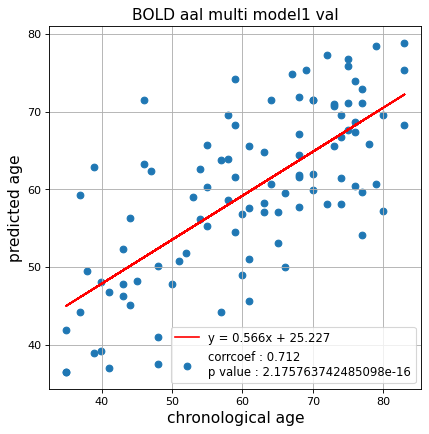

切片: 25.226516783393997
傾き: 0.5660294006941274
Kfold: 5 ::: epoch: 100, loss: 0.03574096096249727, val loss: 0.796618789434433
Kfold: 5 ::: epoch: 200, loss: 0.034516191038374715, val loss: 0.7766000926494598
Kfold: 5 ::: epoch: 300, loss: 0.015125286550476002, val loss: 0.7652516514062881
Kfold: 5 ::: epoch: 400, loss: 0.010714469728274988, val loss: 0.7264147698879242
Kfold: 5 ::: epoch: 500, loss: 0.009391429010205544, val loss: 0.7411130368709564
Kfold: 5 ::: epoch: 600, loss: 0.007250914887453501, val loss: 0.7357877194881439
Kfold: 5 ::: epoch: 700, loss: 0.0061704053077846766, val loss: 0.7141772508621216
Kfold: 5 ::: epoch: 800, loss: 0.004293432172674399, val loss: 0.7284223735332489
Kfold: 5 ::: epoch: 900, loss: 0.00402836250857665, val loss: 0.7255570292472839
early stopping
save_epochs:723
best val loss:0.6863207370042801


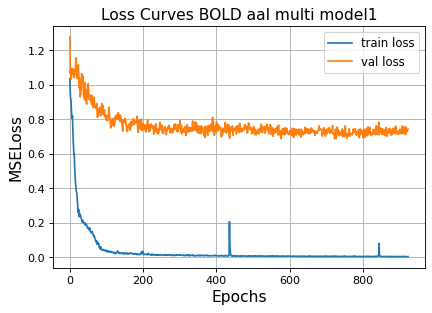

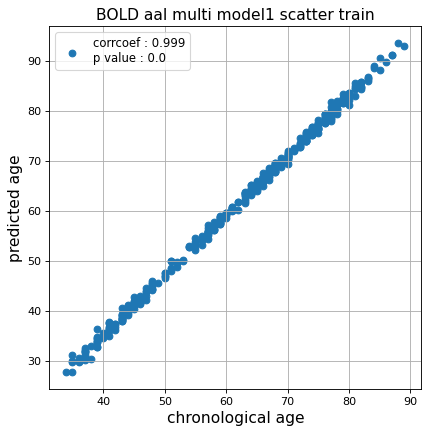

r^2 train data:  0.9584313111452915


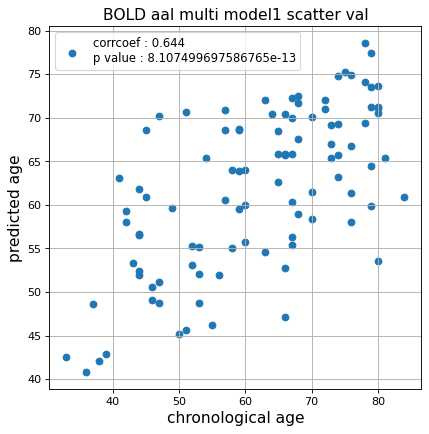

r^2 val data:  0.4128516457649375


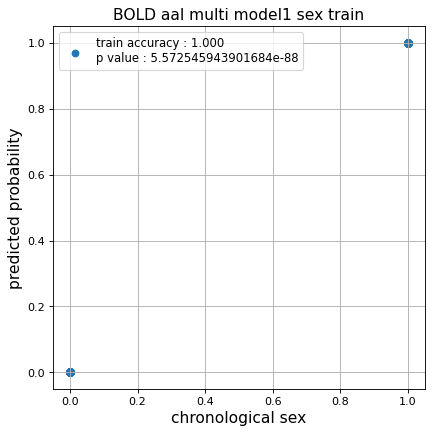

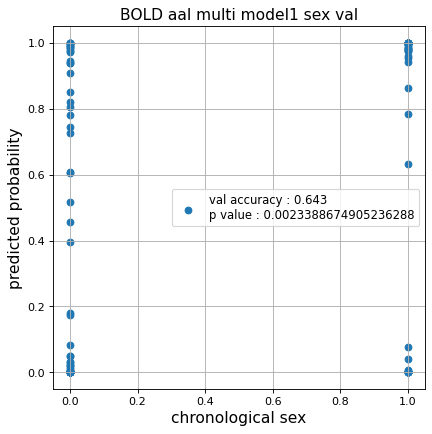

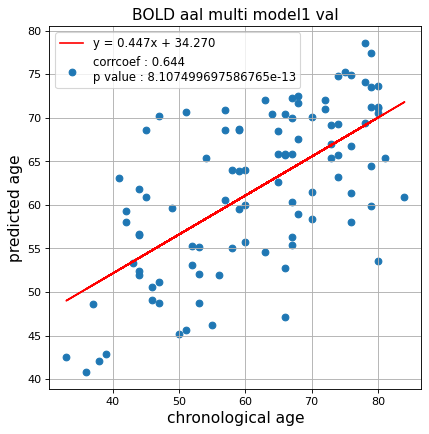

切片: 34.269865150222536
傾き: 0.44665598962305014
CPU times: user 1h 46min 47s, sys: 14min 40s, total: 2h 1min 28s
Wall time: 2h 1min 39s


In [16]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_1  = []
test_pred_aal_corrected_1  = []
test_label_aal_1 = []
test_idx_aal_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label= train_model(data_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 256,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 1024,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.2,
                                                           fc_drop = 0.1,
                                                           title = 'ROI aal multi model1'
                                                          )
    
    test_pred_aal_1.append(test_pred)
    test_pred_aal_corrected_1.append(test_pred_corrected)
    test_label_aal_1.append(test_label)
    test_idx_aal_1.append(test_idx)

### ROI 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.160734807069485, val loss: 0.7194619029760361
Kfold: 1 ::: epoch: 200, loss: 0.03730153364057724, val loss: 0.6794650256633759
Kfold: 1 ::: epoch: 300, loss: 0.015453176393818397, val loss: 0.6644754409790039
Kfold: 1 ::: epoch: 400, loss: 0.011334488419099497, val loss: 0.661118671298027
Kfold: 1 ::: epoch: 500, loss: 0.010262669028284458, val loss: 0.6410388052463531
Kfold: 1 ::: epoch: 600, loss: 0.010014111856715037, val loss: 0.632446713745594
Kfold: 1 ::: epoch: 700, loss: 0.010140164576184291, val loss: 0.6255713254213333
Kfold: 1 ::: epoch: 800, loss: 0.009335546288639307, val loss: 0.6169941574335098
Kfold: 1 ::: epoch: 900, loss: 0.008186024971879445, val loss: 0.6028395295143127
Kfold: 1 ::: epoch: 1000, loss: 0.006430292287125037, val loss: 0.5811627022922039
save_epochs:941
best val loss:0.5731337033212185


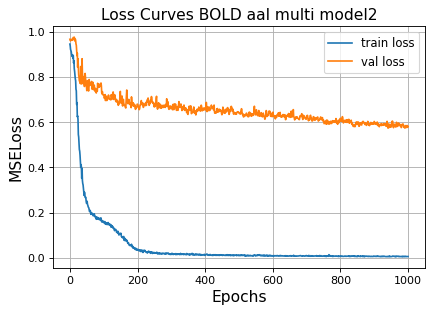

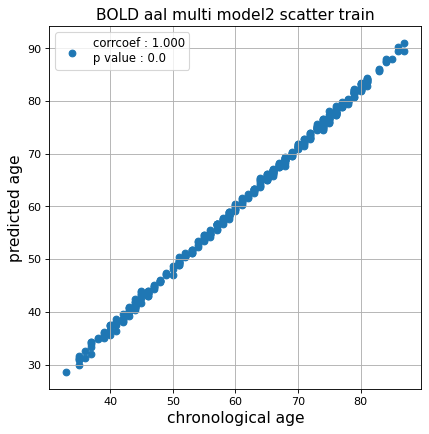

r^2 train data:  0.9775697344120802


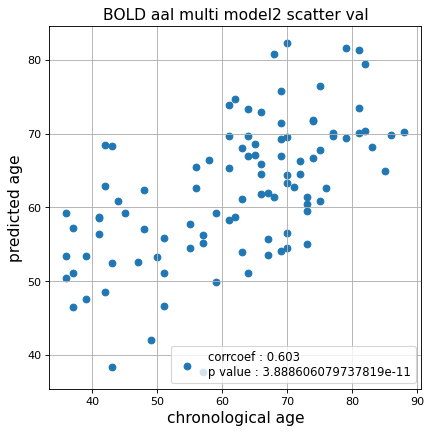

r^2 val data:  0.3581316238001525


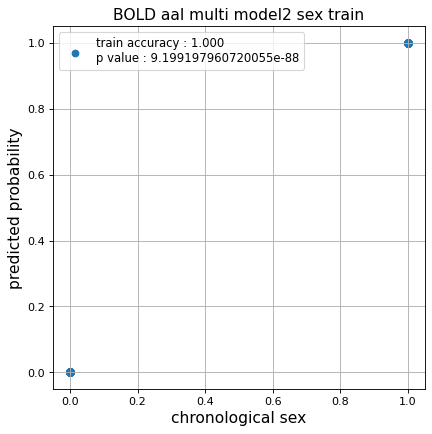

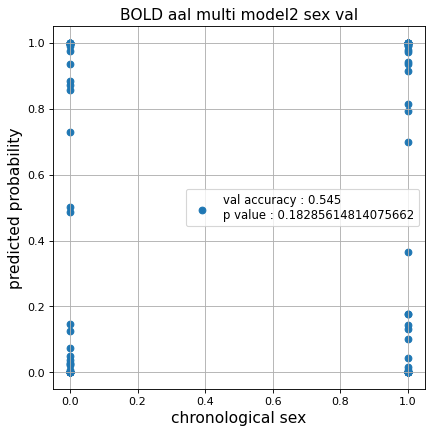

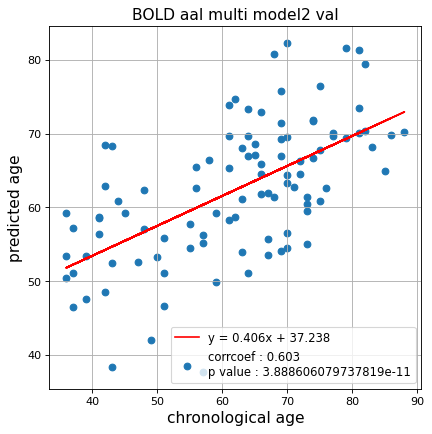

切片: 37.237551582715966
傾き: 0.40554125008726
Kfold: 2 ::: epoch: 100, loss: 0.16105832961889413, val loss: 0.6431050300598145
Kfold: 2 ::: epoch: 200, loss: 0.038176896337133184, val loss: 0.5875692963600159
Kfold: 2 ::: epoch: 300, loss: 0.0176626078497905, val loss: 0.5852022022008896
Kfold: 2 ::: epoch: 400, loss: 0.013650225869451579, val loss: 0.5938821583986282
Kfold: 2 ::: epoch: 500, loss: 0.01719717910656562, val loss: 0.5892402082681656
Kfold: 2 ::: epoch: 600, loss: 0.009997420854723224, val loss: 0.577892541885376
Kfold: 2 ::: epoch: 700, loss: 0.010726074401575785, val loss: 0.5746524706482887
Kfold: 2 ::: epoch: 800, loss: 0.007941840843369182, val loss: 0.5760241001844406
Kfold: 2 ::: epoch: 900, loss: 0.006879723308464656, val loss: 0.5673366561532021
Kfold: 2 ::: epoch: 1000, loss: 0.007850930023078736, val loss: 0.5491470992565155
save_epochs:997
best val loss:0.548477366566658


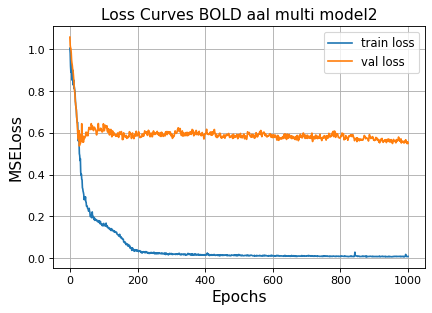

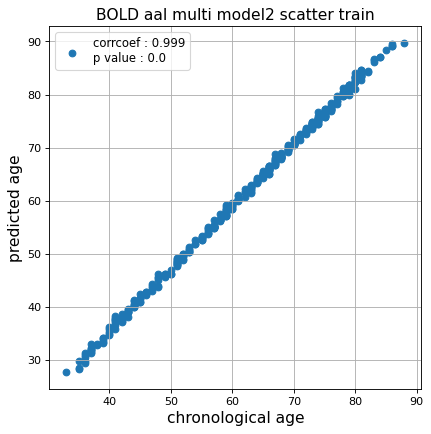

r^2 train data:  0.965663845163598


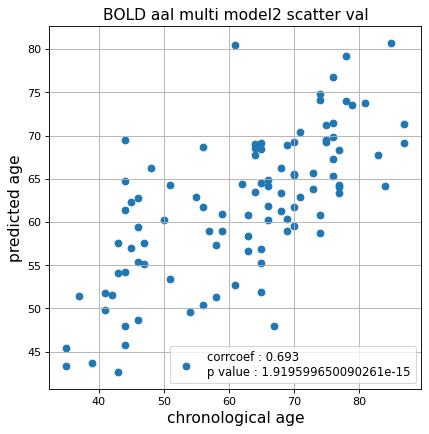

r^2 val data:  0.47505784020145636


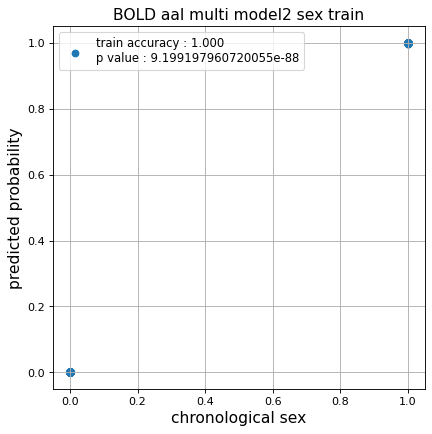

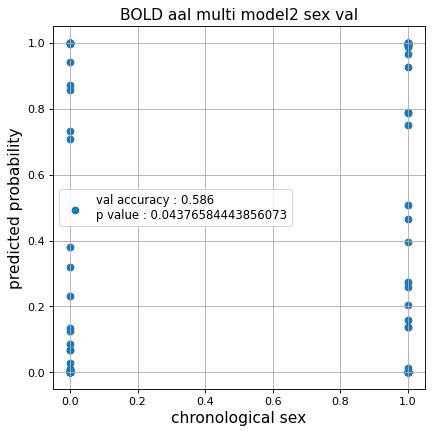

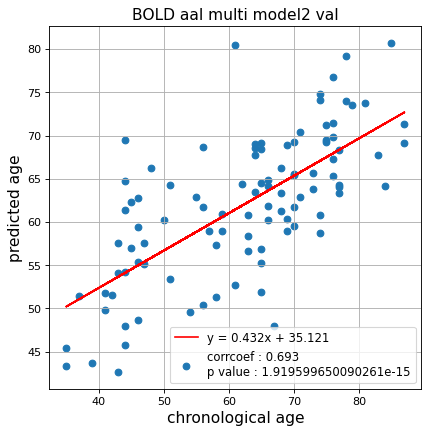

切片: 35.121393136884855
傾き: 0.4316655632038633
Kfold: 3 ::: epoch: 100, loss: 0.1533978386567189, val loss: 1.0024357438087463
Kfold: 3 ::: epoch: 200, loss: 0.04245359651171244, val loss: 0.9597255885601044
Kfold: 3 ::: epoch: 300, loss: 0.021939464988043673, val loss: 0.8786900043487549
Kfold: 3 ::: epoch: 400, loss: 0.013913203675586443, val loss: 0.8507407903671265
Kfold: 3 ::: epoch: 500, loss: 0.01189941164249411, val loss: 0.8281157165765762
Kfold: 3 ::: epoch: 600, loss: 0.011217836254777817, val loss: 0.7860824465751648
Kfold: 3 ::: epoch: 700, loss: 0.009377407608553767, val loss: 0.7899874597787857
Kfold: 3 ::: epoch: 800, loss: 0.009121791961101385, val loss: 0.7777700275182724
Kfold: 3 ::: epoch: 900, loss: 0.006813096598936961, val loss: 0.7546915262937546
Kfold: 3 ::: epoch: 1000, loss: 0.005643607170965809, val loss: 0.7310584336519241
save_epochs:955
best val loss:0.7261629849672318


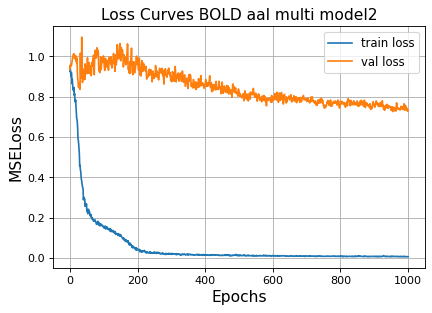

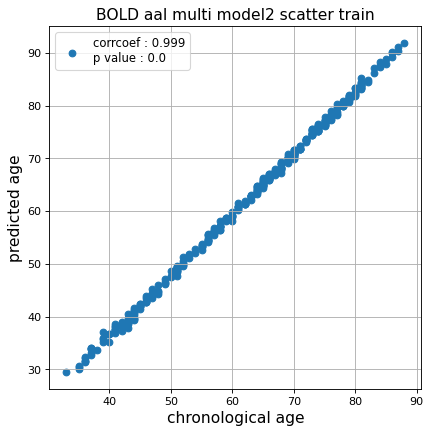

r^2 train data:  0.9731917990620206


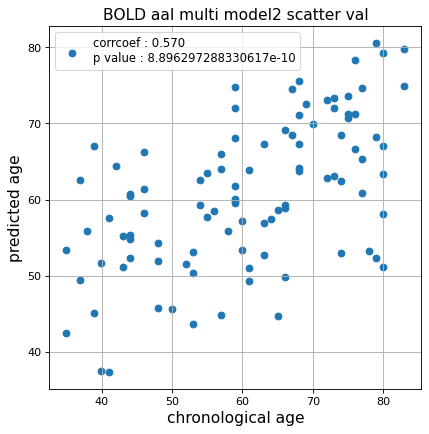

r^2 val data:  0.3038886677343473


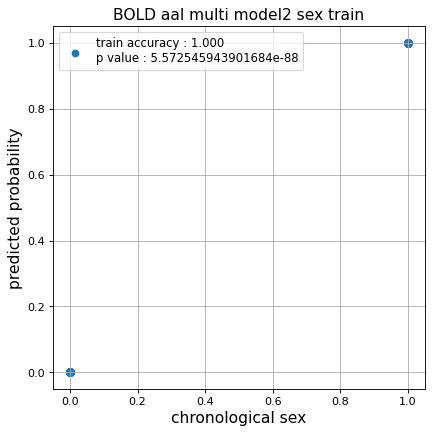

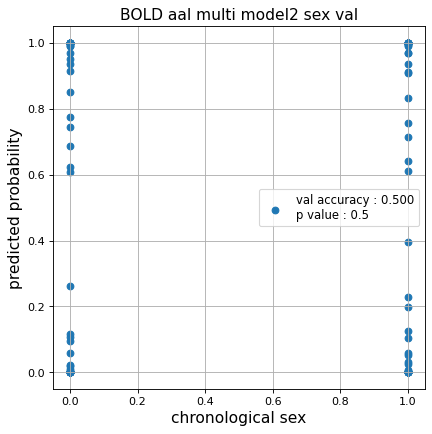

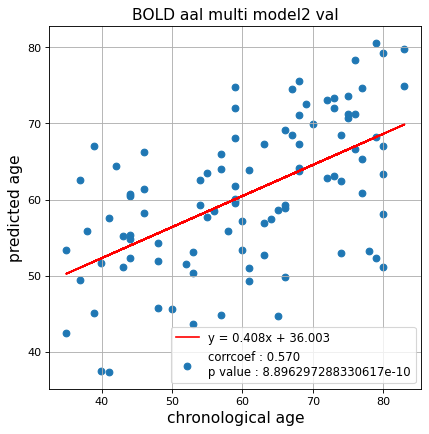

切片: 36.00339098915638
傾き: 0.4079399908465436
Kfold: 4 ::: epoch: 100, loss: 0.14808816061570093, val loss: 1.351025179028511
Kfold: 4 ::: epoch: 200, loss: 0.027181754605128214, val loss: 1.1998304426670074
Kfold: 4 ::: epoch: 300, loss: 0.01864188823562402, val loss: 1.1835829615592957
Kfold: 4 ::: epoch: 400, loss: 0.014040748696201123, val loss: 1.1162142902612686
Kfold: 4 ::: epoch: 500, loss: 0.012256459798663855, val loss: 1.0950862616300583
Kfold: 4 ::: epoch: 600, loss: 0.010598430230927009, val loss: 1.0699792057275772
Kfold: 4 ::: epoch: 700, loss: 0.010025608389136883, val loss: 1.038473129272461
Kfold: 4 ::: epoch: 800, loss: 0.009293698526632328, val loss: 1.0214087218046188
Kfold: 4 ::: epoch: 900, loss: 0.007724112186294336, val loss: 1.0092620104551315
Kfold: 4 ::: epoch: 1000, loss: 0.006467194135229175, val loss: 1.0109339505434036
save_epochs:919
best val loss:0.9852514564990997


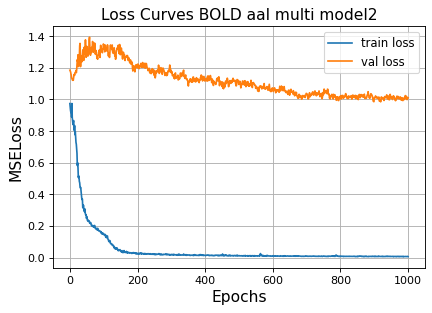

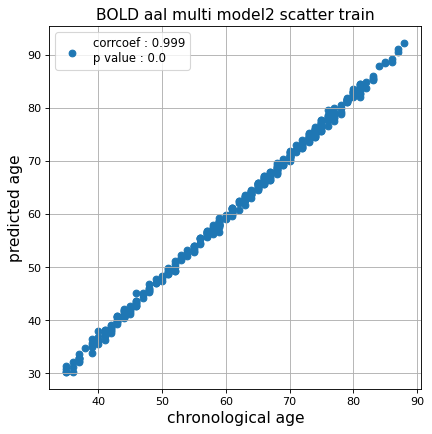

r^2 train data:  0.975410005169228


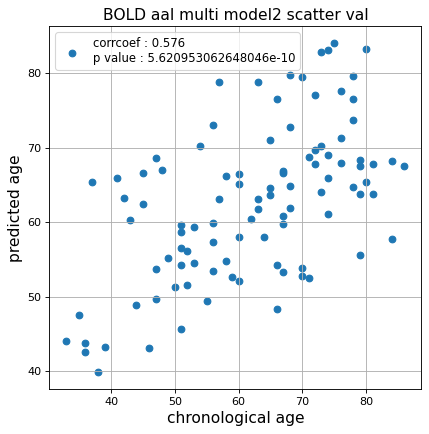

r^2 val data:  0.29255265337021474


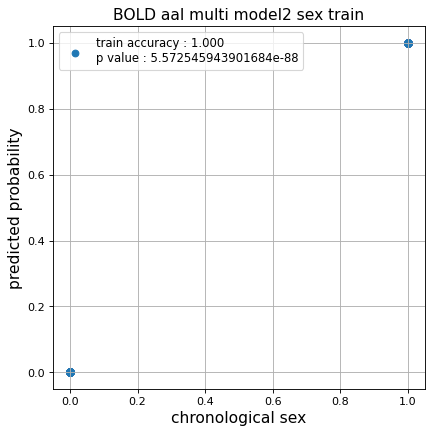

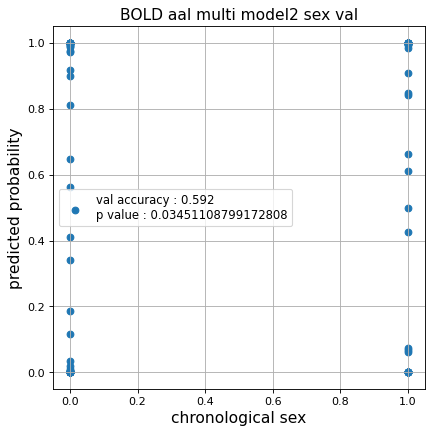

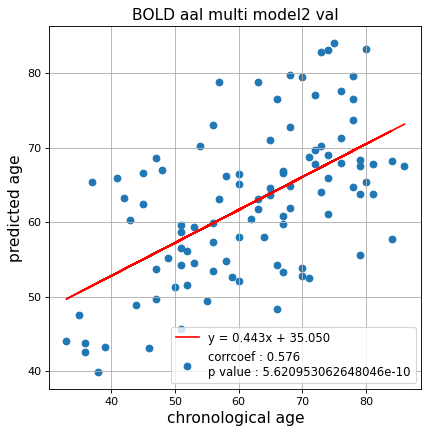

切片: 35.049738920198855
傾き: 0.4428461762298259
Kfold: 5 ::: epoch: 100, loss: 0.17687747684808877, val loss: 1.1299041211605072
Kfold: 5 ::: epoch: 200, loss: 0.03274566673028927, val loss: 0.9533104002475739
Kfold: 5 ::: epoch: 300, loss: 0.022913678620870296, val loss: 0.8858973383903503
Kfold: 5 ::: epoch: 400, loss: 0.01748172637934868, val loss: 0.8520074486732483
Kfold: 5 ::: epoch: 500, loss: 0.01493505947291851, val loss: 0.8119733035564423
Kfold: 5 ::: epoch: 600, loss: 0.010871273393814381, val loss: 0.7959988564252853
Kfold: 5 ::: epoch: 700, loss: 0.011449893900694756, val loss: 0.7812760323286057
Kfold: 5 ::: epoch: 800, loss: 0.0073446538657523115, val loss: 0.7823494598269463
Kfold: 5 ::: epoch: 900, loss: 0.007591826769594963, val loss: 0.7892536669969559
Kfold: 5 ::: epoch: 1000, loss: 0.007903201505541801, val loss: 0.8106142058968544
save_epochs:862
best val loss:0.7605523467063904


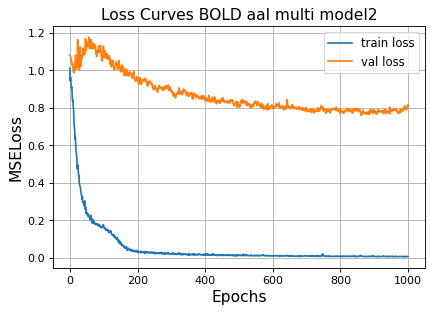

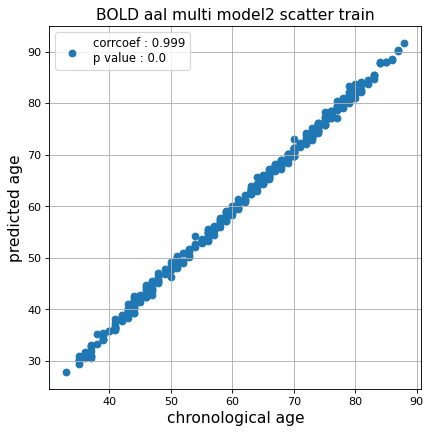

r^2 train data:  0.9717609089083102


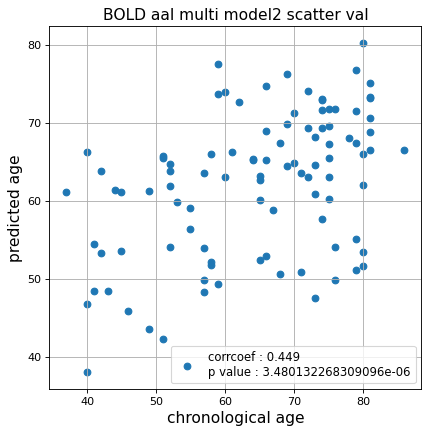

r^2 val data:  0.09596642076429207


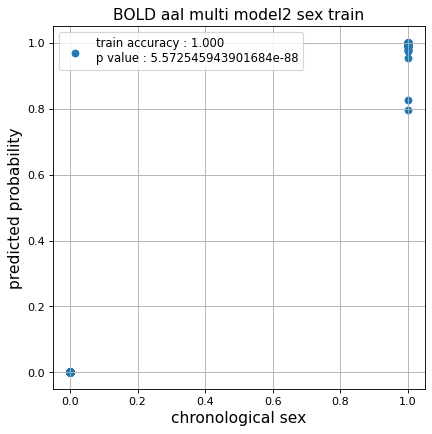

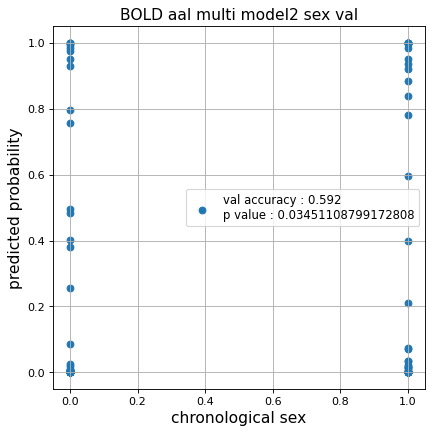

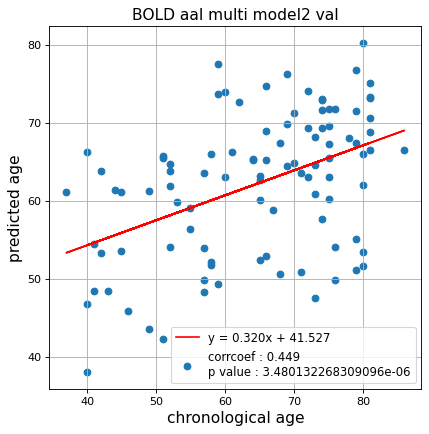

切片: 41.52705785343788
傾き: 0.31969403432199933
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.1582923772243353, val loss: 0.8398026674985886
Kfold: 1 ::: epoch: 200, loss: 0.031507992543853246, val loss: 0.777563139796257
Kfold: 1 ::: epoch: 300, loss: 0.01668327129804171, val loss: 0.7401471883058548
Kfold: 1 ::: epoch: 400, loss: 0.012589176507809987, val loss: 0.7282840758562088
Kfold: 1 ::: epoch: 500, loss: 0.009961275204729576, val loss: 0.6966536045074463
Kfold: 1 ::: epoch: 600, loss: 0.008782272442029072, val loss: 0.6693588942289352
Kfold: 1 ::: epoch: 700, loss: 0.009628000454260753, val loss: 0.6585890352725983
Kfold: 1 ::: epoch: 800, loss: 0.008804046298162295, val loss: 0.6616043597459793
Kfold: 1 ::: epoch: 900, loss: 0.009932755241886927, val loss: 0.6271549165248871
Kfold: 1 ::: epoch: 1000, loss: 0.006593472288491635, val loss: 0.6464762687683105
save_epochs:901
best val loss:0.6257545948028564


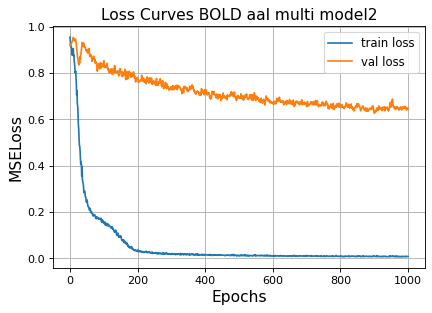

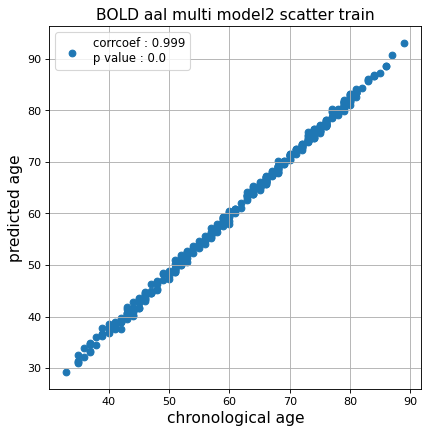

r^2 train data:  0.98209698296185


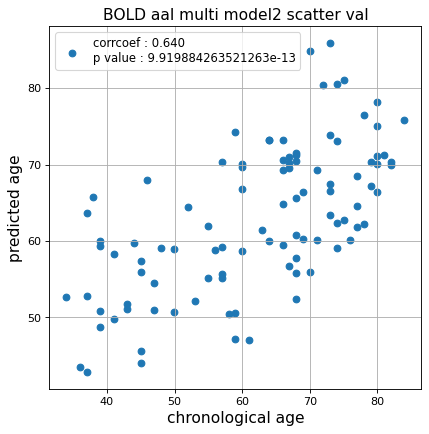

r^2 val data:  0.40146799517702536


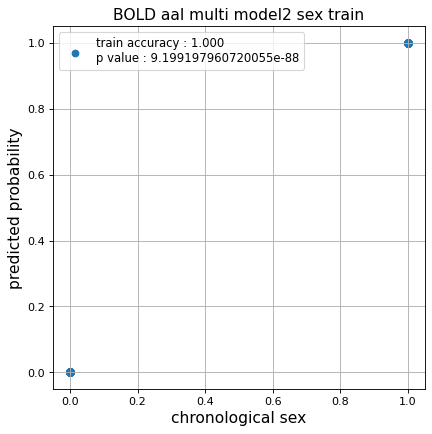

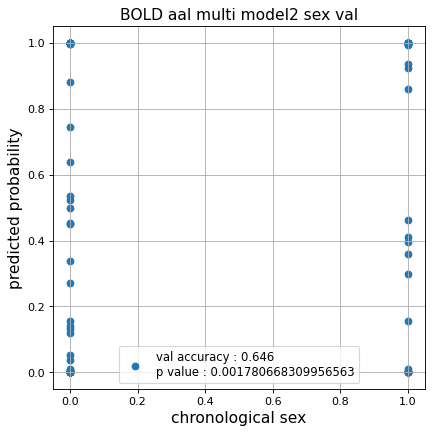

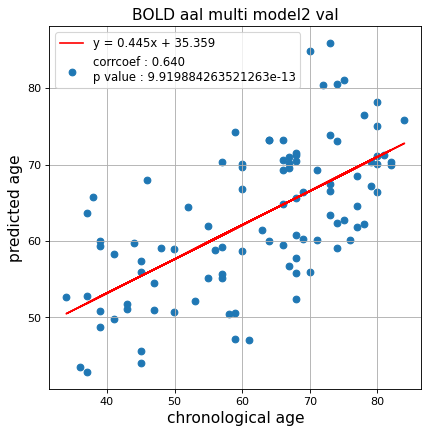

切片: 35.35874055080683
傾き: 0.44543163455754736
Kfold: 2 ::: epoch: 100, loss: 0.15925781658062568, val loss: 0.6315418481826782
Kfold: 2 ::: epoch: 200, loss: 0.04639131633134989, val loss: 0.6320100128650665
Kfold: 2 ::: epoch: 300, loss: 0.01698080013291194, val loss: 0.6362162381410599
Kfold: 2 ::: epoch: 400, loss: 0.014779748538365731, val loss: 0.6411914378404617
early stopping
save_epochs:230
best val loss:0.6036235988140106


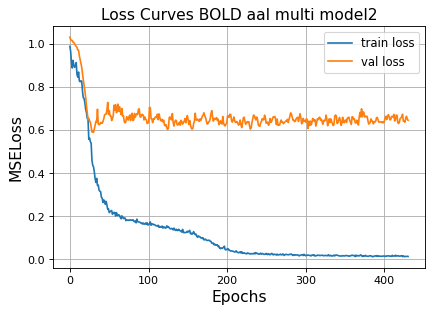

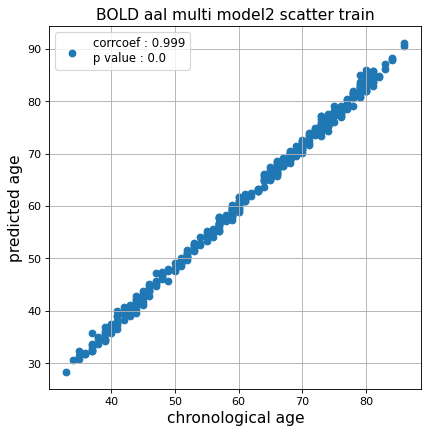

r^2 train data:  0.9692354801504245


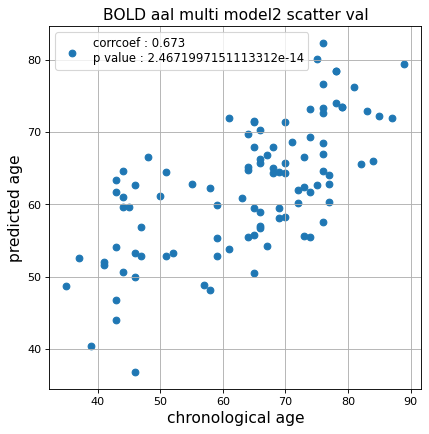

r^2 val data:  0.4404192653157113


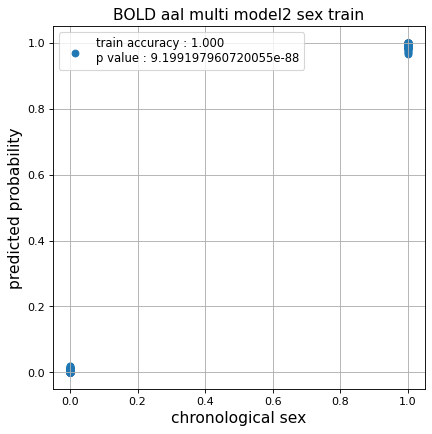

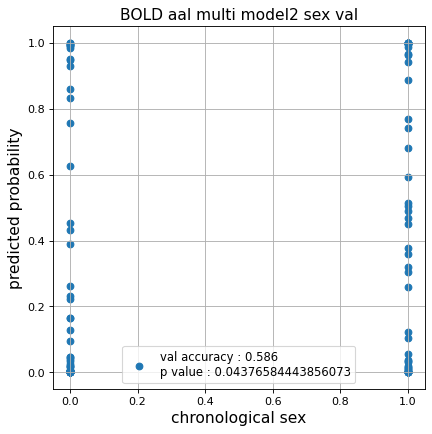

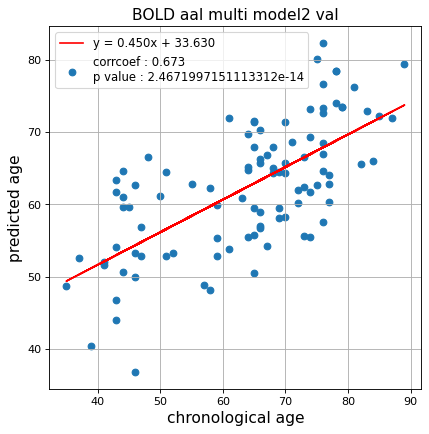

切片: 33.63033168540261
傾き: 0.4502398779978088
Kfold: 3 ::: epoch: 100, loss: 0.15195789360083067, val loss: 0.8088568150997162
Kfold: 3 ::: epoch: 200, loss: 0.026126432734040115, val loss: 0.6455683186650276
Kfold: 3 ::: epoch: 300, loss: 0.016913735021192294, val loss: 0.5818336009979248
Kfold: 3 ::: epoch: 400, loss: 0.016176895811580695, val loss: 0.5473006889224052
Kfold: 3 ::: epoch: 500, loss: 0.012472046682467828, val loss: 0.5423411428928375
Kfold: 3 ::: epoch: 600, loss: 0.013118209335236596, val loss: 0.5451129749417305
Kfold: 3 ::: epoch: 700, loss: 0.0077100309471671395, val loss: 0.5400227084755898
Kfold: 3 ::: epoch: 800, loss: 0.00888014491647482, val loss: 0.5291792005300522
Kfold: 3 ::: epoch: 900, loss: 0.00781490782705637, val loss: 0.5137021616101265
Kfold: 3 ::: epoch: 1000, loss: 0.0072300237639305685, val loss: 0.507187157869339
save_epochs:819
best val loss:0.48059941828250885


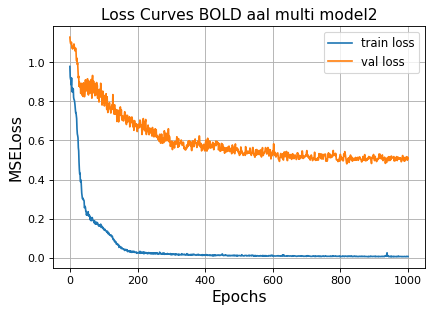

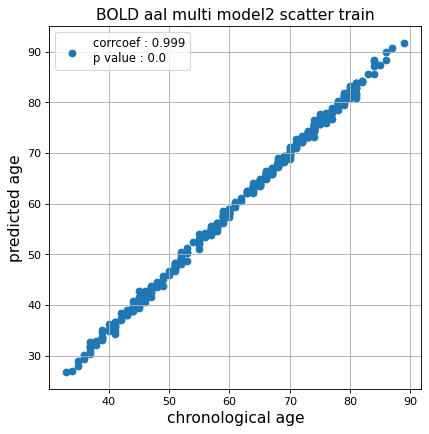

r^2 train data:  0.9601268018315129


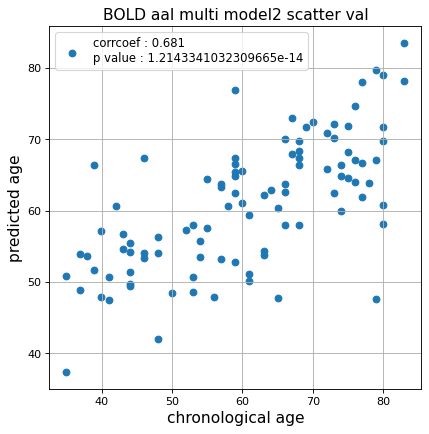

r^2 val data:  0.4630275353194323


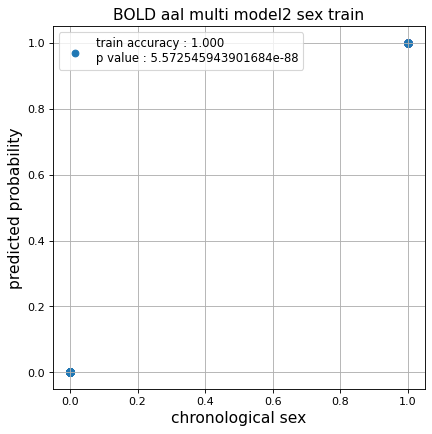

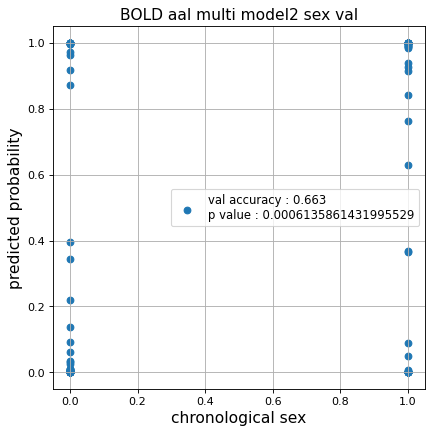

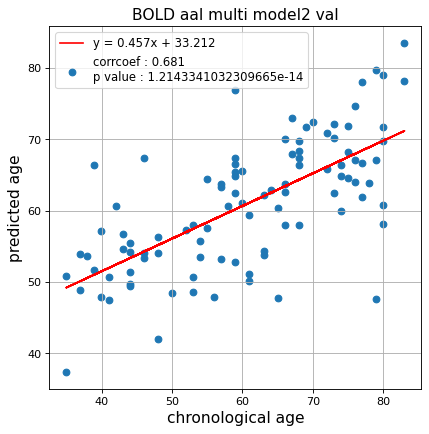

切片: 33.21209073217645
傾き: 0.4574983609931478
Kfold: 4 ::: epoch: 100, loss: 0.15321202117663163, val loss: 1.4519858658313751
Kfold: 4 ::: epoch: 200, loss: 0.03454969493815532, val loss: 1.3117621541023254
Kfold: 4 ::: epoch: 300, loss: 0.016616558763556756, val loss: 1.2123968452215195
Kfold: 4 ::: epoch: 400, loss: 0.01752702949138788, val loss: 1.1863767504692078
Kfold: 4 ::: epoch: 500, loss: 0.012641702098055528, val loss: 1.1500913202762604
Kfold: 4 ::: epoch: 600, loss: 0.010846961970226122, val loss: 1.1543391346931458
Kfold: 4 ::: epoch: 700, loss: 0.010615286166564776, val loss: 1.1205800026655197
Kfold: 4 ::: epoch: 800, loss: 0.00889581644262832, val loss: 1.1123790740966797
early stopping
save_epochs:694
best val loss:1.0726277530193329


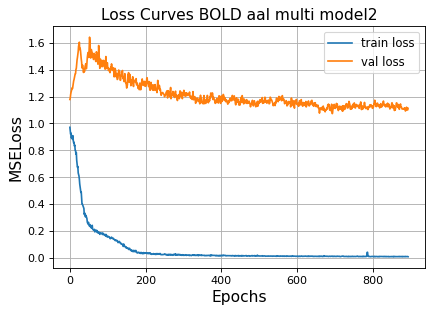

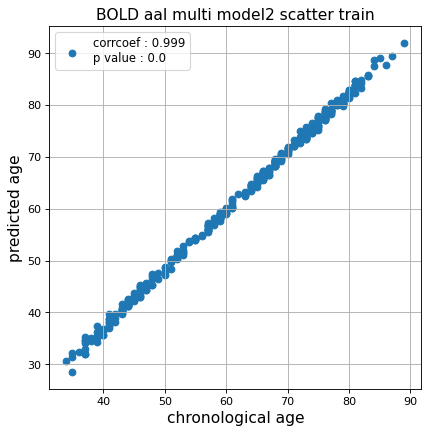

r^2 train data:  0.9797850813090729


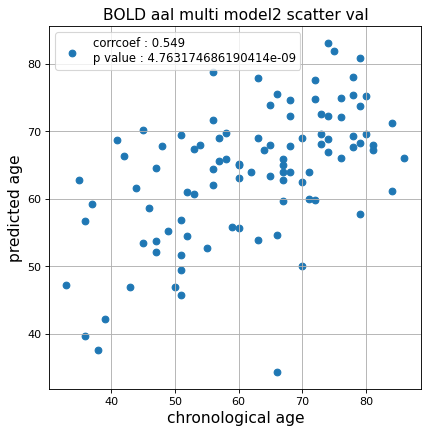

r^2 val data:  0.2487922789953494


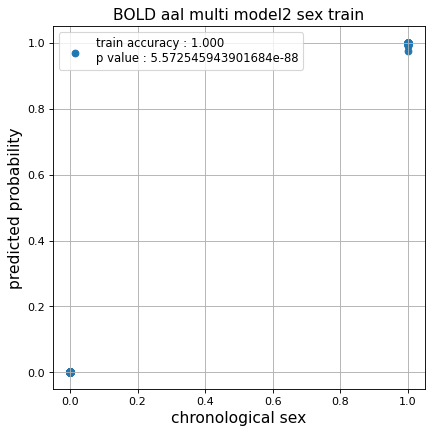

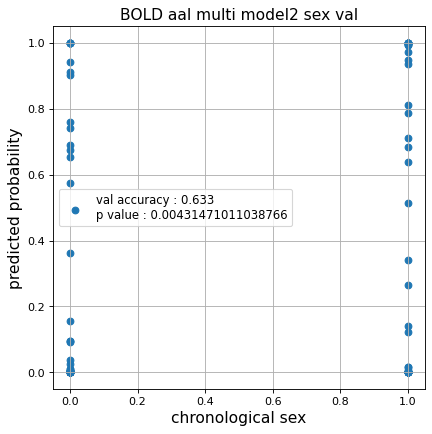

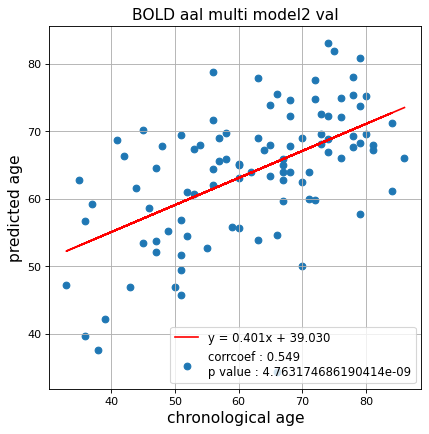

切片: 39.03023124922298
傾き: 0.4011524995652046
Kfold: 5 ::: epoch: 100, loss: 0.142824510542246, val loss: 0.9132685661315918
Kfold: 5 ::: epoch: 200, loss: 0.02603126116670095, val loss: 0.8616146296262741
Kfold: 5 ::: epoch: 300, loss: 0.01724686946433324, val loss: 0.8180786073207855
Kfold: 5 ::: epoch: 400, loss: 0.013197605247394396, val loss: 0.7938584983348846
Kfold: 5 ::: epoch: 500, loss: 0.011159322367837796, val loss: 0.7944406419992447
Kfold: 5 ::: epoch: 600, loss: 0.011187530731639037, val loss: 0.8006161153316498
Kfold: 5 ::: epoch: 700, loss: 0.008925226946862845, val loss: 0.7638830989599228
Kfold: 5 ::: epoch: 800, loss: 0.009793320025962133, val loss: 0.7517660334706306
Kfold: 5 ::: epoch: 900, loss: 0.00800994006343759, val loss: 0.7481098175048828
Kfold: 5 ::: epoch: 1000, loss: 0.006936836790723296, val loss: 0.7476252764463425
save_epochs:882
best val loss:0.7282048314809799


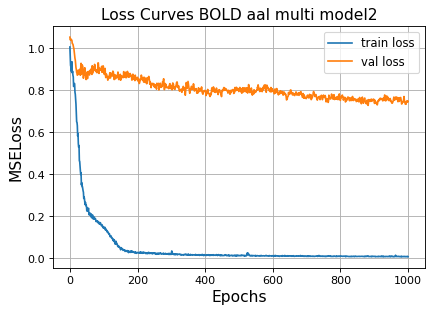

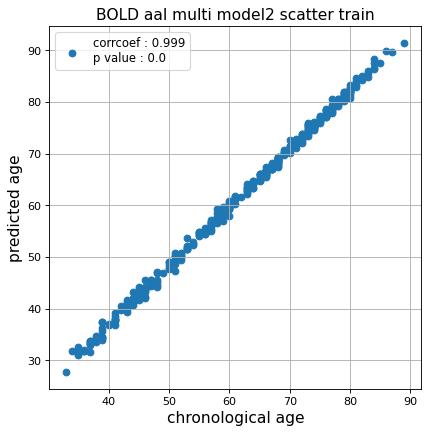

r^2 train data:  0.9795455052005464


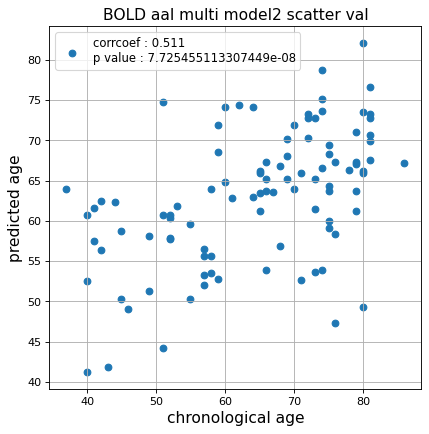

r^2 val data:  0.22536124377818223


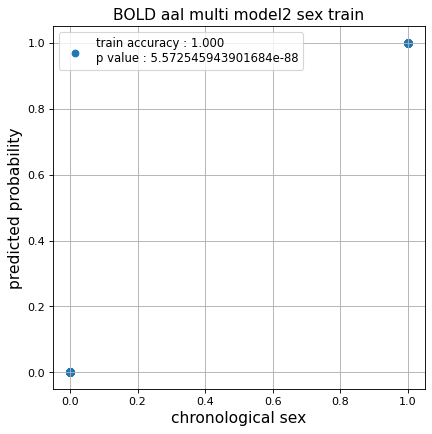

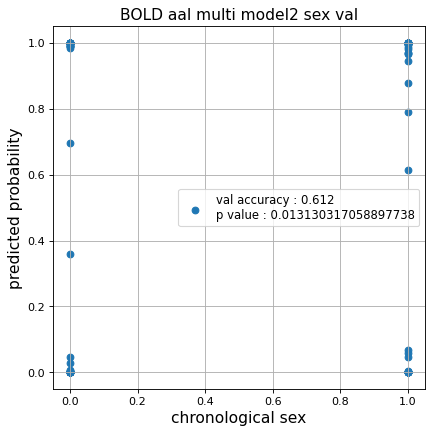

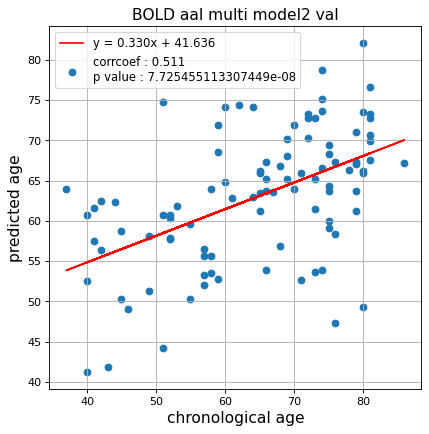

切片: 41.63608386491364
傾き: 0.3301331338354168
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.1531097304362517, val loss: 1.0504615157842636
Kfold: 1 ::: epoch: 200, loss: 0.035524899569841534, val loss: 0.9190186709165573
Kfold: 1 ::: epoch: 300, loss: 0.020725029449050244, val loss: 0.8344078212976456
Kfold: 1 ::: epoch: 400, loss: 0.015709358195845898, val loss: 0.7943742275238037
Kfold: 1 ::: epoch: 500, loss: 0.010958695712570962, val loss: 0.7670527249574661
Kfold: 1 ::: epoch: 600, loss: 0.009925359645142006, val loss: 0.7485772222280502
Kfold: 1 ::: epoch: 700, loss: 0.011440348345786333, val loss: 0.7260198071599007
Kfold: 1 ::: epoch: 800, loss: 0.008078826268991599, val loss: 0.7254332676529884
Kfold: 1 ::: epoch: 900, loss: 0.007840072736144066, val loss: 0.7001976072788239
Kfold: 1 ::: epoch: 1000, loss: 0.006719295902607532, val loss: 0.7057606503367424
save_epochs:993
best val loss:0.6879841387271881


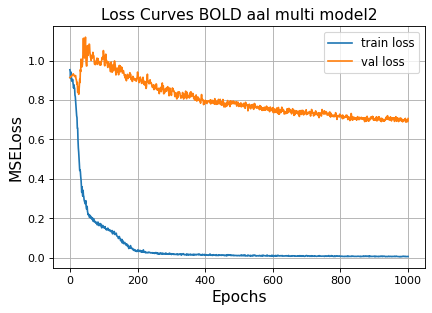

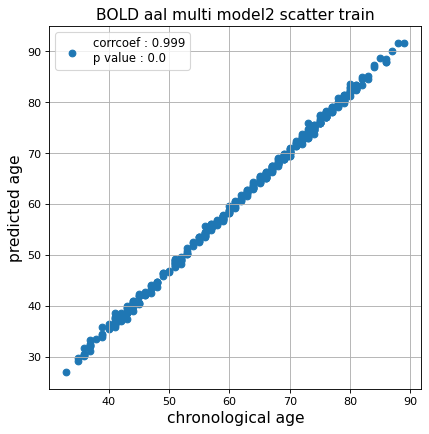

r^2 train data:  0.9696023773571504


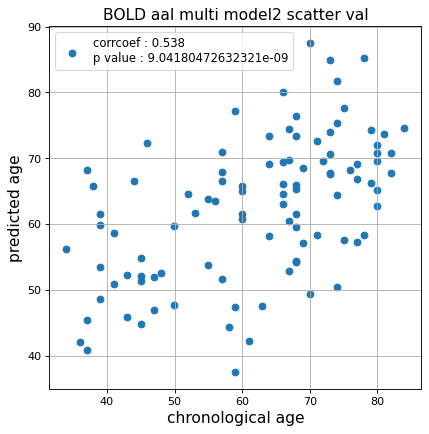

r^2 val data:  0.23016655579287337


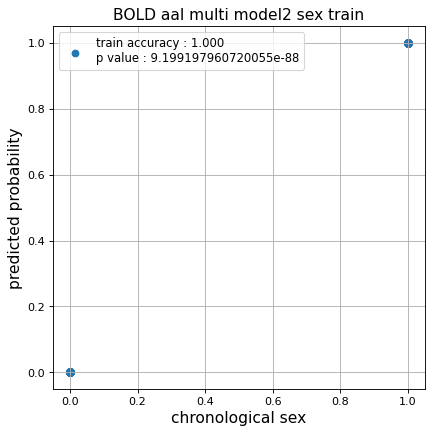

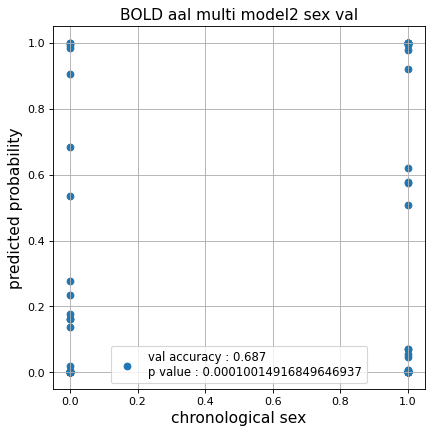

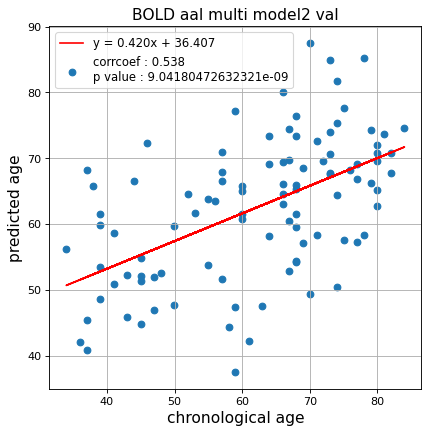

切片: 36.40716676090051
傾き: 0.42021528071628295
Kfold: 2 ::: epoch: 100, loss: 0.15648881403299478, val loss: 0.6810370534658432
Kfold: 2 ::: epoch: 200, loss: 0.04013698576734616, val loss: 0.6325723528862
Kfold: 2 ::: epoch: 300, loss: 0.01860245567961381, val loss: 0.6193091869354248
Kfold: 2 ::: epoch: 400, loss: 0.014391496132772703, val loss: 0.6052498631179333
Kfold: 2 ::: epoch: 500, loss: 0.012556519645910997, val loss: 0.5813491269946098
Kfold: 2 ::: epoch: 600, loss: 0.010155999388259191, val loss: 0.575581468641758
Kfold: 2 ::: epoch: 700, loss: 0.009465623933535356, val loss: 0.568595539778471
Kfold: 2 ::: epoch: 800, loss: 0.008664337631601553, val loss: 0.5643864572048187
Kfold: 2 ::: epoch: 900, loss: 0.00690355753669372, val loss: 0.5647514667361975
Kfold: 2 ::: epoch: 1000, loss: 0.0065430967280497914, val loss: 0.5602042339742184
save_epochs:935
best val loss:0.5517200231552124


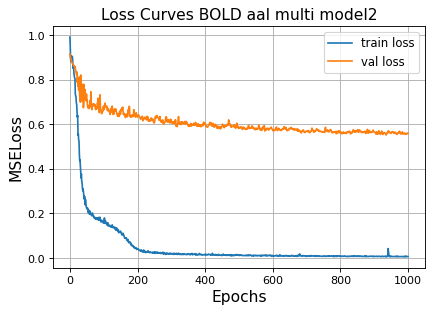

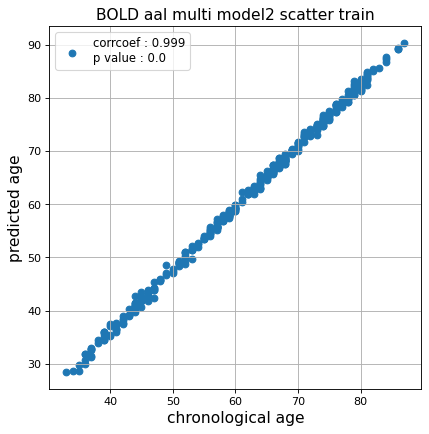

r^2 train data:  0.9714735137840257


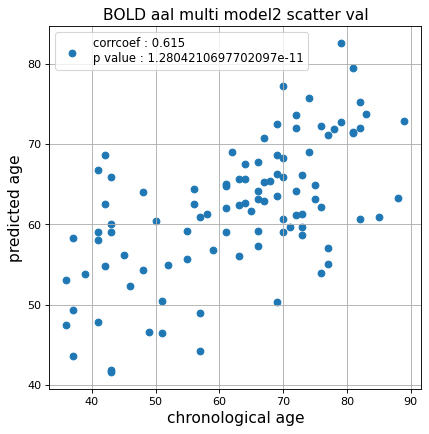

r^2 val data:  0.3751518021710142


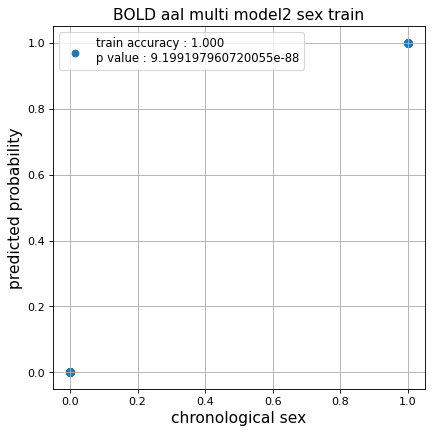

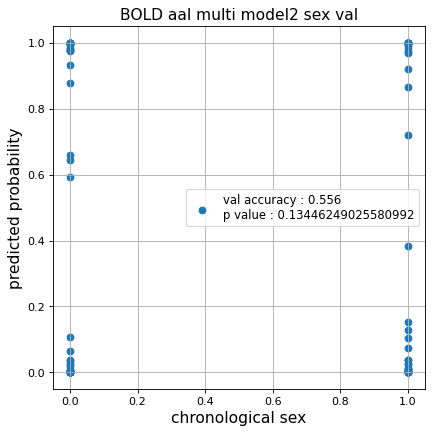

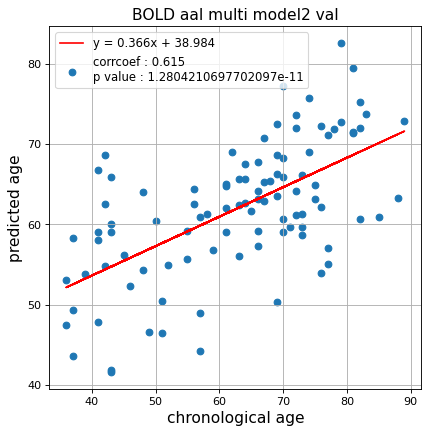

切片: 38.983604426874635
傾き: 0.36625774207056105
Kfold: 3 ::: epoch: 100, loss: 0.15277945880706495, val loss: 1.0014384388923645
Kfold: 3 ::: epoch: 200, loss: 0.03531809194156757, val loss: 1.0596697628498077
Kfold: 3 ::: epoch: 300, loss: 0.02126444088151822, val loss: 0.9682486951351166
Kfold: 3 ::: epoch: 400, loss: 0.014429245072488602, val loss: 0.977865070104599
Kfold: 3 ::: epoch: 500, loss: 0.015466289236568488, val loss: 0.9024300128221512
early stopping
save_epochs:344
best val loss:0.8592417240142822


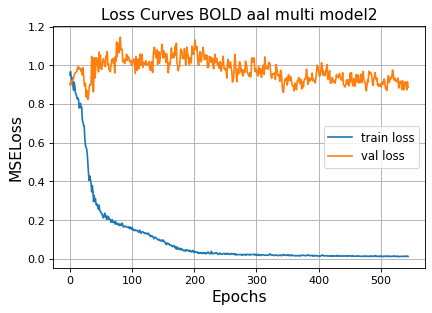

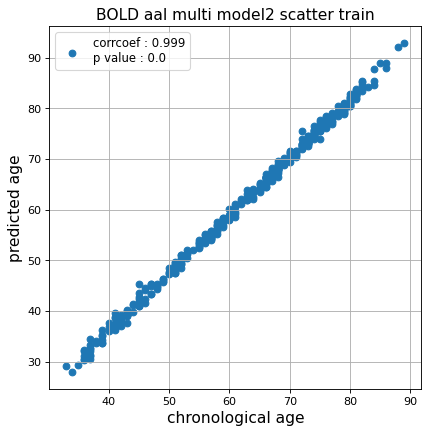

r^2 train data:  0.9739410740164192


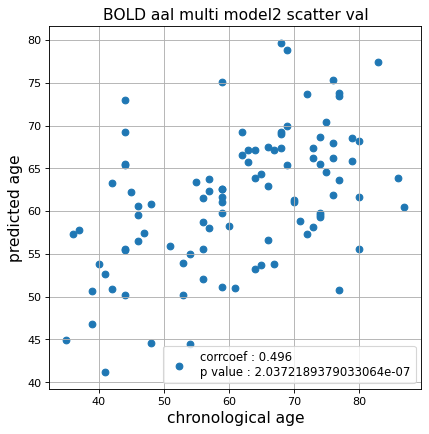

r^2 val data:  0.23683906499743312


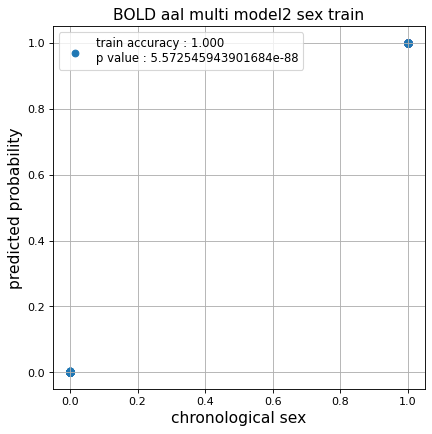

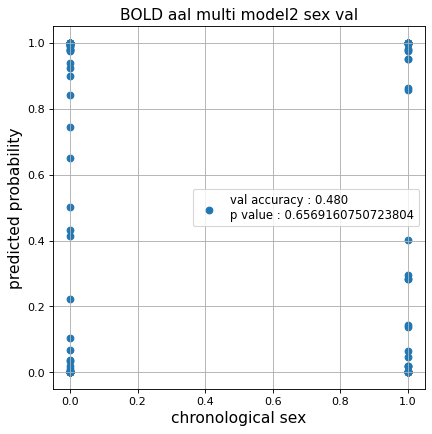

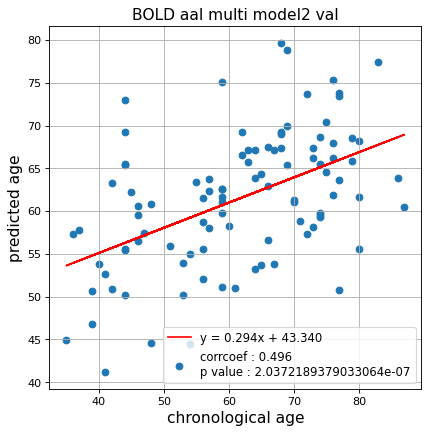

切片: 43.33961845552492
傾き: 0.2942870420787197
Kfold: 4 ::: epoch: 100, loss: 0.17040640918108133, val loss: 0.9089689701795578
Kfold: 4 ::: epoch: 200, loss: 0.04221897128109749, val loss: 0.9090113192796707
Kfold: 4 ::: epoch: 300, loss: 0.021822220287643947, val loss: 0.9006229937076569
Kfold: 4 ::: epoch: 400, loss: 0.01801649058380952, val loss: 0.9006551951169968
early stopping
save_epochs:264
best val loss:0.8595563322305679


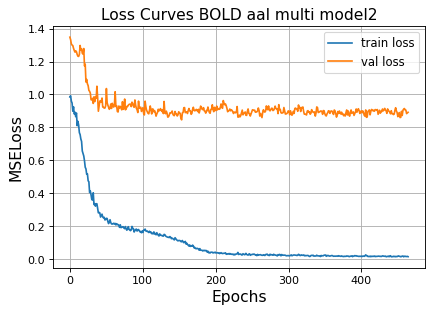

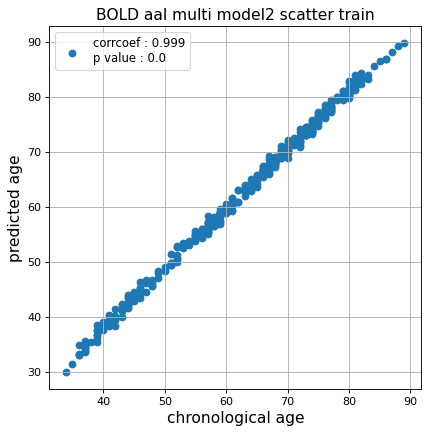

r^2 train data:  0.9906451534835622


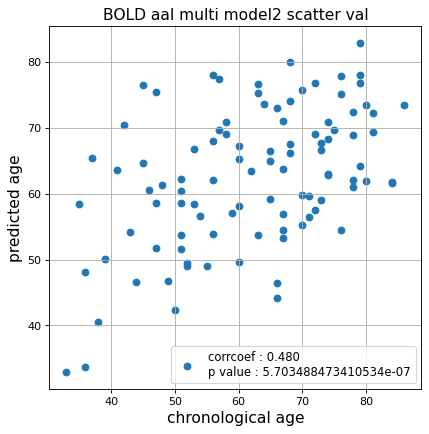

r^2 val data:  0.1389311885942518


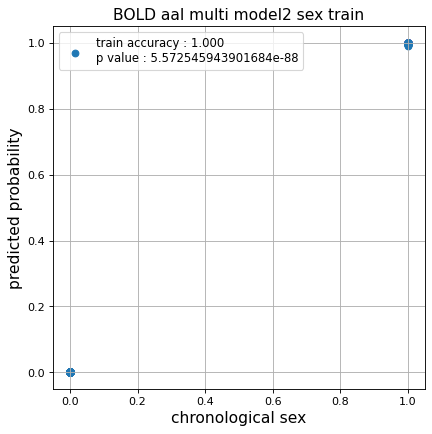

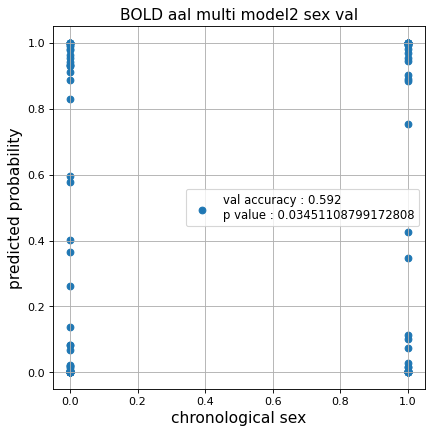

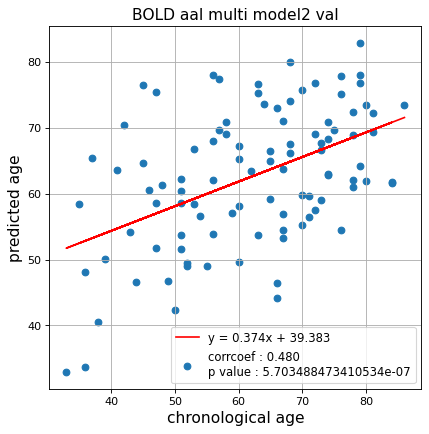

切片: 39.38303855780555
傾き: 0.37413377393125186
Kfold: 5 ::: epoch: 100, loss: 0.15413037974100846, val loss: 0.750387703301385
Kfold: 5 ::: epoch: 200, loss: 0.03643367124291567, val loss: 0.676589549635537
Kfold: 5 ::: epoch: 300, loss: 0.02094299725901622, val loss: 0.6870556673966348
Kfold: 5 ::: epoch: 400, loss: 0.01604755538014265, val loss: 0.6531764809042215
Kfold: 5 ::: epoch: 500, loss: 0.013840453341030158, val loss: 0.6275838753208518
Kfold: 5 ::: epoch: 600, loss: 0.009727340299063005, val loss: 0.6084837215021253
Kfold: 5 ::: epoch: 700, loss: 0.009271714800538925, val loss: 0.6179963797330856
Kfold: 5 ::: epoch: 800, loss: 0.008727826751195468, val loss: 0.5981693603098392
early stopping
save_epochs:638
best val loss:0.5687648868188262


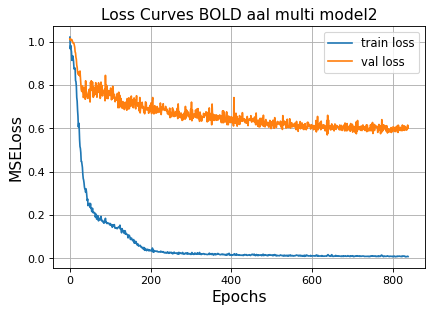

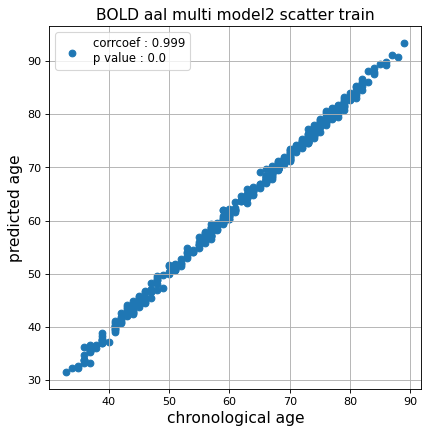

r^2 train data:  0.9749316501189758


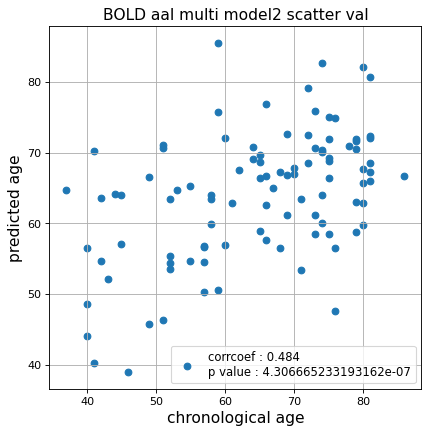

r^2 val data:  0.18086358742916364


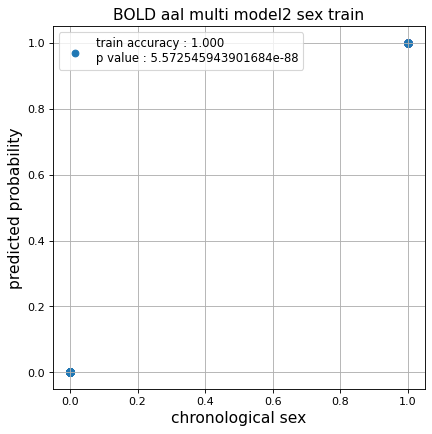

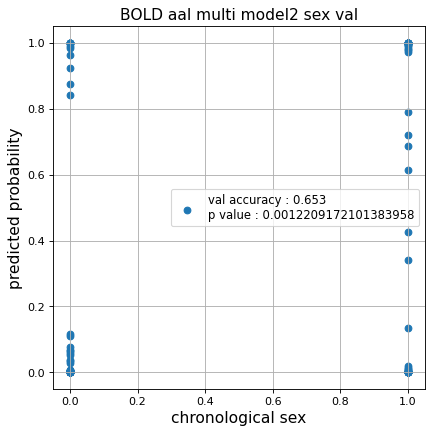

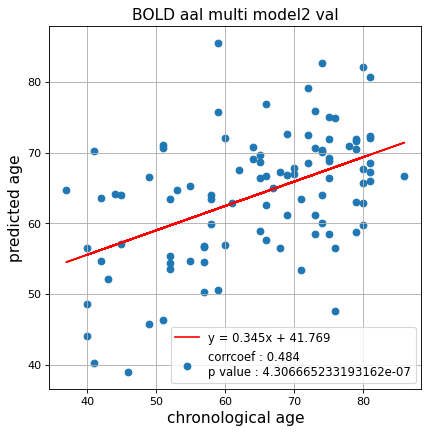

切片: 41.769264643802785
傾き: 0.34507085227800266
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.15934889591657198, val loss: 0.7675762921571732
Kfold: 1 ::: epoch: 200, loss: 0.03285630634770943, val loss: 0.672942653298378
Kfold: 1 ::: epoch: 300, loss: 0.018318744053920873, val loss: 0.6571999862790108
Kfold: 1 ::: epoch: 400, loss: 0.014779494072382268, val loss: 0.6113666370511055
Kfold: 1 ::: epoch: 500, loss: 0.011019879271491216, val loss: 0.6049834340810776
Kfold: 1 ::: epoch: 600, loss: 0.010666875491062036, val loss: 0.5776539966464043
Kfold: 1 ::: epoch: 700, loss: 0.009228381364104839, val loss: 0.5677583068609238
Kfold: 1 ::: epoch: 800, loss: 0.007886874274565624, val loss: 0.5629372894763947
Kfold: 1 ::: epoch: 900, loss: 0.009141130444522087, val loss: 0.5447037518024445
Kfold: 1 ::: epoch: 1000, loss: 0.006675190578859586, val loss: 0.5564698874950409
save_epochs:982
best val loss:0.5301905646920204


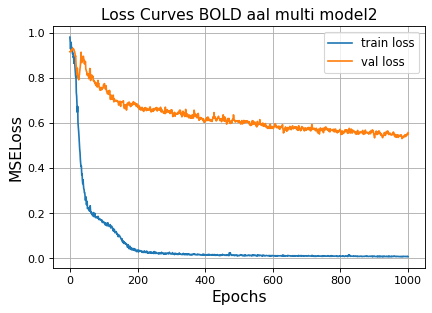

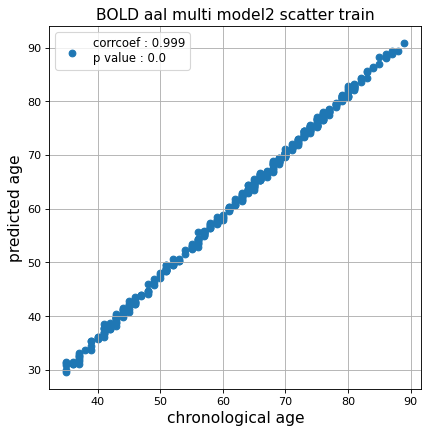

r^2 train data:  0.9755349738972239


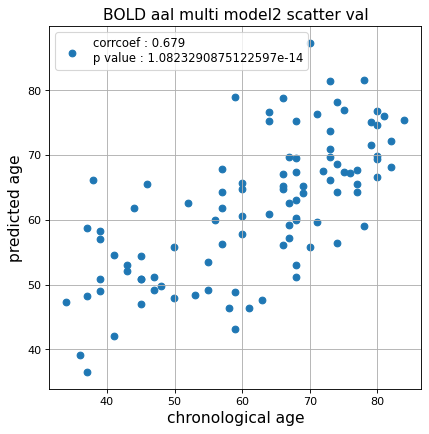

r^2 val data:  0.4522427161735447


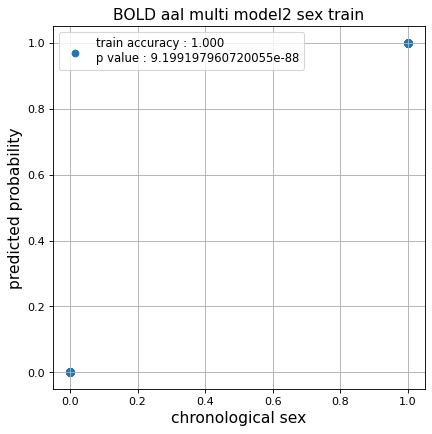

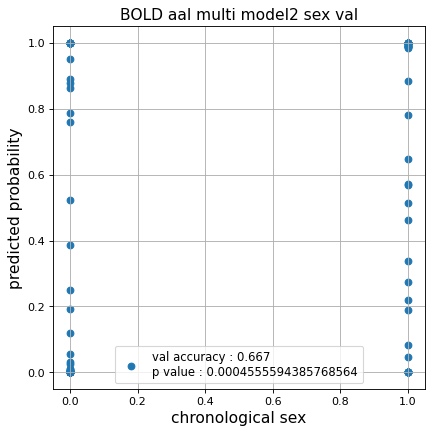

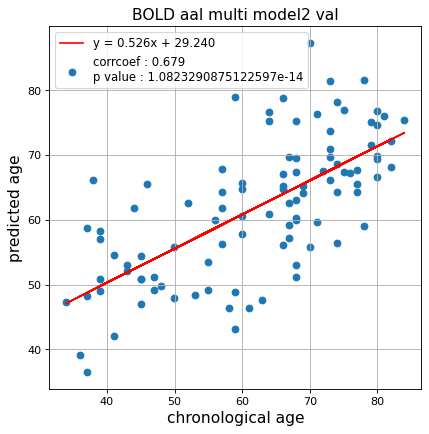

切片: 29.240219051316856
傾き: 0.5263377362031633
Kfold: 2 ::: epoch: 100, loss: 0.15750490931364206, val loss: 0.6841202527284622
Kfold: 2 ::: epoch: 200, loss: 0.03836402769845266, val loss: 0.6531989872455597
Kfold: 2 ::: epoch: 300, loss: 0.016175974805194598, val loss: 0.6639919281005859
Kfold: 2 ::: epoch: 400, loss: 0.015186538310864797, val loss: 0.6341611817479134
Kfold: 2 ::: epoch: 500, loss: 0.011893857485399796, val loss: 0.6498840749263763
Kfold: 2 ::: epoch: 600, loss: 0.011999023970789634, val loss: 0.624699629843235
Kfold: 2 ::: epoch: 700, loss: 0.011028940789401531, val loss: 0.6087085902690887
Kfold: 2 ::: epoch: 800, loss: 0.00911394485200827, val loss: 0.6036742851138115
Kfold: 2 ::: epoch: 900, loss: 0.008172131071870144, val loss: 0.6013991832733154
Kfold: 2 ::: epoch: 1000, loss: 0.007361829209213073, val loss: 0.5968135446310043
save_epochs:988
best val loss:0.5844037234783173


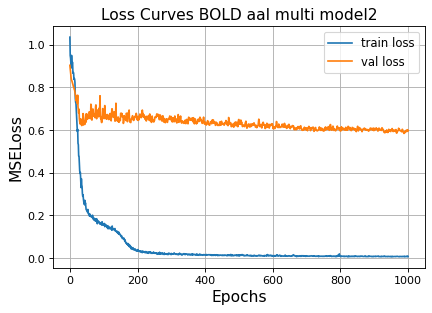

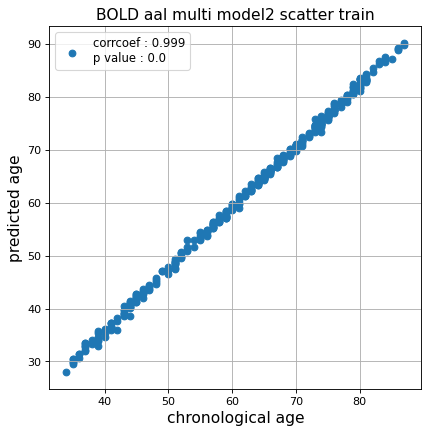

r^2 train data:  0.9715350737614494


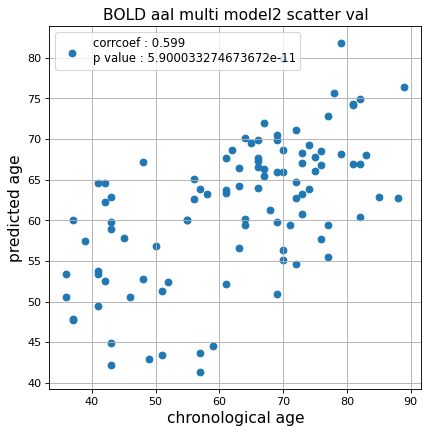

r^2 val data:  0.3535440040807535


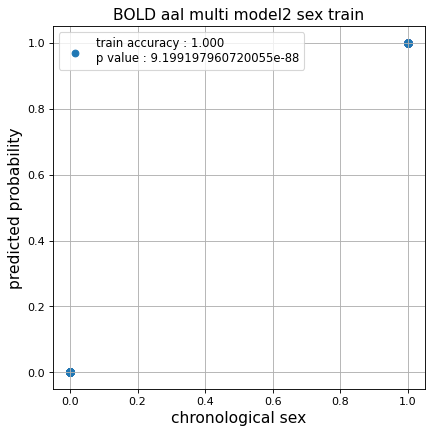

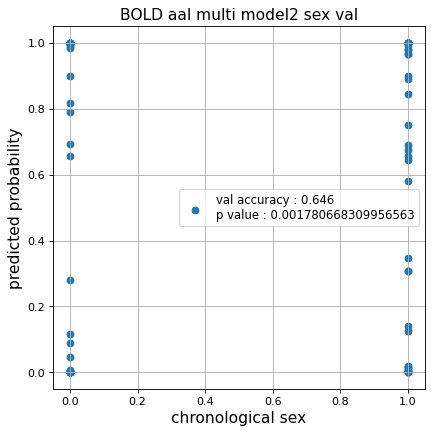

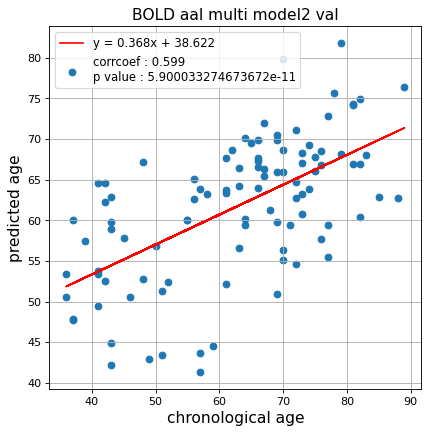

切片: 38.62186079106941
傾き: 0.3679810400447985
Kfold: 3 ::: epoch: 100, loss: 0.15637536232288068, val loss: 0.6109709590673447
Kfold: 3 ::: epoch: 200, loss: 0.0474032794053738, val loss: 0.6175665631890297
Kfold: 3 ::: epoch: 300, loss: 0.019930863108199377, val loss: 0.5853360146284103
Kfold: 3 ::: epoch: 400, loss: 0.015151893433469992, val loss: 0.5473668053746223
Kfold: 3 ::: epoch: 500, loss: 0.011902343195218306, val loss: 0.5417548641562462
Kfold: 3 ::: epoch: 600, loss: 0.010900727938860655, val loss: 0.5220810621976852
Kfold: 3 ::: epoch: 700, loss: 0.009061253557984646, val loss: 0.4936855621635914
Kfold: 3 ::: epoch: 800, loss: 0.00891845071545014, val loss: 0.48530618101358414
Kfold: 3 ::: epoch: 900, loss: 0.008077354815143805, val loss: 0.4716341756284237
Kfold: 3 ::: epoch: 1000, loss: 0.007022275159565302, val loss: 0.4664856269955635
save_epochs:991
best val loss:0.4585067853331566


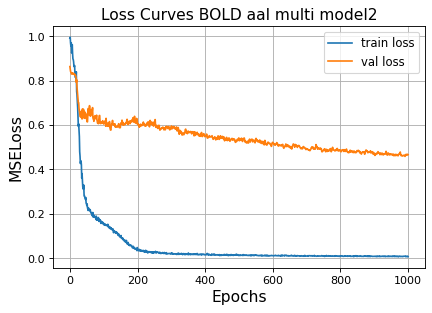

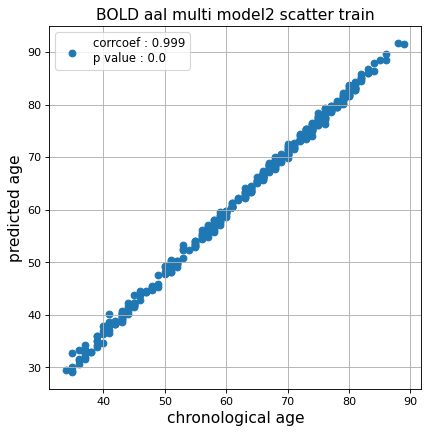

r^2 train data:  0.9741546422301142


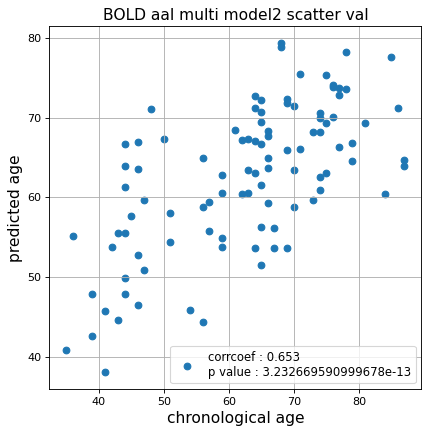

r^2 val data:  0.42409086850730804


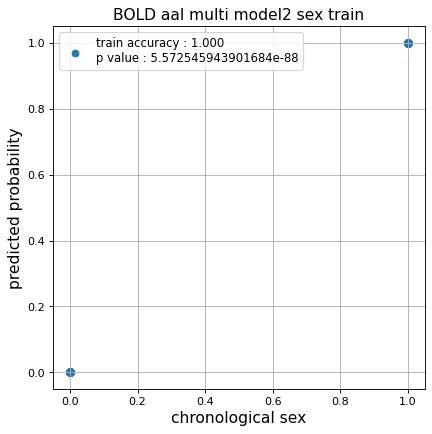

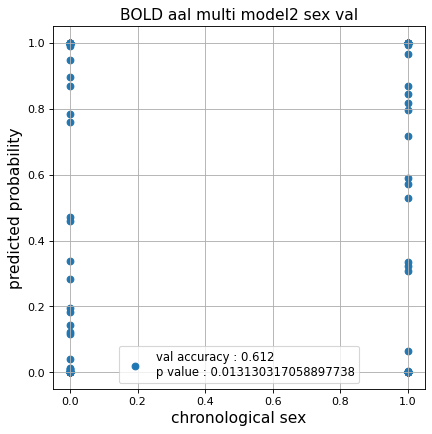

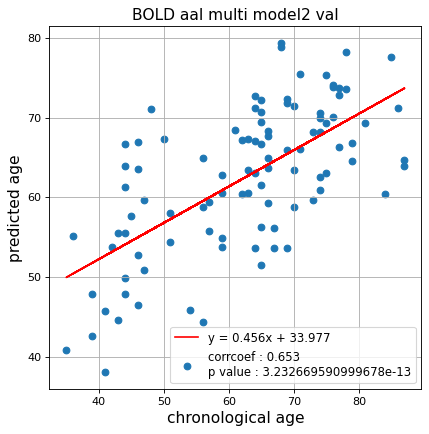

切片: 33.9769661330016
傾き: 0.4561711371806937
Kfold: 4 ::: epoch: 100, loss: 0.13385935528920248, val loss: 1.3246290758252144
Kfold: 4 ::: epoch: 200, loss: 0.02454942550796729, val loss: 1.1784181147813797
Kfold: 4 ::: epoch: 300, loss: 0.019885535781773236, val loss: 1.1173303872346878
Kfold: 4 ::: epoch: 400, loss: 0.014326812878537636, val loss: 1.0294227302074432
Kfold: 4 ::: epoch: 500, loss: 0.012169309748479953, val loss: 0.9912701398134232
Kfold: 4 ::: epoch: 600, loss: 0.009842379448505549, val loss: 0.9391649514436722
Kfold: 4 ::: epoch: 700, loss: 0.00896930479659484, val loss: 0.9380783140659332
Kfold: 4 ::: epoch: 800, loss: 0.009575437754392624, val loss: 0.9023470655083656
Kfold: 4 ::: epoch: 900, loss: 0.008677536335129004, val loss: 0.9475957602262497
Kfold: 4 ::: epoch: 1000, loss: 0.007642784370825841, val loss: 0.8971198573708534
save_epochs:994
best val loss:0.8701002597808838


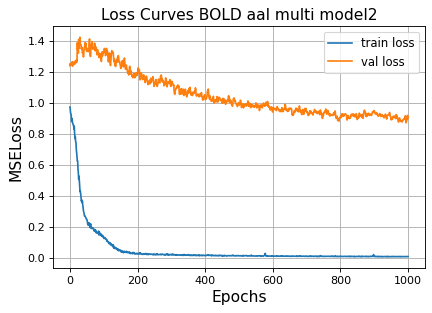

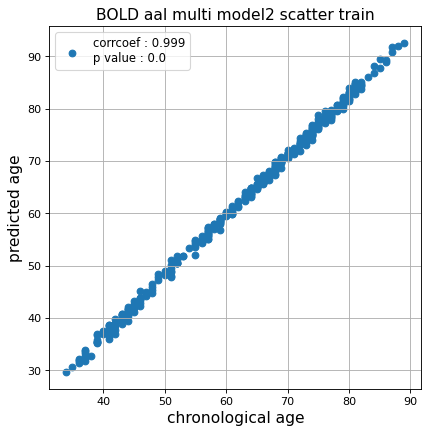

r^2 train data:  0.9754619128109204


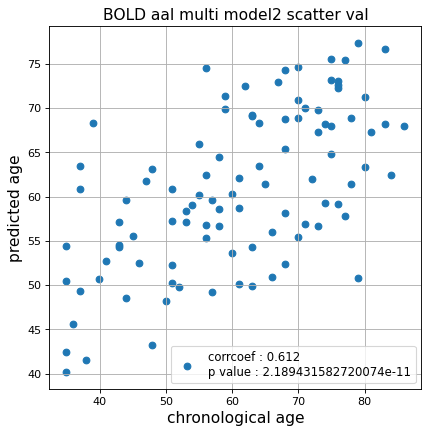

r^2 val data:  0.37371456694327587


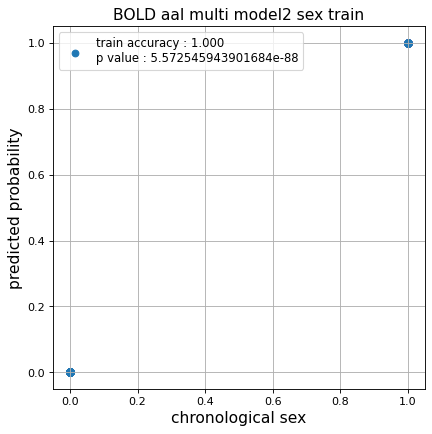

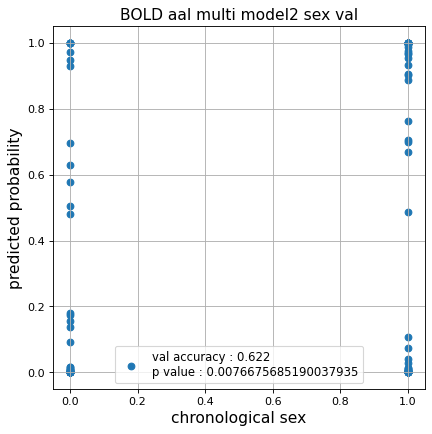

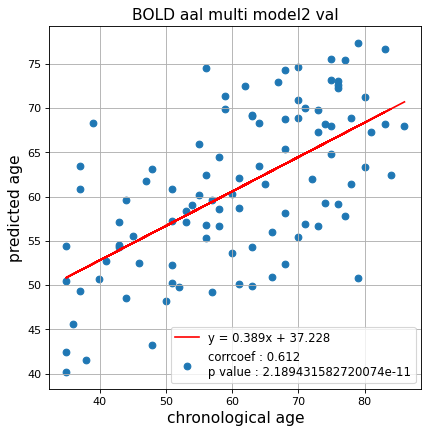

切片: 37.22799419210273
傾き: 0.3892030444615828
Kfold: 5 ::: epoch: 100, loss: 0.155659379867407, val loss: 0.8682273514568806
Kfold: 5 ::: epoch: 200, loss: 0.029545608907938004, val loss: 0.7926404662430286
Kfold: 5 ::: epoch: 300, loss: 0.02254046843602107, val loss: 0.7724568173289299
Kfold: 5 ::: epoch: 400, loss: 0.017004947607906964, val loss: 0.7506311237812042
Kfold: 5 ::: epoch: 500, loss: 0.014827605623465318, val loss: 0.753785066306591
Kfold: 5 ::: epoch: 600, loss: 0.011433020950509952, val loss: 0.7366088554263115
Kfold: 5 ::: epoch: 700, loss: 0.010073187581908245, val loss: 0.7362796515226364
early stopping
save_epochs:554
best val loss:0.7089610397815704


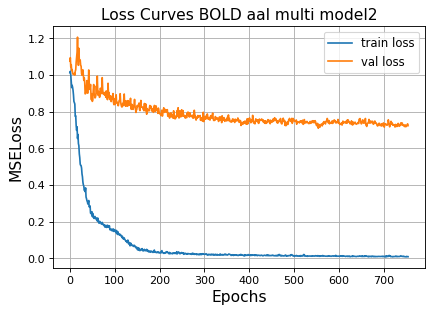

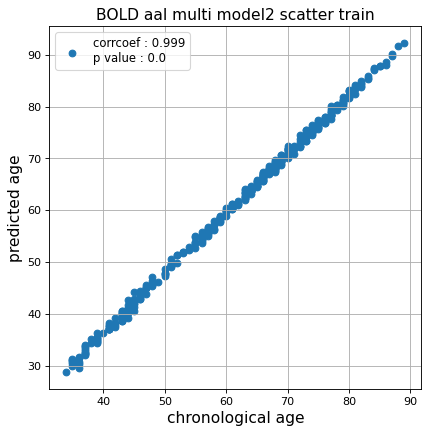

r^2 train data:  0.9757987033314794


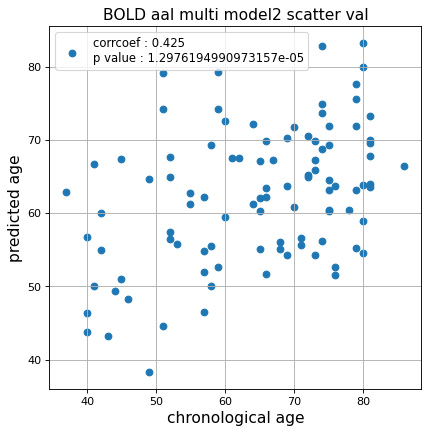

r^2 val data:  0.05969643891003518


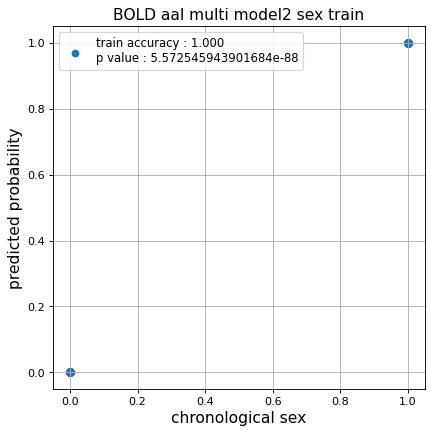

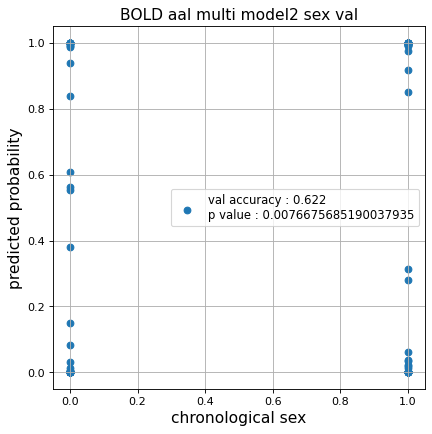

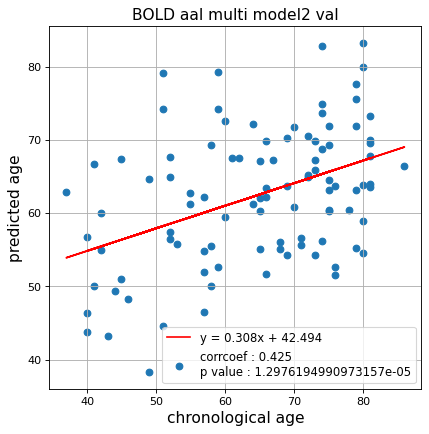

切片: 42.493890231683714
傾き: 0.3084384064808314
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.15850336391192216, val loss: 0.8139043599367142
Kfold: 1 ::: epoch: 200, loss: 0.036285869777202606, val loss: 0.7118440121412277
Kfold: 1 ::: epoch: 300, loss: 0.018364576837764338, val loss: 0.6782489791512489
Kfold: 1 ::: epoch: 400, loss: 0.01659331427743802, val loss: 0.6578445360064507
Kfold: 1 ::: epoch: 500, loss: 0.01191348790262754, val loss: 0.6452151238918304
Kfold: 1 ::: epoch: 600, loss: 0.010173860185134869, val loss: 0.633002907037735
Kfold: 1 ::: epoch: 700, loss: 0.008897996041923761, val loss: 0.6332215666770935
Kfold: 1 ::: epoch: 800, loss: 0.008136615121307282, val loss: 0.6167920678853989
Kfold: 1 ::: epoch: 900, loss: 0.00933418501741611, val loss: 0.6259046345949173
Kfold: 1 ::: epoch: 1000, loss: 0.0065163064103287, val loss: 0.6149876117706299
save_epochs:806
best val loss:0.590389758348465


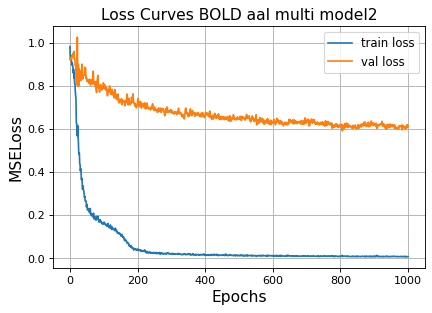

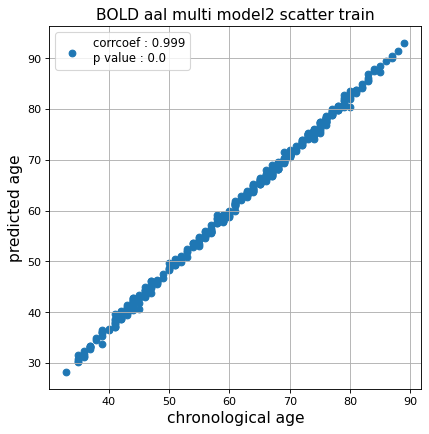

r^2 train data:  0.9790438007457006


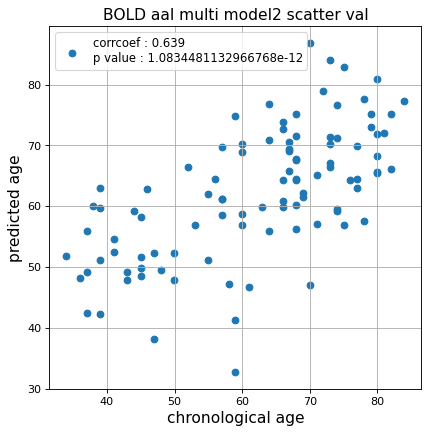

r^2 val data:  0.38871018313936945


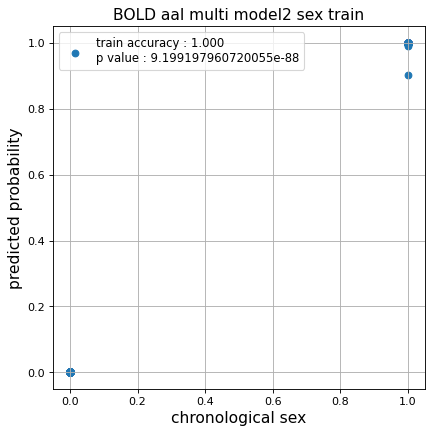

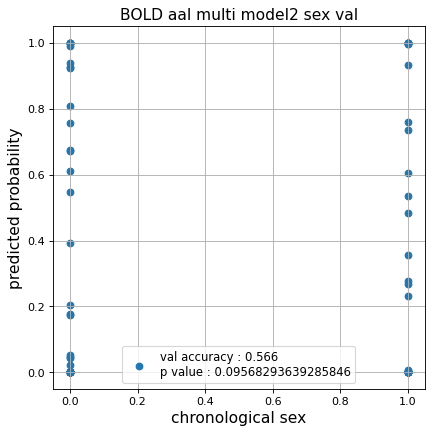

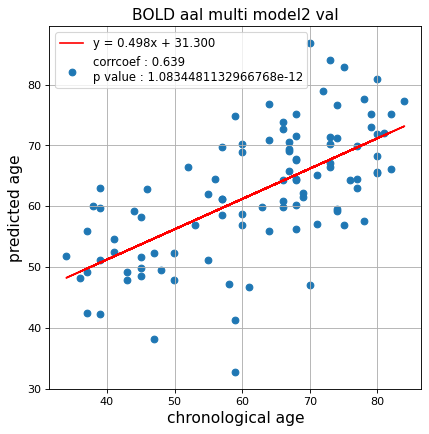

切片: 31.300113801165566
傾き: 0.4981125740000996
Kfold: 2 ::: epoch: 100, loss: 0.1760423332452774, val loss: 0.682631641626358
Kfold: 2 ::: epoch: 200, loss: 0.052794263913081244, val loss: 0.6506631672382355
Kfold: 2 ::: epoch: 300, loss: 0.019155894119579058, val loss: 0.6440621390938759
Kfold: 2 ::: epoch: 400, loss: 0.014479676082443733, val loss: 0.6297470182180405
Kfold: 2 ::: epoch: 500, loss: 0.009975807311443182, val loss: 0.618485614657402
Kfold: 2 ::: epoch: 600, loss: 0.011579329434495706, val loss: 0.5898739472031593
Kfold: 2 ::: epoch: 700, loss: 0.009921751808948241, val loss: 0.5890350788831711
Kfold: 2 ::: epoch: 800, loss: 0.007655168883502483, val loss: 0.573228232562542
Kfold: 2 ::: epoch: 900, loss: 0.008422573276150685, val loss: 0.5847605839371681
Kfold: 2 ::: epoch: 1000, loss: 0.0069939408702059435, val loss: 0.5558149628341198
save_epochs:985
best val loss:0.5529066026210785


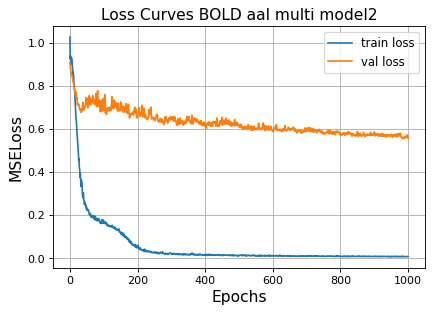

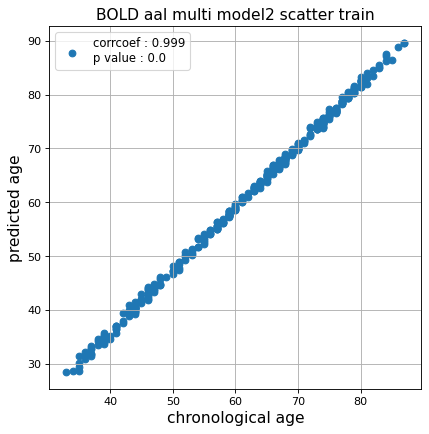

r^2 train data:  0.9730349375865073


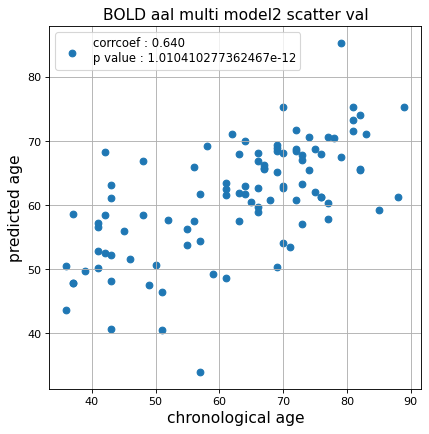

r^2 val data:  0.3974476782078872


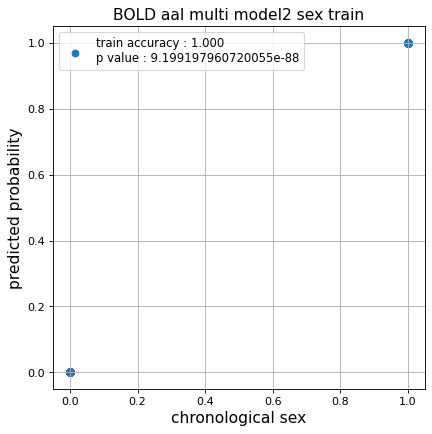

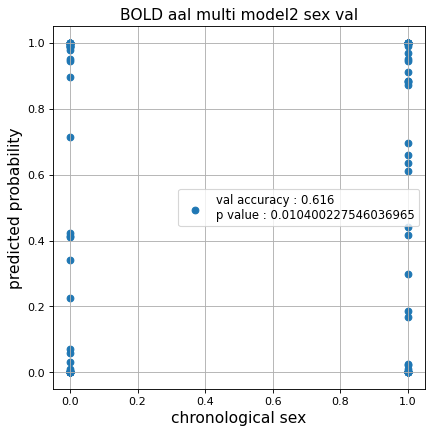

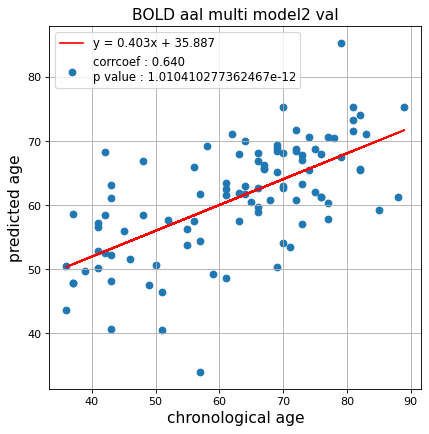

切片: 35.88652078329602
傾き: 0.40271988471575176
Kfold: 3 ::: epoch: 100, loss: 0.15303296309251052, val loss: 0.6013533025979996
Kfold: 3 ::: epoch: 200, loss: 0.046934519249659315, val loss: 0.5313222855329514
Kfold: 3 ::: epoch: 300, loss: 0.019699941102701884, val loss: 0.45721725188195705
Kfold: 3 ::: epoch: 400, loss: 0.014716073440817686, val loss: 0.4466673508286476
Kfold: 3 ::: epoch: 500, loss: 0.013043005377627336, val loss: 0.4400312900543213
Kfold: 3 ::: epoch: 600, loss: 0.01074165367306425, val loss: 0.44217201322317123
Kfold: 3 ::: epoch: 700, loss: 0.008875769168998186, val loss: 0.4278513565659523
Kfold: 3 ::: epoch: 800, loss: 0.009387332659501296, val loss: 0.4165381081402302
Kfold: 3 ::: epoch: 900, loss: 0.008346132934093475, val loss: 0.41419900953769684
Kfold: 3 ::: epoch: 1000, loss: 0.00790836328927141, val loss: 0.4258633963763714
save_epochs:826
best val loss:0.40475277975201607


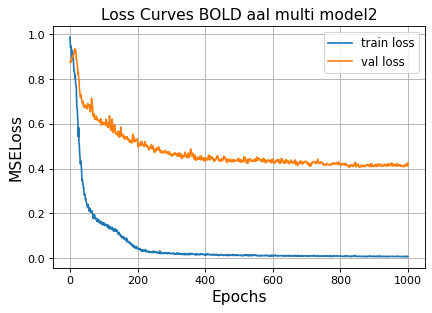

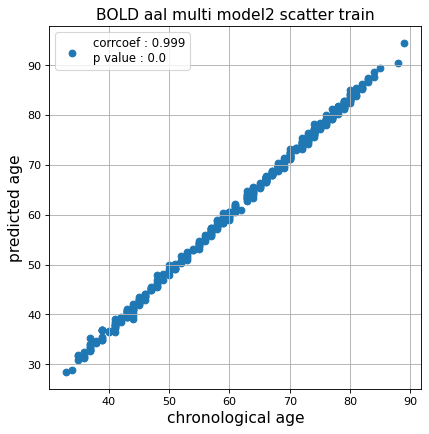

r^2 train data:  0.9693621277896968


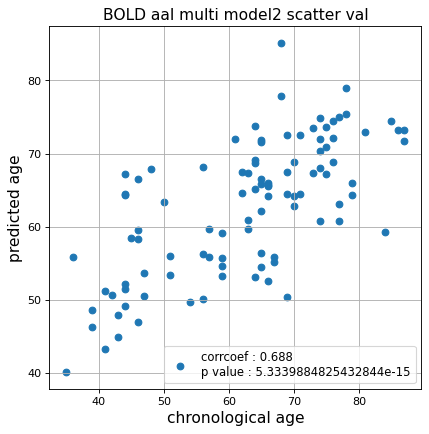

r^2 val data:  0.47216717703886435


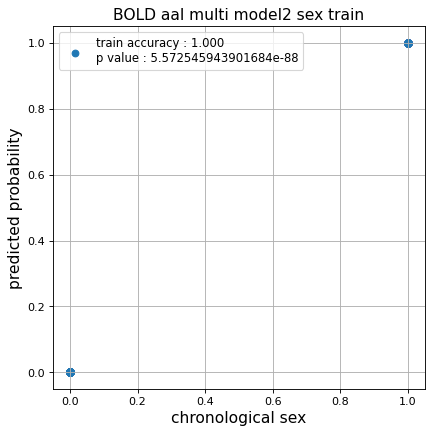

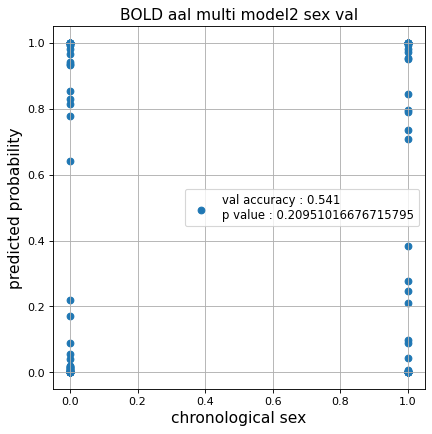

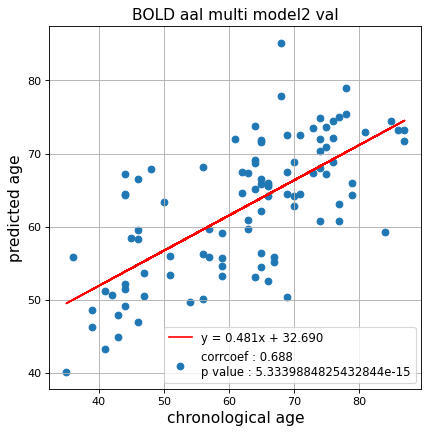

切片: 32.6900400380748
傾き: 0.4805640131724723
Kfold: 4 ::: epoch: 100, loss: 0.13984315899702218, val loss: 0.9461631625890732
Kfold: 4 ::: epoch: 200, loss: 0.027330973830360632, val loss: 0.8027750849723816
Kfold: 4 ::: epoch: 300, loss: 0.020739557006611273, val loss: 0.7802626490592957
Kfold: 4 ::: epoch: 400, loss: 0.015344504517718004, val loss: 0.7451157569885254
Kfold: 4 ::: epoch: 500, loss: 0.011955892058232656, val loss: 0.6931498944759369
Kfold: 4 ::: epoch: 600, loss: 0.010181372340482015, val loss: 0.6741099208593369
Kfold: 4 ::: epoch: 700, loss: 0.009442077806362739, val loss: 0.6503005176782608
Kfold: 4 ::: epoch: 800, loss: 0.009673299052967476, val loss: 0.6208129450678825
Kfold: 4 ::: epoch: 900, loss: 0.007321899398588217, val loss: 0.6027330234646797
Kfold: 4 ::: epoch: 1000, loss: 0.0064190121797414925, val loss: 0.5979673862457275
save_epochs:953
best val loss:0.5891829580068588


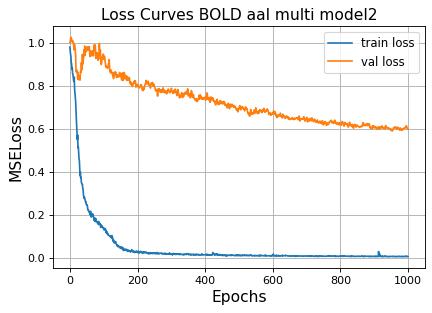

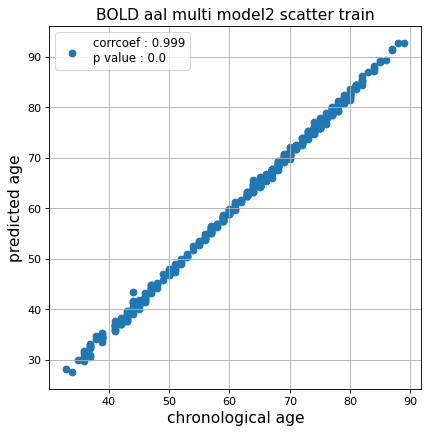

r^2 train data:  0.9641908317560512


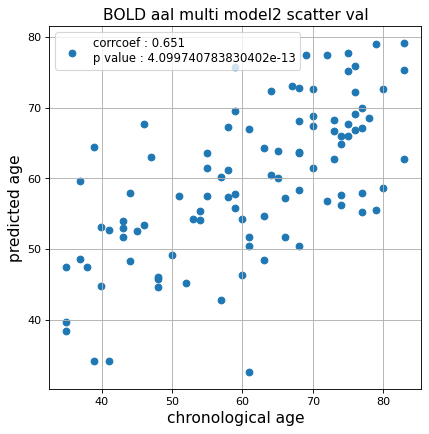

r^2 val data:  0.3911940586542956


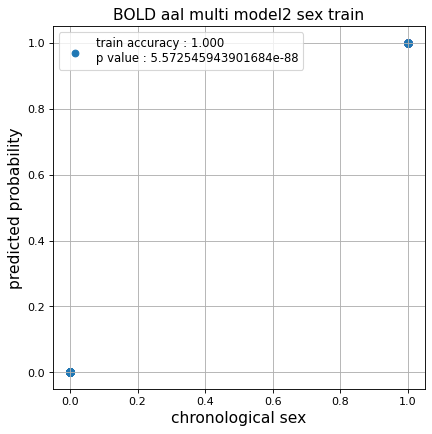

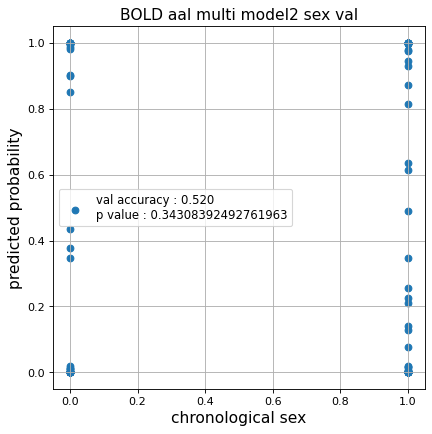

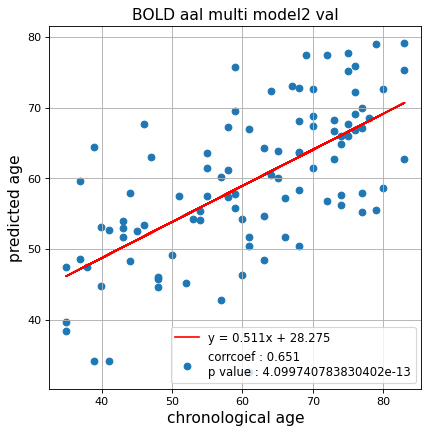

切片: 28.275494201102926
傾き: 0.5108833070765986
Kfold: 5 ::: epoch: 100, loss: 0.15750728662197405, val loss: 1.5085154473781586
Kfold: 5 ::: epoch: 200, loss: 0.03034426078486901, val loss: 1.2716140151023865
Kfold: 5 ::: epoch: 300, loss: 0.03493520818077601, val loss: 1.1637085378170013
Kfold: 5 ::: epoch: 400, loss: 0.016550506751697797, val loss: 1.1806724667549133
Kfold: 5 ::: epoch: 500, loss: 0.016316938285644237, val loss: 1.120801880955696
Kfold: 5 ::: epoch: 600, loss: 0.011388119023579817, val loss: 1.0745965093374252
Kfold: 5 ::: epoch: 700, loss: 0.009575912442344885, val loss: 1.0455804467201233
Kfold: 5 ::: epoch: 800, loss: 0.008045149841704048, val loss: 1.019243597984314
Kfold: 5 ::: epoch: 900, loss: 0.008787172058453927, val loss: 1.0475409924983978
Kfold: 5 ::: epoch: 1000, loss: 0.007515904099608843, val loss: 1.0111397504806519
save_epochs:890
best val loss:0.9386169016361237


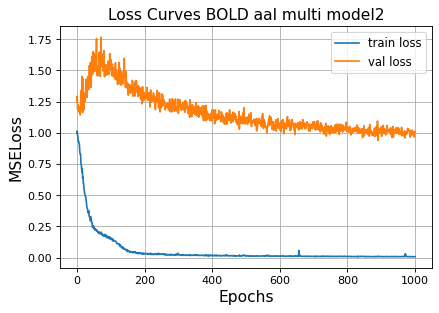

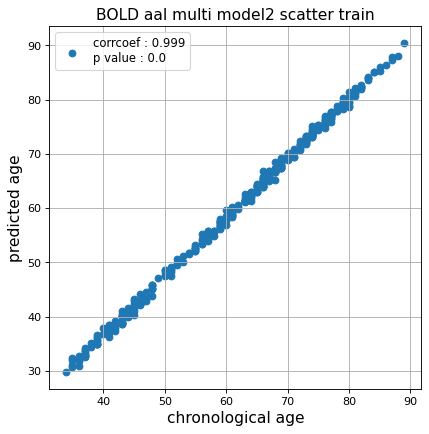

r^2 train data:  0.9771716897214928


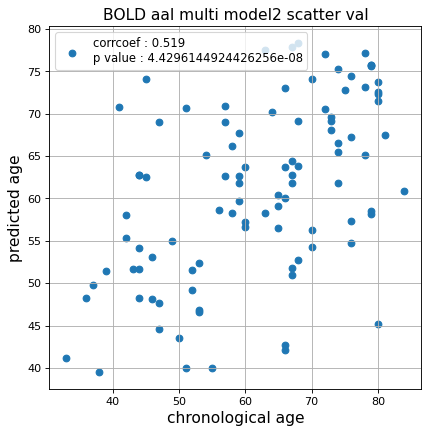

r^2 val data:  0.1923317839088149


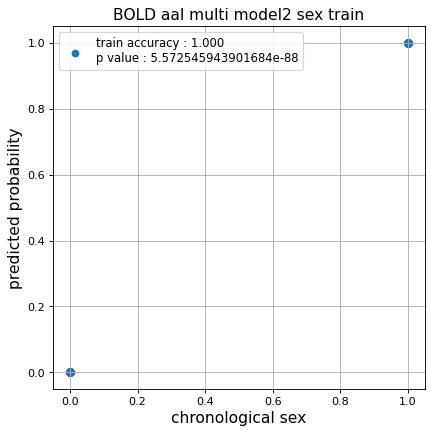

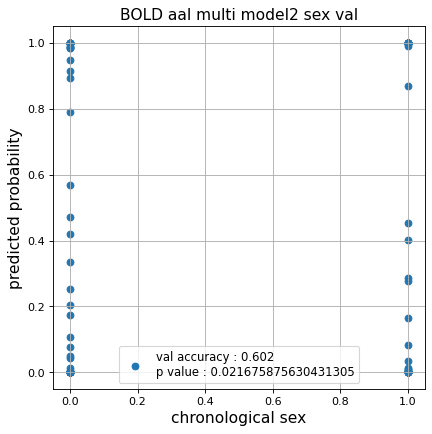

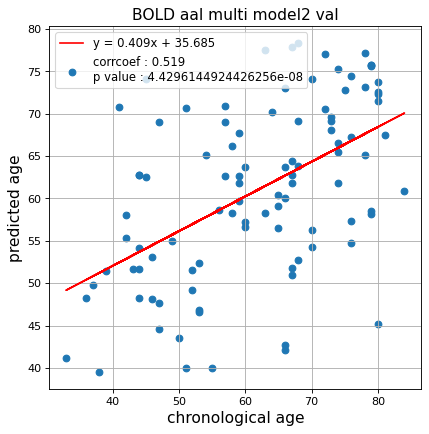

切片: 35.68518092334632
傾き: 0.4092445053489433
CPU times: user 1h 35min 9s, sys: 8min 17s, total: 1h 43min 26s
Wall time: 1h 43min 35s


In [17]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_2  = []
test_pred_aal_corrected_2  = []
test_label_aal_2 = []
test_idx_aal_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label= train_model(data_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 128,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 128,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.1,
                                                           fc_drop = 0.1,
                                                           title = 'ROI aal multi model2'
                                                          )
    
    test_pred_aal_2.append(test_pred)
    test_pred_aal_corrected_2.append(test_pred_corrected)
    test_label_aal_2.append(test_label)
    test_idx_aal_2.append(test_idx)

### データ保存

In [18]:
test_pred_aal_1 = np.array(test_pred_aal_1, dtype=object)
test_pred_aal_corrected_1 = np.array(test_pred_aal_corrected_1, dtype=object)

test_pred_aal_2 = np.array(test_pred_aal_2, dtype=object)
test_pred_aal_corrected_2 = np.array(test_pred_aal_corrected_2, dtype=object)

In [19]:
np.savez('../02_data_analysis/temp/multi_aal_1',
         test_pred_aal_1,
         test_pred_aal_corrected_1,
         test_label_aal_1,
         test_idx_aal_1)
np.savez('../02_data_analysis/temp/multi_aal_2',
         test_pred_aal_2,
         test_pred_aal_corrected_2,
         test_label_aal_2,
         test_idx_aal_2)

### Data定義(dynamic FC)

In [20]:
%%time
df_dynamic_aal = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_aal.csv')
data_dynamic_aal = make_data(df_dynamic_aal)
print(data_dynamic_aal.shape)

(615, 123, 6670)
CPU times: user 3min 1s, sys: 5.39 s, total: 3min 7s
Wall time: 3min 7s


### Dynamic FC 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.036915759914196454, val loss: 0.541540764272213
Kfold: 1 ::: epoch: 200, loss: 0.020344687697405998, val loss: 0.5166925955563784
Kfold: 1 ::: epoch: 300, loss: 0.013302855981657138, val loss: 0.5096098631620407
Kfold: 1 ::: epoch: 400, loss: 0.00896545066140019, val loss: 0.499874509871006
Kfold: 1 ::: epoch: 500, loss: 0.0066077211477722116, val loss: 0.4934700932353735
Kfold: 1 ::: epoch: 600, loss: 0.006720133519803102, val loss: 0.49620929919183254
early stopping
save_epochs:480
best val loss:0.4757444467395544


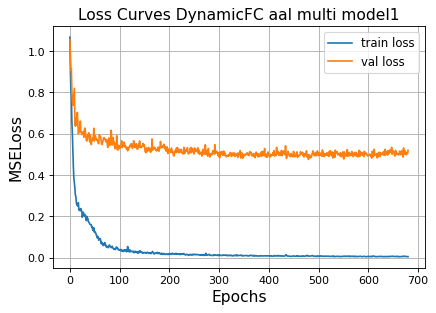

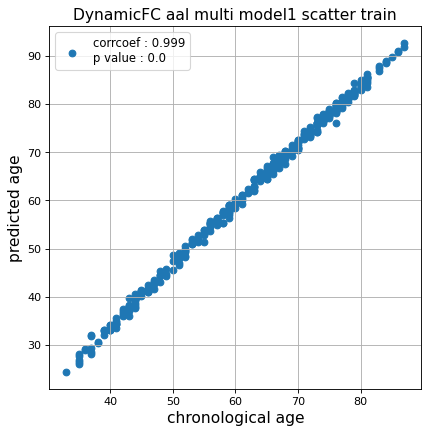

r^2 train data:  0.9336485683689064


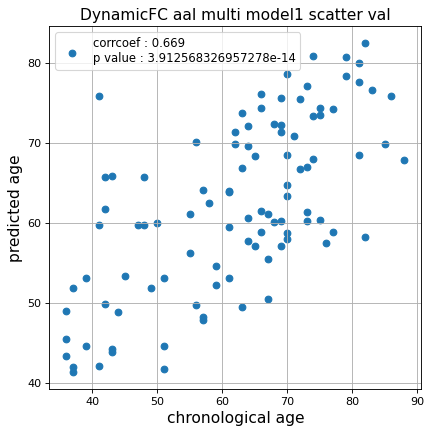

r^2 val data:  0.43431098986213446


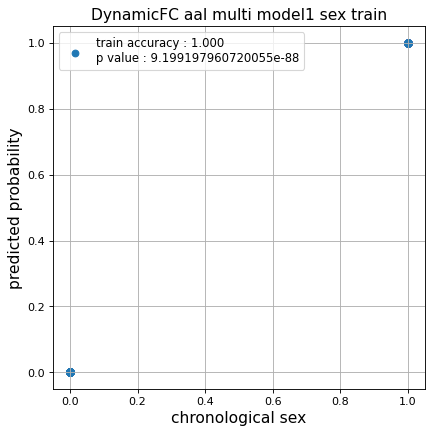

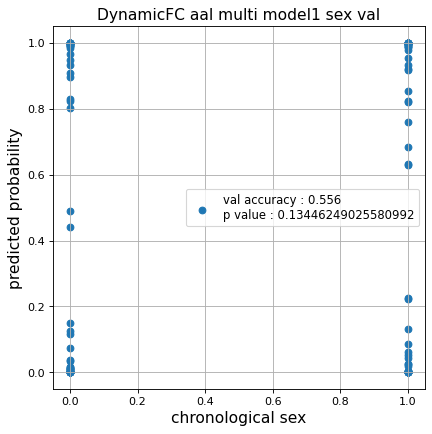

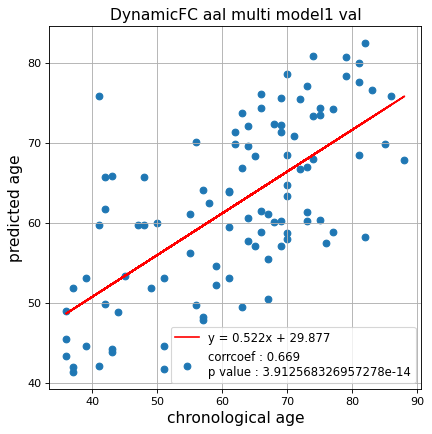

切片: 29.87738639255184
傾き: 0.5218033123478596
Kfold: 2 ::: epoch: 100, loss: 0.03263270281828367, val loss: 0.5964782014489174
Kfold: 2 ::: epoch: 200, loss: 0.01727754160618553, val loss: 0.5389234870672226
Kfold: 2 ::: epoch: 300, loss: 0.011102889700291248, val loss: 0.550269328057766
Kfold: 2 ::: epoch: 400, loss: 0.007841192938100833, val loss: 0.5176765695214272
Kfold: 2 ::: epoch: 500, loss: 0.005274925846606493, val loss: 0.5077754631638527
Kfold: 2 ::: epoch: 600, loss: 0.005324874825489063, val loss: 0.5033741742372513
Kfold: 2 ::: epoch: 700, loss: 0.0053217747391989595, val loss: 0.5046267658472061
save_epochs:570
best val loss:0.48371216282248497


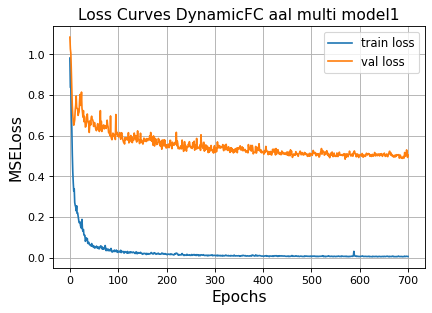

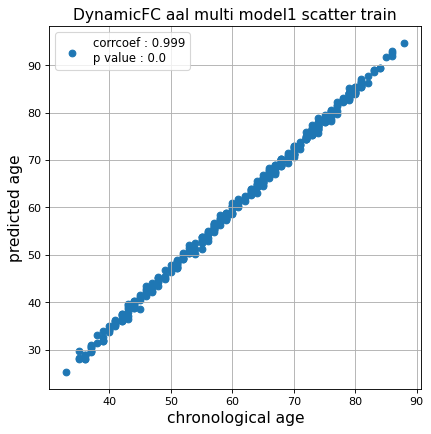

r^2 train data:  0.9284983204571815


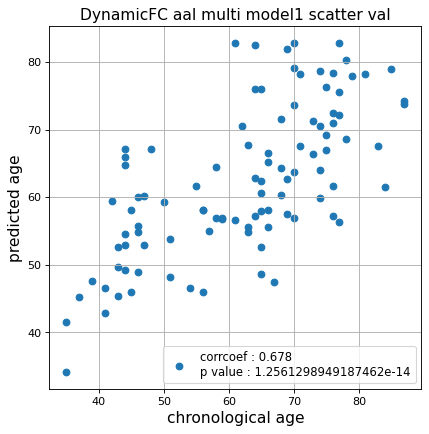

r^2 val data:  0.4394828324688391


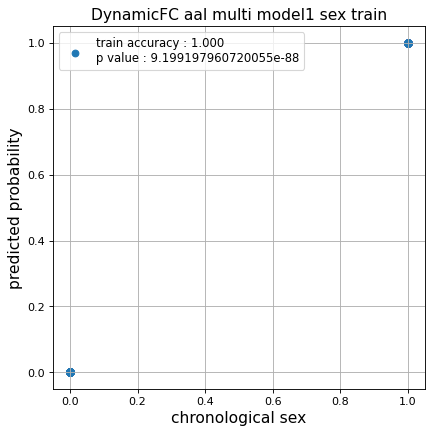

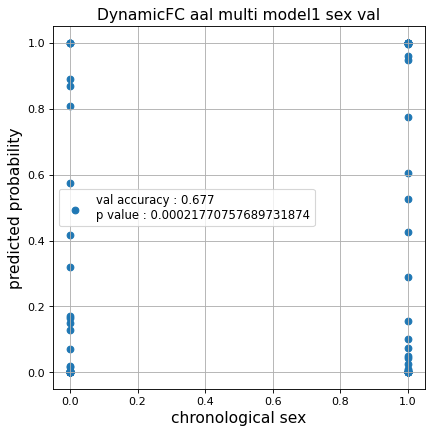

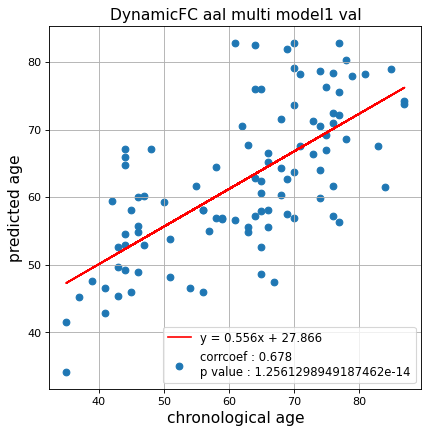

切片: 27.865971953599576
傾き: 0.5556131938034748
Kfold: 3 ::: epoch: 100, loss: 0.03537161333056597, val loss: 0.5995621681213379
Kfold: 3 ::: epoch: 200, loss: 0.022920946948803388, val loss: 0.5201862454414368
Kfold: 3 ::: epoch: 300, loss: 0.011642285694296543, val loss: 0.47597598657011986
Kfold: 3 ::: epoch: 400, loss: 0.008601344333818326, val loss: 0.5112196877598763
Kfold: 3 ::: epoch: 500, loss: 0.00689339480147912, val loss: 0.4656222090125084
early stopping
save_epochs:332
best val loss:0.45575395971536636


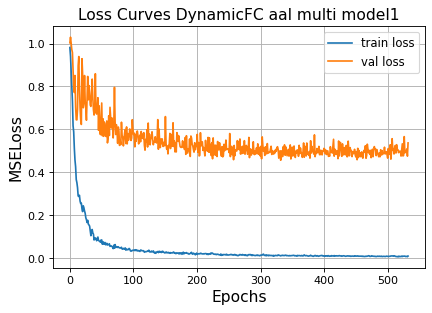

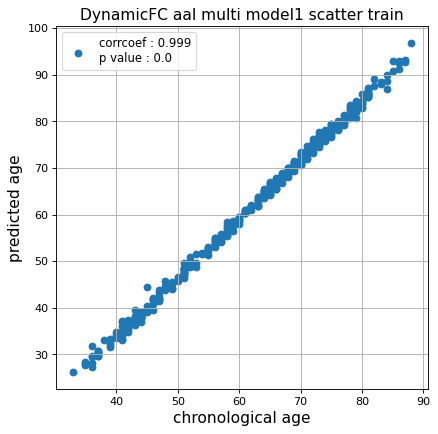

r^2 train data:  0.9247485197402721


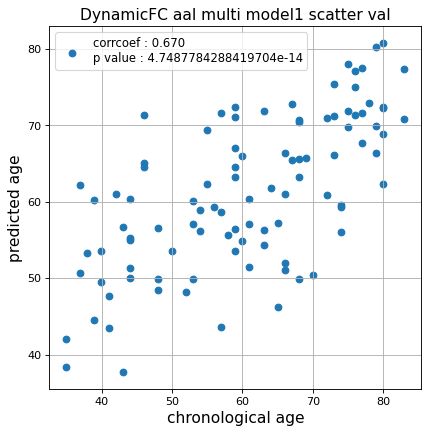

r^2 val data:  0.4427166482017577


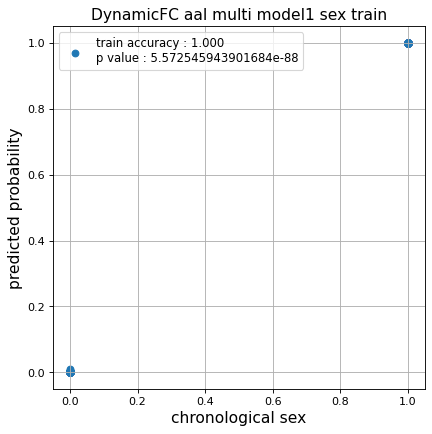

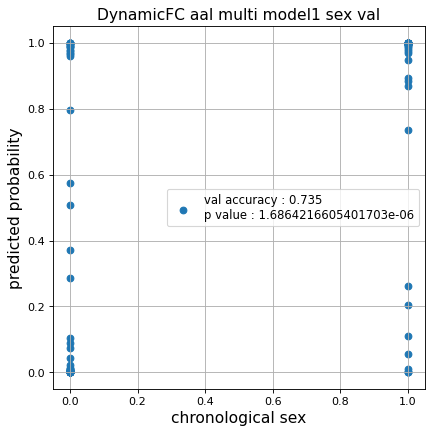

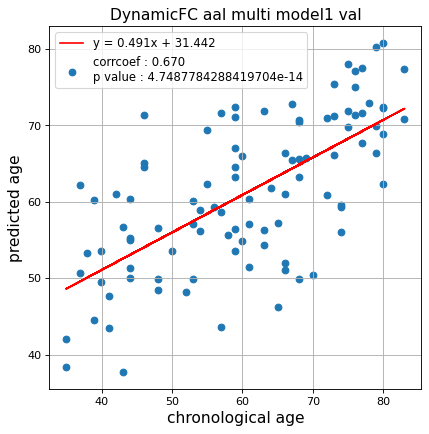

切片: 31.442085965798785
傾き: 0.4906199394093146
Kfold: 4 ::: epoch: 100, loss: 0.036968438456264824, val loss: 0.7260224968194962
Kfold: 4 ::: epoch: 200, loss: 0.017194555893253822, val loss: 0.7908471673727036
Kfold: 4 ::: epoch: 300, loss: 0.010491599507916432, val loss: 0.726121336221695
Kfold: 4 ::: epoch: 400, loss: 0.00825564031345913, val loss: 0.6924501955509186
Kfold: 4 ::: epoch: 500, loss: 0.006833600166898508, val loss: 0.6657310426235199
Kfold: 4 ::: epoch: 600, loss: 0.007592899581560722, val loss: 0.6874677687883377
early stopping
save_epochs:497
best val loss:0.6495389044284821


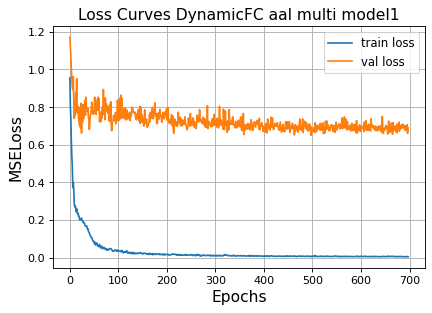

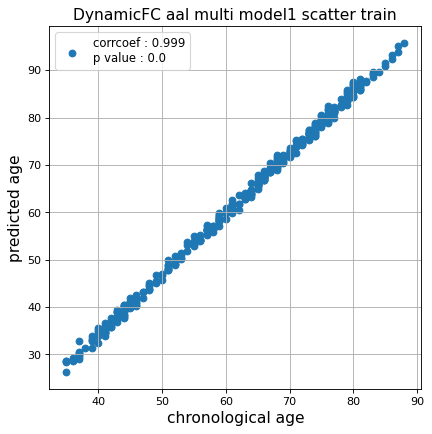

r^2 train data:  0.9164877079919318


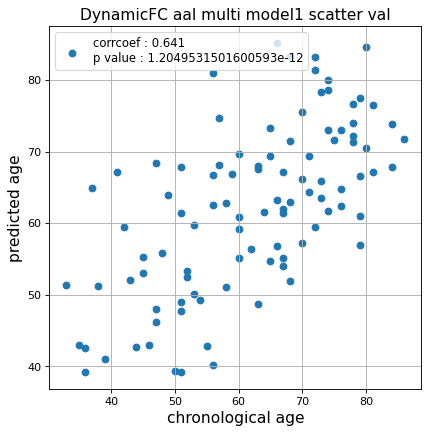

r^2 val data:  0.3573702465800127


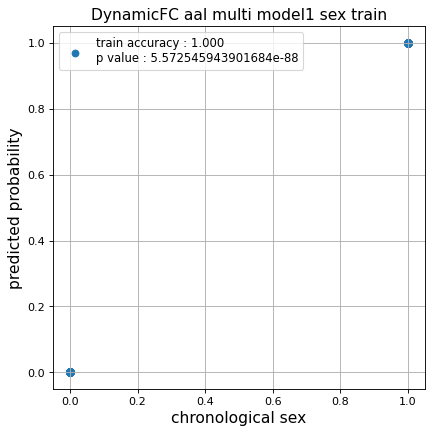

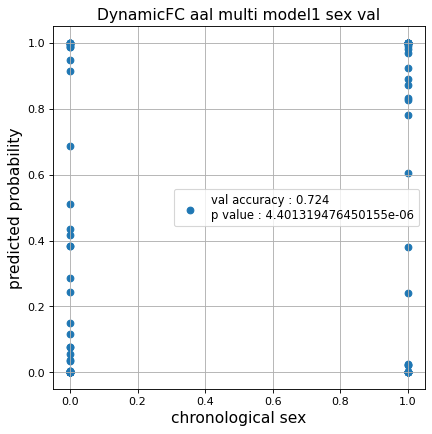

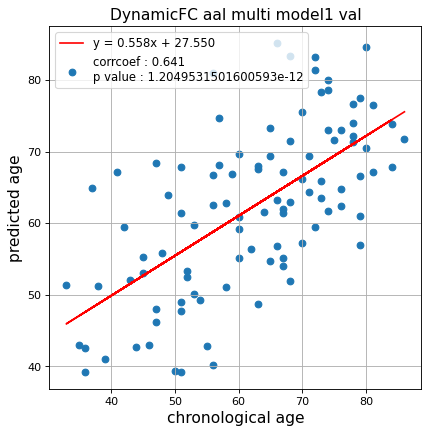

切片: 27.550120565408534
傾き: 0.5579902324885666
Kfold: 5 ::: epoch: 100, loss: 0.03449036725438558, val loss: 0.5783269330859184
Kfold: 5 ::: epoch: 200, loss: 0.015789671801030636, val loss: 0.5416325200349092
Kfold: 5 ::: epoch: 300, loss: 0.01022856872385511, val loss: 0.5530761238187551
Kfold: 5 ::: epoch: 400, loss: 0.00993378646671772, val loss: 0.5747456569224596
early stopping
save_epochs:207
best val loss:0.5275301188230515


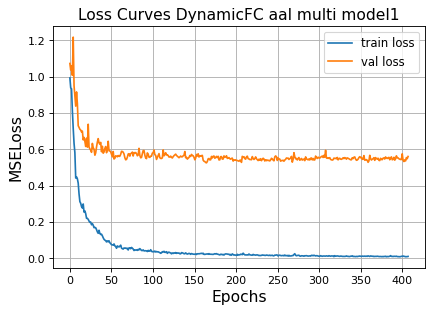

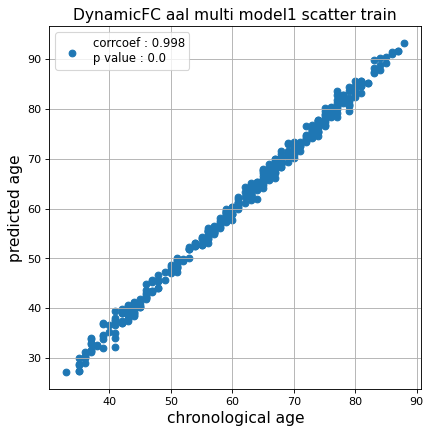

r^2 train data:  0.9480057305502928


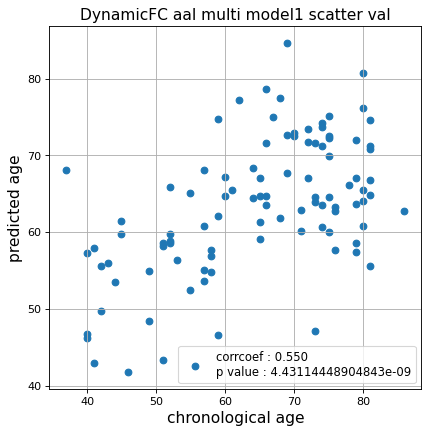

r^2 val data:  0.27426776286781873


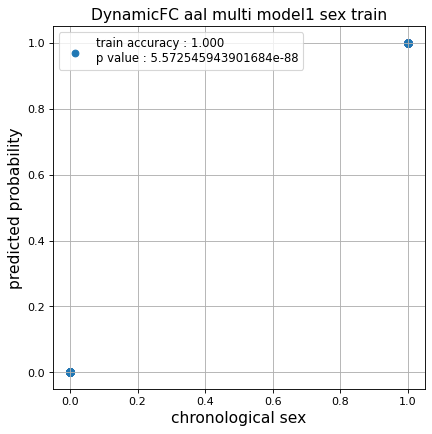

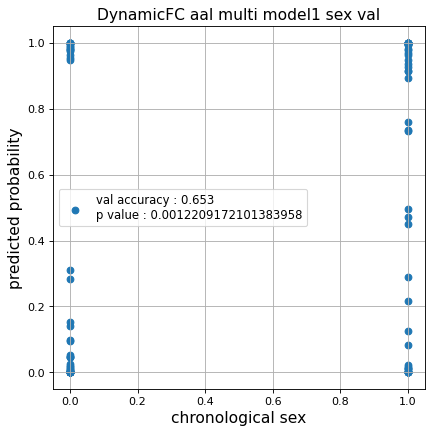

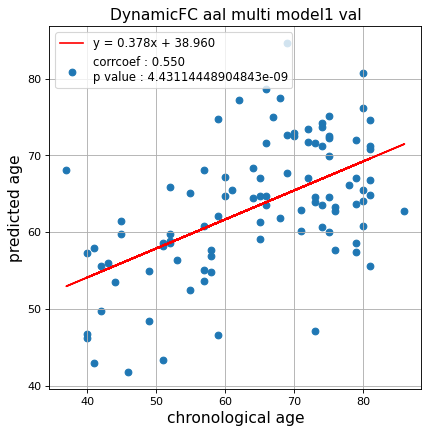

切片: 38.960040607229594
傾き: 0.37813067709793274
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.03804904380096839, val loss: 0.6888179033994675
Kfold: 1 ::: epoch: 200, loss: 0.019766409809772786, val loss: 0.6669904738664627
Kfold: 1 ::: epoch: 300, loss: 0.016255697522025842, val loss: 0.7036255896091461
Kfold: 1 ::: epoch: 400, loss: 0.009104980585666804, val loss: 0.7224080488085747
early stopping
save_epochs:211
best val loss:0.6480147838592529


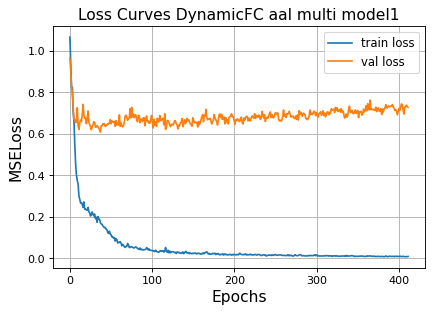

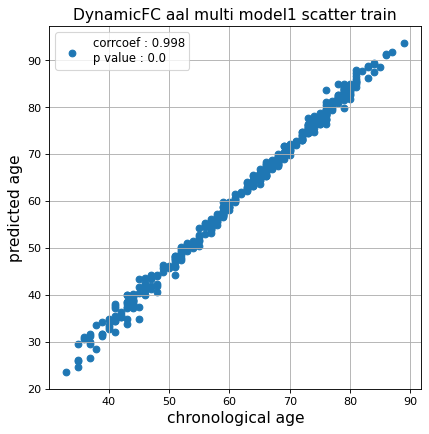

r^2 train data:  0.9247533408931823


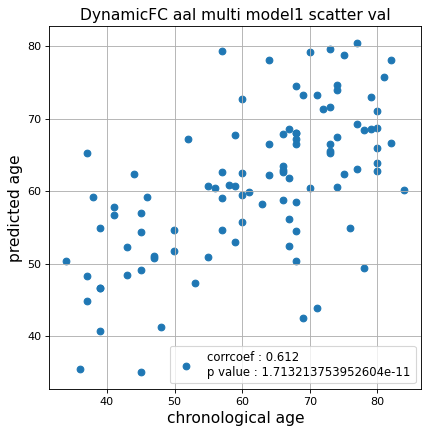

r^2 val data:  0.3524879326662138


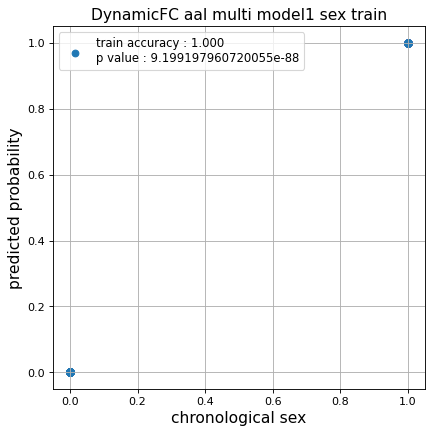

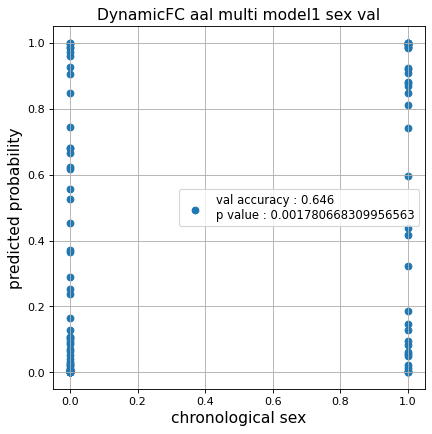

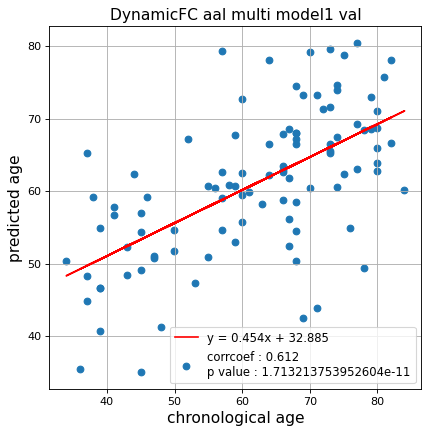

切片: 32.885431661630506
傾き: 0.45449996872038445
Kfold: 2 ::: epoch: 100, loss: 0.029526174068450928, val loss: 0.6617913693189621
Kfold: 2 ::: epoch: 200, loss: 0.016143667045980692, val loss: 0.6761986017227173
Kfold: 2 ::: epoch: 300, loss: 0.011244682738414178, val loss: 0.6423538774251938
Kfold: 2 ::: epoch: 400, loss: 0.0075310730518629914, val loss: 0.6676322445273399
early stopping
save_epochs:259
best val loss:0.6090030521154404


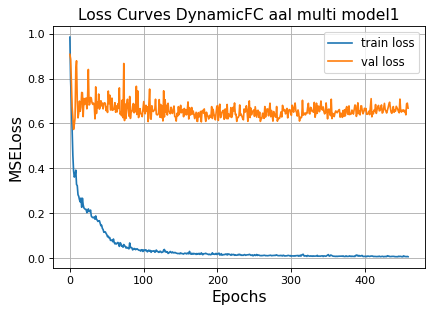

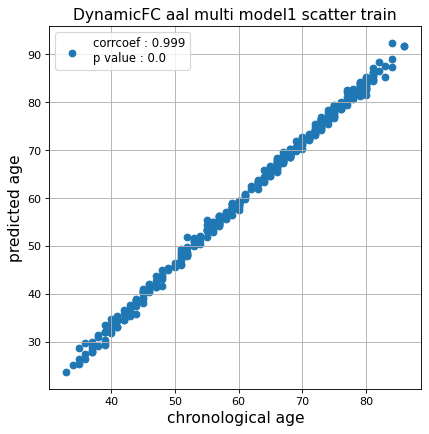

r^2 train data:  0.9179999971367102


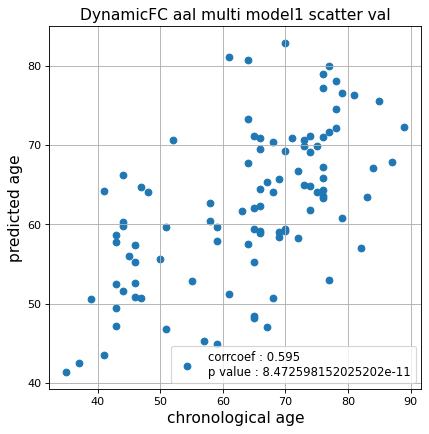

r^2 val data:  0.3266372311099478


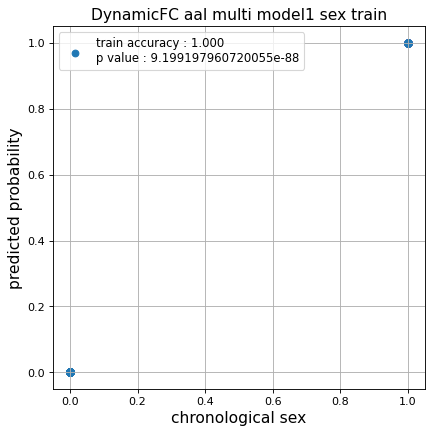

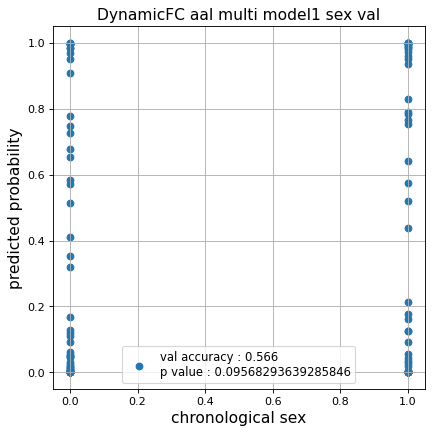

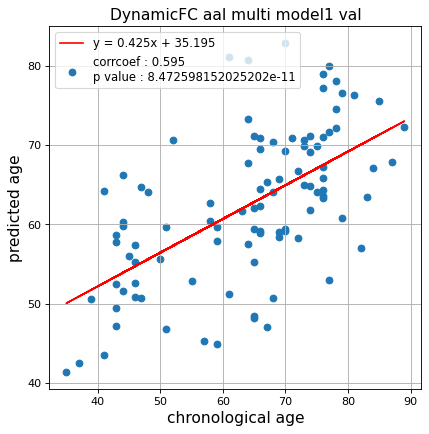

切片: 35.19465314771586
傾き: 0.42477450246689036
Kfold: 3 ::: epoch: 100, loss: 0.03376917841915901, val loss: 0.9262271672487259
Kfold: 3 ::: epoch: 200, loss: 0.021954778796778276, val loss: 0.8745941147208214
Kfold: 3 ::: epoch: 300, loss: 0.012974177487194538, val loss: 0.8422902375459671
Kfold: 3 ::: epoch: 400, loss: 0.00818183609785942, val loss: 0.8709755837917328
Kfold: 3 ::: epoch: 500, loss: 0.00954297765229757, val loss: 0.8331038355827332
Kfold: 3 ::: epoch: 600, loss: 0.007904481196489472, val loss: 0.826184056699276
Kfold: 3 ::: epoch: 700, loss: 0.00792184414771887, val loss: 0.8266075104475021
save_epochs:594
best val loss:0.7851663827896118


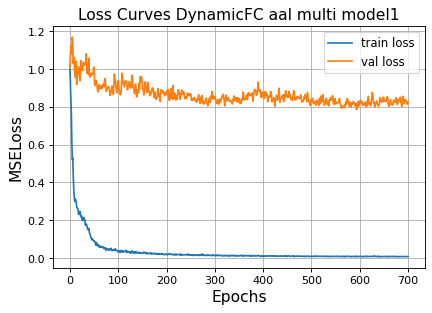

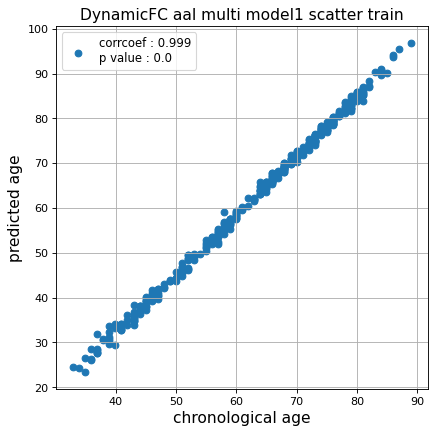

r^2 train data:  0.8938212624031209


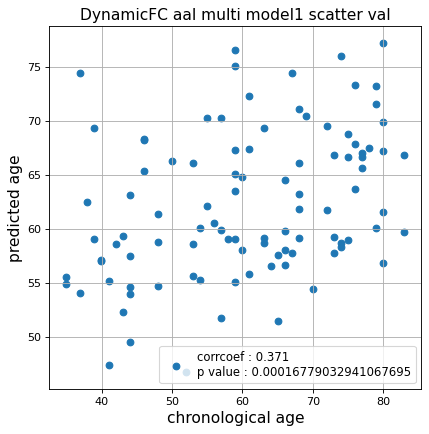

r^2 val data:  0.10579356968155029


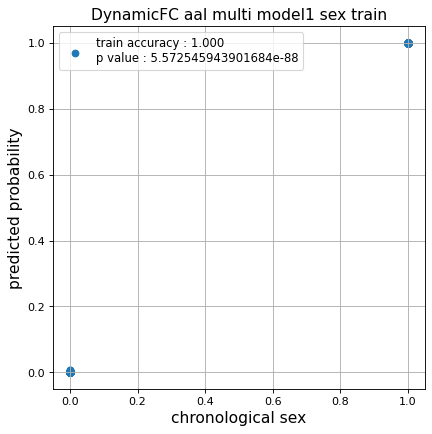

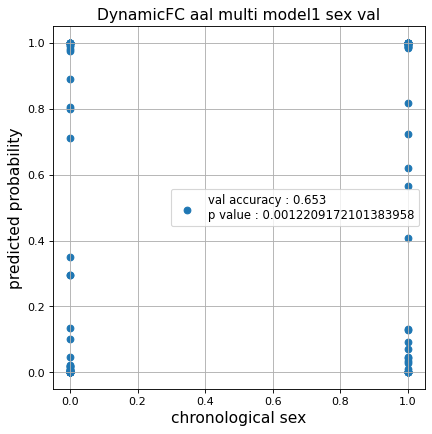

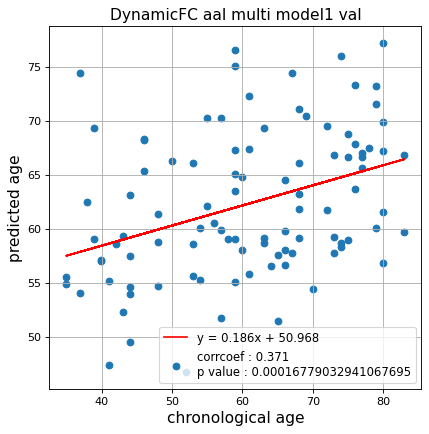

切片: 50.96824861992633
傾き: 0.18648356995425305
Kfold: 4 ::: epoch: 100, loss: 0.03459399537398265, val loss: 0.731726735830307
Kfold: 4 ::: epoch: 200, loss: 0.021416139144163866, val loss: 0.7311262339353561
Kfold: 4 ::: epoch: 300, loss: 0.01079995923030835, val loss: 0.7594842910766602
Kfold: 4 ::: epoch: 400, loss: 0.00949540318777928, val loss: 0.7612013667821884
early stopping
save_epochs:240
best val loss:0.6902123987674713


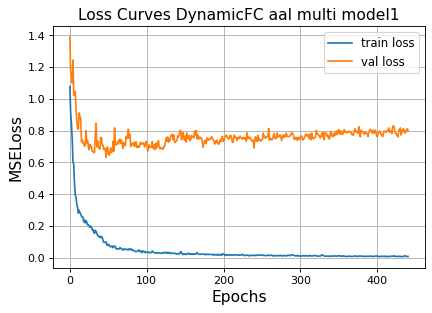

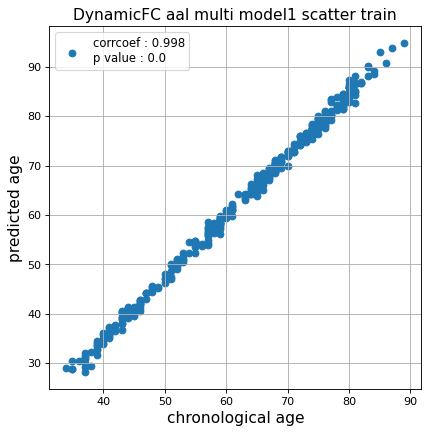

r^2 train data:  0.9348995350412178


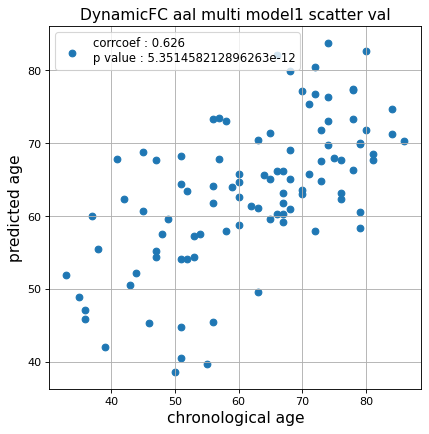

r^2 val data:  0.36888248665713963


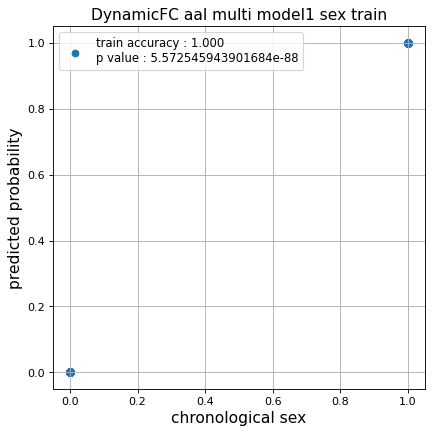

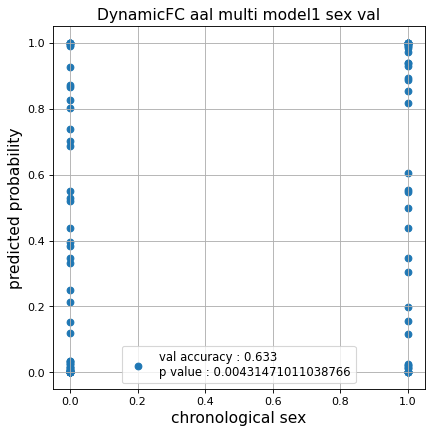

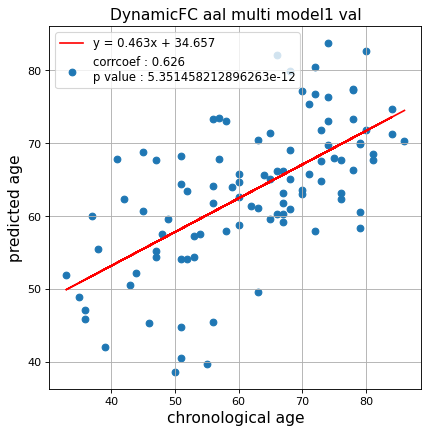

切片: 34.65683985108154
傾き: 0.4632384735437375
Kfold: 5 ::: epoch: 100, loss: 0.033940125686618, val loss: 0.7090523317456245
Kfold: 5 ::: epoch: 200, loss: 0.015886482711021718, val loss: 0.6869925260543823
Kfold: 5 ::: epoch: 300, loss: 0.010413760408902397, val loss: 0.718074157834053
Kfold: 5 ::: epoch: 400, loss: 0.007628163018335517, val loss: 0.7075374126434326
early stopping
save_epochs:224
best val loss:0.6616697609424591


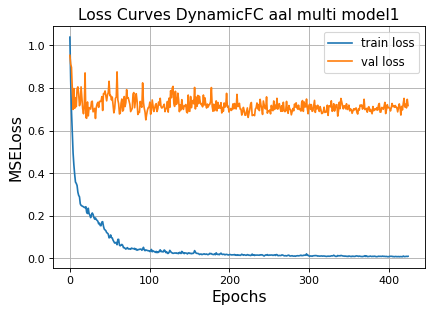

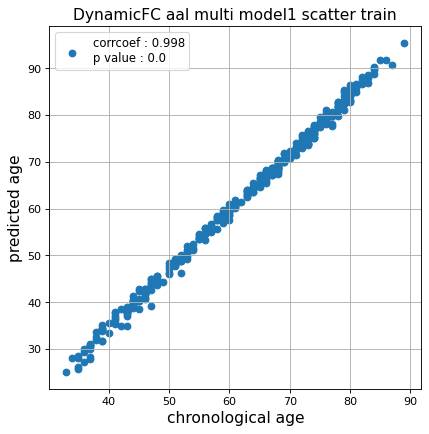

r^2 train data:  0.9359747124579535


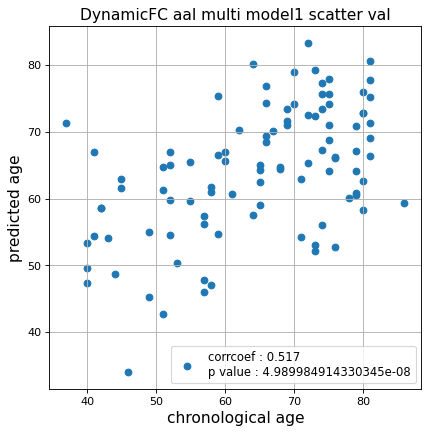

r^2 val data:  0.20797651270476347


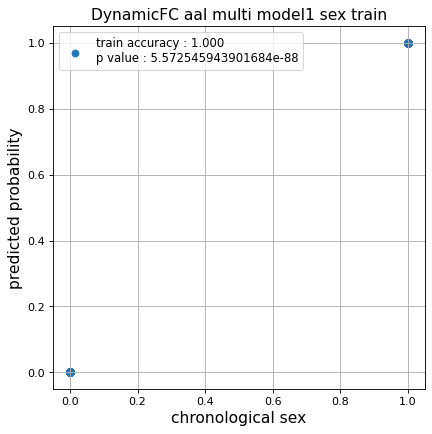

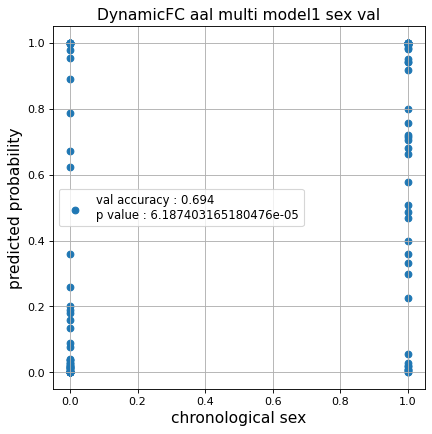

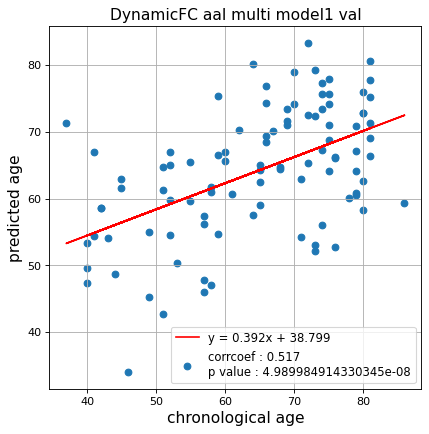

切片: 38.79875909778757
傾き: 0.3916231059226078
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.03639776460253275, val loss: 0.6174307987093925
Kfold: 1 ::: epoch: 200, loss: 0.02105025151887765, val loss: 0.6701843664050102
Kfold: 1 ::: epoch: 300, loss: 0.015089948589985188, val loss: 0.723219633102417
Kfold: 1 ::: epoch: 400, loss: 0.01169167308566662, val loss: 0.7346411049365997
early stopping
save_epochs:255
best val loss:0.6414805352687836


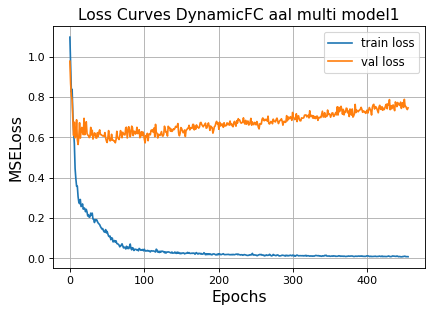

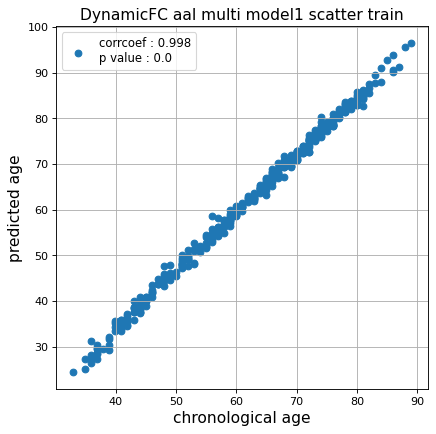

r^2 train data:  0.9217105758928242


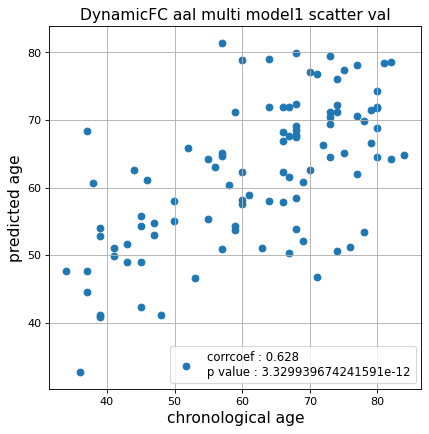

r^2 val data:  0.3726944766339456


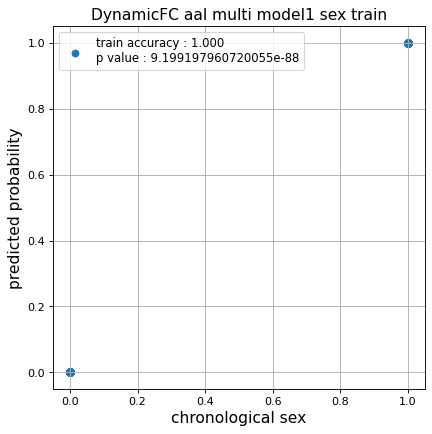

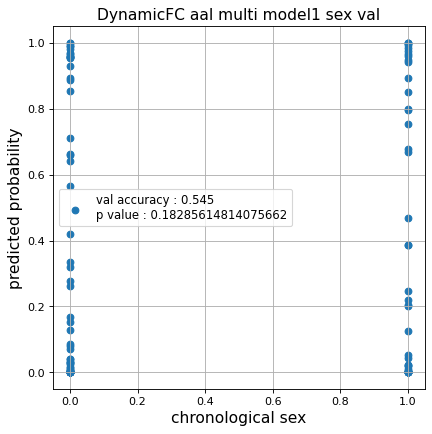

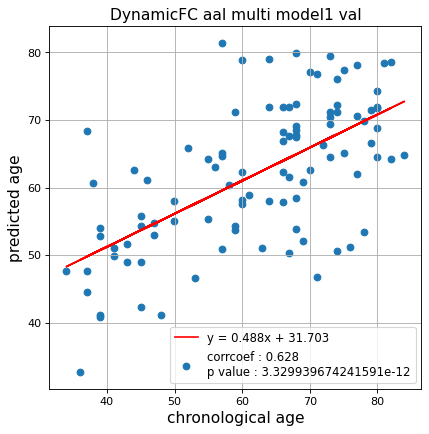

切片: 31.70298014602926
傾き: 0.4884343947193561
Kfold: 2 ::: epoch: 100, loss: 0.041985873849346086, val loss: 0.8371411561965942
Kfold: 2 ::: epoch: 200, loss: 0.020258155149909165, val loss: 0.7589652091264725
Kfold: 2 ::: epoch: 300, loss: 0.014428336818057757, val loss: 0.708650067448616
Kfold: 2 ::: epoch: 400, loss: 0.00954461910833533, val loss: 0.721477597951889
Kfold: 2 ::: epoch: 500, loss: 0.0089026027573989, val loss: 0.6929512470960617
Kfold: 2 ::: epoch: 600, loss: 0.007894661779013963, val loss: 0.6687073782086372
Kfold: 2 ::: epoch: 700, loss: 0.005150452148742401, val loss: 0.6550746560096741
save_epochs:692
best val loss:0.6360922604799271


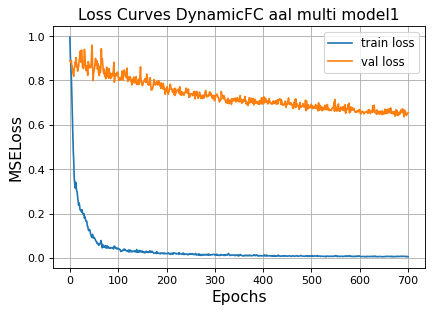

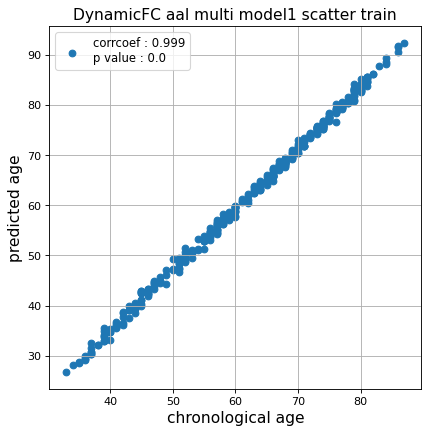

r^2 train data:  0.9512826130874397


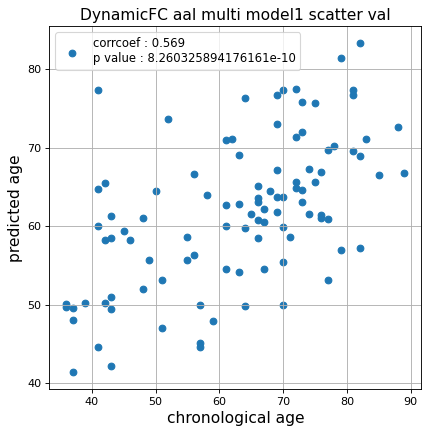

r^2 val data:  0.31008479804892386


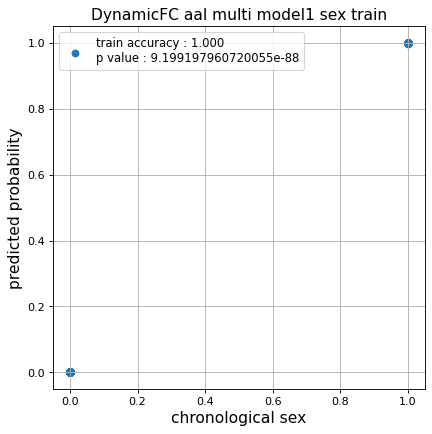

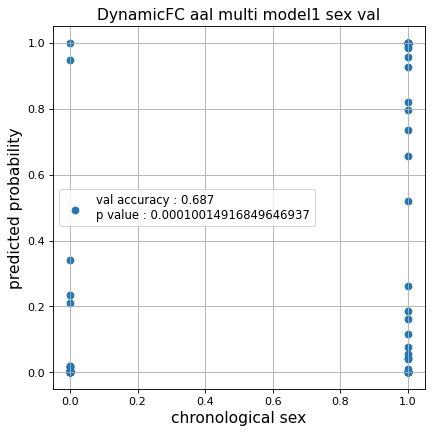

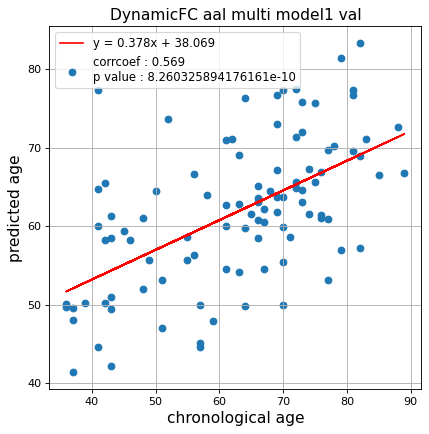

切片: 38.06883972562376
傾き: 0.37809692697700575
Kfold: 3 ::: epoch: 100, loss: 0.03519388474524021, val loss: 0.5910501405596733
Kfold: 3 ::: epoch: 200, loss: 0.01846308927409924, val loss: 0.5320556238293648
Kfold: 3 ::: epoch: 300, loss: 0.012219289711748179, val loss: 0.49930529296398163
Kfold: 3 ::: epoch: 400, loss: 0.008408491069880815, val loss: 0.5020975545048714
early stopping
save_epochs:202
best val loss:0.4524715431034565


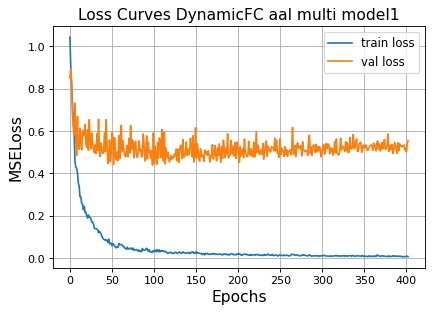

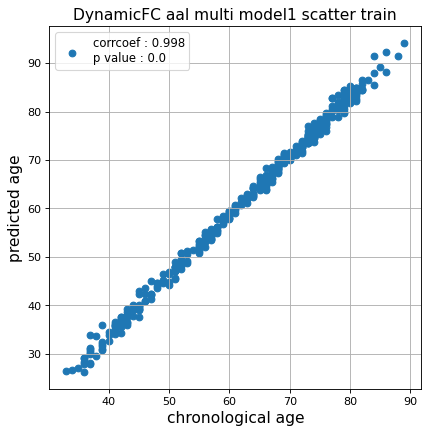

r^2 train data:  0.936693683720447


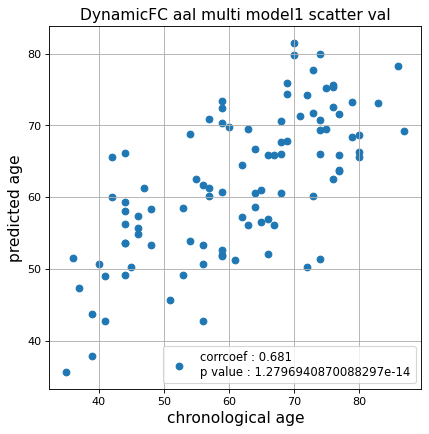

r^2 val data:  0.4567510759092144


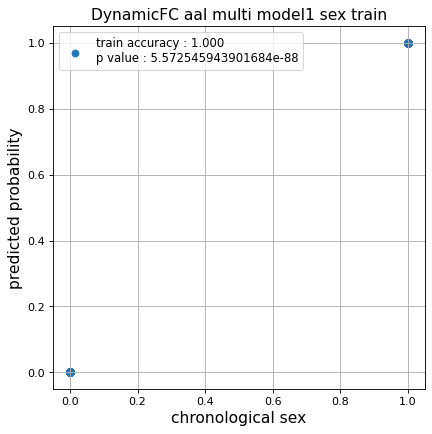

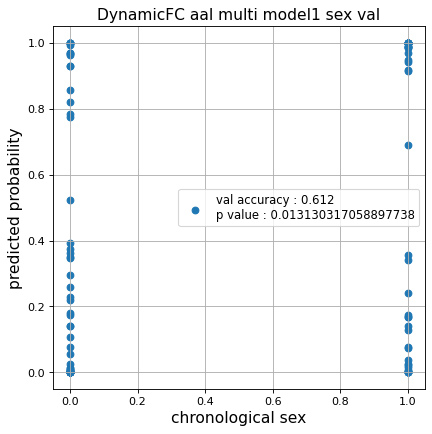

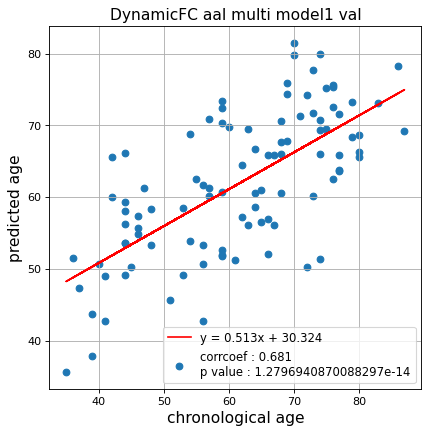

切片: 30.323720345388548
傾き: 0.5129114959197779
Kfold: 4 ::: epoch: 100, loss: 0.03392323923225586, val loss: 1.0733479857444763
Kfold: 4 ::: epoch: 200, loss: 0.017997300109037988, val loss: 0.9542545825242996
Kfold: 4 ::: epoch: 300, loss: 0.010349980107723521, val loss: 0.9140107482671738
Kfold: 4 ::: epoch: 400, loss: 0.009131545165123848, val loss: 0.8987694382667542
Kfold: 4 ::: epoch: 500, loss: 0.007078138932299156, val loss: 0.9803778529167175
early stopping
save_epochs:327
best val loss:0.8931930512189865


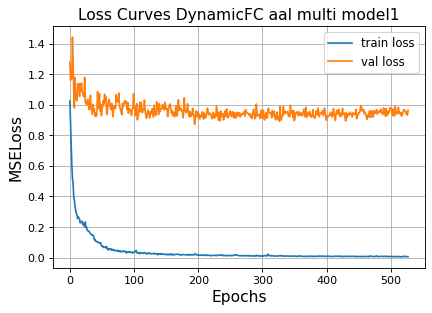

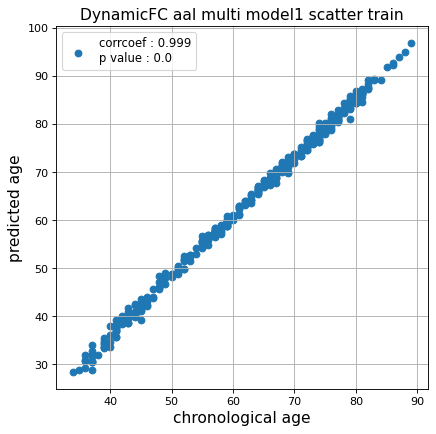

r^2 train data:  0.9293503541462518


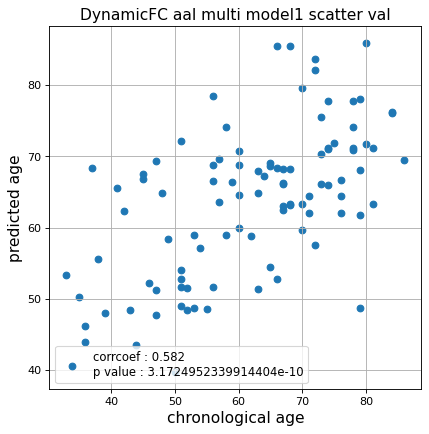

r^2 val data:  0.2860466691847289


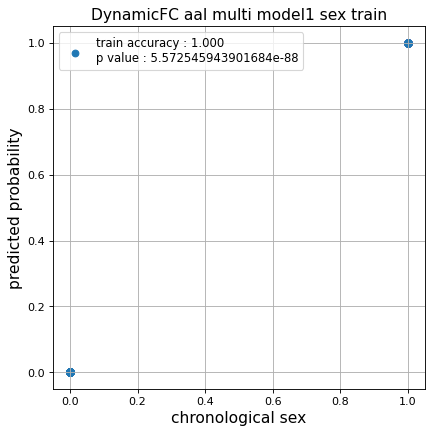

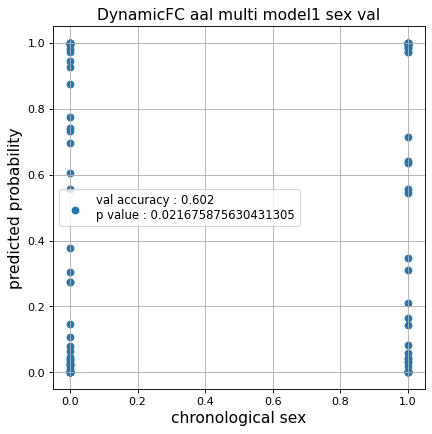

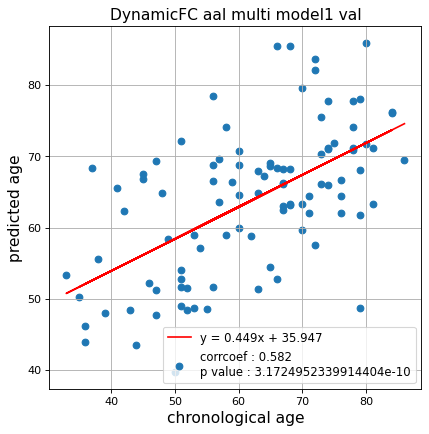

切片: 35.94679371756951
傾き: 0.4489813060482044
Kfold: 5 ::: epoch: 100, loss: 0.049263291920606904, val loss: 0.585621640086174
Kfold: 5 ::: epoch: 200, loss: 0.018306941367112674, val loss: 0.573027964681387
Kfold: 5 ::: epoch: 300, loss: 0.012838065803337555, val loss: 0.5583326369524002
Kfold: 5 ::: epoch: 400, loss: 0.01083285160935842, val loss: 0.563188698142767
Kfold: 5 ::: epoch: 500, loss: 0.006599390924048538, val loss: 0.5591790163889527
early stopping
save_epochs:315
best val loss:0.5419535906985402


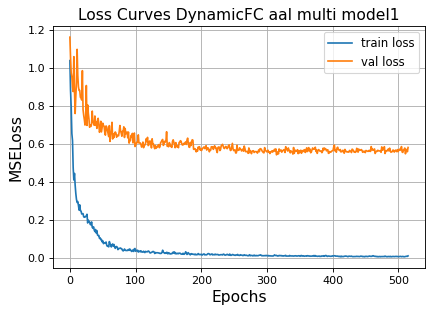

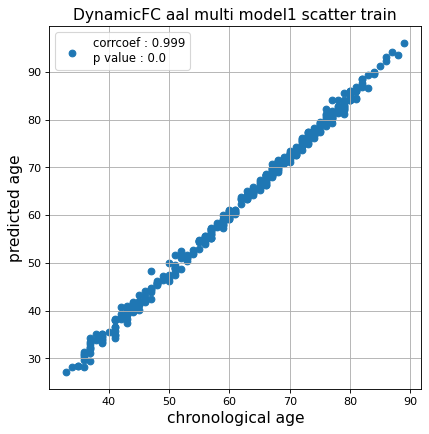

r^2 train data:  0.9401803288836963


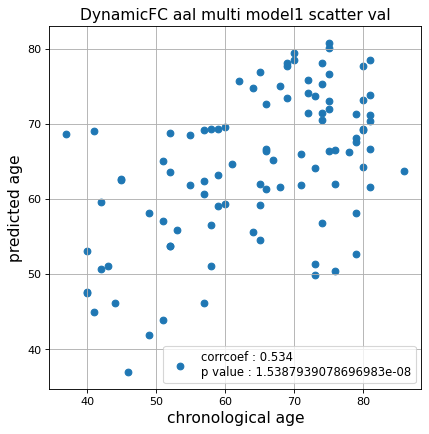

r^2 val data:  0.22635242868102112


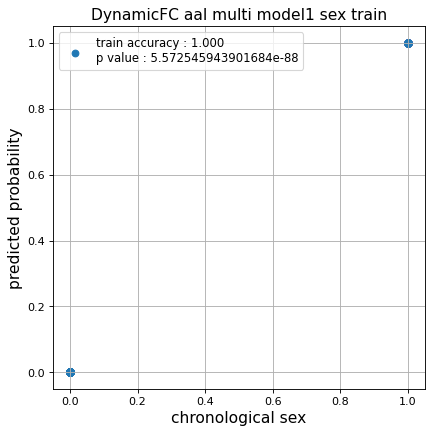

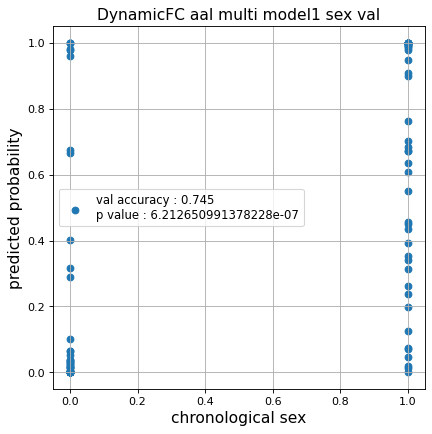

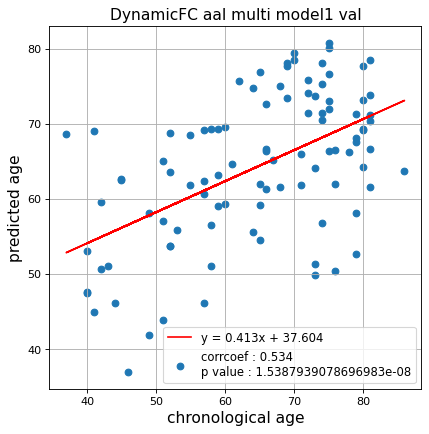

切片: 37.60389614388796
傾き: 0.41271208824761435
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.0327084930613637, val loss: 0.6335853785276413
Kfold: 1 ::: epoch: 200, loss: 0.019460114578788098, val loss: 0.623845212161541
Kfold: 1 ::: epoch: 300, loss: 0.015928435282638438, val loss: 0.6514133661985397
Kfold: 1 ::: epoch: 400, loss: 0.011341269522045668, val loss: 0.655259758234024
early stopping
save_epochs:217
best val loss:0.6011607125401497


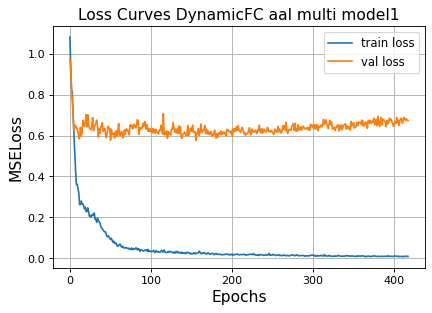

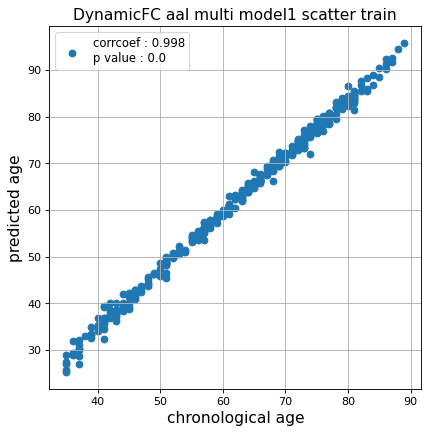

r^2 train data:  0.9432979494336549


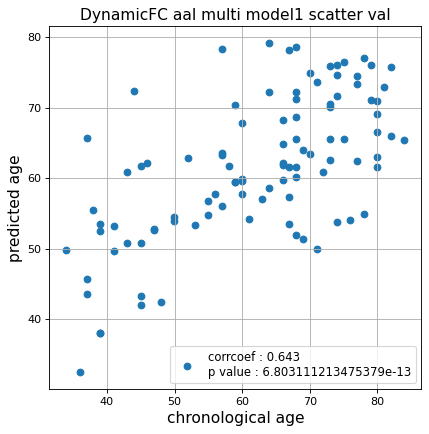

r^2 val data:  0.4031452225716785


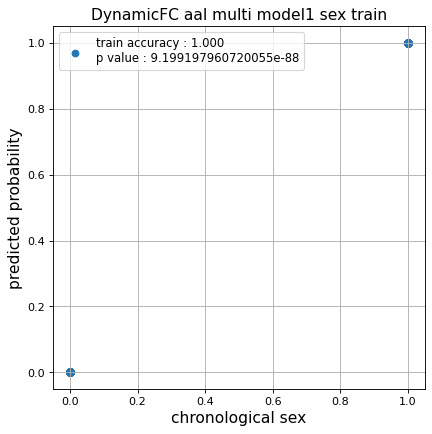

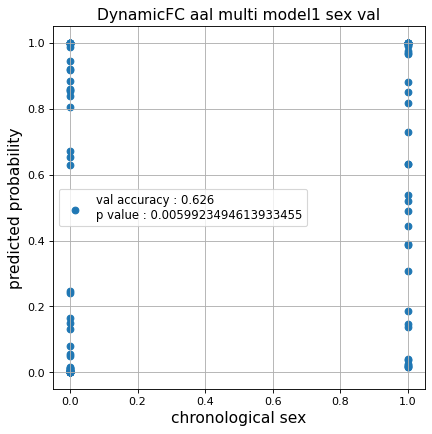

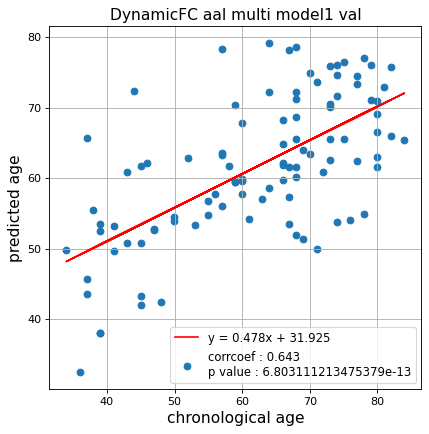

切片: 31.924695971055634
傾き: 0.4776542519190198
Kfold: 2 ::: epoch: 100, loss: 0.03924785669033344, val loss: 0.7351383846253157
Kfold: 2 ::: epoch: 200, loss: 0.019175530948604528, val loss: 0.7102953568100929
Kfold: 2 ::: epoch: 300, loss: 0.012599110782433014, val loss: 0.6784588098526001
Kfold: 2 ::: epoch: 400, loss: 0.009364569129852148, val loss: 0.6650292798876762
Kfold: 2 ::: epoch: 500, loss: 0.009234959510369943, val loss: 0.6812639459967613
early stopping
save_epochs:394
best val loss:0.6484988555312157


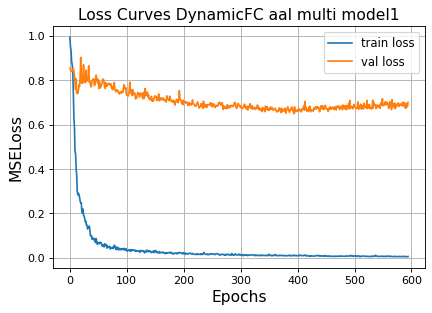

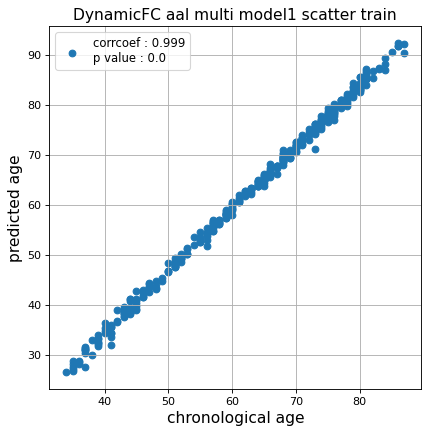

r^2 train data:  0.9392939906602579


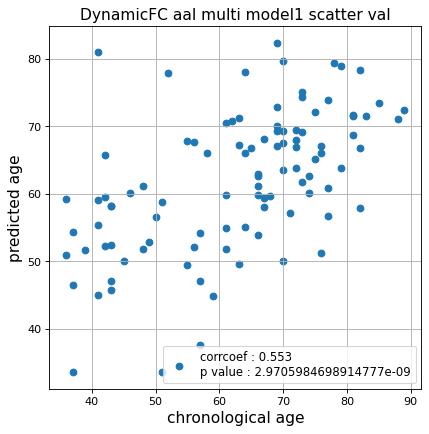

r^2 val data:  0.27059380010076484


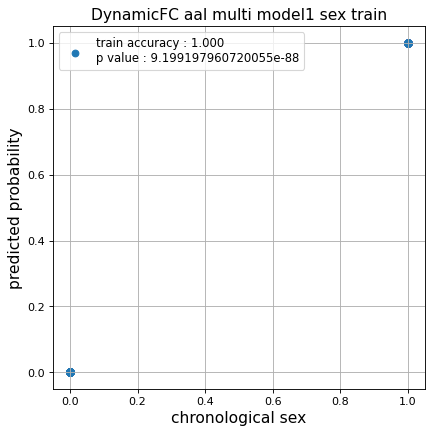

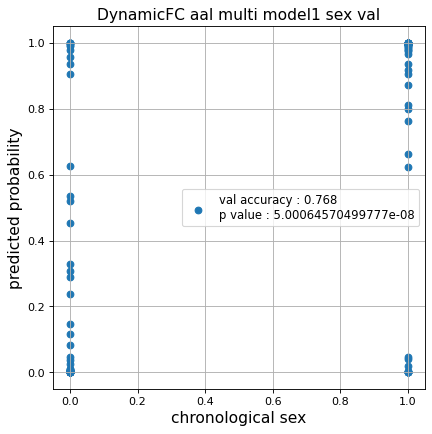

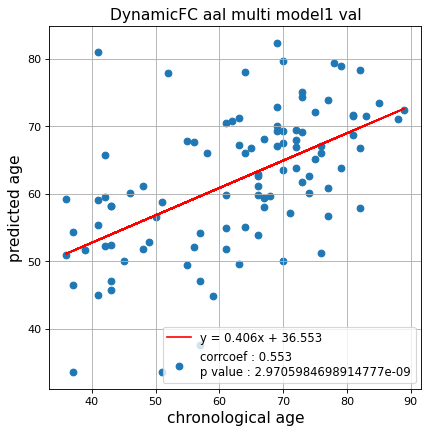

切片: 36.55347959592946
傾き: 0.40554801523378975
Kfold: 3 ::: epoch: 100, loss: 0.04036046793827644, val loss: 0.6012631664052606
Kfold: 3 ::: epoch: 200, loss: 0.01891034232595792, val loss: 0.5929112085141242
Kfold: 3 ::: epoch: 300, loss: 0.011836078591071643, val loss: 0.5647512457799166
Kfold: 3 ::: epoch: 400, loss: 0.011326212937442156, val loss: 0.5392784010618925
Kfold: 3 ::: epoch: 500, loss: 0.008259213887728177, val loss: 0.5227247620932758
Kfold: 3 ::: epoch: 600, loss: 0.0068855772797877975, val loss: 0.5328733567148447
Kfold: 3 ::: epoch: 700, loss: 0.005681868427647994, val loss: 0.5396780129522085
save_epochs:658
best val loss:0.5054919980466366


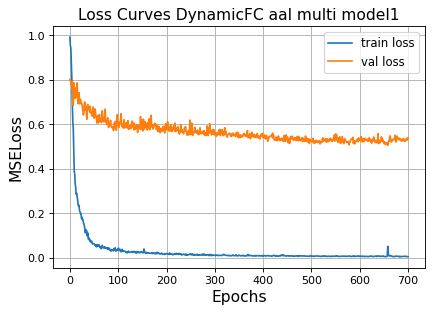

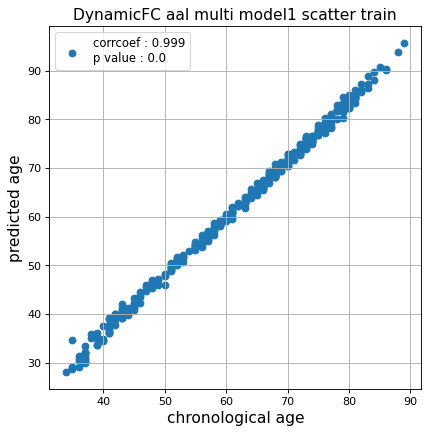

r^2 train data:  0.9613872030960661


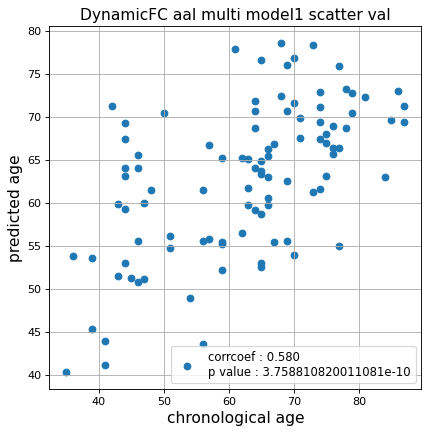

r^2 val data:  0.32944773873741173


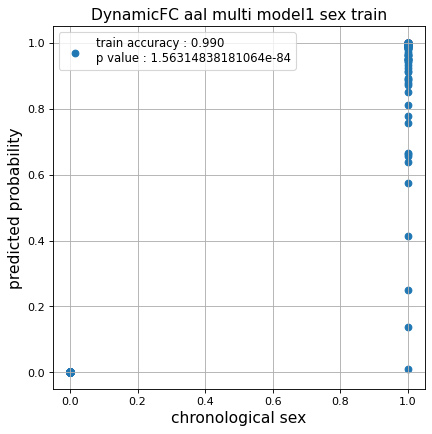

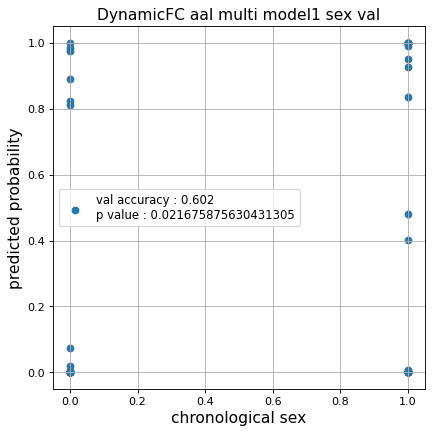

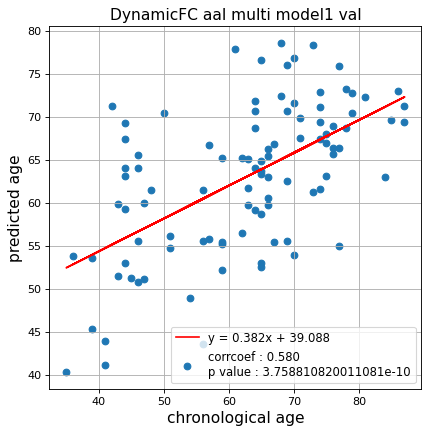

切片: 39.08766328356616
傾き: 0.3818310186643847
Kfold: 4 ::: epoch: 100, loss: 0.03220817317756323, val loss: 1.0078308805823326
Kfold: 4 ::: epoch: 200, loss: 0.015384562635937562, val loss: 0.9333170056343079
Kfold: 4 ::: epoch: 300, loss: 0.010176398218251191, val loss: 0.9283395186066628
Kfold: 4 ::: epoch: 400, loss: 0.009692444358594142, val loss: 0.9087418168783188
Kfold: 4 ::: epoch: 500, loss: 0.007804287669177239, val loss: 0.9170964658260345
Kfold: 4 ::: epoch: 600, loss: 0.0058501253907497115, val loss: 0.8807197958230972
Kfold: 4 ::: epoch: 700, loss: 0.006636886588799266, val loss: 0.9056937620043755
save_epochs:606
best val loss:0.8554219901561737


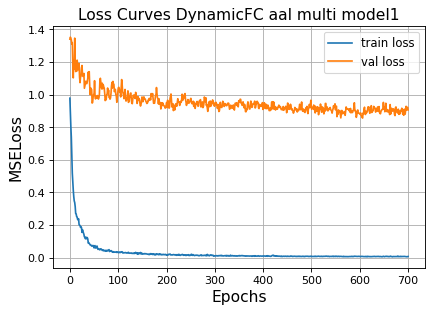

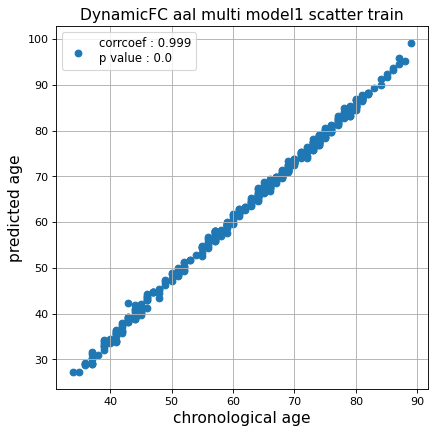

r^2 train data:  0.9117302235389793


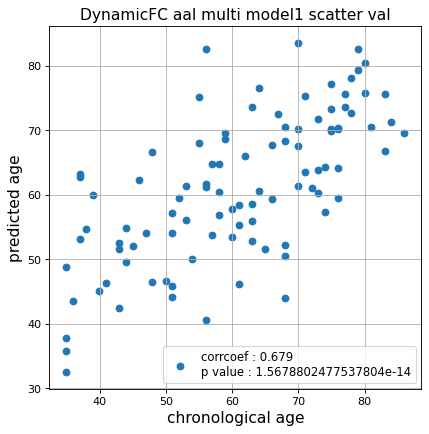

r^2 val data:  0.44192348728064945


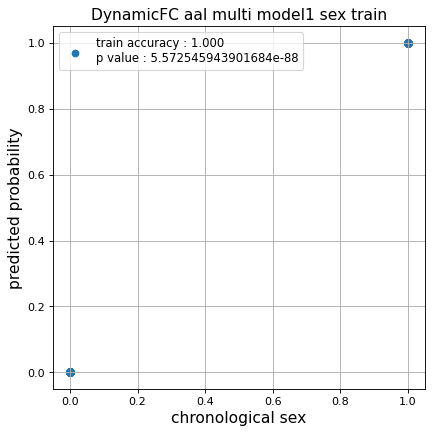

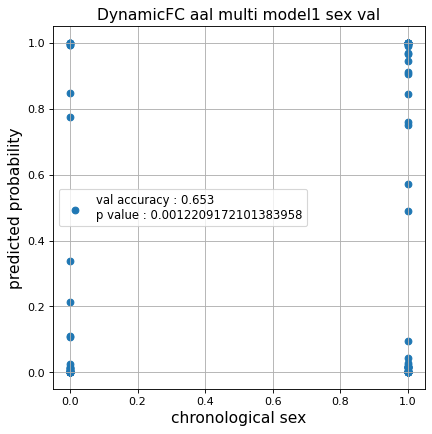

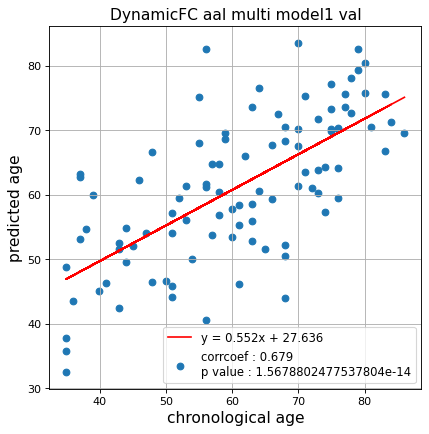

切片: 27.636137432817605
傾き: 0.5521758223293604
Kfold: 5 ::: epoch: 100, loss: 0.03415911057247566, val loss: 0.8941241353750229
Kfold: 5 ::: epoch: 200, loss: 0.019919233826490548, val loss: 0.8020416051149368
Kfold: 5 ::: epoch: 300, loss: 0.01472788991836401, val loss: 0.7290630787611008
Kfold: 5 ::: epoch: 400, loss: 0.010964289880715884, val loss: 0.6598625630140305
Kfold: 5 ::: epoch: 500, loss: 0.008598312538547011, val loss: 0.6112305968999863
Kfold: 5 ::: epoch: 600, loss: 0.007820978599528853, val loss: 0.6173732206225395
Kfold: 5 ::: epoch: 700, loss: 0.0072078442989060515, val loss: 0.600178524851799
save_epochs:655
best val loss:0.5750287547707558


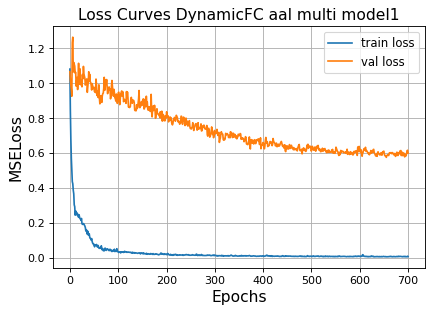

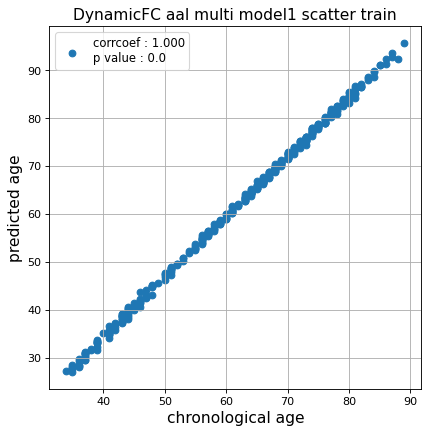

r^2 train data:  0.9331888654840506


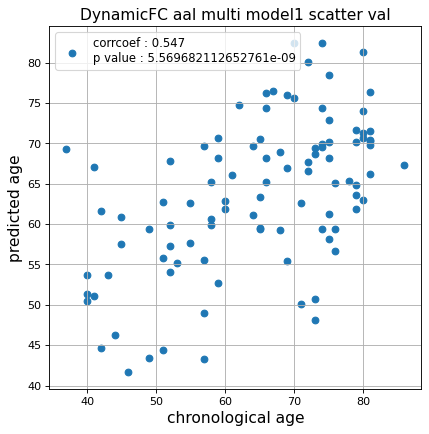

r^2 val data:  0.2595533571104939


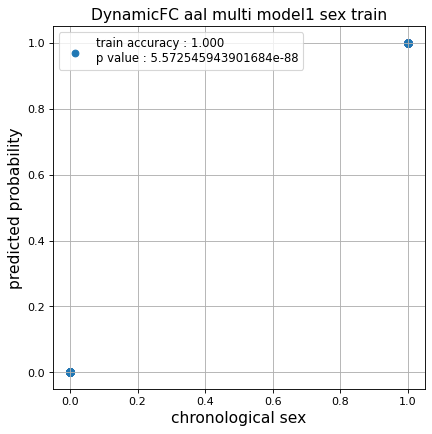

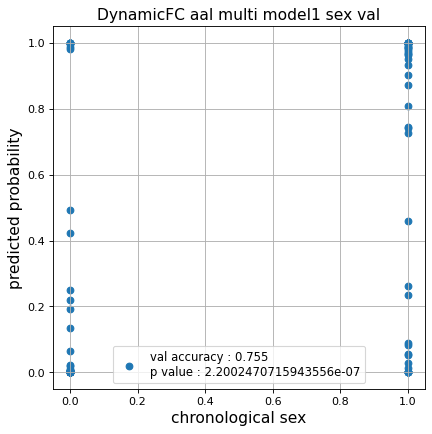

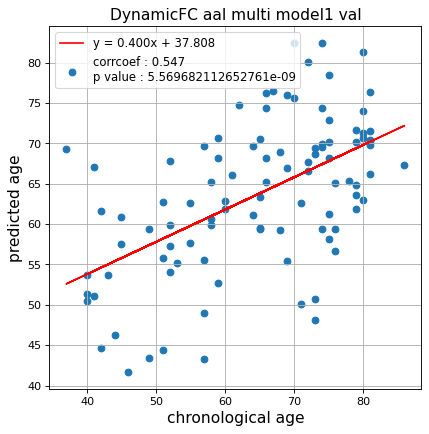

切片: 37.80766942575117
傾き: 0.3996382915277256
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.032218217419890255, val loss: 0.7450571805238724
Kfold: 1 ::: epoch: 200, loss: 0.018634392629162624, val loss: 0.7101330310106277
Kfold: 1 ::: epoch: 300, loss: 0.015819166213847123, val loss: 0.713713988661766
Kfold: 1 ::: epoch: 400, loss: 0.008696379175839515, val loss: 0.7342071235179901
early stopping
save_epochs:219
best val loss:0.6589263752102852


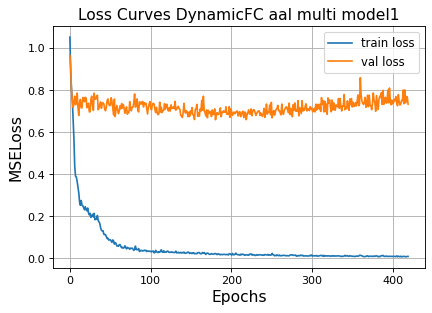

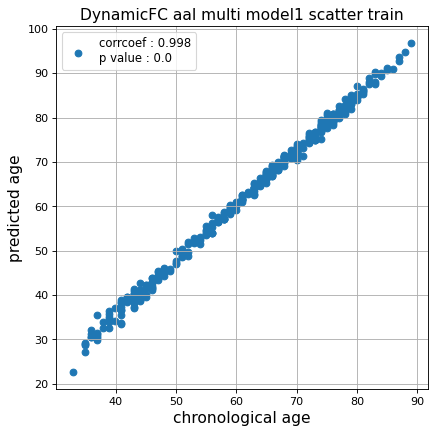

r^2 train data:  0.9353840277189136


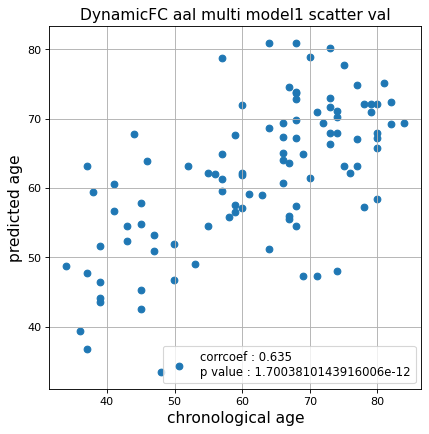

r^2 val data:  0.38845208224997585


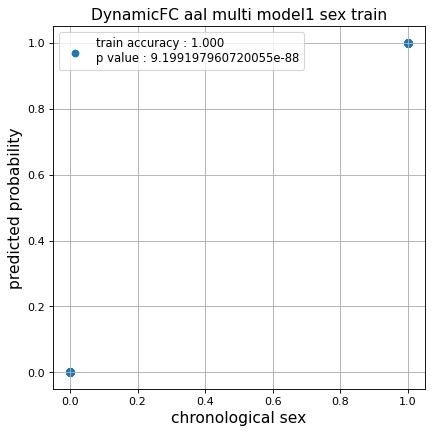

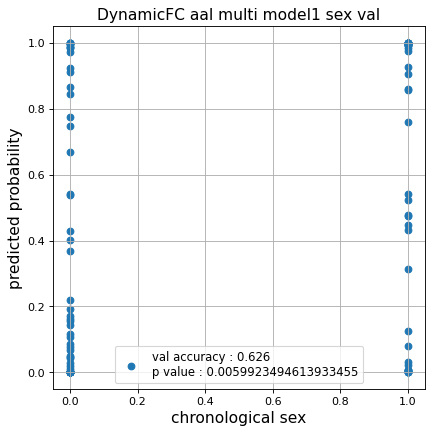

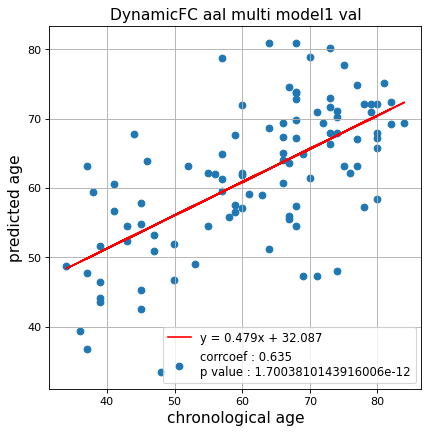

切片: 32.087099728080034
傾き: 0.47922050039948433
Kfold: 2 ::: epoch: 100, loss: 0.0362265408039093, val loss: 0.752946138381958
Kfold: 2 ::: epoch: 200, loss: 0.01655029641607633, val loss: 0.7080700844526291
Kfold: 2 ::: epoch: 300, loss: 0.010464438308890048, val loss: 0.6769227087497711
Kfold: 2 ::: epoch: 400, loss: 0.009324415085407404, val loss: 0.6788022145628929
early stopping
save_epochs:265
best val loss:0.6491773650050163


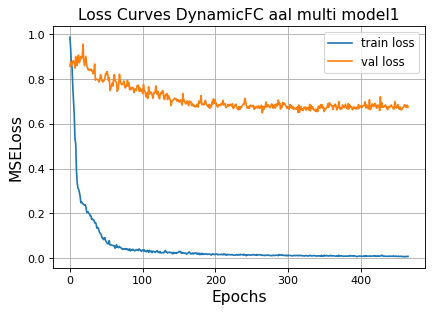

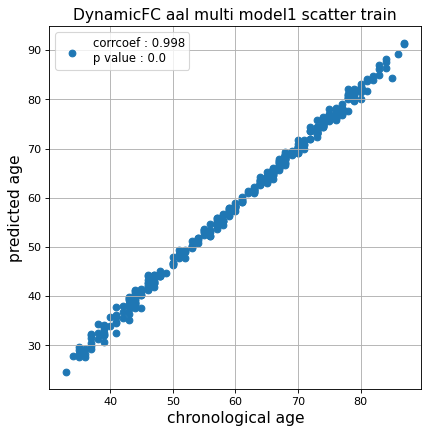

r^2 train data:  0.9514763232945677


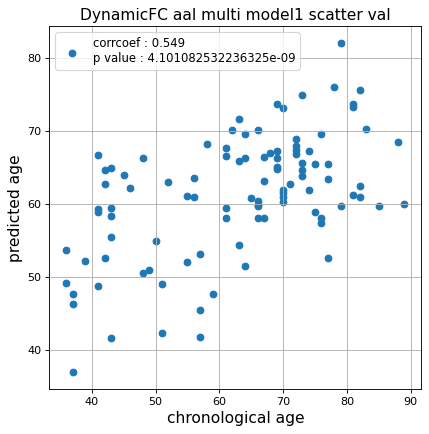

r^2 val data:  0.28847117219145446


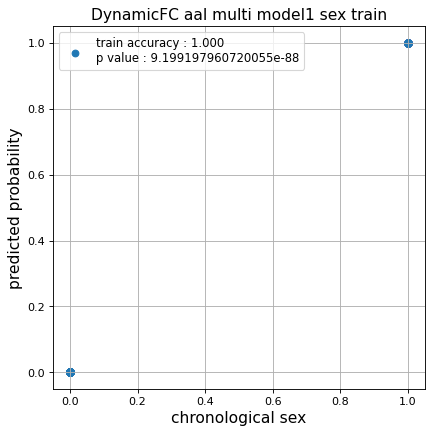

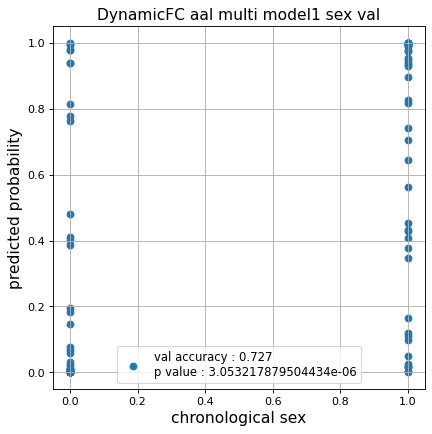

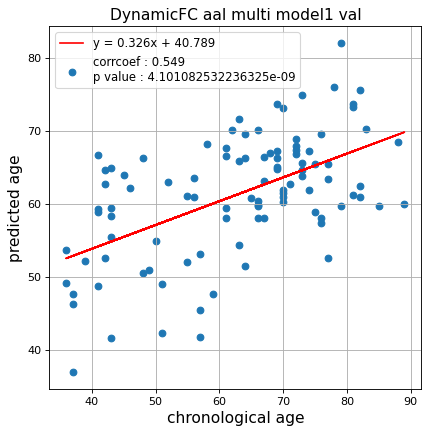

切片: 40.78943405939633
傾き: 0.3257141543238223
Kfold: 3 ::: epoch: 100, loss: 0.050788396396316014, val loss: 0.6308556608855724
Kfold: 3 ::: epoch: 200, loss: 0.025160015775607183, val loss: 0.5971880033612251
Kfold: 3 ::: epoch: 300, loss: 0.017762461318992652, val loss: 0.5578596889972687
Kfold: 3 ::: epoch: 400, loss: 0.010795262534744464, val loss: 0.5463937446475029
Kfold: 3 ::: epoch: 500, loss: 0.009998306023100248, val loss: 0.5487951561808586
Kfold: 3 ::: epoch: 600, loss: 0.008326462792375913, val loss: 0.49059513956308365
Kfold: 3 ::: epoch: 700, loss: 0.007713793239627893, val loss: 0.47278454899787903
save_epochs:700
best val loss:0.47278454899787903


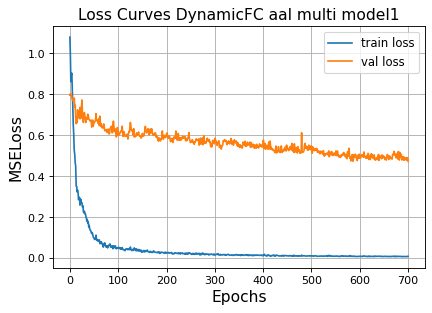

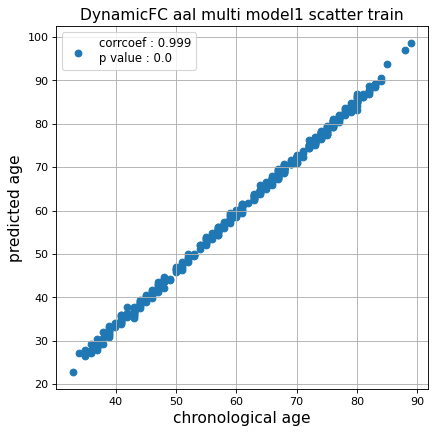

r^2 train data:  0.907099614412626


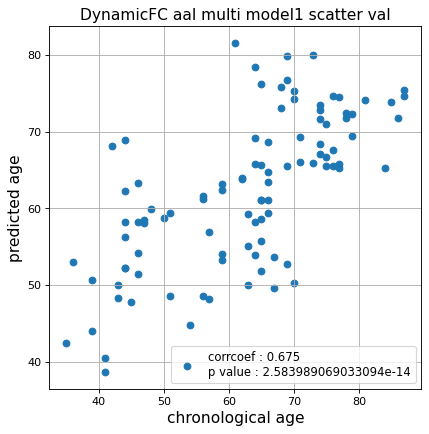

r^2 val data:  0.44930693291491575


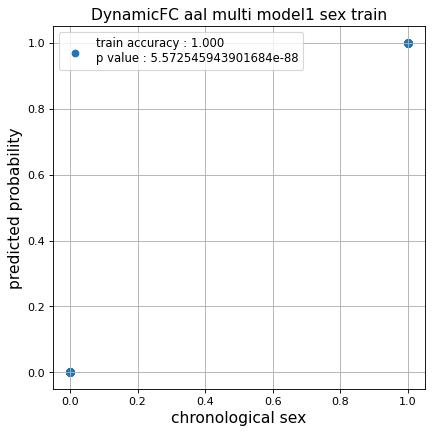

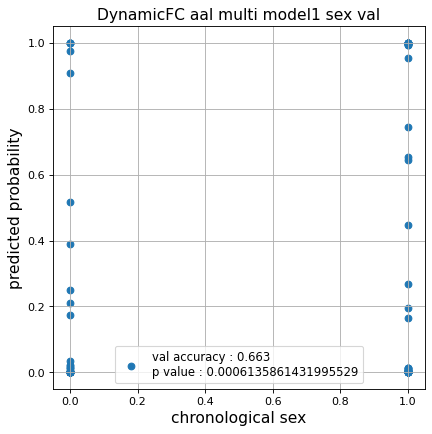

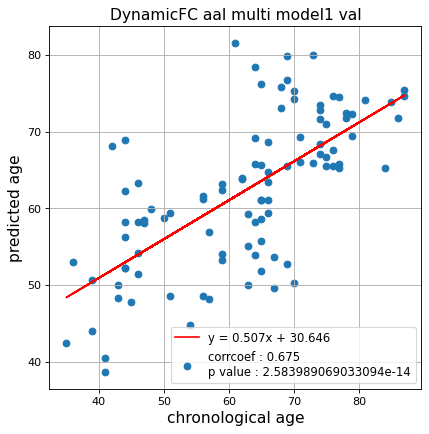

切片: 30.645630729449582
傾き: 0.5067567659691484
Kfold: 4 ::: epoch: 100, loss: 0.03947422581796463, val loss: 0.49160218238830566
Kfold: 4 ::: epoch: 200, loss: 0.02381759824661108, val loss: 0.4677501916885376
Kfold: 4 ::: epoch: 300, loss: 0.01227386575192213, val loss: 0.46567483991384506
Kfold: 4 ::: epoch: 400, loss: 0.008326067213112345, val loss: 0.46689244359731674
Kfold: 4 ::: epoch: 500, loss: 0.006648865044833376, val loss: 0.5159548446536064
early stopping
save_epochs:331
best val loss:0.4329965263605118


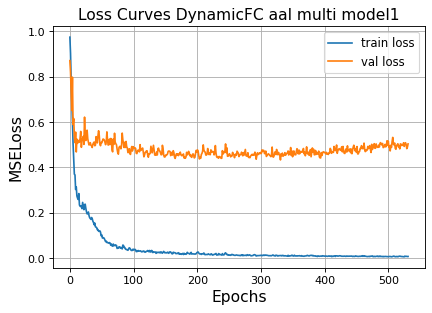

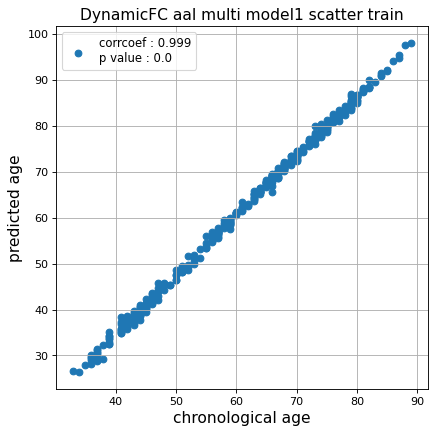

r^2 train data:  0.9015372054292081


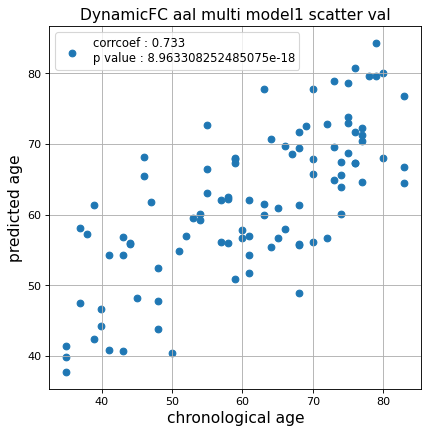

r^2 val data:  0.5336275637311658


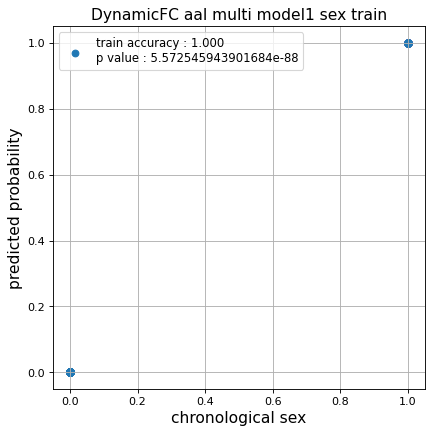

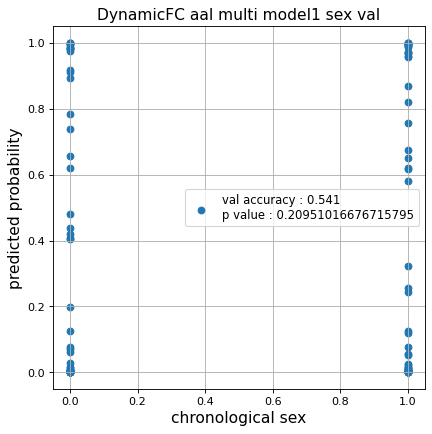

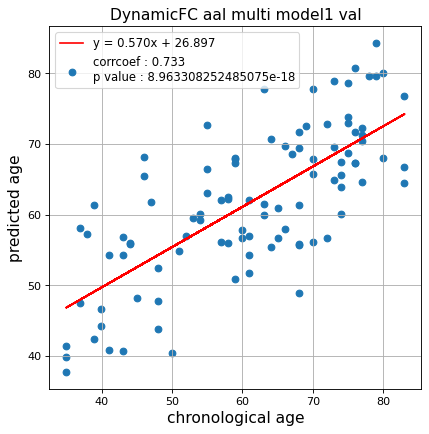

切片: 26.89737462118547
傾き: 0.5702300858948733
Kfold: 5 ::: epoch: 100, loss: 0.042874104844836086, val loss: 0.9262208938598633
Kfold: 5 ::: epoch: 200, loss: 0.022309214951327212, val loss: 0.867838054895401
Kfold: 5 ::: epoch: 300, loss: 0.012867037385988694, val loss: 0.8859991133213043
Kfold: 5 ::: epoch: 400, loss: 0.013298104588802043, val loss: 0.8841821700334549
early stopping
save_epochs:256
best val loss:0.8063362687826157


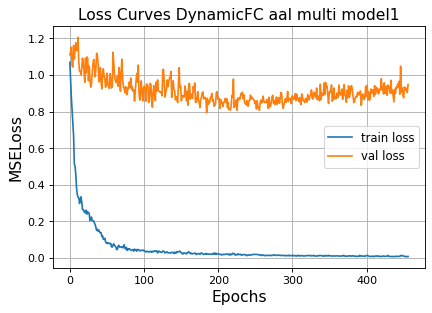

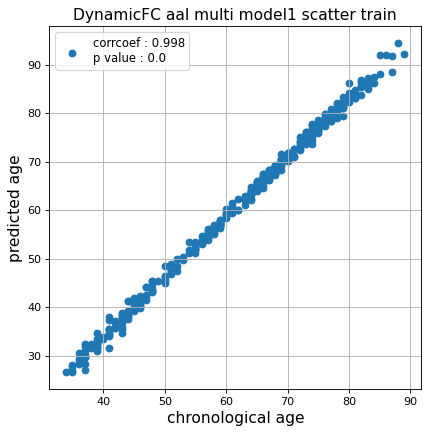

r^2 train data:  0.9366299982013983


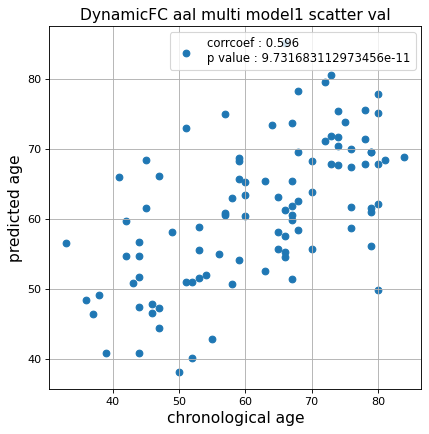

r^2 val data:  0.32379830019567424


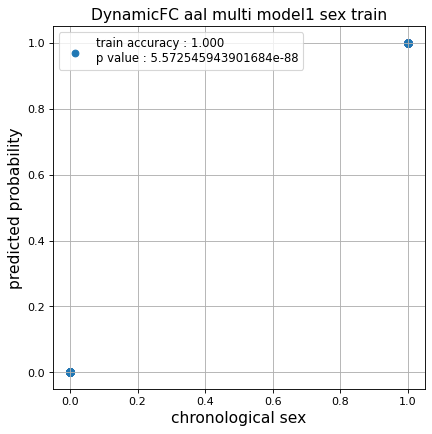

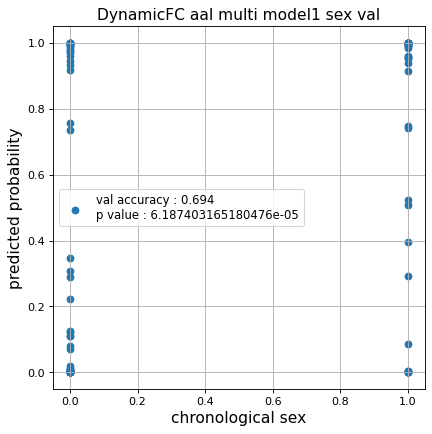

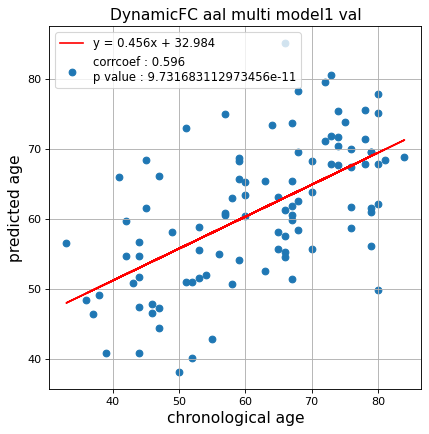

切片: 32.98413252385515
傾き: 0.45586113622961477
CPU times: user 22h 57min 36s, sys: 1min 34s, total: 22h 59min 11s
Wall time: 3h 17min 13s


In [21]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_dynamic_1  = []
test_pred_aal_dynamic_corrected_1  = []
test_label_aal_dynamic_1 = []
test_idx_aal_dynamic_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop   = 0.3,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC aal multi model1'
                                                          )
    
    test_pred_aal_dynamic_1.append(test_pred)
    test_pred_aal_dynamic_corrected_1.append(test_pred_corrected)
    test_label_aal_dynamic_1.append(test_label)
    test_idx_aal_dynamic_1.append(test_idx)

### Dynamic FC 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.038965437274712786, val loss: 0.5772135779261589
Kfold: 1 ::: epoch: 200, loss: 0.021481851903864972, val loss: 0.5576590560376644
Kfold: 1 ::: epoch: 300, loss: 0.013799436390399933, val loss: 0.5529022328555584
Kfold: 1 ::: epoch: 400, loss: 0.008403008230603658, val loss: 0.563962385058403
early stopping
save_epochs:210
best val loss:0.5241303704679012


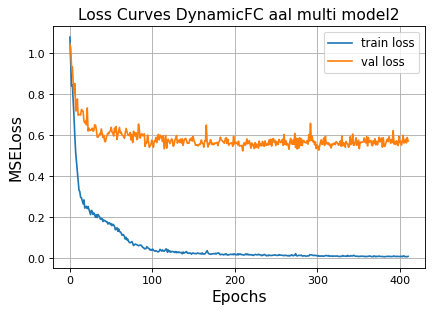

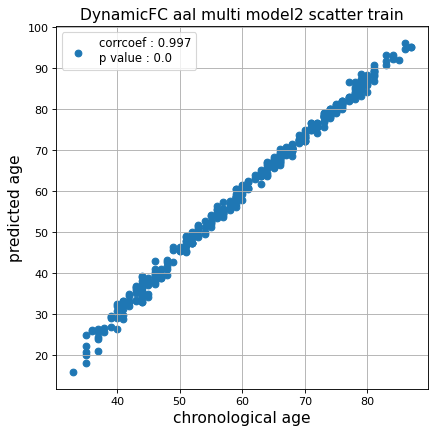

r^2 train data:  0.8100651484654822


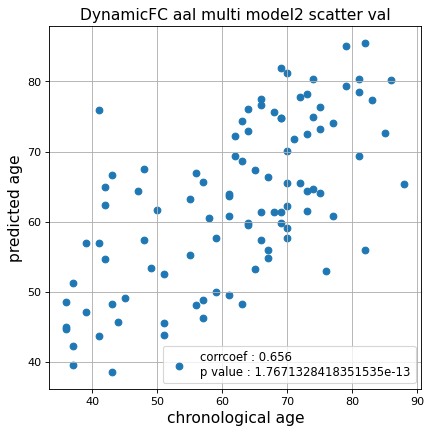

r^2 val data:  0.3912127565572626


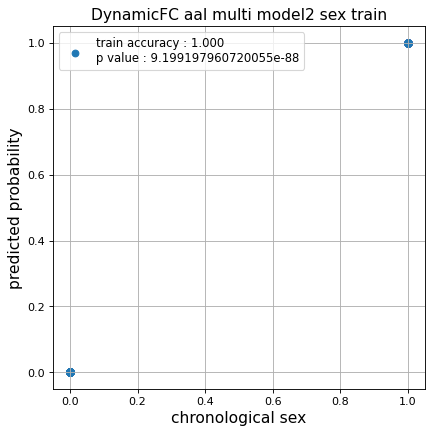

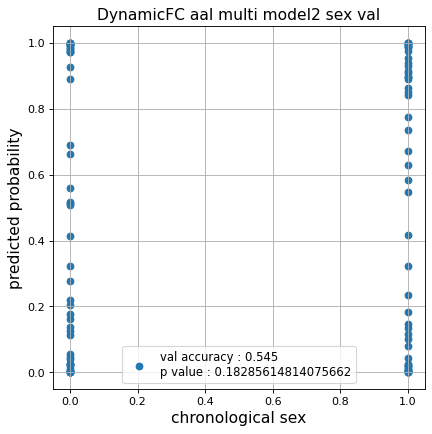

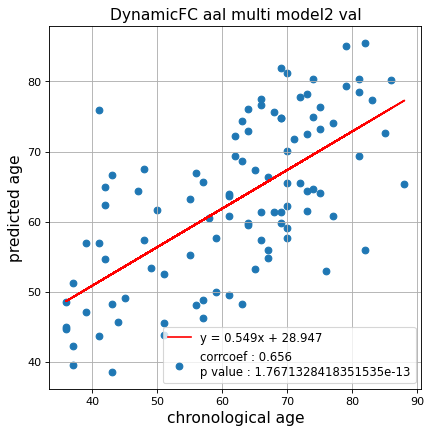

切片: 28.946902546282878
傾き: 0.5491061248592612
Kfold: 2 ::: epoch: 100, loss: 0.03201377835984413, val loss: 0.5963338613510132
Kfold: 2 ::: epoch: 200, loss: 0.014561277885849658, val loss: 0.590259462594986
Kfold: 2 ::: epoch: 300, loss: 0.009032100027140517, val loss: 0.5581004768610001
Kfold: 2 ::: epoch: 400, loss: 0.0067559172076961166, val loss: 0.5471682250499725
Kfold: 2 ::: epoch: 500, loss: 0.0056802633827408916, val loss: 0.5289218202233315
Kfold: 2 ::: epoch: 600, loss: 0.005132145087163036, val loss: 0.507919043302536
Kfold: 2 ::: epoch: 700, loss: 0.004720478390271847, val loss: 0.4979664646089077
save_epochs:639
best val loss:0.48575080186128616


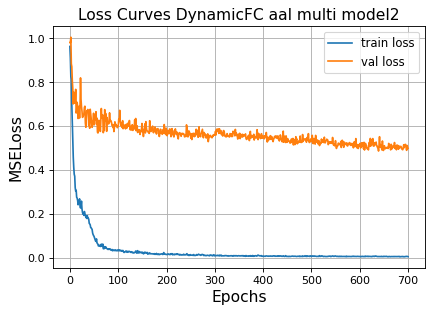

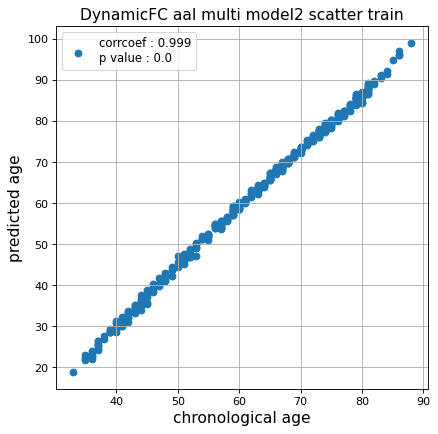

r^2 train data:  0.8238571766542818


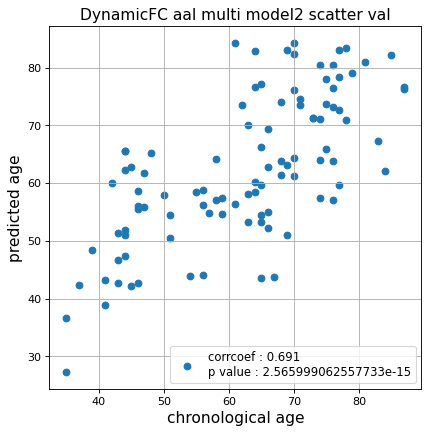

r^2 val data:  0.4121125523989364


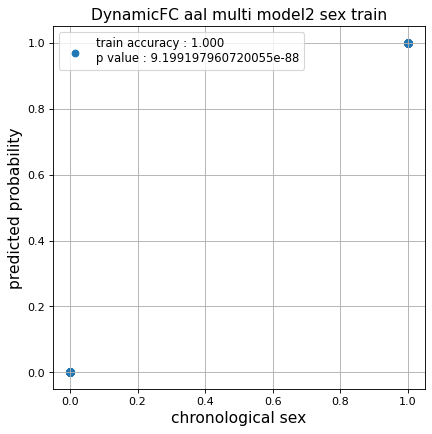

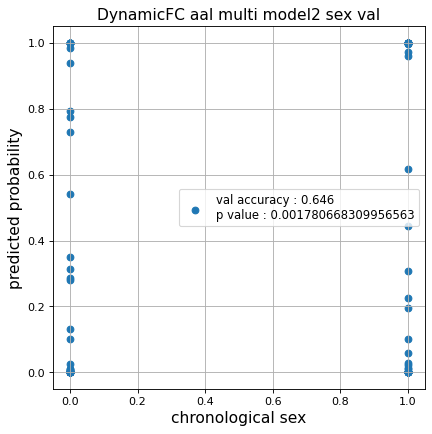

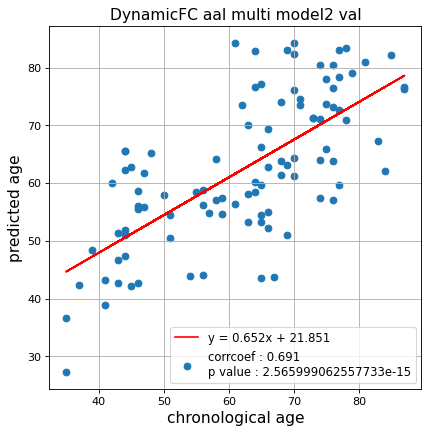

切片: 21.850606376330695
傾き: 0.6524923740221633
Kfold: 3 ::: epoch: 100, loss: 0.03203780533602604, val loss: 0.5593601744621992
Kfold: 3 ::: epoch: 200, loss: 0.01606978655148011, val loss: 0.5605169888585806
Kfold: 3 ::: epoch: 300, loss: 0.012553667506346336, val loss: 0.5515969675034285
Kfold: 3 ::: epoch: 400, loss: 0.009332244821752492, val loss: 0.5390707869082689
Kfold: 3 ::: epoch: 500, loss: 0.007042221581706634, val loss: 0.5603784285485744
early stopping
save_epochs:350
best val loss:0.5179650261998177


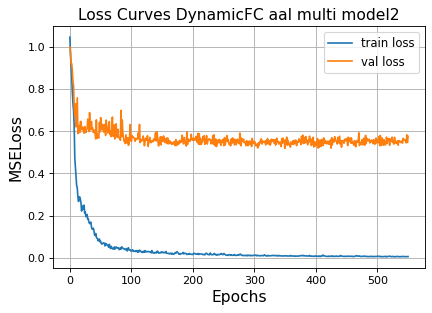

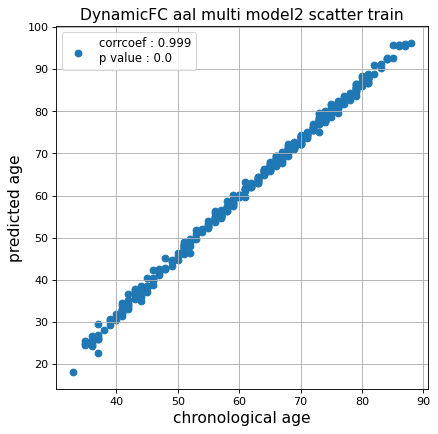

r^2 train data:  0.8494295331023197


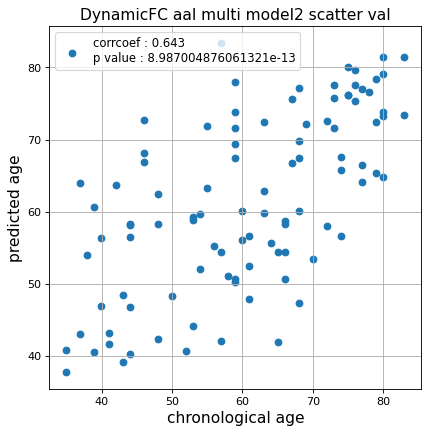

r^2 val data:  0.34113252797429794


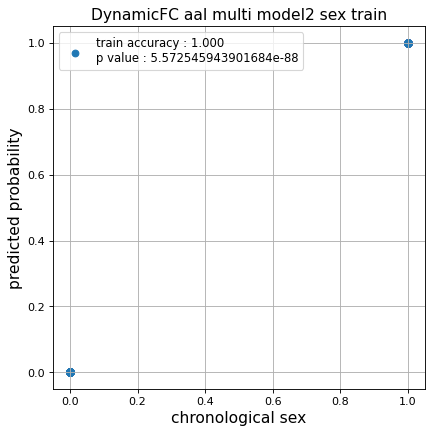

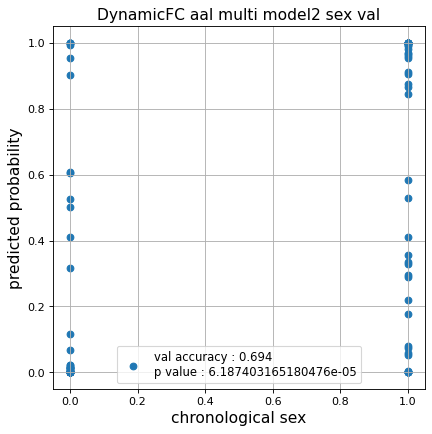

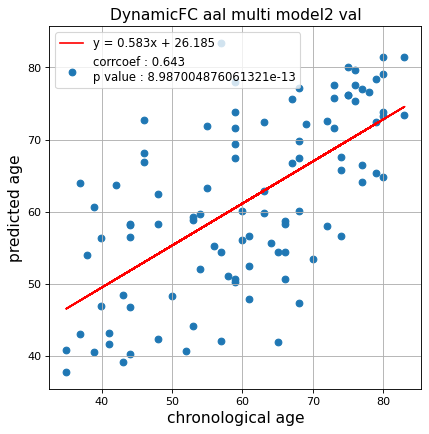

切片: 26.18458966607843
傾き: 0.5826134517614767
Kfold: 4 ::: epoch: 100, loss: 0.03787843997661884, val loss: 0.6789578571915627
Kfold: 4 ::: epoch: 200, loss: 0.016532883406258546, val loss: 0.6105569452047348
Kfold: 4 ::: epoch: 300, loss: 0.012654079769093256, val loss: 0.6376240998506546
Kfold: 4 ::: epoch: 400, loss: 0.010358965991494747, val loss: 0.6666818857192993
early stopping
save_epochs:220
best val loss:0.5791665613651276


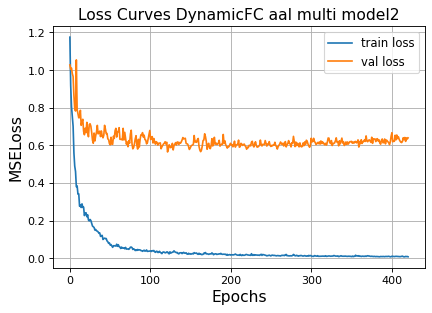

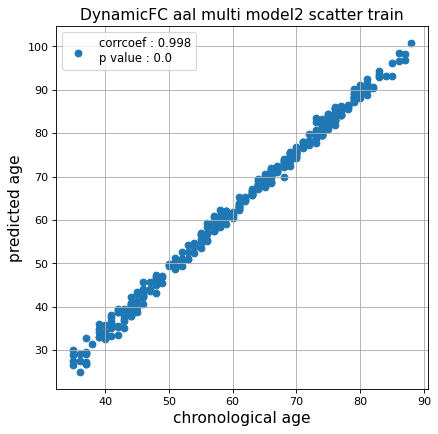

r^2 train data:  0.8080482297566459


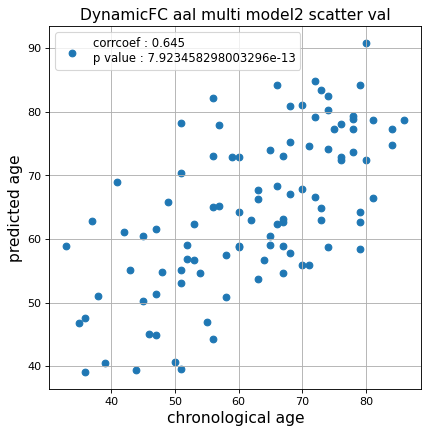

r^2 val data:  0.31261815446521746


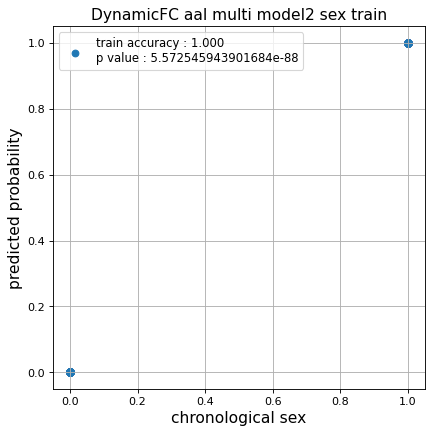

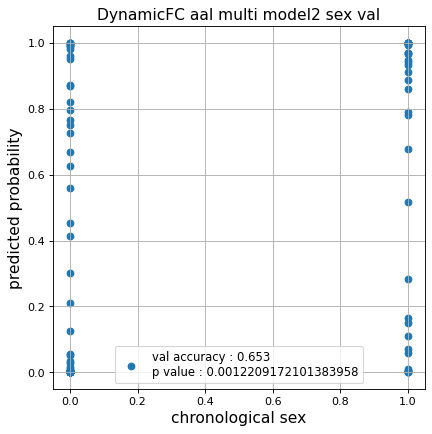

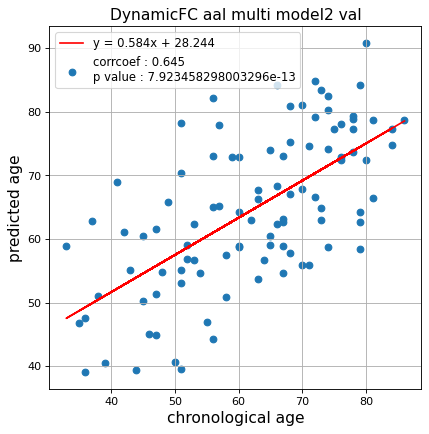

切片: 28.243510768809884
傾き: 0.5844462661906719
Kfold: 5 ::: epoch: 100, loss: 0.039324178432042785, val loss: 0.5639384910464287
Kfold: 5 ::: epoch: 200, loss: 0.016009903871096097, val loss: 0.5278443060815334
Kfold: 5 ::: epoch: 300, loss: 0.013882044093826642, val loss: 0.5453980788588524
Kfold: 5 ::: epoch: 400, loss: 0.012330056383059574, val loss: 0.5609253942966461
early stopping
save_epochs:279
best val loss:0.5063754711300135


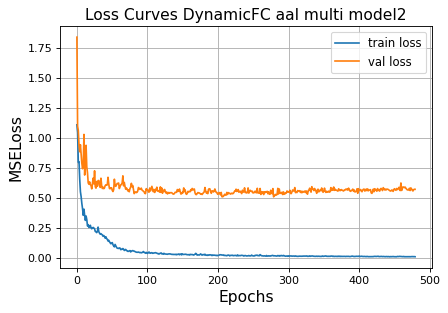

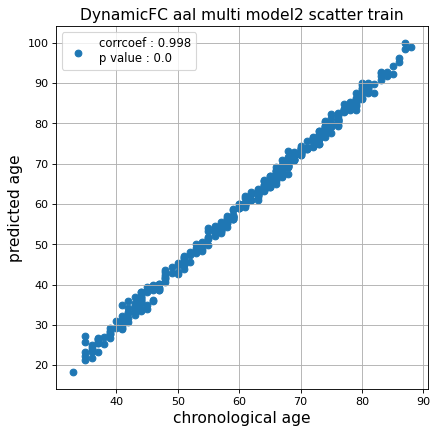

r^2 train data:  0.8076168617277288


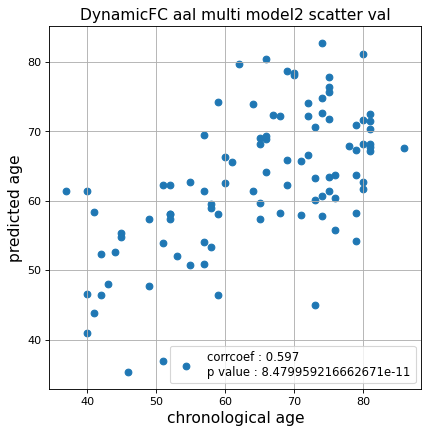

r^2 val data:  0.30251171466583693


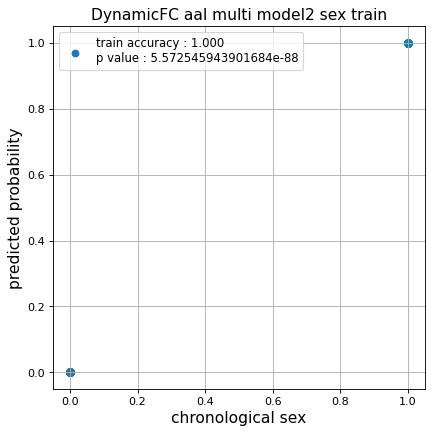

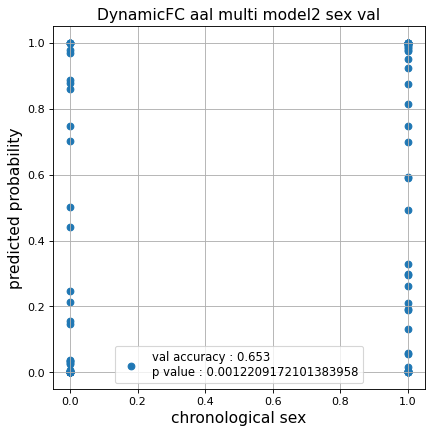

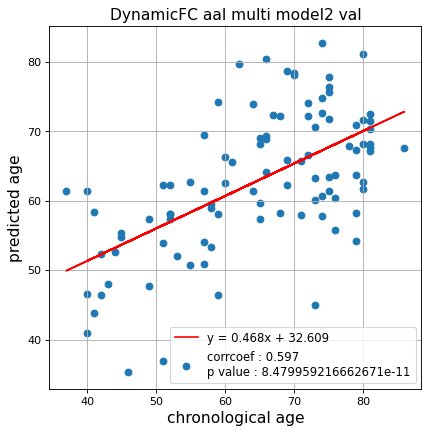

切片: 32.609455939635716
傾き: 0.4680507497337185
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.03946167001357445, val loss: 0.7573523223400116
Kfold: 1 ::: epoch: 200, loss: 0.021850319292682868, val loss: 0.7529521137475967
Kfold: 1 ::: epoch: 300, loss: 0.016718331581124894, val loss: 0.7928353548049927
Kfold: 1 ::: epoch: 400, loss: 0.008895803350382127, val loss: 0.8240583688020706
early stopping
save_epochs:207
best val loss:0.7259574383497238


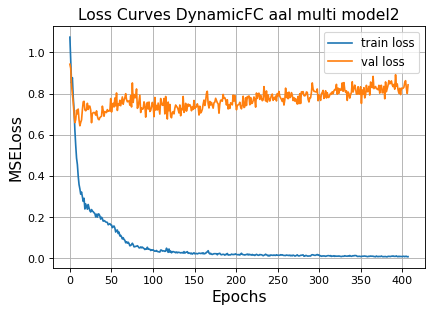

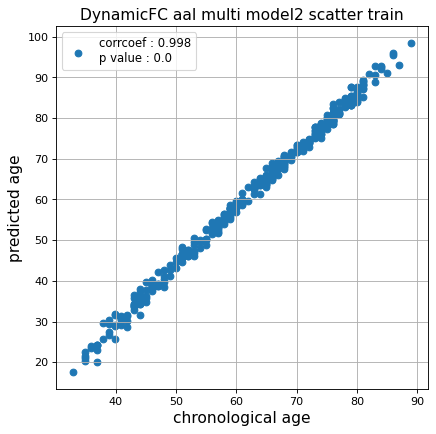

r^2 train data:  0.8133867802527199


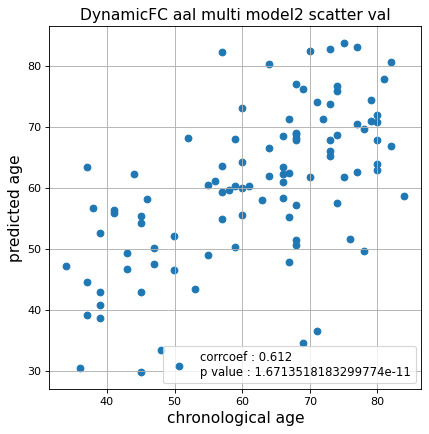

r^2 val data:  0.27439898387220174


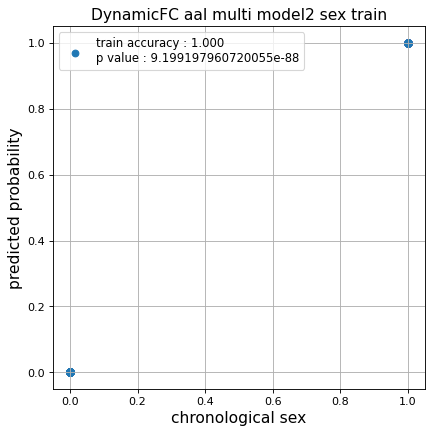

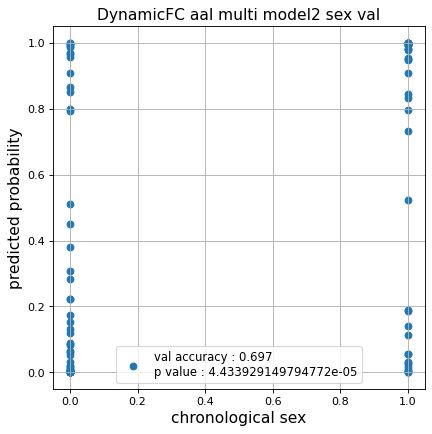

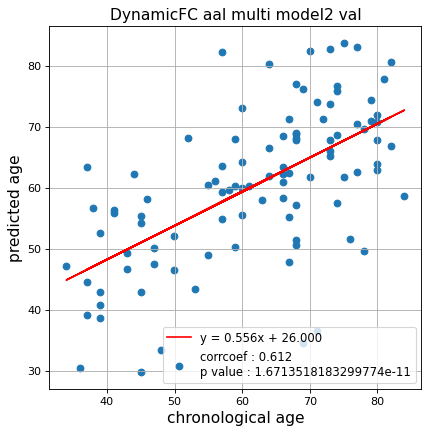

切片: 26.000056036971543
傾き: 0.5559340664338988
Kfold: 2 ::: epoch: 100, loss: 0.03799408516631676, val loss: 0.5874341875314713
Kfold: 2 ::: epoch: 200, loss: 0.016087693054802142, val loss: 0.5967113971710205
Kfold: 2 ::: epoch: 300, loss: 0.009998846584214615, val loss: 0.5840654373168945
Kfold: 2 ::: epoch: 400, loss: 0.00822367171685283, val loss: 0.6214063689112663
early stopping
save_epochs:246
best val loss:0.5755187831819057


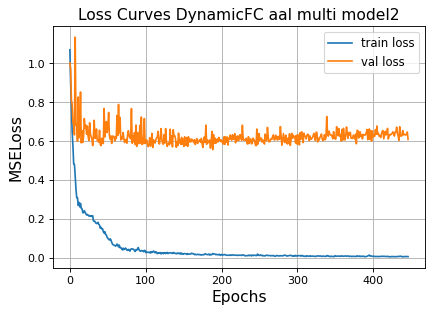

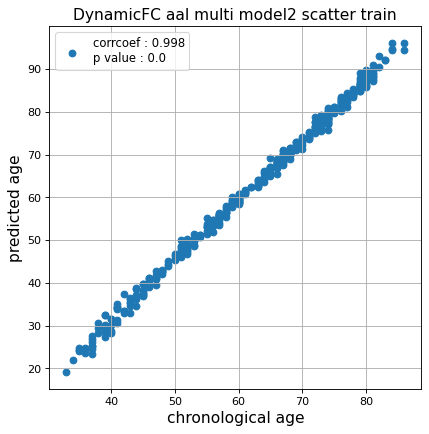

r^2 train data:  0.8262044370488185


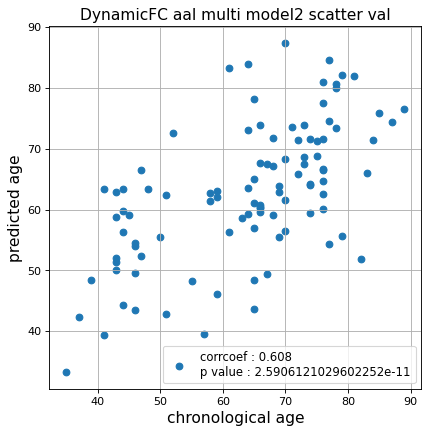

r^2 val data:  0.30776902058388256


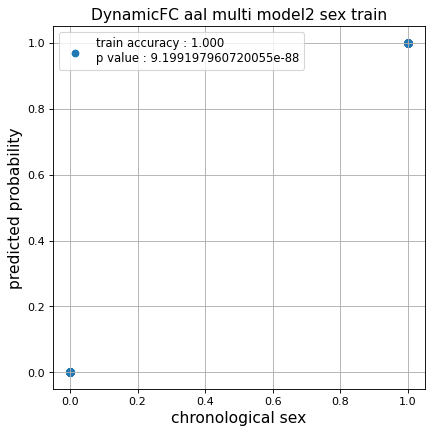

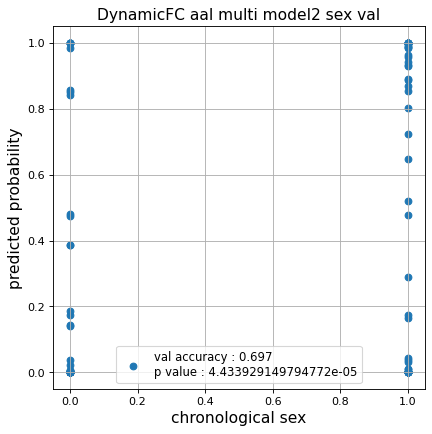

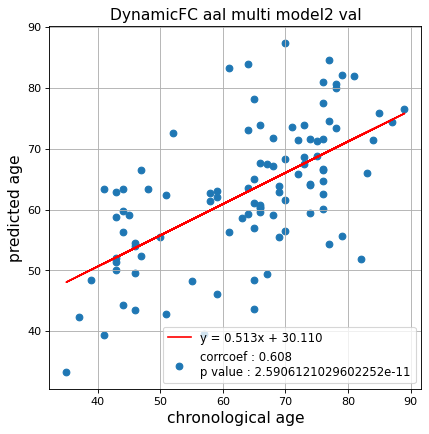

切片: 30.110117734773247
傾き: 0.5131308890853478
Kfold: 3 ::: epoch: 100, loss: 0.0408701803535223, val loss: 0.5195194631814957
Kfold: 3 ::: epoch: 200, loss: 0.0168977312457103, val loss: 0.4986587241292
Kfold: 3 ::: epoch: 300, loss: 0.011165996834349174, val loss: 0.502171203494072
Kfold: 3 ::: epoch: 400, loss: 0.008082165669363279, val loss: 0.5022827945649624
early stopping
save_epochs:229
best val loss:0.46434097550809383


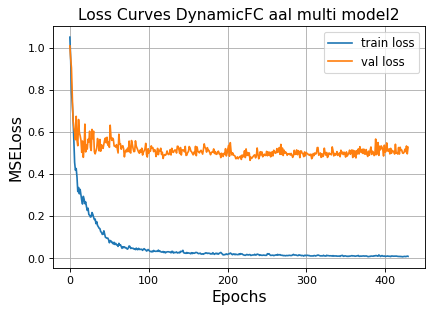

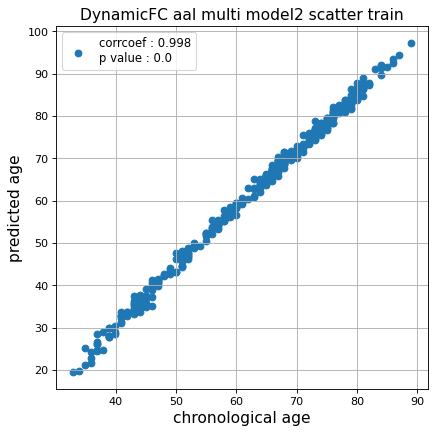

r^2 train data:  0.8502574678189483


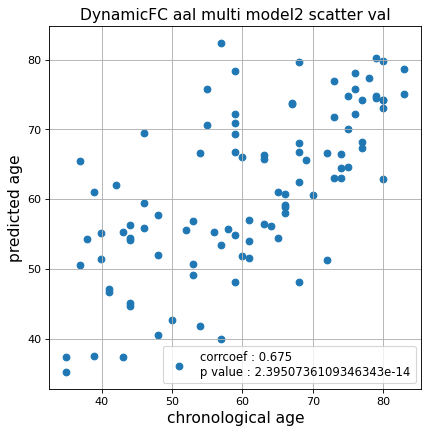

r^2 val data:  0.4224646672001465


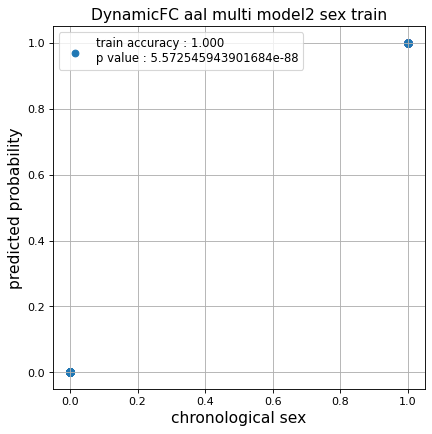

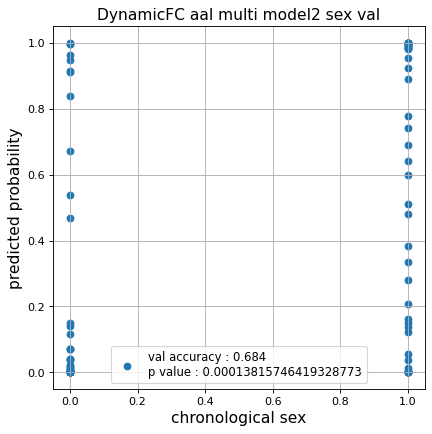

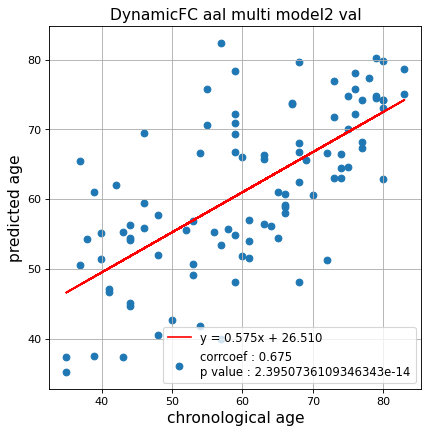

切片: 26.50972037970711
傾き: 0.5746519061466855
Kfold: 4 ::: epoch: 100, loss: 0.03616640200981727, val loss: 1.1305942982435226
Kfold: 4 ::: epoch: 200, loss: 0.0161035000704802, val loss: 1.077875092625618
Kfold: 4 ::: epoch: 300, loss: 0.015566813831145946, val loss: 1.046007975935936
Kfold: 4 ::: epoch: 400, loss: 0.010891879443079233, val loss: 1.104292243719101
Kfold: 4 ::: epoch: 500, loss: 0.008641519977782782, val loss: 1.0326205343008041
Kfold: 4 ::: epoch: 600, loss: 0.006836698856204748, val loss: 0.9647901207208633
Kfold: 4 ::: epoch: 700, loss: 0.00690551890203586, val loss: 0.8948500603437424
save_epochs:669
best val loss:0.893476665019989


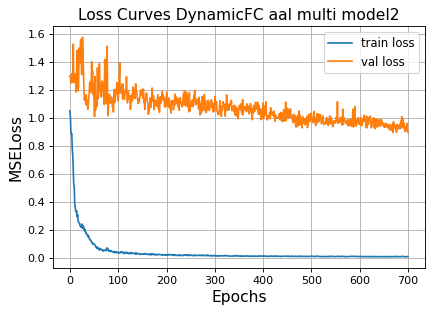

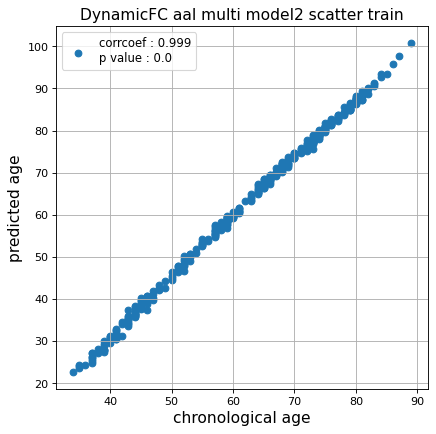

r^2 train data:  0.8243173224099168


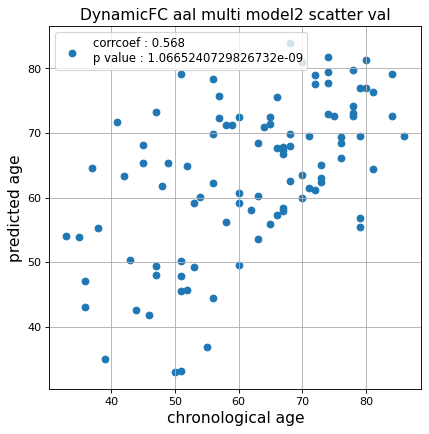

r^2 val data:  0.20443276833461443


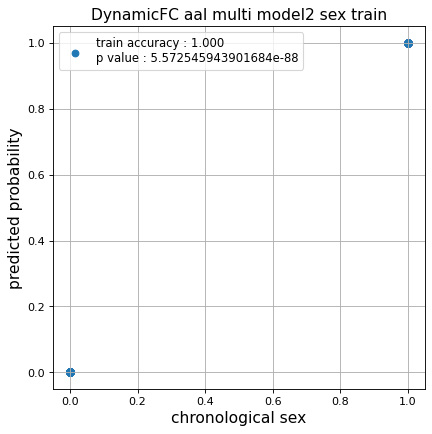

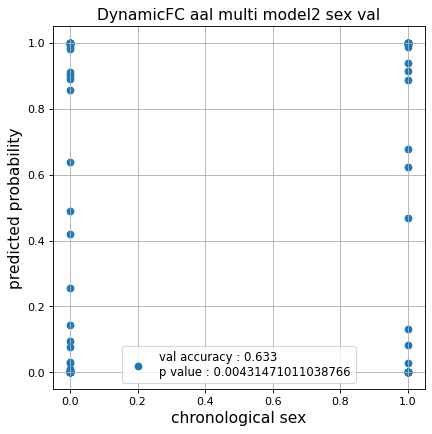

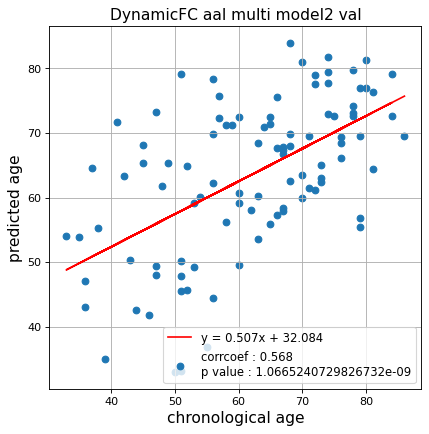

切片: 32.083873498406064
傾き: 0.5070079185180202
Kfold: 5 ::: epoch: 100, loss: 0.040526774926827505, val loss: 0.8502364456653595
Kfold: 5 ::: epoch: 200, loss: 0.01544476099885427, val loss: 0.8555872440338135
Kfold: 5 ::: epoch: 300, loss: 0.011817550895592341, val loss: 0.8293187320232391
Kfold: 5 ::: epoch: 400, loss: 0.01162133663176344, val loss: 0.8442151844501495
Kfold: 5 ::: epoch: 500, loss: 0.009121222851368098, val loss: 0.7876547947525978
early stopping
save_epochs:389
best val loss:0.7550668865442276


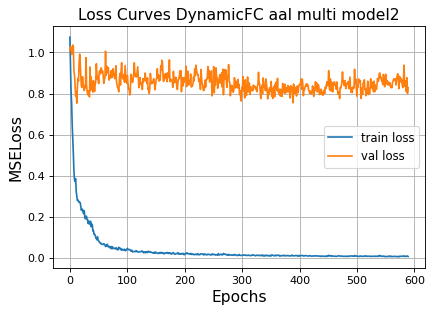

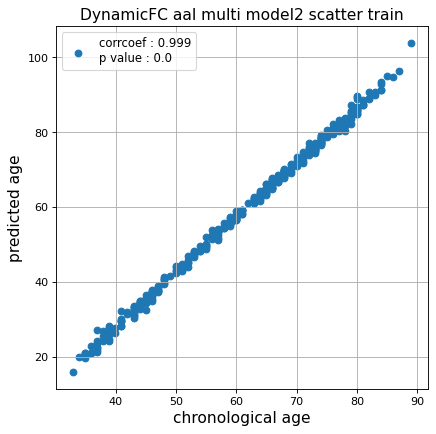

r^2 train data:  0.7662441793548163


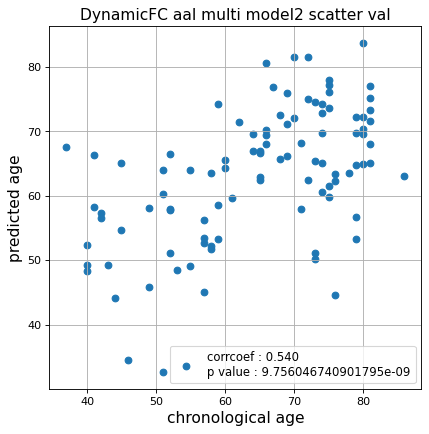

r^2 val data:  0.2101022572542368


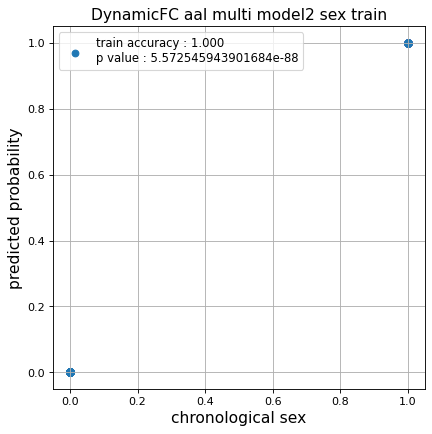

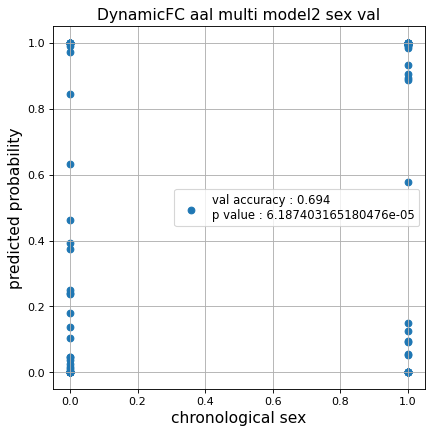

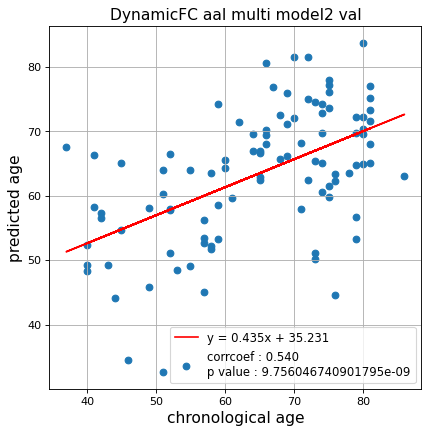

切片: 35.23064178752127
傾き: 0.43481899028828974
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.035402660902876124, val loss: 0.6894000768661499
Kfold: 1 ::: epoch: 200, loss: 0.01965070651987424, val loss: 0.7447205185890198
Kfold: 1 ::: epoch: 300, loss: 0.01494138390542223, val loss: 0.8376525640487671
Kfold: 1 ::: epoch: 400, loss: 0.010465118066909222, val loss: 0.8346039652824402
early stopping
save_epochs:207
best val loss:0.7064236104488373


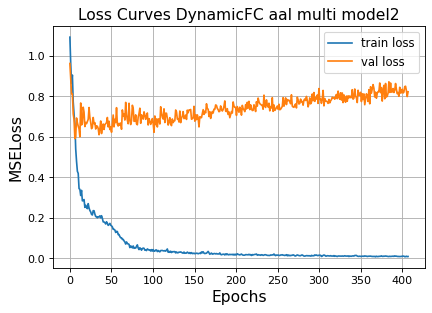

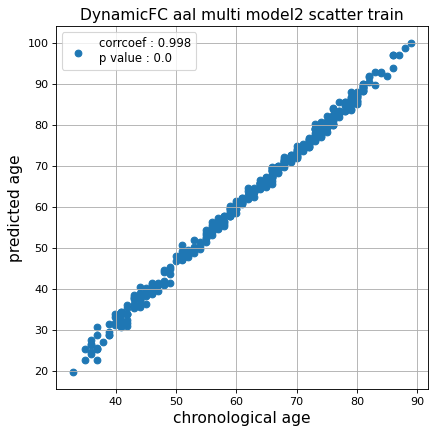

r^2 train data:  0.8411600834319866


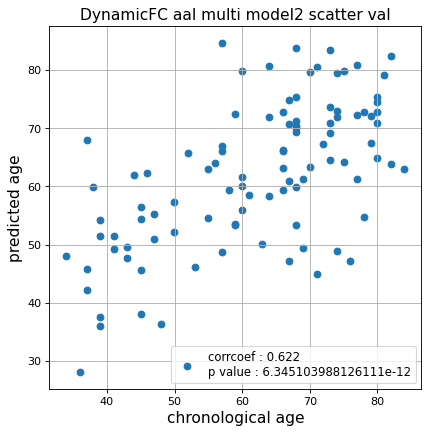

r^2 val data:  0.30880208413312105


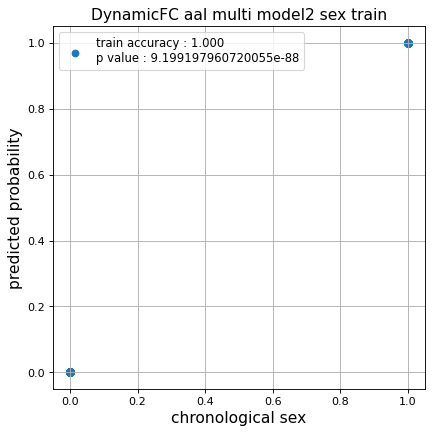

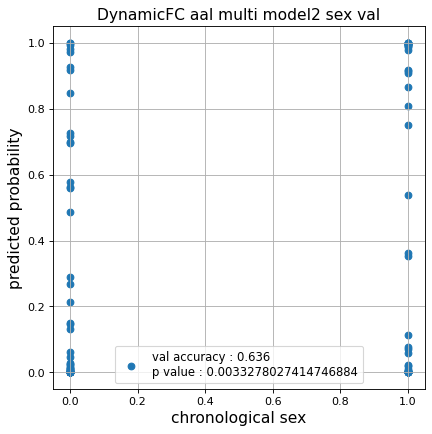

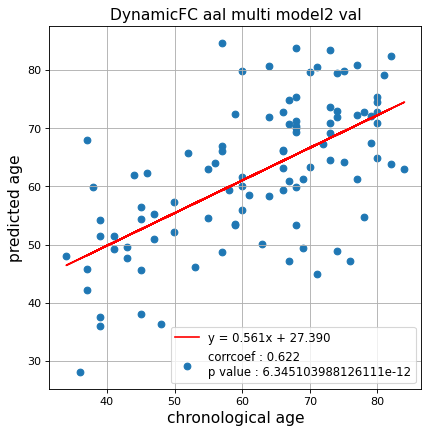

切片: 27.390343308694852
傾き: 0.5605976956410662
Kfold: 2 ::: epoch: 100, loss: 0.037877627433492586, val loss: 0.6231055893003941
Kfold: 2 ::: epoch: 200, loss: 0.01589637013295522, val loss: 0.6391937583684921
Kfold: 2 ::: epoch: 300, loss: 0.011078001644748908, val loss: 0.6808242872357368
Kfold: 2 ::: epoch: 400, loss: 0.008326510289827218, val loss: 0.726001039147377
early stopping
save_epochs:209
best val loss:0.6276712603867054


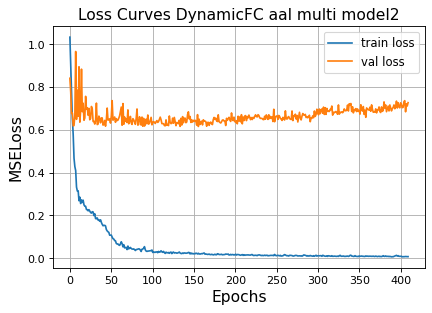

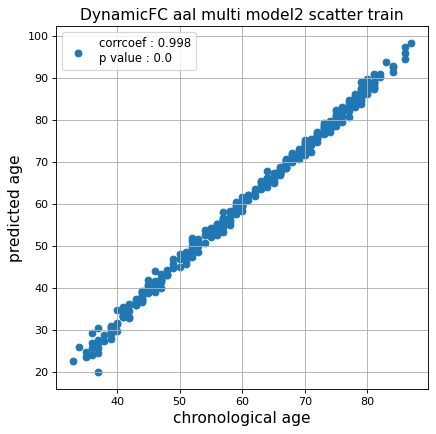

r^2 train data:  0.844510727915839


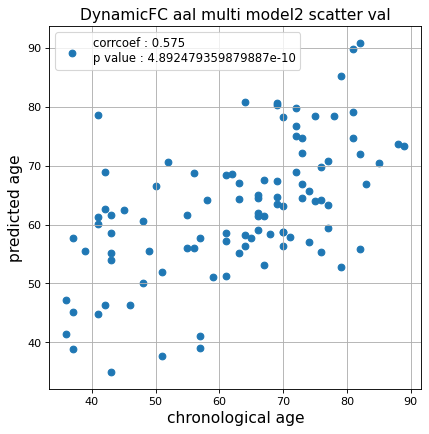

r^2 val data:  0.2773049348835819


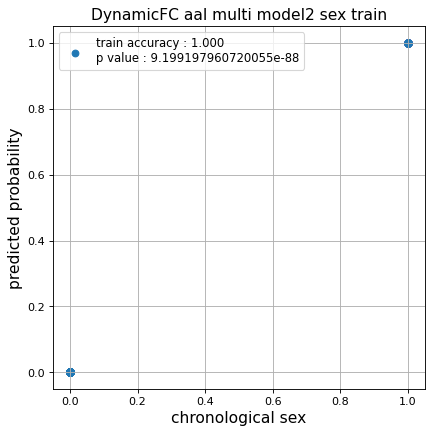

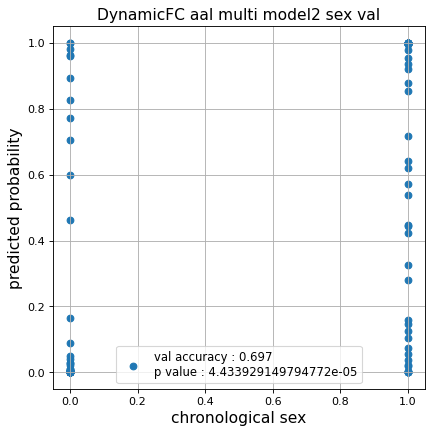

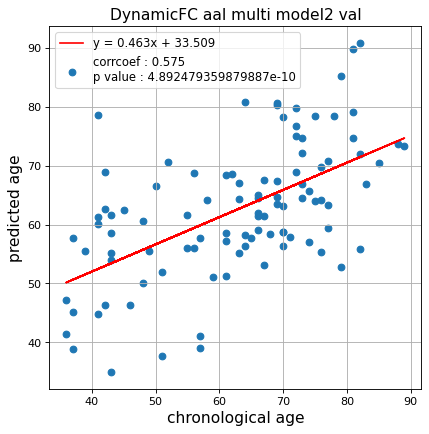

切片: 33.50853900704678
傾き: 0.46288257281380907
Kfold: 3 ::: epoch: 100, loss: 0.03957429599876587, val loss: 0.96981380879879
Kfold: 3 ::: epoch: 200, loss: 0.021460056448212035, val loss: 0.8283426314592361
Kfold: 3 ::: epoch: 300, loss: 0.015403372808717765, val loss: 0.7949270606040955
Kfold: 3 ::: epoch: 400, loss: 0.010037335746276837, val loss: 0.7267733514308929
Kfold: 3 ::: epoch: 500, loss: 0.008092565605273614, val loss: 0.6565027385950089
Kfold: 3 ::: epoch: 600, loss: 0.007918637747374864, val loss: 0.7254001200199127
Kfold: 3 ::: epoch: 700, loss: 0.007427268769018925, val loss: 0.6413735747337341
save_epochs:696
best val loss:0.6385728418827057


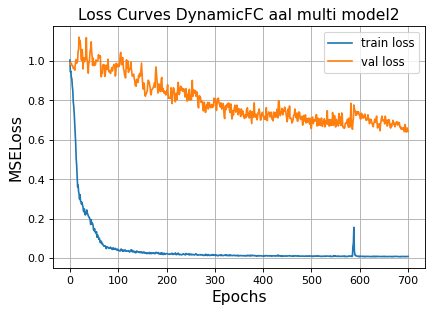

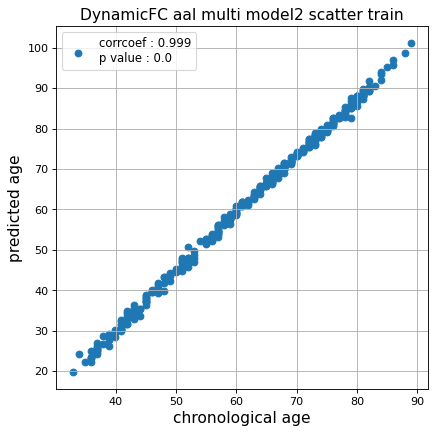

r^2 train data:  0.8111908358003063


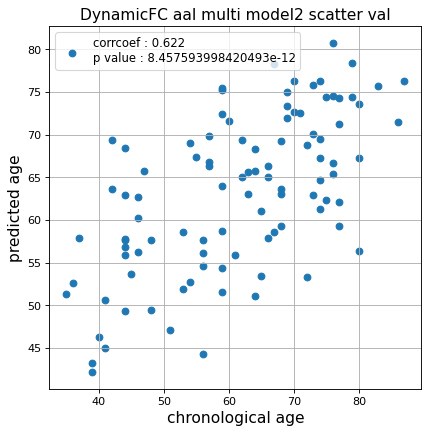

r^2 val data:  0.3618905298159608


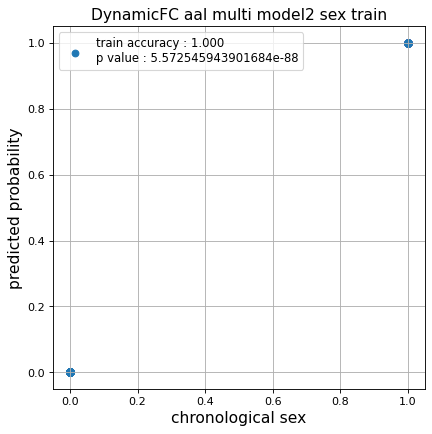

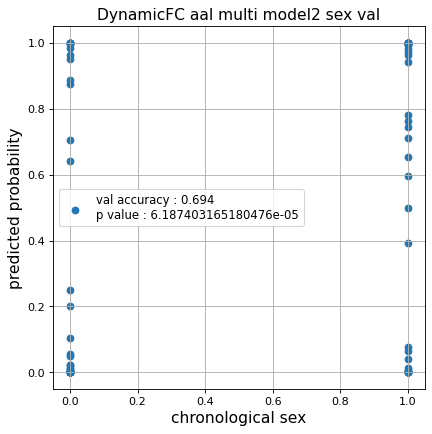

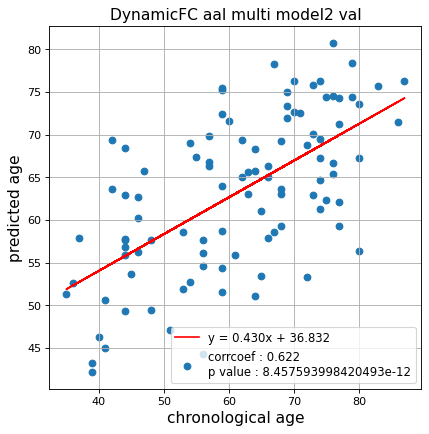

切片: 36.83230650558992
傾き: 0.4302471488540961
Kfold: 4 ::: epoch: 100, loss: 0.04115677538972635, val loss: 0.9838175177574158
Kfold: 4 ::: epoch: 200, loss: 0.02325350619279421, val loss: 1.0702455192804337
Kfold: 4 ::: epoch: 300, loss: 0.014129713106040772, val loss: 0.9599957913160324
Kfold: 4 ::: epoch: 400, loss: 0.010615984622675639, val loss: 1.0618057548999786
early stopping
save_epochs:236
best val loss:0.887884721159935


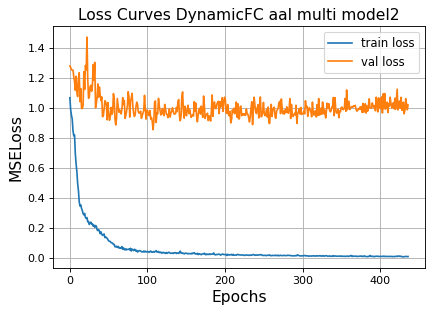

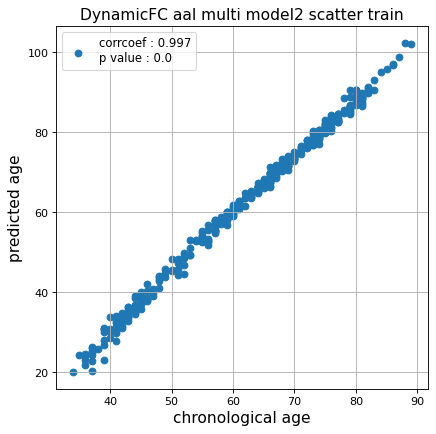

r^2 train data:  0.7886704318622363


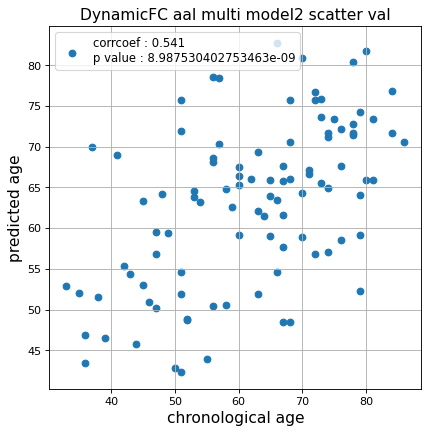

r^2 val data:  0.24371914868623923


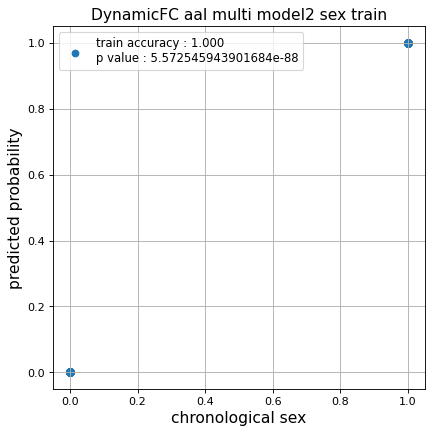

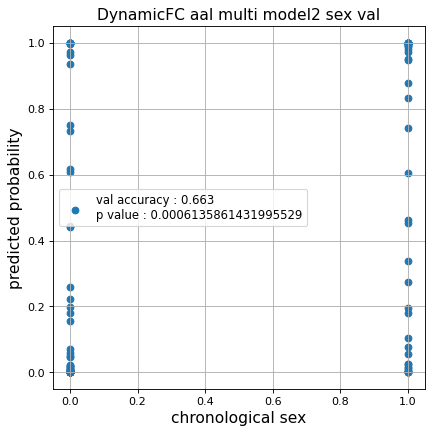

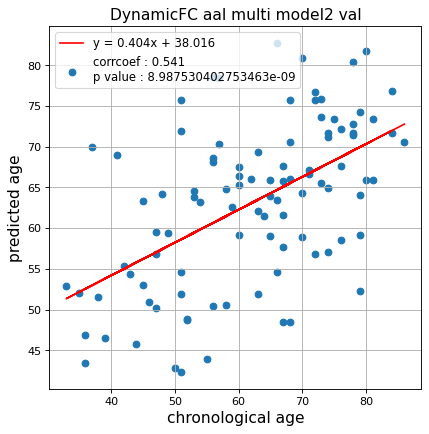

切片: 38.01640354121864
傾き: 0.40409792205781836
Kfold: 5 ::: epoch: 100, loss: 0.04843285966377992, val loss: 0.9919243305921555
Kfold: 5 ::: epoch: 200, loss: 0.019379522723074142, val loss: 0.9638835489749908
Kfold: 5 ::: epoch: 300, loss: 0.015440937955505572, val loss: 0.9330767244100571
Kfold: 5 ::: epoch: 400, loss: 0.01384004090841, val loss: 0.827685758471489
Kfold: 5 ::: epoch: 500, loss: 0.011630598348207198, val loss: 0.7487389296293259
Kfold: 5 ::: epoch: 600, loss: 0.009228756722922508, val loss: 0.7432407438755035
Kfold: 5 ::: epoch: 700, loss: 0.008695707907183813, val loss: 0.7158832252025604
save_epochs:685
best val loss:0.6765316128730774


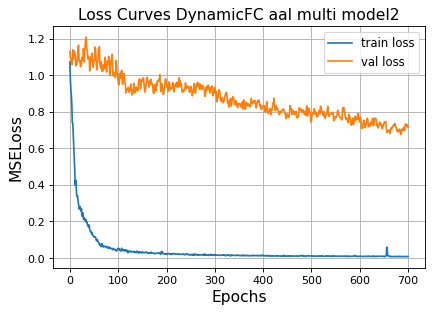

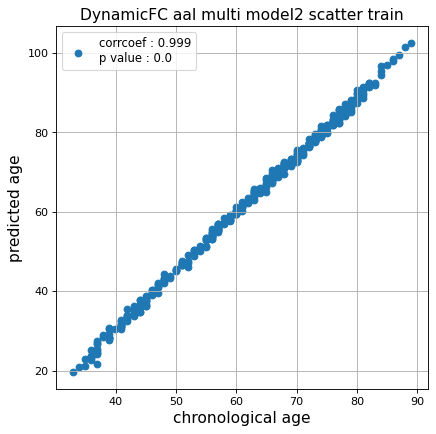

r^2 train data:  0.7848087508933994


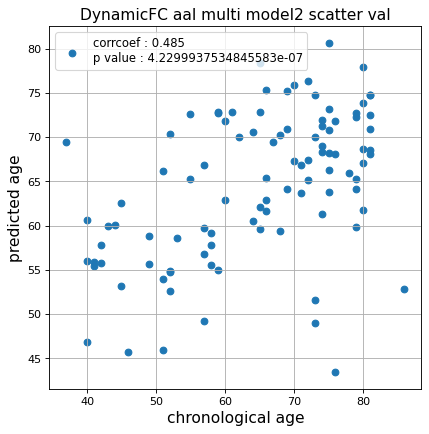

r^2 val data:  0.20862125953480082


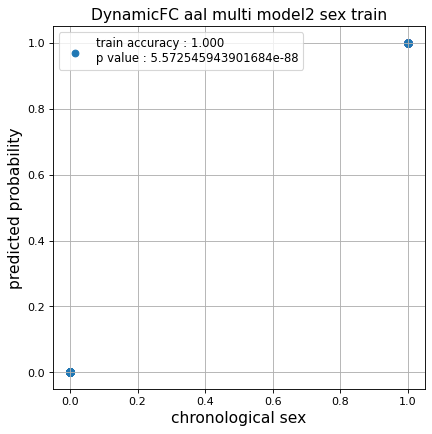

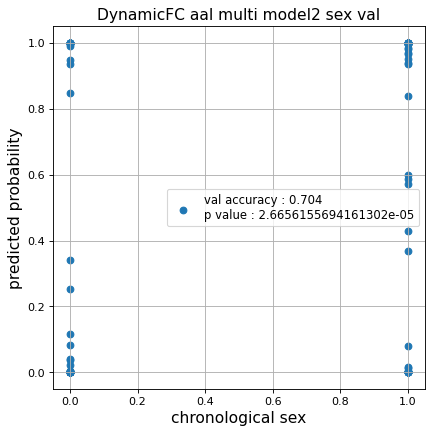

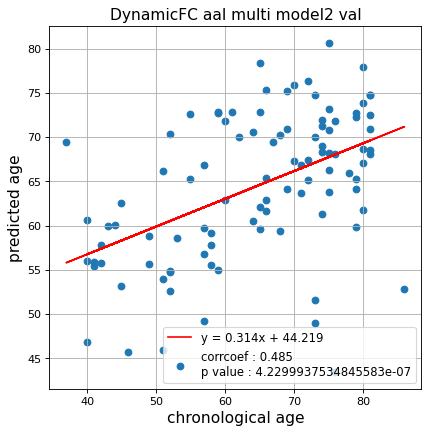

切片: 44.21921425281206
傾き: 0.31351607603196274
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.03702543174418119, val loss: 0.7372184991836548
Kfold: 1 ::: epoch: 200, loss: 0.020405476912856102, val loss: 0.7377840876579285
Kfold: 1 ::: epoch: 300, loss: 0.015060469508171082, val loss: 0.7522872313857079
Kfold: 1 ::: epoch: 400, loss: 0.01128503243223979, val loss: 0.7971056178212166
early stopping
save_epochs:218
best val loss:0.6832167357206345


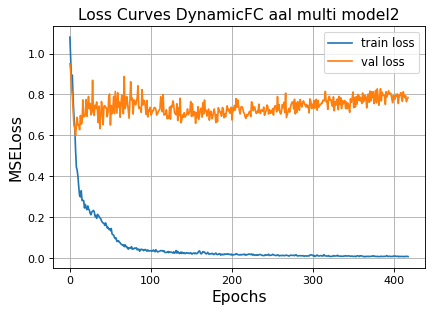

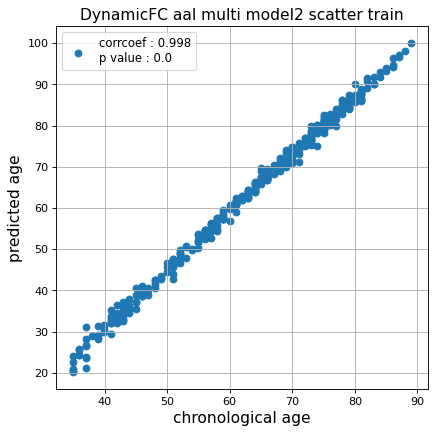

r^2 train data:  0.8227662488610546


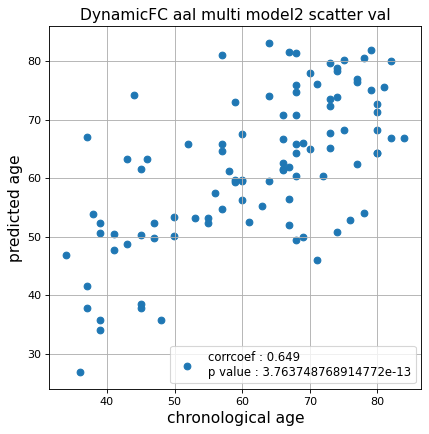

r^2 val data:  0.3489382833586526


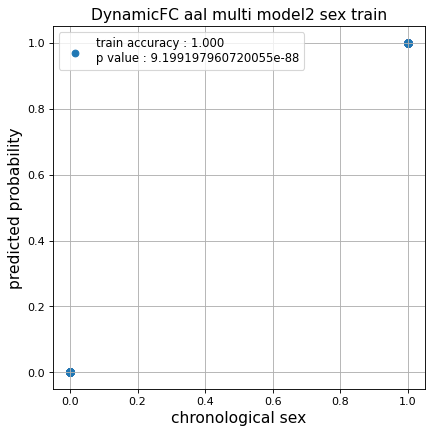

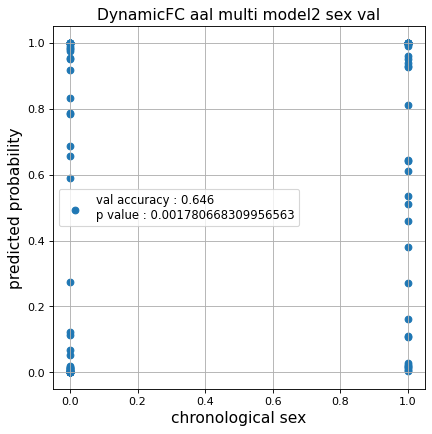

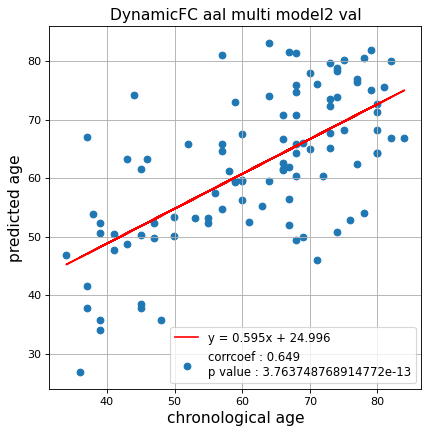

切片: 24.99562741628977
傾き: 0.5953582862417407
Kfold: 2 ::: epoch: 100, loss: 0.03520311071322514, val loss: 0.664419624954462
Kfold: 2 ::: epoch: 200, loss: 0.015736496075987816, val loss: 0.6639516055583954
Kfold: 2 ::: epoch: 300, loss: 0.010603707641936265, val loss: 0.6973952203989029
Kfold: 2 ::: epoch: 400, loss: 0.0066333411870381, val loss: 0.7485477924346924
early stopping
save_epochs:206
best val loss:0.6532847285270691


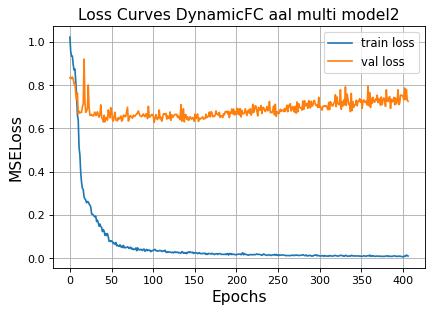

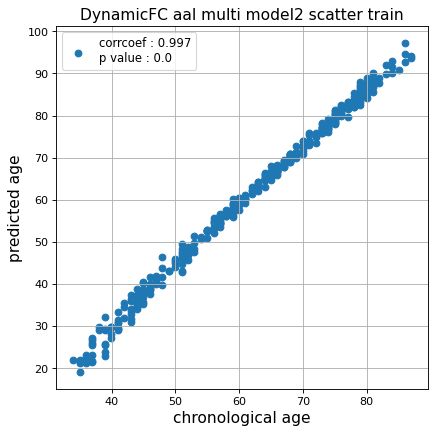

r^2 train data:  0.8199381009002072


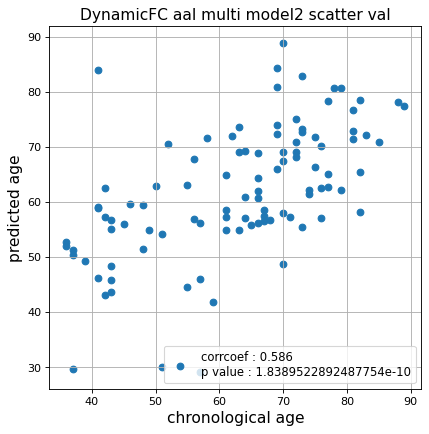

r^2 val data:  0.2782682477721886


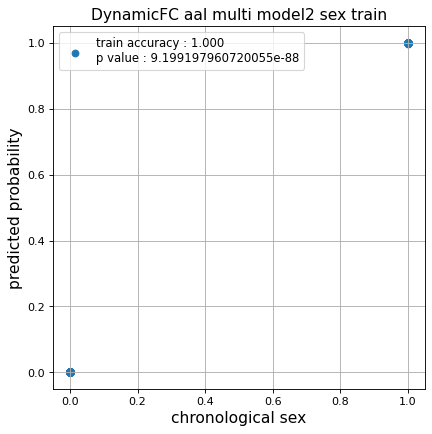

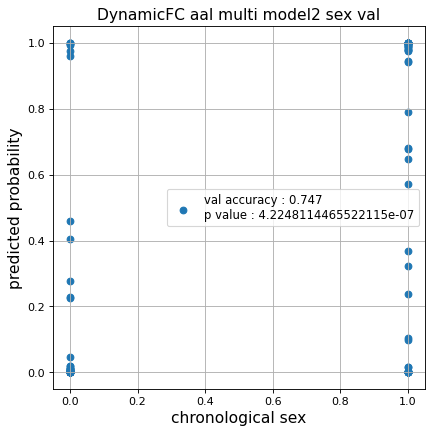

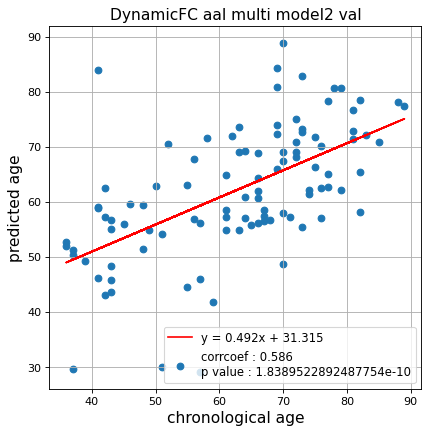

切片: 31.31511970216754
傾き: 0.4918447090373803
Kfold: 3 ::: epoch: 100, loss: 0.03533512425537293, val loss: 0.5938275307416916
Kfold: 3 ::: epoch: 200, loss: 0.019531705631659582, val loss: 0.6408863514661789
Kfold: 3 ::: epoch: 300, loss: 0.009926321665541483, val loss: 0.6379179805517197
Kfold: 3 ::: epoch: 400, loss: 0.009011475870815607, val loss: 0.6966097578406334
early stopping
save_epochs:204
best val loss:0.5917031913995743


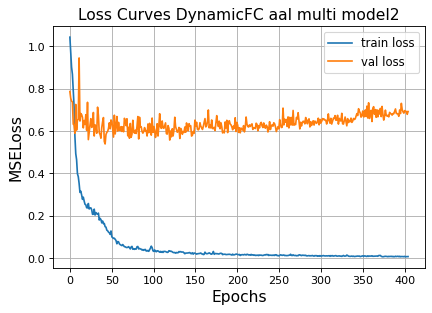

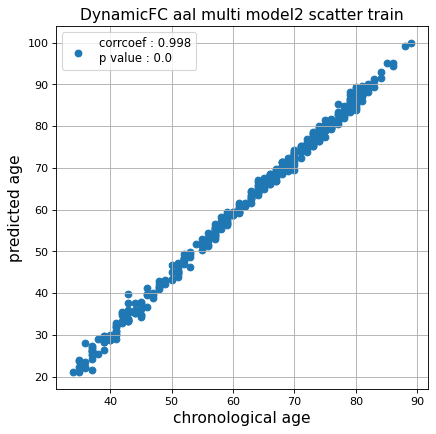

r^2 train data:  0.82176649647547


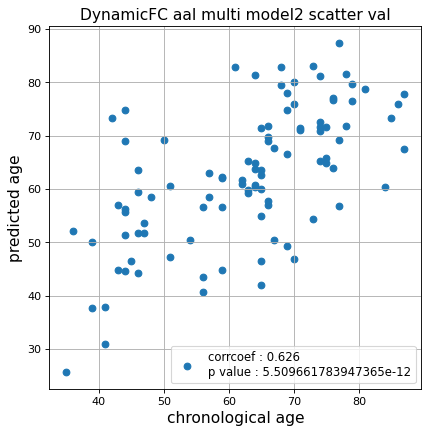

r^2 val data:  0.27285567605634553


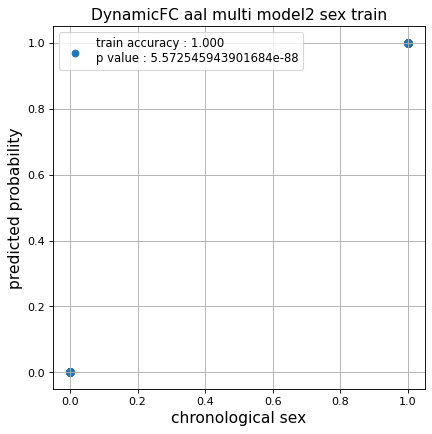

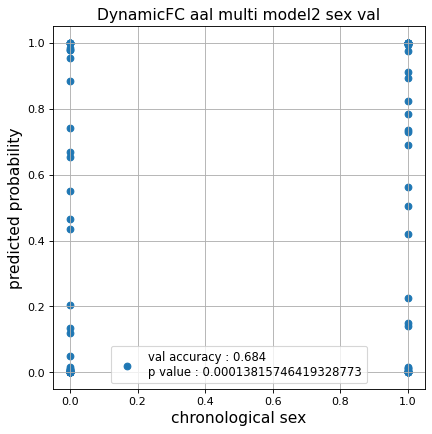

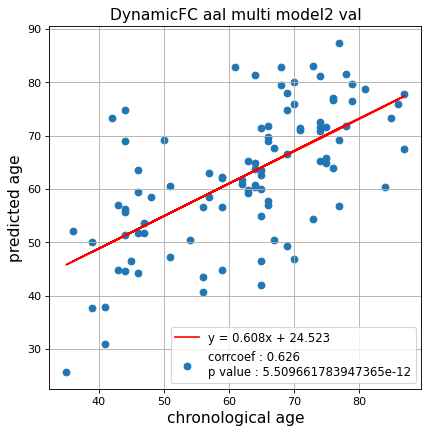

切片: 24.523183601101074
傾き: 0.607648214013012
Kfold: 4 ::: epoch: 100, loss: 0.033407142385840416, val loss: 1.0799077600240707
Kfold: 4 ::: epoch: 200, loss: 0.019251403900293205, val loss: 1.0597105622291565
Kfold: 4 ::: epoch: 300, loss: 0.013297125052374143, val loss: 0.9948689192533493
Kfold: 4 ::: epoch: 400, loss: 0.008959326212509321, val loss: 1.0218792110681534
Kfold: 4 ::: epoch: 500, loss: 0.007456839801027224, val loss: 0.9715841710567474
Kfold: 4 ::: epoch: 600, loss: 0.008314394857734442, val loss: 1.0194681286811829
Kfold: 4 ::: epoch: 700, loss: 0.006700239108445553, val loss: 0.9442849904298782
save_epochs:659
best val loss:0.8991793990135193


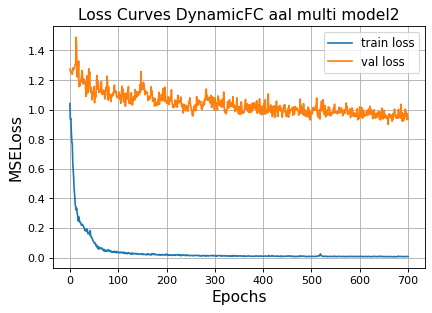

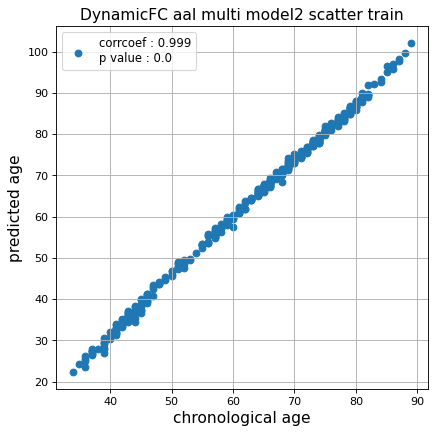

r^2 train data:  0.8329449734865267


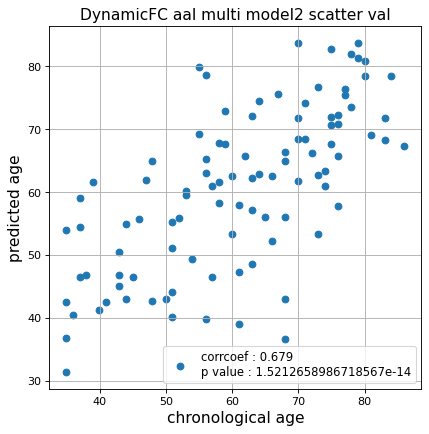

r^2 val data:  0.4043526826095125


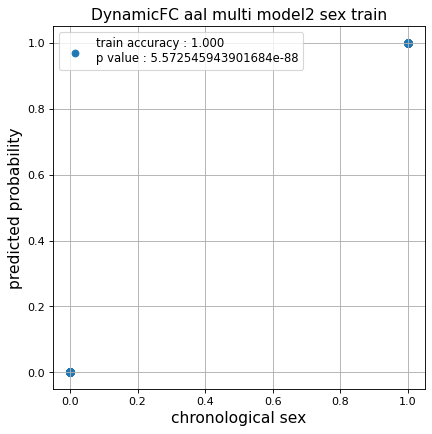

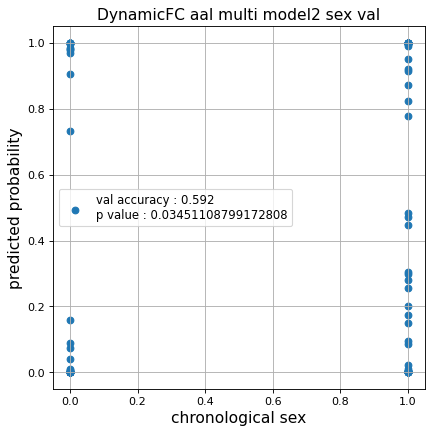

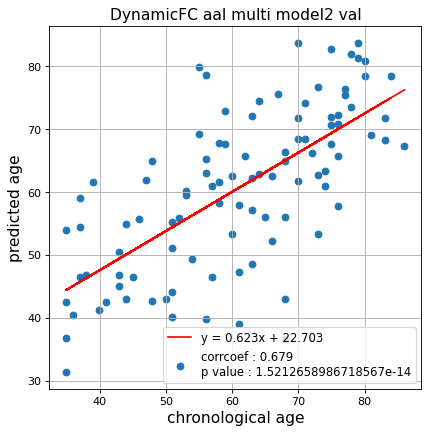

切片: 22.702592395559137
傾き: 0.6225784637511655
Kfold: 5 ::: epoch: 100, loss: 0.04267877555237366, val loss: 0.6912857294082642
Kfold: 5 ::: epoch: 200, loss: 0.02317739464342594, val loss: 0.6278103962540627
Kfold: 5 ::: epoch: 300, loss: 0.01066765425583491, val loss: 0.6345469728112221
Kfold: 5 ::: epoch: 400, loss: 0.00906342824992652, val loss: 0.6505593620240688
Kfold: 5 ::: epoch: 500, loss: 0.00646757585211442, val loss: 0.6471491251140833
Kfold: 5 ::: epoch: 600, loss: 0.006082509662239597, val loss: 0.5988056398928165
Kfold: 5 ::: epoch: 700, loss: 0.006138197450826948, val loss: 0.6367482710629702
save_epochs:642
best val loss:0.5542831933125854


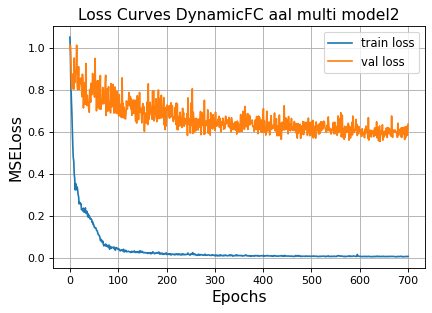

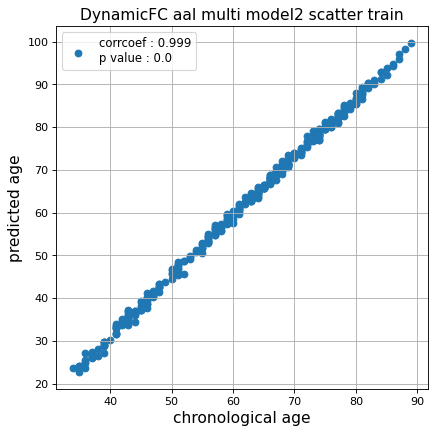

r^2 train data:  0.8430993199754727


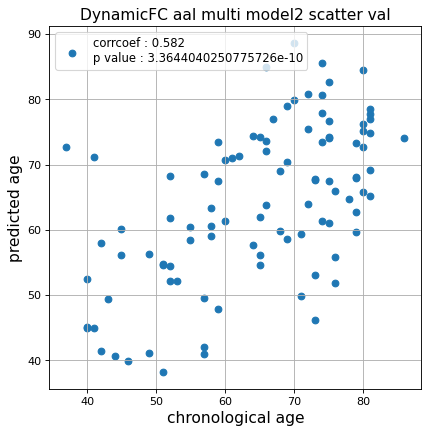

r^2 val data:  0.2049732203468113


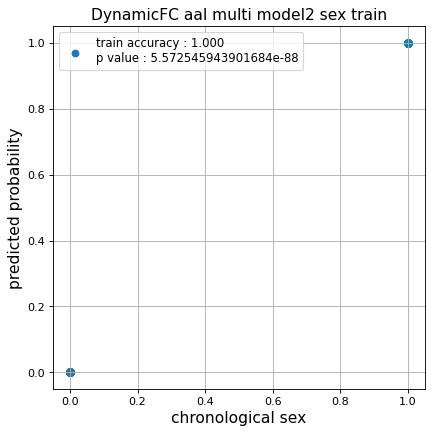

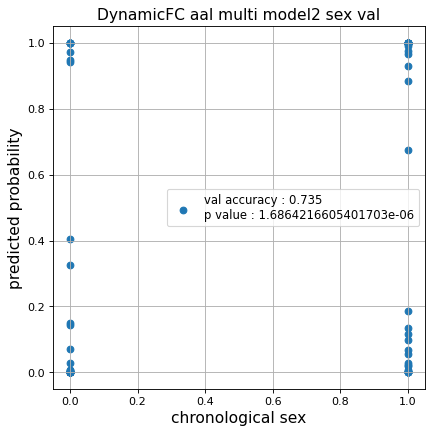

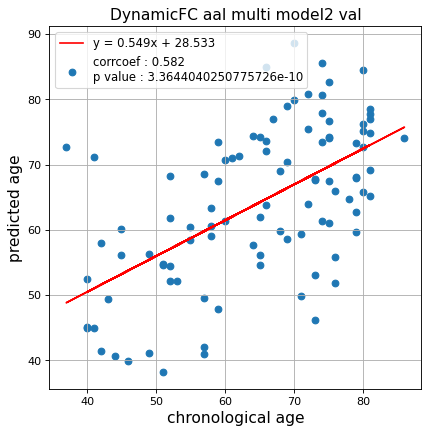

切片: 28.533492984266694
傾き: 0.5487949497975583
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03548011427315382, val loss: 0.8172354698181152
Kfold: 1 ::: epoch: 200, loss: 0.01817615208430932, val loss: 0.7935368567705154
Kfold: 1 ::: epoch: 300, loss: 0.014074343686493544, val loss: 0.80327008664608
Kfold: 1 ::: epoch: 400, loss: 0.008516708675485391, val loss: 0.8594578206539154
early stopping
save_epochs:216
best val loss:0.7368754148483276


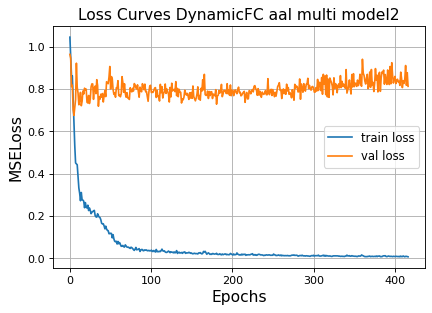

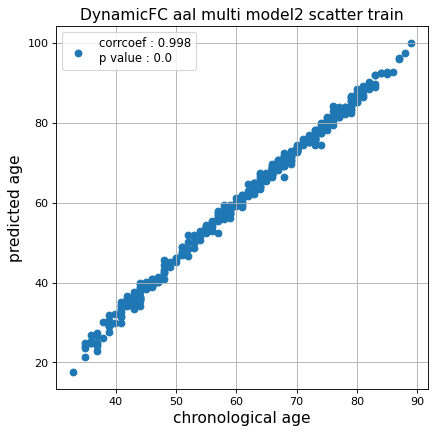

r^2 train data:  0.8461115276801645


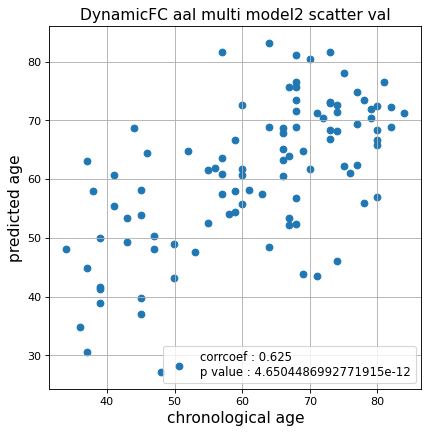

r^2 val data:  0.31870631479514


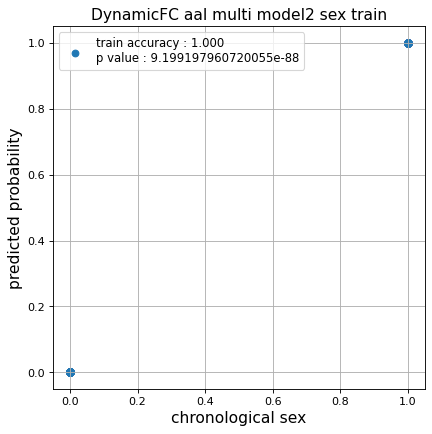

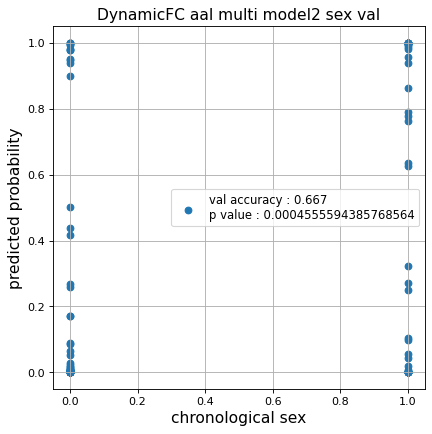

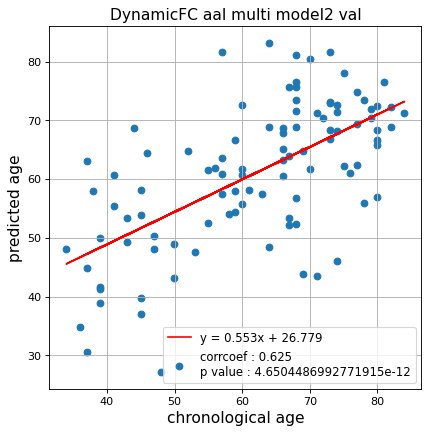

切片: 26.779007926291996
傾き: 0.5525327493662279
Kfold: 2 ::: epoch: 100, loss: 0.04031540739994783, val loss: 0.8508153706789017
Kfold: 2 ::: epoch: 200, loss: 0.013319426610206183, val loss: 0.8567372411489487
Kfold: 2 ::: epoch: 300, loss: 0.013078730768309189, val loss: 0.8992041200399399
Kfold: 2 ::: epoch: 400, loss: 0.008118639449374033, val loss: 0.9866624772548676
early stopping
save_epochs:239
best val loss:0.8380169123411179


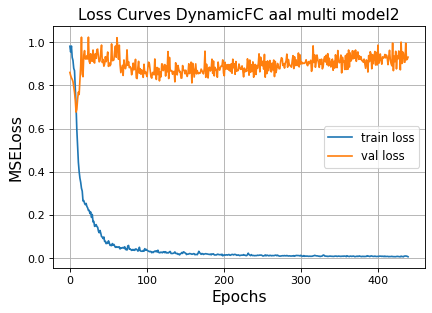

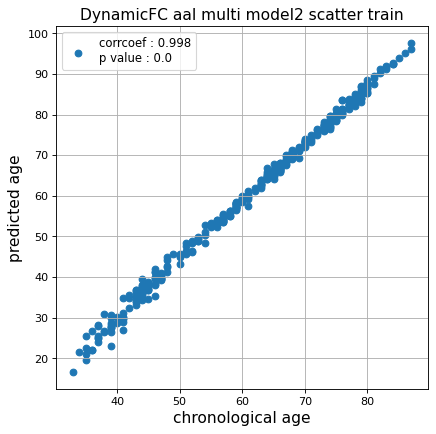

r^2 train data:  0.8202032189197971


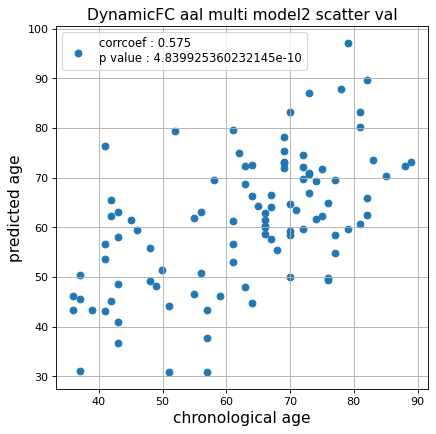

r^2 val data:  0.17886888325849826


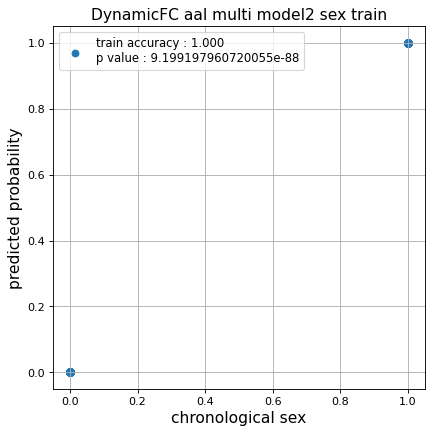

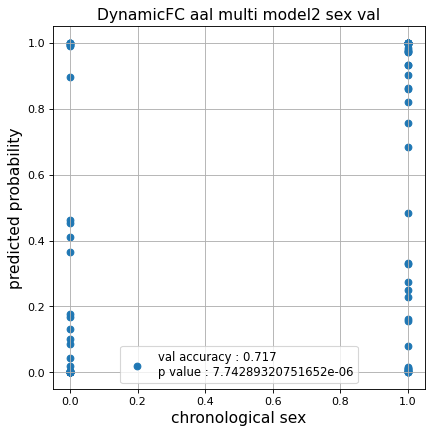

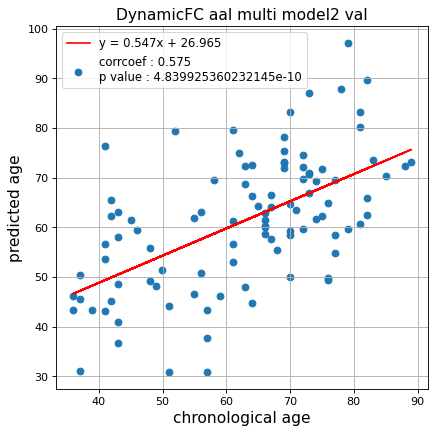

切片: 26.964777461181647
傾き: 0.5470454752413341
Kfold: 3 ::: epoch: 100, loss: 0.04781472826233277, val loss: 0.6186273284256458
Kfold: 3 ::: epoch: 200, loss: 0.02080433998400202, val loss: 0.5548078417778015
Kfold: 3 ::: epoch: 300, loss: 0.013687326465375148, val loss: 0.5459837131202221
Kfold: 3 ::: epoch: 400, loss: 0.0072664131696980735, val loss: 0.5752806961536407
early stopping
save_epochs:269
best val loss:0.5416309535503387


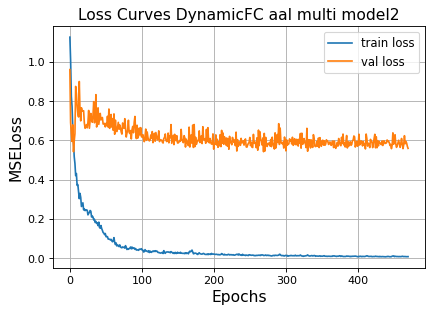

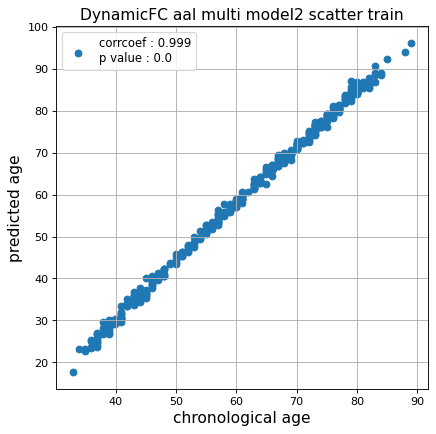

r^2 train data:  0.8485957664289411


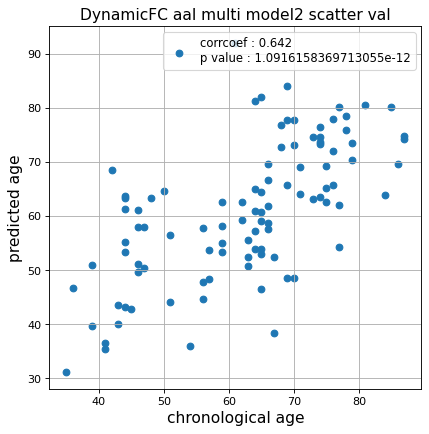

r^2 val data:  0.29824655799623523


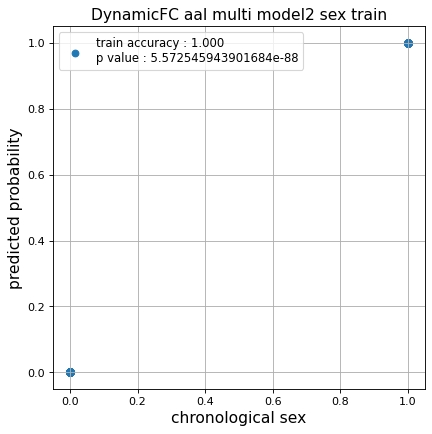

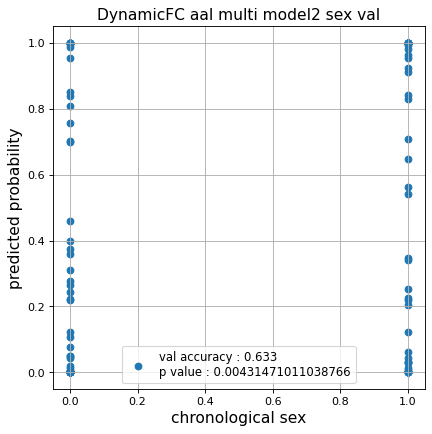

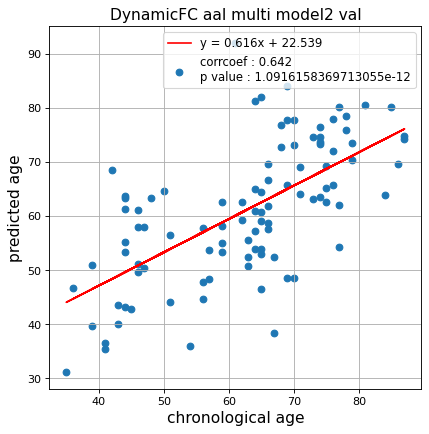

切片: 22.538957811743572
傾き: 0.6157941058810202
Kfold: 4 ::: epoch: 100, loss: 0.03869345340018089, val loss: 0.6453338265419006
Kfold: 4 ::: epoch: 200, loss: 0.02203161520167039, val loss: 0.568539172410965
Kfold: 4 ::: epoch: 300, loss: 0.010018455187002053, val loss: 0.6283489614725113
Kfold: 4 ::: epoch: 400, loss: 0.00791302377071518, val loss: 0.7025525867938995
early stopping
save_epochs:204
best val loss:0.5436229407787323


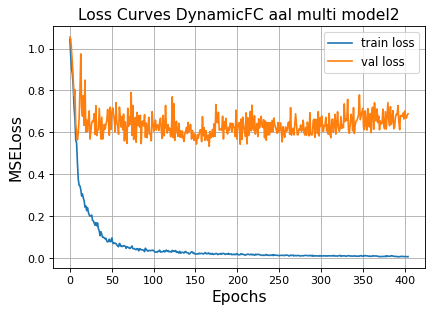

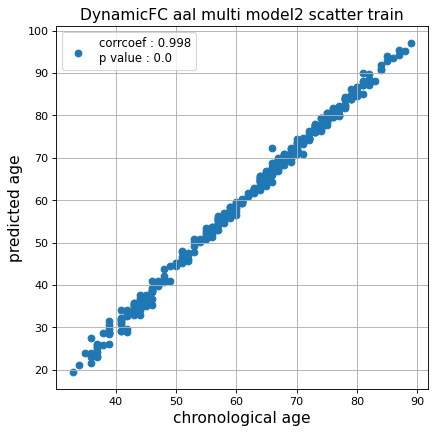

r^2 train data:  0.8311014027433298


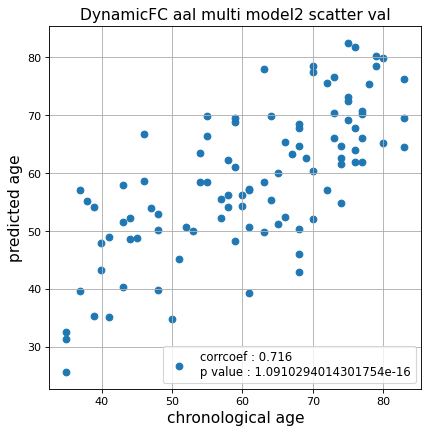

r^2 val data:  0.4481763897617248


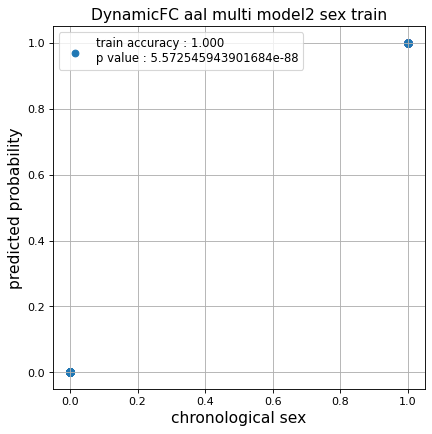

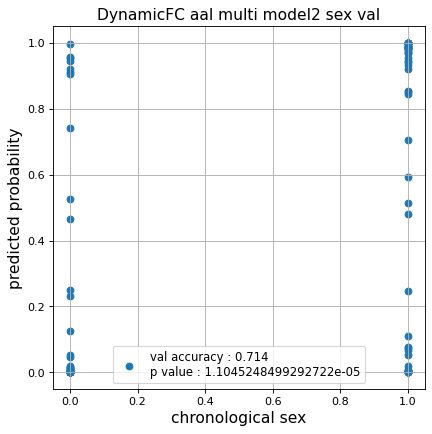

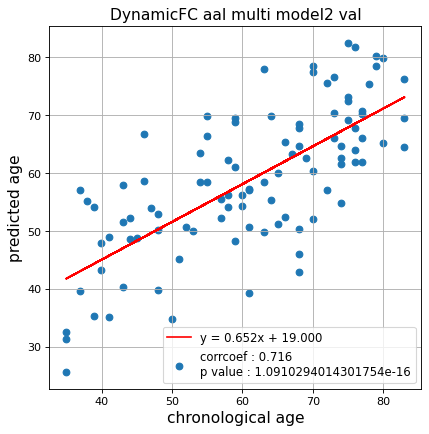

切片: 19.000026130280332
傾き: 0.6522163785404038
Kfold: 5 ::: epoch: 100, loss: 0.04188873117359785, val loss: 1.182540386915207
Kfold: 5 ::: epoch: 200, loss: 0.020217281479675036, val loss: 1.0268591195344925
Kfold: 5 ::: epoch: 300, loss: 0.014097741805016994, val loss: 1.0403452962636948
Kfold: 5 ::: epoch: 400, loss: 0.00825746667284805, val loss: 1.104462444782257
early stopping
save_epochs:277
best val loss:0.9753257930278778


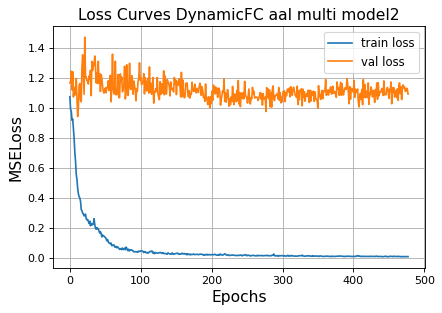

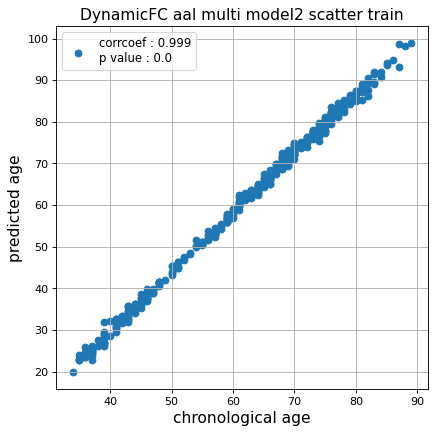

r^2 train data:  0.8115695975175996


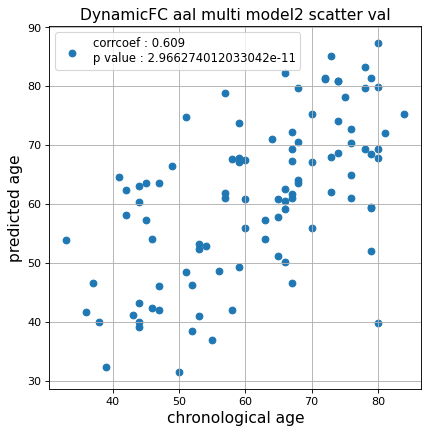

r^2 val data:  0.20338818311411144


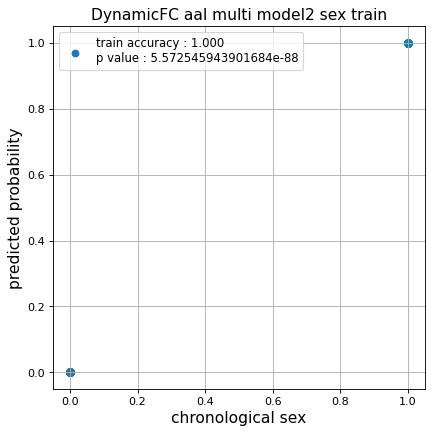

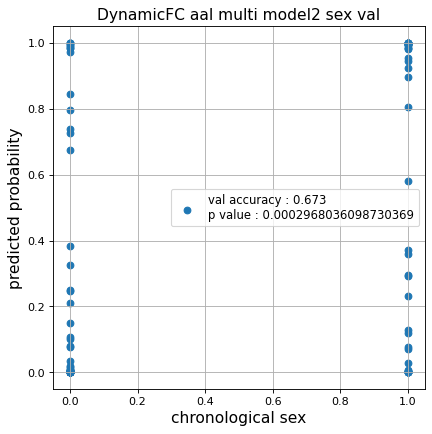

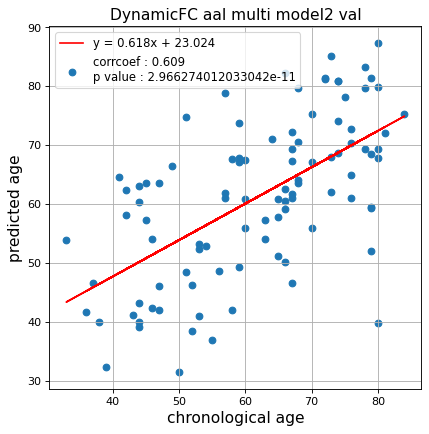

切片: 23.024258944763105
傾き: 0.6175558928450018
CPU times: user 21h 13min 24s, sys: 1min 25s, total: 21h 14min 50s
Wall time: 3h 1min 45s


In [22]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_dynamic_2  = []
test_pred_aal_dynamic_corrected_2  = []
test_label_aal_dynamic_2 = []
test_idx_aal_dynamic_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.5,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC aal multi model2'
                                                          )
    
    test_pred_aal_dynamic_2.append(test_pred)
    test_pred_aal_dynamic_corrected_2.append(test_pred_corrected)
    test_label_aal_dynamic_2.append(test_label)
    test_idx_aal_dynamic_2.append(test_idx)

### データ保存

In [23]:
test_pred_aal_dynamic_1 = np.array(test_pred_aal_dynamic_1, dtype=object)
test_pred_aal_dynamic_corrected_1 = np.array(test_pred_aal_dynamic_corrected_1, dtype=object)

test_pred_aal_dynamic_2 = np.array(test_pred_aal_dynamic_2, dtype=object)
test_pred_aal_dynamic_corrected_2 = np.array(test_pred_aal_dynamic_corrected_2, dtype=object)

In [24]:
np.savez('../02_data_analysis/temp/multi_dynamic_aal_1',
         test_pred_aal_dynamic_1,
         test_pred_aal_dynamic_corrected_1,
         test_label_aal_dynamic_1,
         test_idx_aal_dynamic_1)
np.savez('../02_data_analysis/temp/multi_dynamic_aal_2',
         test_pred_aal_dynamic_2,
         test_pred_aal_dynamic_corrected_2,
         test_label_aal_dynamic_2,
         test_idx_aal_dynamic_2)

## 学習(Harvard-Oxford)

### ROI 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.03844020744928947, val loss: 0.8496745601296425
Kfold: 1 ::: epoch: 200, loss: 0.02377885852295619, val loss: 0.7473998516798019
Kfold: 1 ::: epoch: 300, loss: 0.017784494835023697, val loss: 0.6961739808320999
Kfold: 1 ::: epoch: 400, loss: 0.009617549617989706, val loss: 0.6396271139383316
Kfold: 1 ::: epoch: 500, loss: 0.008255743958915655, val loss: 0.6180052235722542
Kfold: 1 ::: epoch: 600, loss: 0.007689534650685696, val loss: 0.5922894030809402
Kfold: 1 ::: epoch: 700, loss: 0.006478324783249543, val loss: 0.578296110033989
Kfold: 1 ::: epoch: 800, loss: 0.005206407029898121, val loss: 0.5623816624283791
Kfold: 1 ::: epoch: 900, loss: 0.005780690743659551, val loss: 0.5620351992547512
Kfold: 1 ::: epoch: 1000, loss: 0.005890335189178586, val loss: 0.5484828054904938
save_epochs:988
best val loss:0.5428557507693768


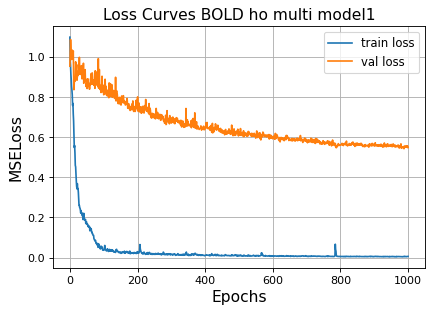

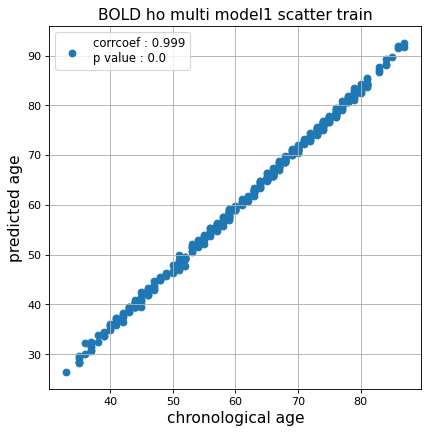

r^2 train data:  0.9564626691277338


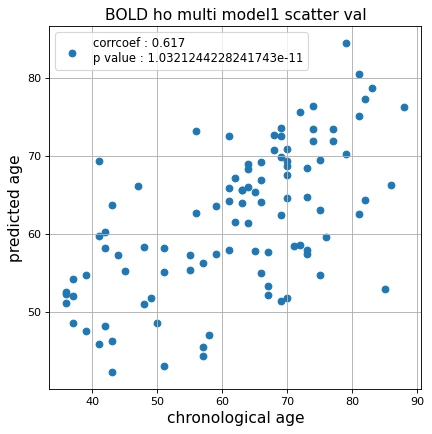

r^2 val data:  0.37685235268114803


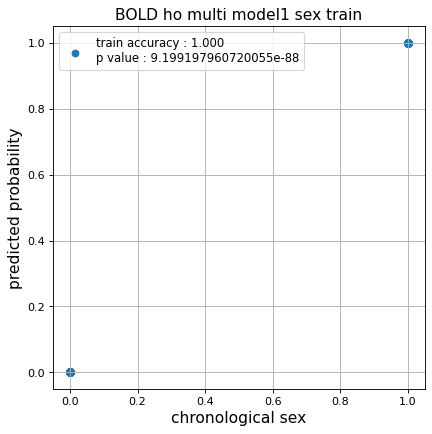

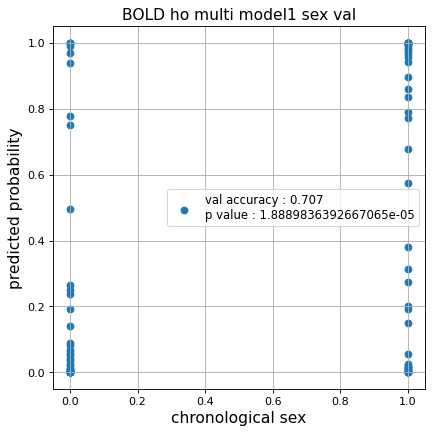

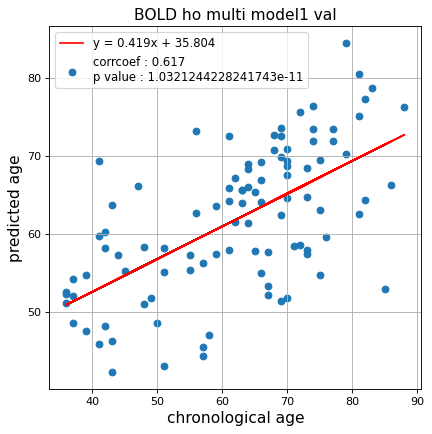

切片: 35.803987741234906
傾き: 0.41891162582077385
Kfold: 2 ::: epoch: 100, loss: 0.07400696466748531, val loss: 0.7398182302713394
Kfold: 2 ::: epoch: 200, loss: 0.01786776467298086, val loss: 0.6506468504667282
Kfold: 2 ::: epoch: 300, loss: 0.012329545982468586, val loss: 0.6191839203238487
Kfold: 2 ::: epoch: 400, loss: 0.009434240010495368, val loss: 0.5775837302207947
Kfold: 2 ::: epoch: 500, loss: 0.008633598004682707, val loss: 0.5674919486045837
Kfold: 2 ::: epoch: 600, loss: 0.007049331674352288, val loss: 0.5633925944566727
Kfold: 2 ::: epoch: 700, loss: 0.005694145963598902, val loss: 0.5569671541452408
Kfold: 2 ::: epoch: 800, loss: 0.004847541666374757, val loss: 0.5595182925462723
Kfold: 2 ::: epoch: 900, loss: 0.004311855506295195, val loss: 0.5726250782608986
Kfold: 2 ::: epoch: 1000, loss: 0.00459796476822633, val loss: 0.5553539916872978
save_epochs:852
best val loss:0.5305714309215546


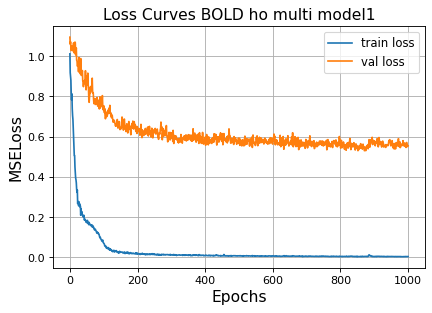

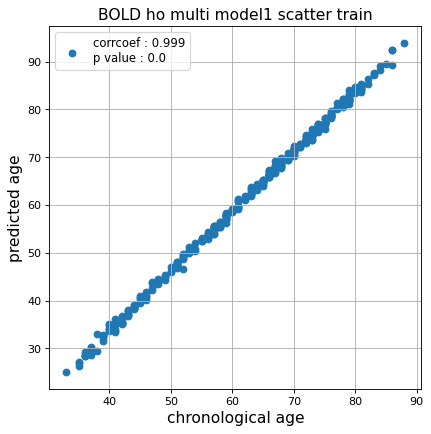

r^2 train data:  0.9324073322200989


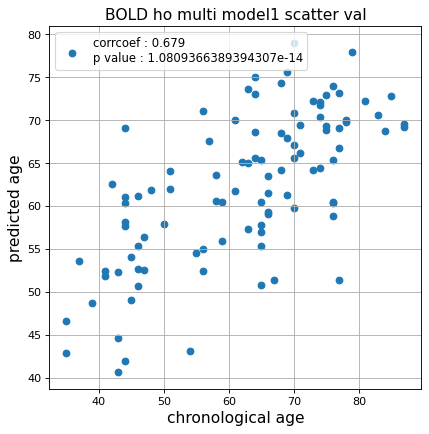

r^2 val data:  0.4603618274490726


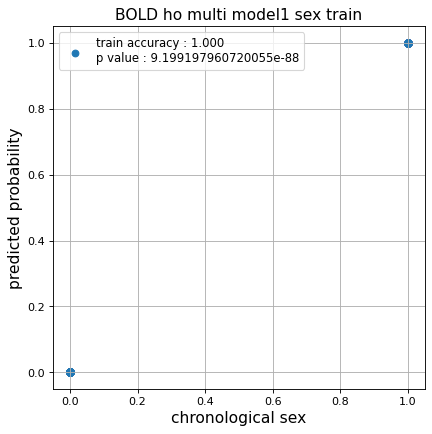

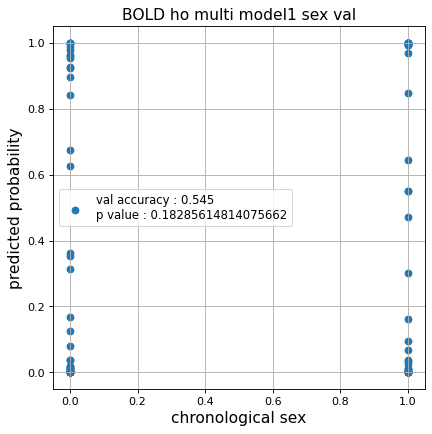

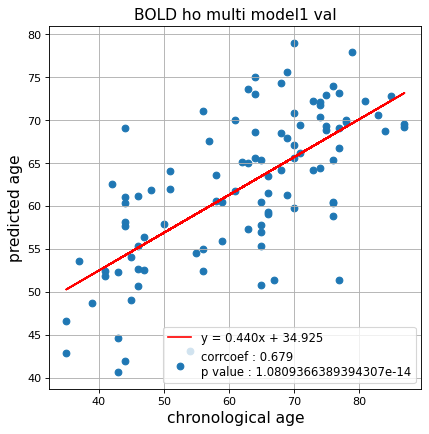

切片: 34.925193622958346
傾き: 0.4395856439865884
Kfold: 3 ::: epoch: 100, loss: 0.041211487438816294, val loss: 0.9935541450977325
Kfold: 3 ::: epoch: 200, loss: 0.01746291359170125, val loss: 0.9750405102968216
Kfold: 3 ::: epoch: 300, loss: 0.012142932042479515, val loss: 0.8900365233421326
Kfold: 3 ::: epoch: 400, loss: 0.010844900595167508, val loss: 0.898561492562294
Kfold: 3 ::: epoch: 500, loss: 0.009012662160855073, val loss: 0.8443504124879837
Kfold: 3 ::: epoch: 600, loss: 0.00661271964558042, val loss: 0.836523026227951
Kfold: 3 ::: epoch: 700, loss: 0.0062064896695888955, val loss: 0.7963061034679413
Kfold: 3 ::: epoch: 800, loss: 0.005610833123612862, val loss: 0.8061452656984329
Kfold: 3 ::: epoch: 900, loss: 0.004691238174788081, val loss: 0.7821418941020966
Kfold: 3 ::: epoch: 1000, loss: 0.004367945017293096, val loss: 0.8013431280851364
save_epochs:871
best val loss:0.7670939862728119


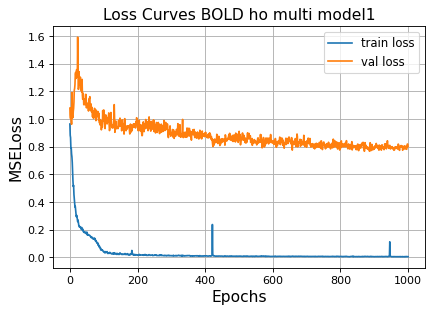

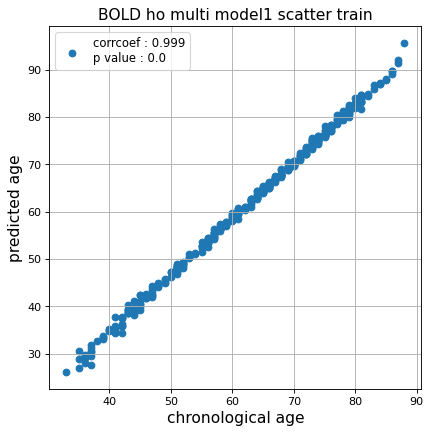

r^2 train data:  0.9533482348633684


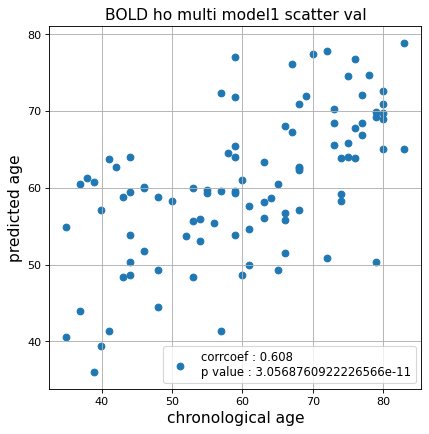

r^2 val data:  0.36321316260983905


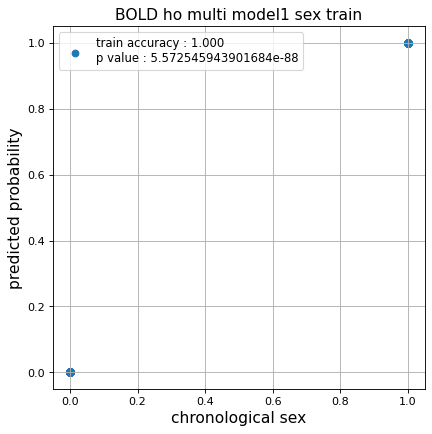

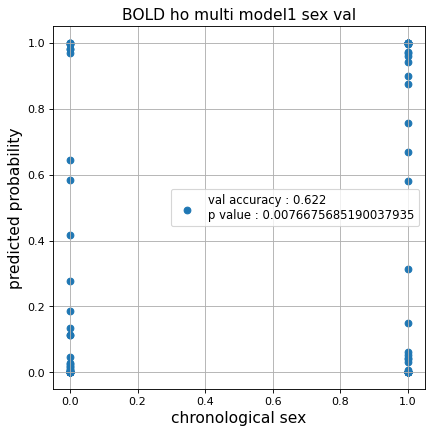

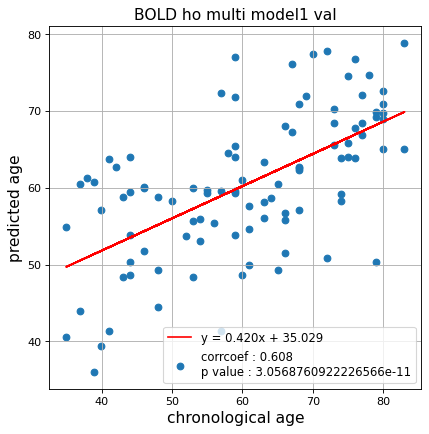

切片: 35.029483997226336
傾き: 0.4198925970791113
Kfold: 4 ::: epoch: 100, loss: 0.0511715761744059, val loss: 1.5653440058231354
Kfold: 4 ::: epoch: 200, loss: 0.021316959307743952, val loss: 1.2251740247011185
Kfold: 4 ::: epoch: 300, loss: 0.010697337655493846, val loss: 1.1956849098205566
Kfold: 4 ::: epoch: 400, loss: 0.01058363846431558, val loss: 1.1321653127670288
Kfold: 4 ::: epoch: 500, loss: 0.0076903985598339485, val loss: 1.1896097511053085
Kfold: 4 ::: epoch: 600, loss: 0.007074533316951532, val loss: 1.1479773223400116
early stopping
save_epochs:406
best val loss:1.085232526063919


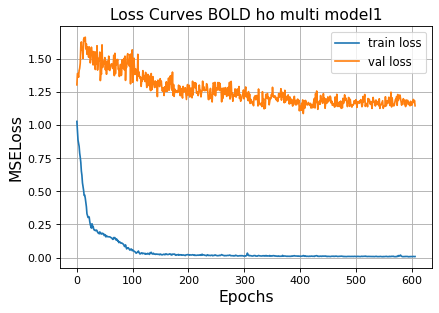

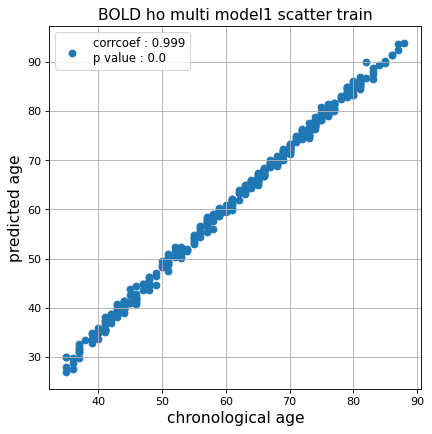

r^2 train data:  0.9368670835644056


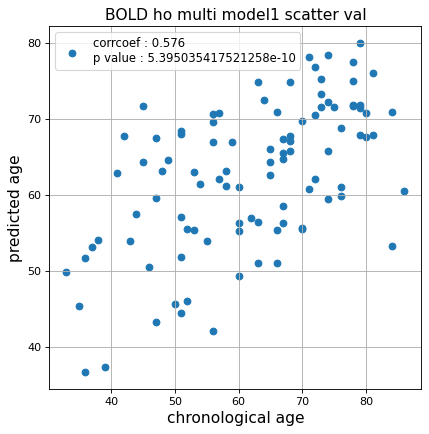

r^2 val data:  0.30910016564641796


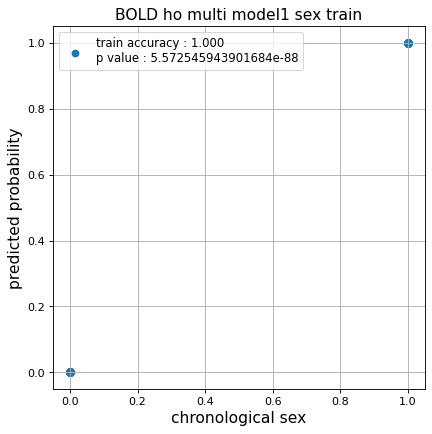

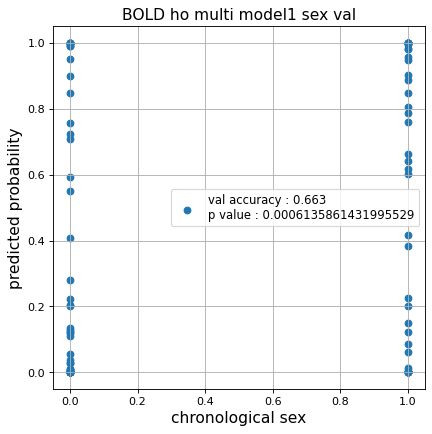

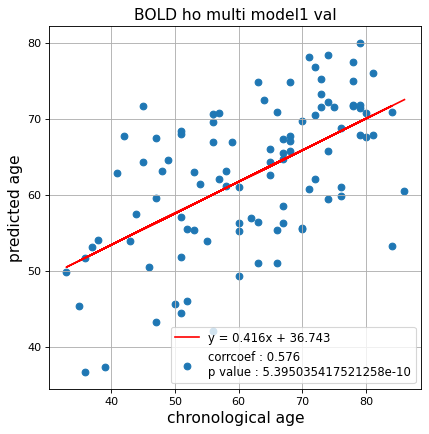

切片: 36.74293590359923
傾き: 0.4160754159258455
Kfold: 5 ::: epoch: 100, loss: 0.05063714115665509, val loss: 0.8817689418792725
Kfold: 5 ::: epoch: 200, loss: 0.01646539432784686, val loss: 0.8821888864040375
Kfold: 5 ::: epoch: 300, loss: 0.011274423844252642, val loss: 0.8697315156459808
Kfold: 5 ::: epoch: 400, loss: 0.009749433545109171, val loss: 0.8286636620759964
Kfold: 5 ::: epoch: 500, loss: 0.008992750699130388, val loss: 0.8401422947645187
Kfold: 5 ::: epoch: 600, loss: 0.007062477525323629, val loss: 0.7857380658388138
Kfold: 5 ::: epoch: 700, loss: 0.006009995131395184, val loss: 0.7980719357728958
Kfold: 5 ::: epoch: 800, loss: 0.00510123664011749, val loss: 0.7859002351760864
Kfold: 5 ::: epoch: 900, loss: 0.004269920773087786, val loss: 0.7642828077077866
Kfold: 5 ::: epoch: 1000, loss: 0.004295376326458959, val loss: 0.7568807005882263
save_epochs:931
best val loss:0.7375396490097046


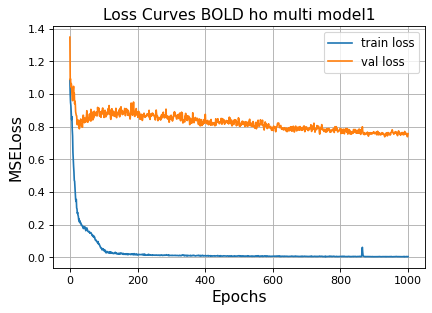

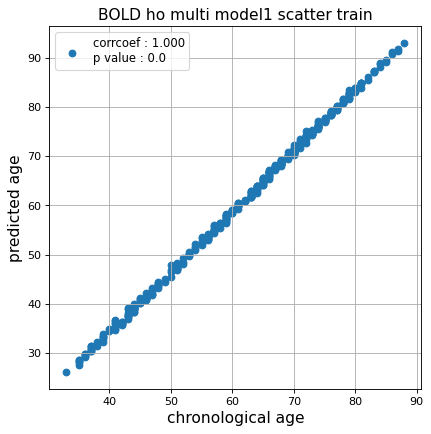

r^2 train data:  0.9412323656429888


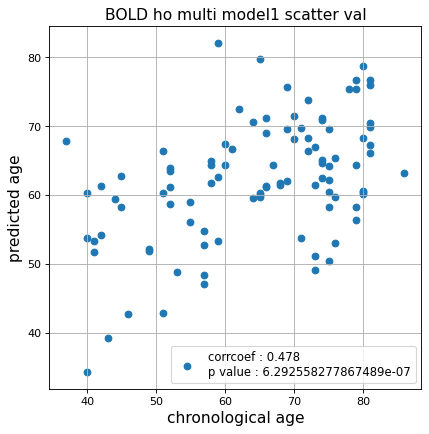

r^2 val data:  0.14576600358903458


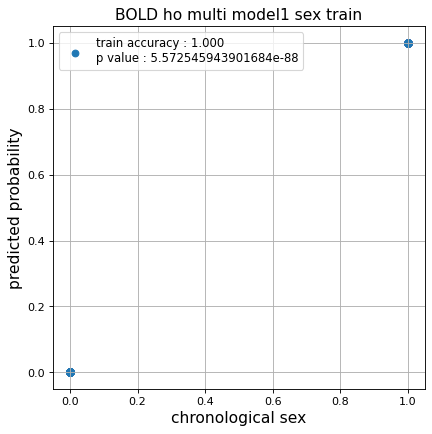

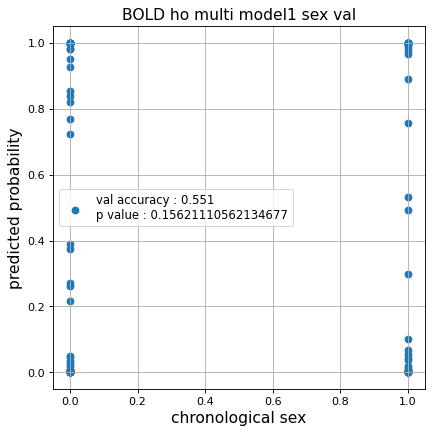

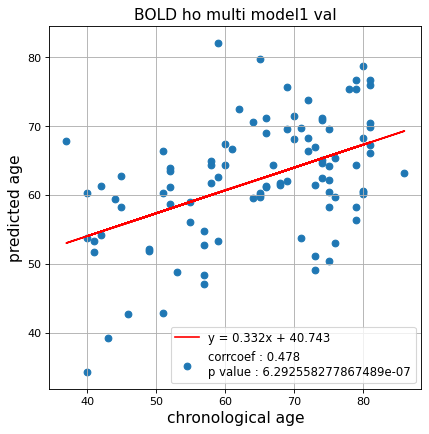

切片: 40.74251657744725
傾き: 0.33212463219121263
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.039013447239995, val loss: 0.6617437079548836
Kfold: 1 ::: epoch: 200, loss: 0.024254637197233163, val loss: 0.6494914144277573
Kfold: 1 ::: epoch: 300, loss: 0.017937443004204676, val loss: 0.580870296806097
Kfold: 1 ::: epoch: 400, loss: 0.011560010329748575, val loss: 0.5611623786389828
Kfold: 1 ::: epoch: 500, loss: 0.010017540055112196, val loss: 0.5424960553646088
Kfold: 1 ::: epoch: 600, loss: 0.007409068702075344, val loss: 0.5483032539486885
Kfold: 1 ::: epoch: 700, loss: 0.0075916933397261, val loss: 0.5420827567577362
Kfold: 1 ::: epoch: 800, loss: 0.006537667045799585, val loss: 0.5443510487675667
Kfold: 1 ::: epoch: 900, loss: 0.0074679101100907875, val loss: 0.5417800173163414
Kfold: 1 ::: epoch: 1000, loss: 0.0051134065008507324, val loss: 0.5293766409158707
save_epochs:907
best val loss:0.5192263685166836


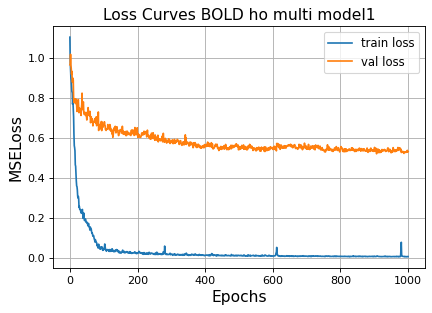

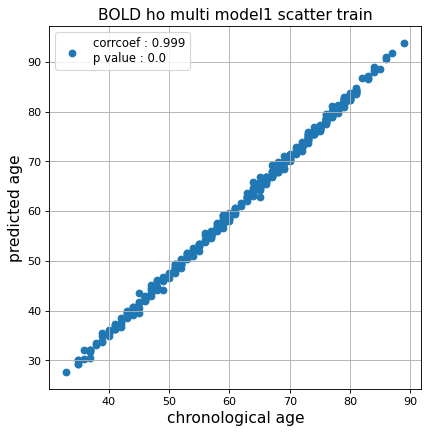

r^2 train data:  0.961715603248586


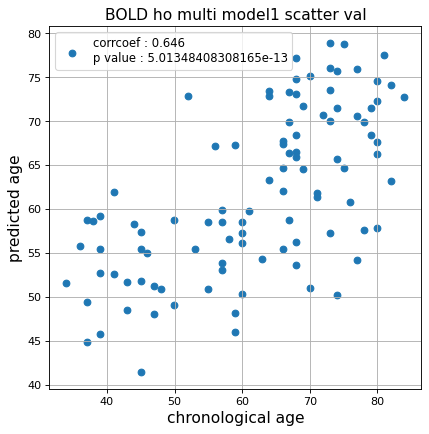

r^2 val data:  0.4164491439262038


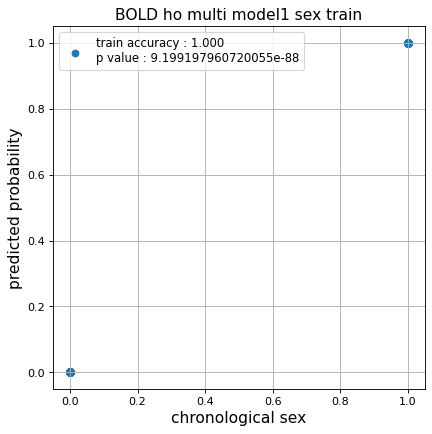

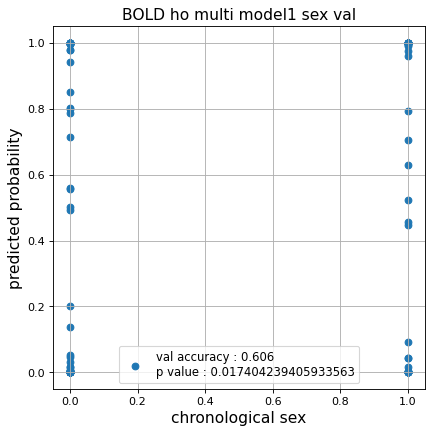

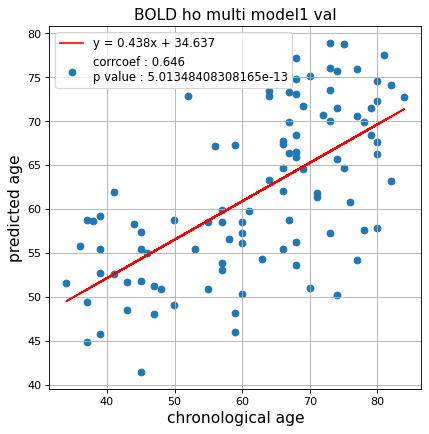

切片: 34.6373338883607
傾き: 0.43752707070398533
Kfold: 2 ::: epoch: 100, loss: 0.06840794189618184, val loss: 0.8861790150403976
Kfold: 2 ::: epoch: 200, loss: 0.01929350892225137, val loss: 0.7842525392770767
Kfold: 2 ::: epoch: 300, loss: 0.01416234106111985, val loss: 0.7511543780565262
Kfold: 2 ::: epoch: 400, loss: 0.01059393946511241, val loss: 0.7530484348535538
early stopping
save_epochs:233
best val loss:0.7076798975467682


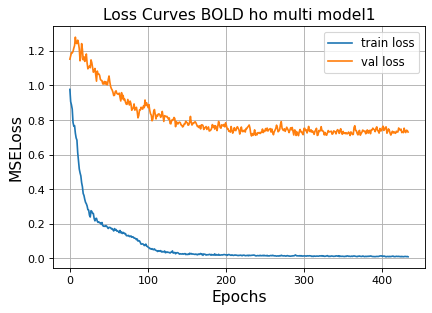

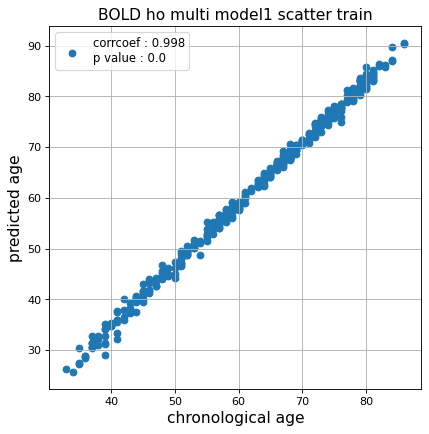

r^2 train data:  0.9477706458484935


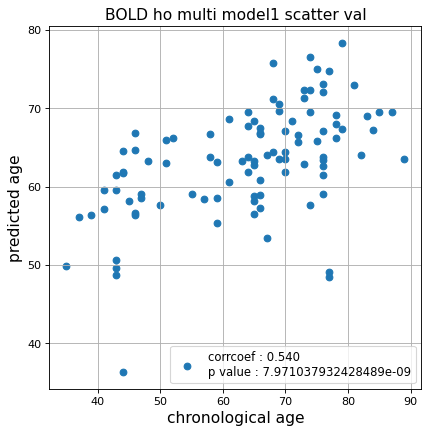

r^2 val data:  0.2898806809076754


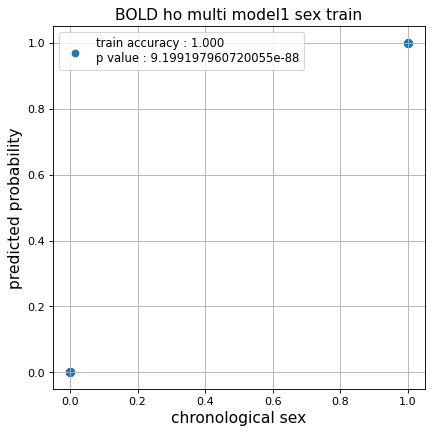

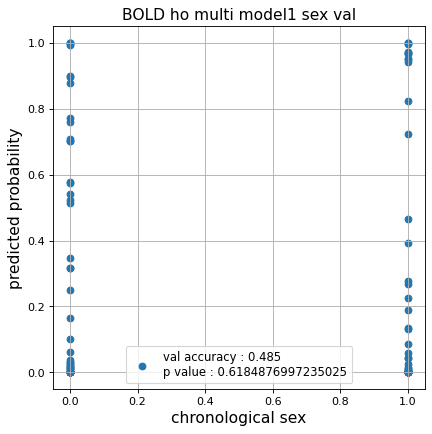

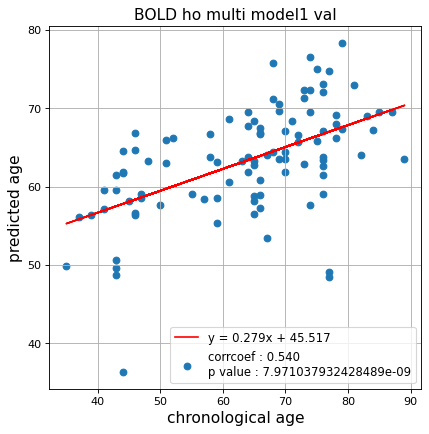

切片: 45.51680878099775
傾き: 0.2793594816888428
Kfold: 3 ::: epoch: 100, loss: 0.037319444406491056, val loss: 0.808716207742691
Kfold: 3 ::: epoch: 200, loss: 0.017702930893462438, val loss: 0.7907351553440094
Kfold: 3 ::: epoch: 300, loss: 0.014096567263970008, val loss: 0.8455962538719177
Kfold: 3 ::: epoch: 400, loss: 0.011845761802620612, val loss: 0.8980088829994202
early stopping
save_epochs:248
best val loss:0.794693797826767


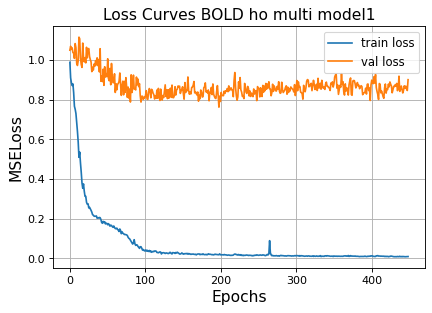

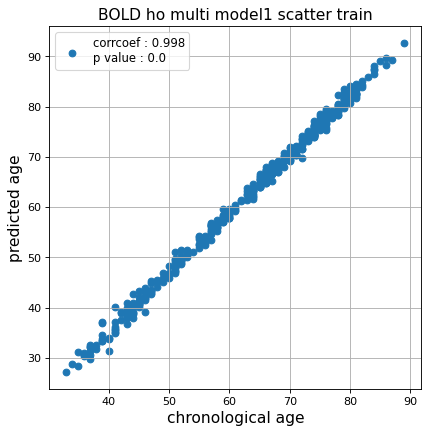

r^2 train data:  0.9618709678119417


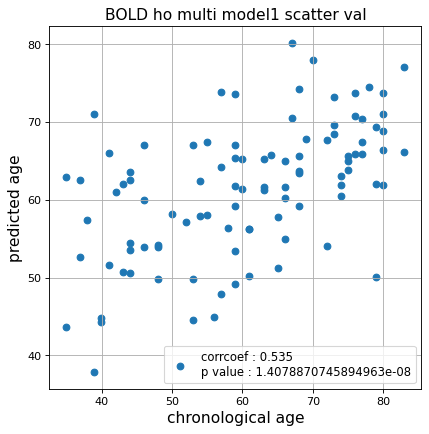

r^2 val data:  0.27356042234137135


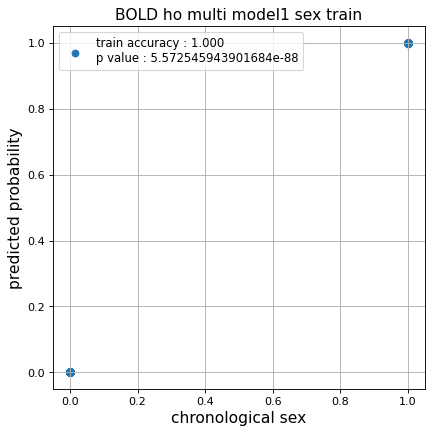

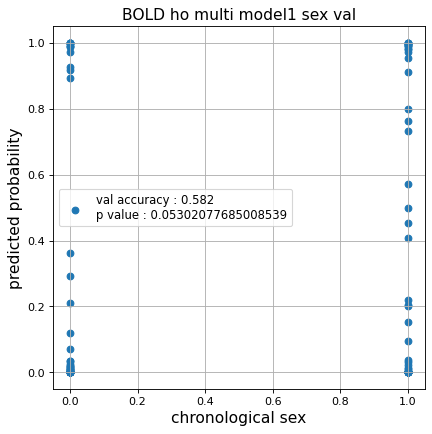

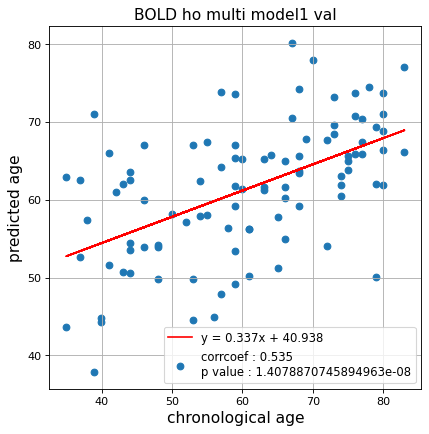

切片: 40.937522741921725
傾き: 0.3374079030112078
Kfold: 4 ::: epoch: 100, loss: 0.04224685694162662, val loss: 1.7863683700561523
Kfold: 4 ::: epoch: 200, loss: 0.020285460668114517, val loss: 1.5578067153692245
Kfold: 4 ::: epoch: 300, loss: 0.012895109131932259, val loss: 1.5174806118011475
Kfold: 4 ::: epoch: 400, loss: 0.010156710560505208, val loss: 1.484577476978302
Kfold: 4 ::: epoch: 500, loss: 0.007054201918295943, val loss: 1.4079822599887848
Kfold: 4 ::: epoch: 600, loss: 0.006548233079509093, val loss: 1.463627114892006
Kfold: 4 ::: epoch: 700, loss: 0.006149451463268354, val loss: 1.2857445627450943
Kfold: 4 ::: epoch: 800, loss: 0.005597418612943819, val loss: 1.3387337625026703
Kfold: 4 ::: epoch: 900, loss: 0.0054730095076732915, val loss: 1.3052657693624496
Kfold: 4 ::: epoch: 1000, loss: 0.003910505257618542, val loss: 1.2708792686462402
save_epochs:981
best val loss:1.2342172861099243


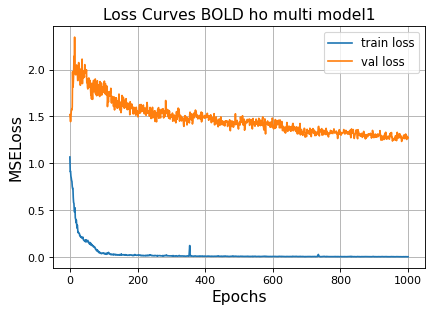

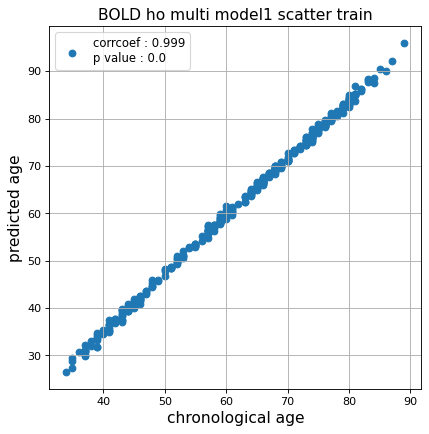

r^2 train data:  0.9490365271620201


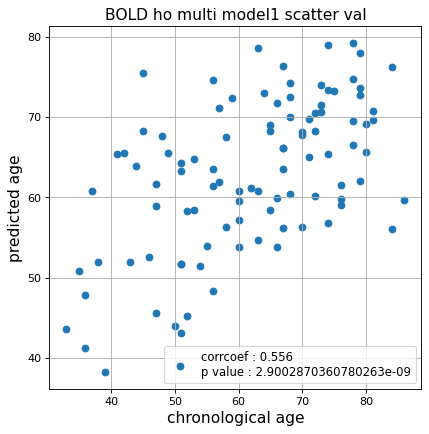

r^2 val data:  0.2832275875829129


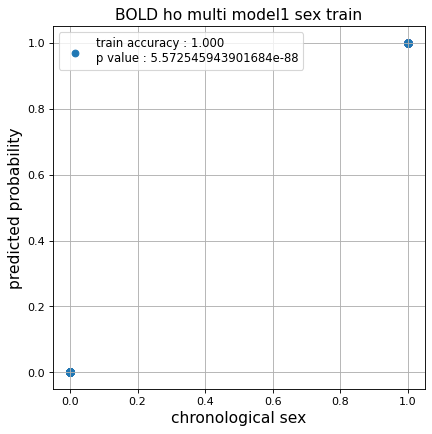

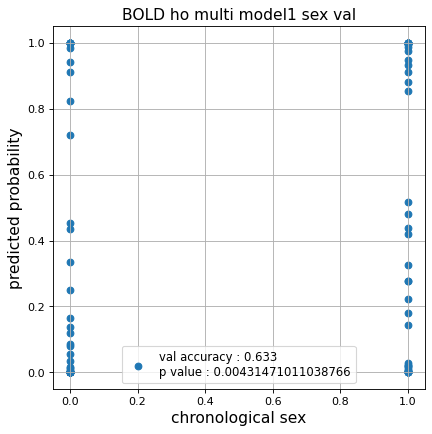

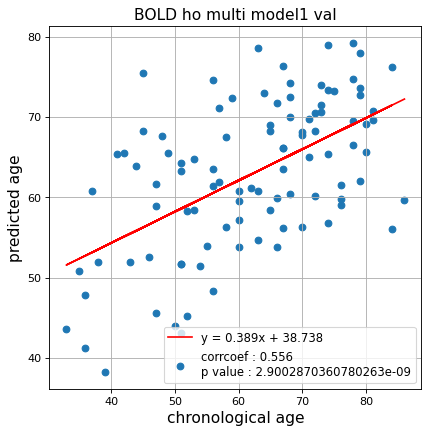

切片: 38.73829253159932
傾き: 0.38947167669219535
Kfold: 5 ::: epoch: 100, loss: 0.0356969043899041, val loss: 1.0059002786874771
Kfold: 5 ::: epoch: 200, loss: 0.0160570082326348, val loss: 0.9462922215461731
Kfold: 5 ::: epoch: 300, loss: 0.013077872805297375, val loss: 0.9030865728855133
Kfold: 5 ::: epoch: 400, loss: 0.009980766281772118, val loss: 0.8375489115715027
Kfold: 5 ::: epoch: 500, loss: 0.008132059127092361, val loss: 0.8260571509599686
Kfold: 5 ::: epoch: 600, loss: 0.0074148830384589155, val loss: 0.8144532889127731
Kfold: 5 ::: epoch: 700, loss: 0.006756695721728297, val loss: 0.8011106252670288
Kfold: 5 ::: epoch: 800, loss: 0.0054690816726249, val loss: 0.8153794705867767
Kfold: 5 ::: epoch: 900, loss: 0.12191574091020112, val loss: 0.7798540443181992
Kfold: 5 ::: epoch: 1000, loss: 0.004354554891156463, val loss: 0.7801001071929932
save_epochs:832
best val loss:0.7704119682312012


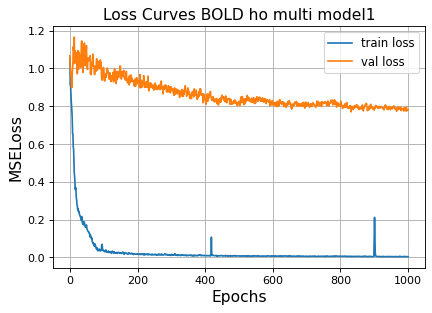

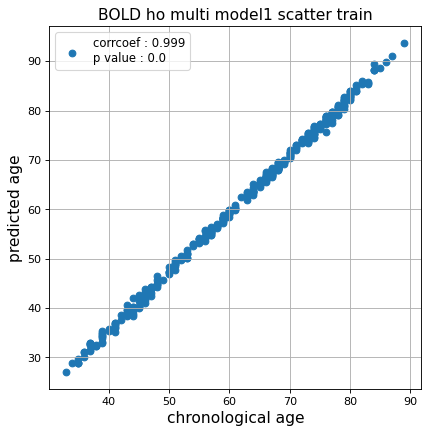

r^2 train data:  0.9626013650873362


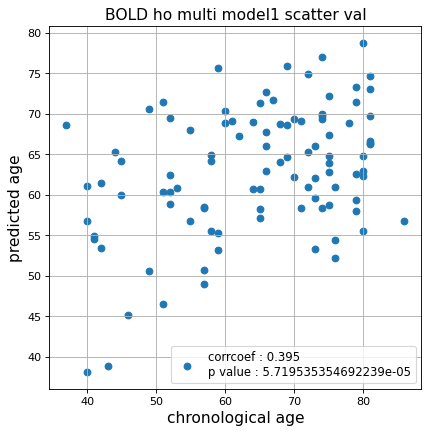

r^2 val data:  0.09111202347275349


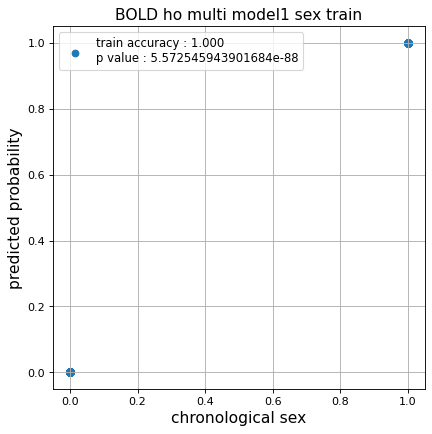

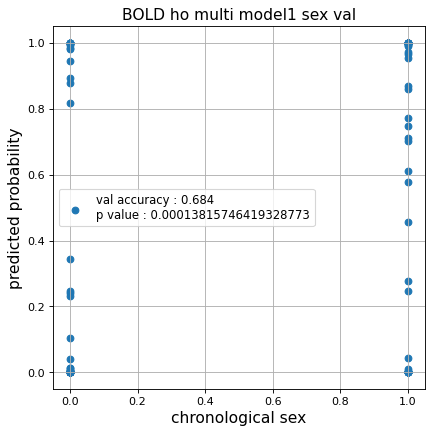

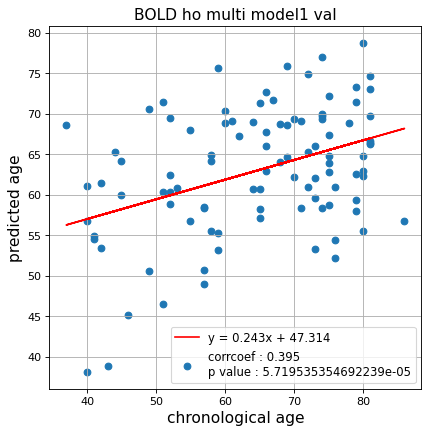

切片: 47.31403624582641
傾き: 0.24279864799470105
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.04504698944779543, val loss: 0.6079873647540808
Kfold: 1 ::: epoch: 200, loss: 0.021434846620720167, val loss: 0.5698594115674496
Kfold: 1 ::: epoch: 300, loss: 0.015556422635339774, val loss: 0.5563603192567825
Kfold: 1 ::: epoch: 400, loss: 0.014543774609382335, val loss: 0.5409707576036453
Kfold: 1 ::: epoch: 500, loss: 0.008480706180517491, val loss: 0.5285408981144428
Kfold: 1 ::: epoch: 600, loss: 0.006376806754045761, val loss: 0.5180539935827255
Kfold: 1 ::: epoch: 700, loss: 0.006447640820764578, val loss: 0.5195493828505278
Kfold: 1 ::: epoch: 800, loss: 0.006620426321975314, val loss: 0.5204467810690403
Kfold: 1 ::: epoch: 900, loss: 0.004405258151774223, val loss: 0.5189297311007977
Kfold: 1 ::: epoch: 1000, loss: 0.004527515355640879, val loss: 0.5278373435139656
save_epochs:823
best val loss:0.5055379420518875


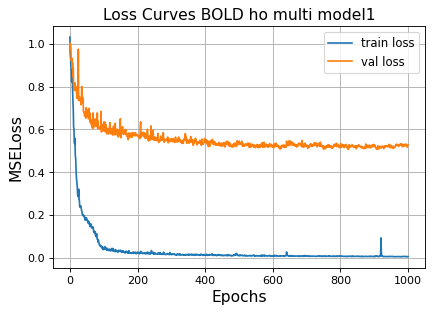

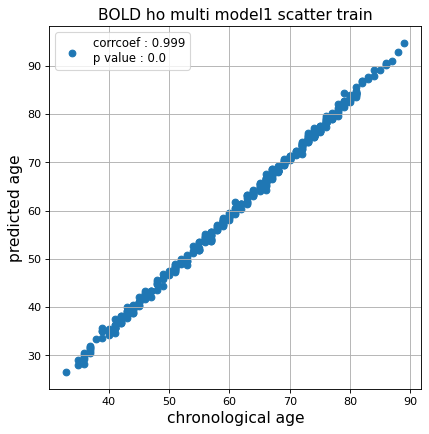

r^2 train data:  0.9535778583655501


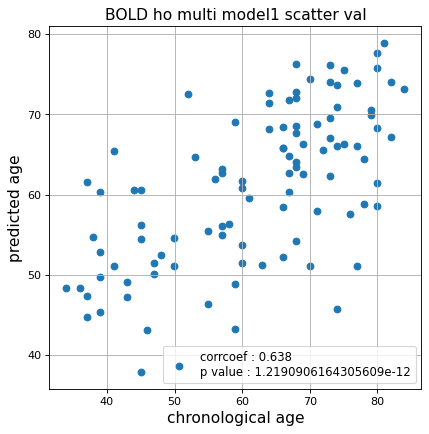

r^2 val data:  0.40008759094863855


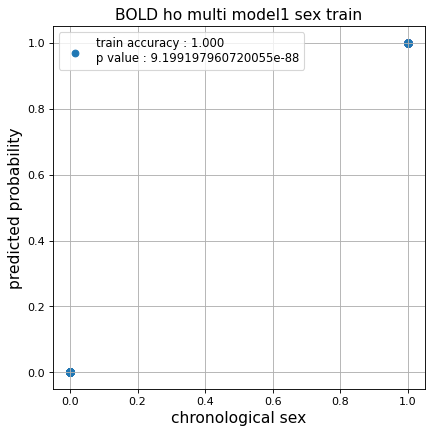

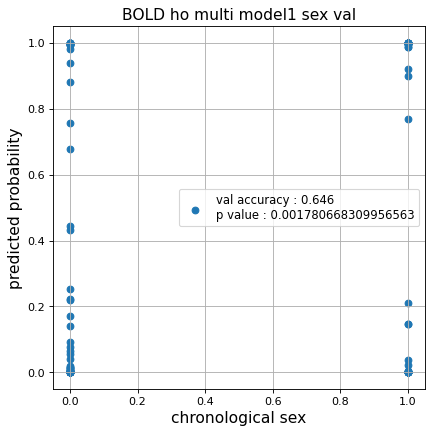

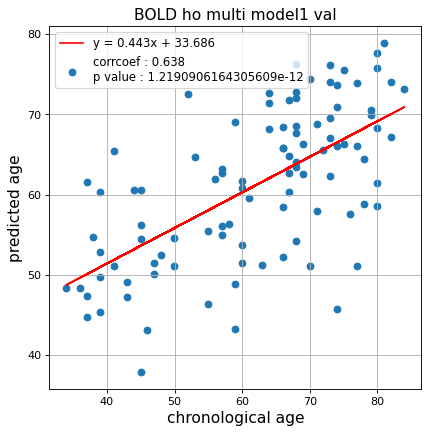

切片: 33.68587220316718
傾き: 0.4432596432022944
Kfold: 2 ::: epoch: 100, loss: 0.06809049185652, val loss: 0.7579183429479599
Kfold: 2 ::: epoch: 200, loss: 0.020741600113419387, val loss: 0.6860651597380638
Kfold: 2 ::: epoch: 300, loss: 0.014464323623822285, val loss: 0.6248558145016432
Kfold: 2 ::: epoch: 400, loss: 0.009603112971839996, val loss: 0.5889218635857105
Kfold: 2 ::: epoch: 500, loss: 0.00820153453745521, val loss: 0.5687017161399126
Kfold: 2 ::: epoch: 600, loss: 0.007837051203331122, val loss: 0.5679002664983273
Kfold: 2 ::: epoch: 700, loss: 0.006056263147351833, val loss: 0.5486335000023246
Kfold: 2 ::: epoch: 800, loss: 0.005290627873574312, val loss: 0.5455179279670119
Kfold: 2 ::: epoch: 900, loss: 0.004738071915478661, val loss: 0.5433257706463337
Kfold: 2 ::: epoch: 1000, loss: 0.004226148146419571, val loss: 0.5319830868393183
save_epochs:943
best val loss:0.5285898186266422


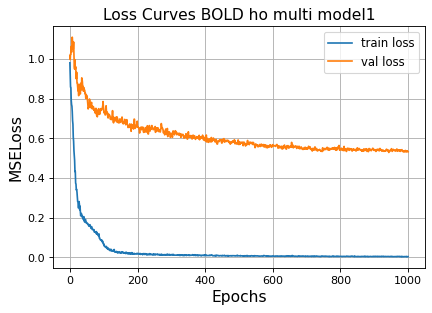

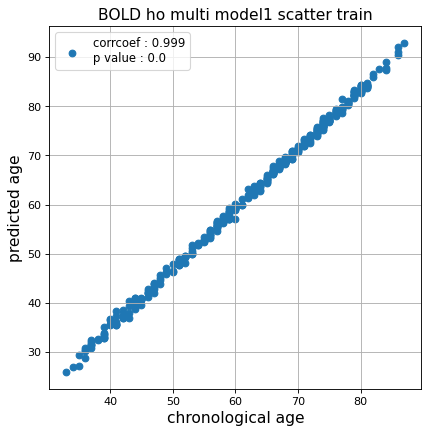

r^2 train data:  0.9521382357789363


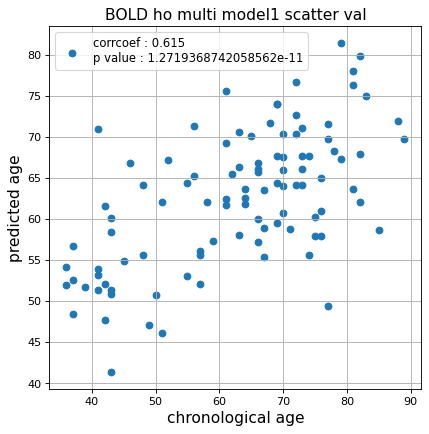

r^2 val data:  0.3772625375675629


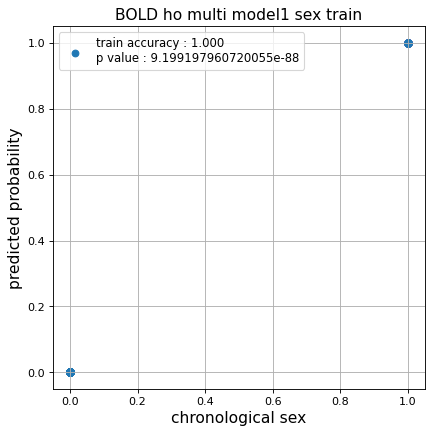

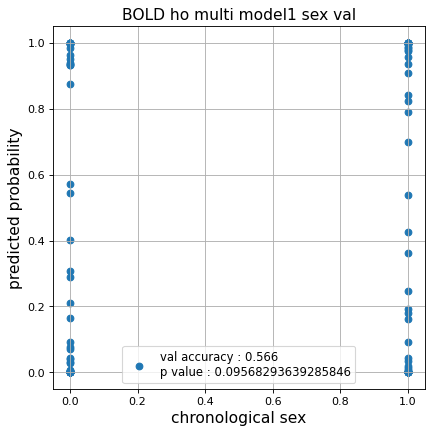

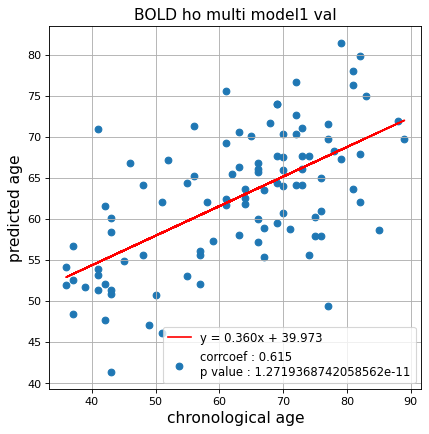

切片: 39.97308122751342
傾き: 0.36015128117657813
Kfold: 3 ::: epoch: 100, loss: 0.039542765714801274, val loss: 0.922919824719429
Kfold: 3 ::: epoch: 200, loss: 0.01916435411056647, val loss: 0.8157516866922379
Kfold: 3 ::: epoch: 300, loss: 0.011815541925338598, val loss: 0.8463633954524994
Kfold: 3 ::: epoch: 400, loss: 0.011225440682700047, val loss: 0.84160977602005
Kfold: 3 ::: epoch: 500, loss: 0.00742779507373388, val loss: 0.8353177458047867
Kfold: 3 ::: epoch: 600, loss: 0.0068696541353487055, val loss: 0.7213105261325836
Kfold: 3 ::: epoch: 700, loss: 0.006772371689574077, val loss: 0.7753546983003616
Kfold: 3 ::: epoch: 800, loss: 0.0051943267731425855, val loss: 0.7882793545722961
early stopping
save_epochs:600
best val loss:0.7213105261325836


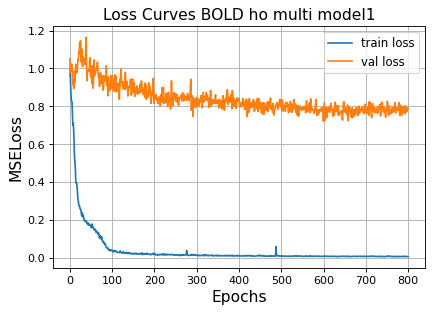

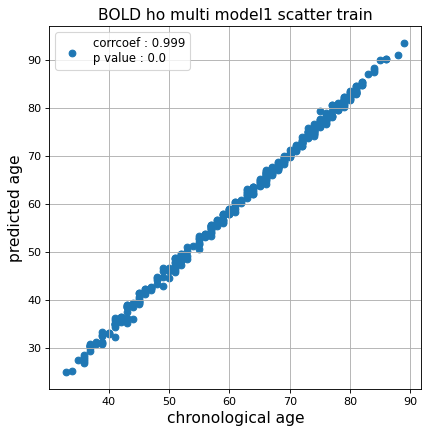

r^2 train data:  0.9394912010762254


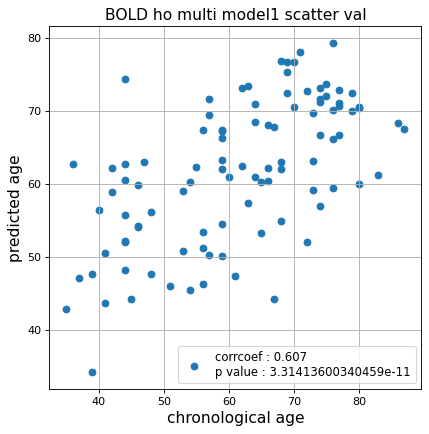

r^2 val data:  0.35076834790744515


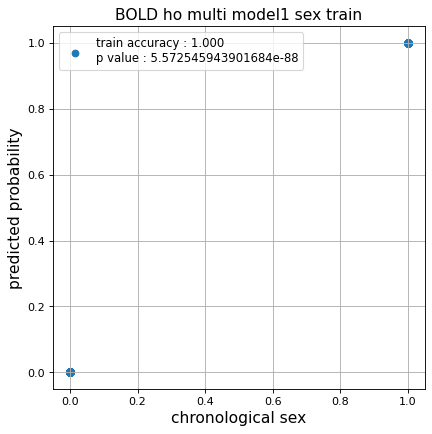

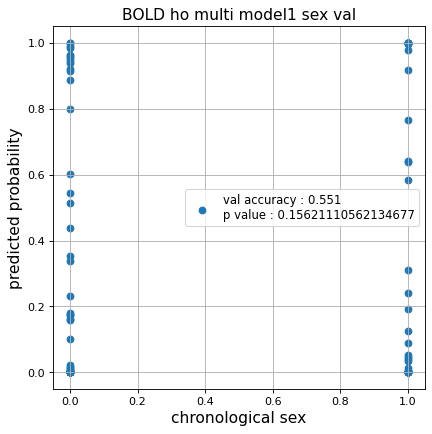

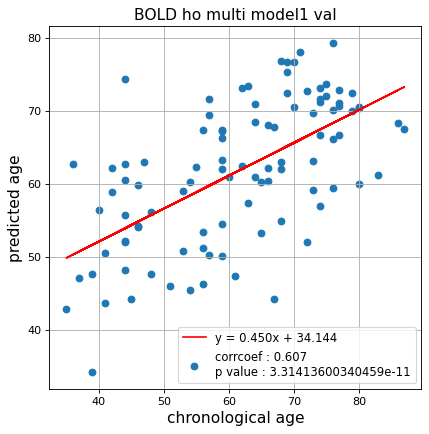

切片: 34.1437875543356
傾き: 0.44950931260319504
Kfold: 4 ::: epoch: 100, loss: 0.04023389890789986, val loss: 1.3546952903270721
Kfold: 4 ::: epoch: 200, loss: 0.018657835343709357, val loss: 1.2281558066606522
Kfold: 4 ::: epoch: 300, loss: 0.015640444480455838, val loss: 1.1894616484642029
Kfold: 4 ::: epoch: 400, loss: 0.009604959891965756, val loss: 1.2227745950222015
Kfold: 4 ::: epoch: 500, loss: 0.00829709256784274, val loss: 1.1493503004312515
Kfold: 4 ::: epoch: 600, loss: 0.0073549277149140835, val loss: 1.1362680941820145
Kfold: 4 ::: epoch: 700, loss: 0.006054915308665771, val loss: 1.1739123612642288
Kfold: 4 ::: epoch: 800, loss: 0.004837682918430521, val loss: 1.136948823928833
early stopping
save_epochs:648
best val loss:1.0801341980695724


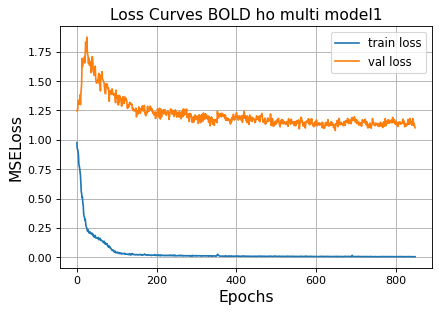

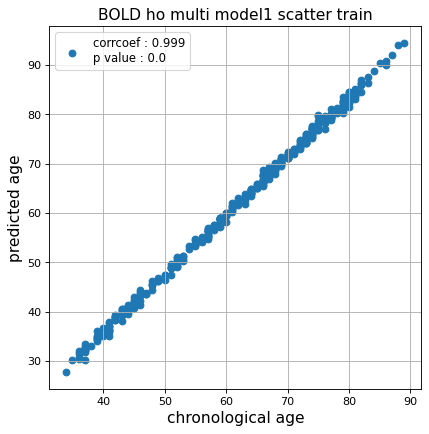

r^2 train data:  0.9615571874057248


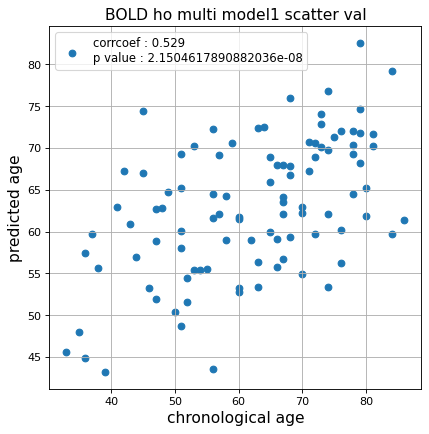

r^2 val data:  0.2690028795906423


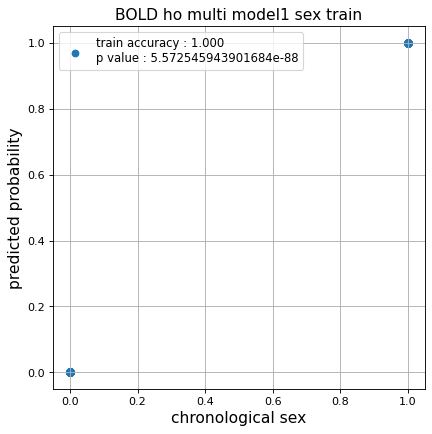

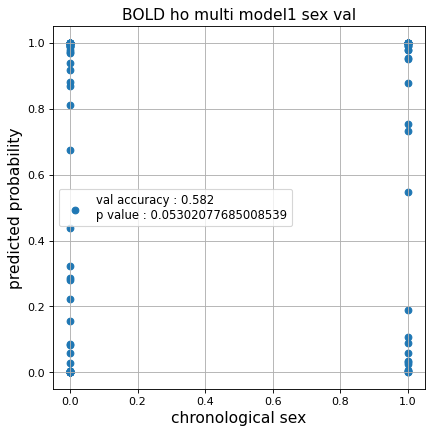

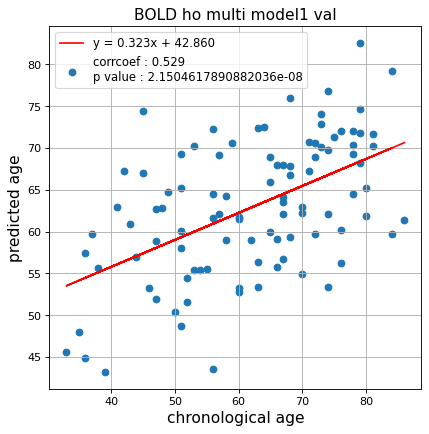

切片: 42.85954591986797
傾き: 0.32300010370137017
Kfold: 5 ::: epoch: 100, loss: 0.03753878176212311, val loss: 0.9162000715732574
Kfold: 5 ::: epoch: 200, loss: 0.018580090039624617, val loss: 0.8659457564353943
Kfold: 5 ::: epoch: 300, loss: 0.011162645398424221, val loss: 0.7920696437358856
Kfold: 5 ::: epoch: 400, loss: 0.011156427387434702, val loss: 0.7808323949575424
Kfold: 5 ::: epoch: 500, loss: 0.007547255444268768, val loss: 0.7584009766578674
Kfold: 5 ::: epoch: 600, loss: 0.0062918152051189774, val loss: 0.7427226454019547
Kfold: 5 ::: epoch: 700, loss: 0.006453555614615862, val loss: 0.7078042924404144
Kfold: 5 ::: epoch: 800, loss: 0.00501906991792986, val loss: 0.6875227391719818
early stopping
save_epochs:676
best val loss:0.6851596534252167


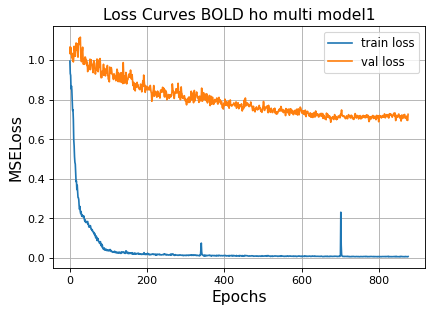

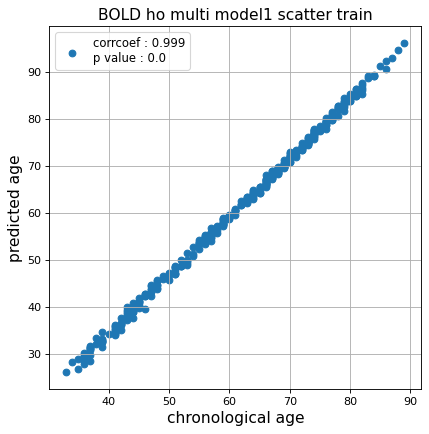

r^2 train data:  0.9357192847413597


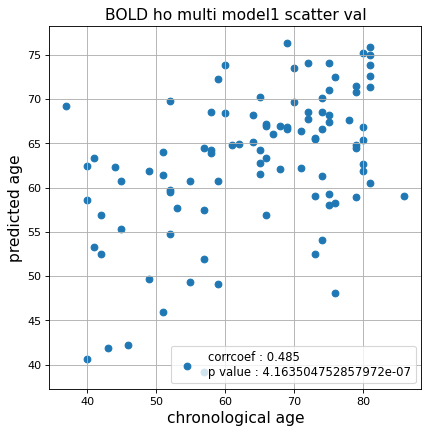

r^2 val data:  0.19573798062853653


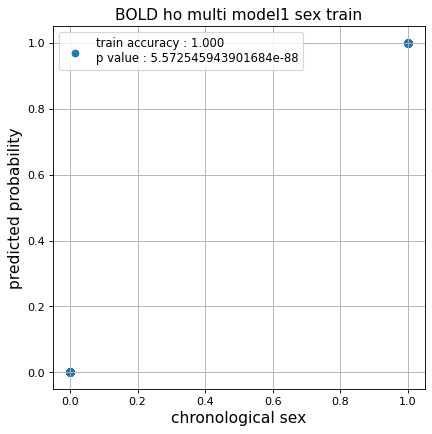

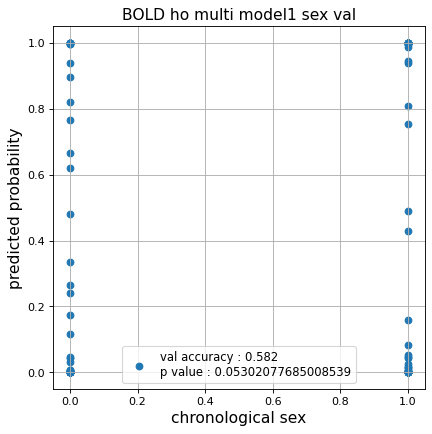

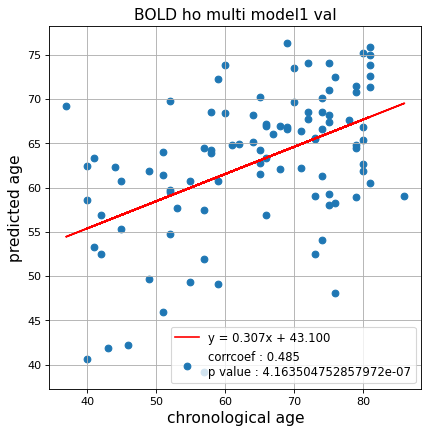

切片: 43.099566995742244
傾き: 0.3072357788823048
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.04700142231125098, val loss: 0.6186911836266518
Kfold: 1 ::: epoch: 200, loss: 0.021550430343128167, val loss: 0.5649417042732239
Kfold: 1 ::: epoch: 300, loss: 0.016843645045390494, val loss: 0.5414289906620979
Kfold: 1 ::: epoch: 400, loss: 0.013645072754185934, val loss: 0.5323133915662766
Kfold: 1 ::: epoch: 500, loss: 0.009717558797162313, val loss: 0.5261064991354942
Kfold: 1 ::: epoch: 600, loss: 0.007194615255754728, val loss: 0.5092477276921272
Kfold: 1 ::: epoch: 700, loss: 0.006501236751389045, val loss: 0.4964356943964958
Kfold: 1 ::: epoch: 800, loss: 0.0057991684521906655, val loss: 0.4923754259943962
Kfold: 1 ::: epoch: 900, loss: 0.007194623028716216, val loss: 0.48149682581424713
Kfold: 1 ::: epoch: 1000, loss: 0.0059376643576587625, val loss: 0.4943803958594799
save_epochs:940
best val loss:0.4724295660853386


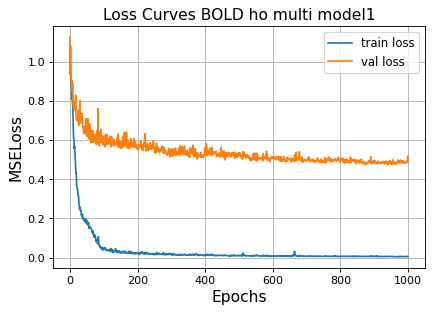

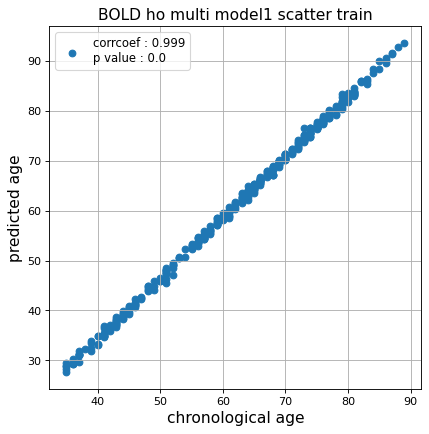

r^2 train data:  0.9486248398722228


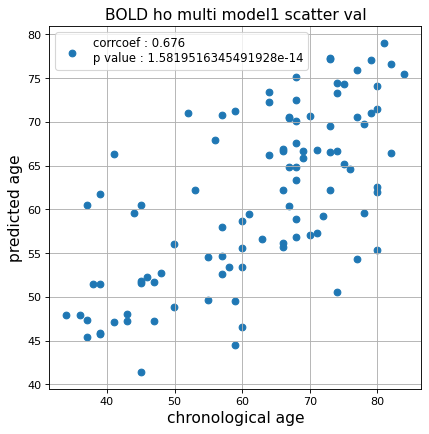

r^2 val data:  0.4531792647449533


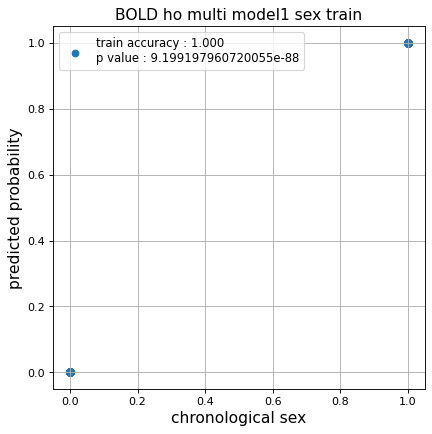

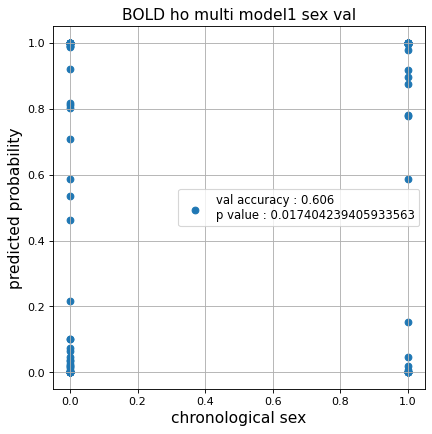

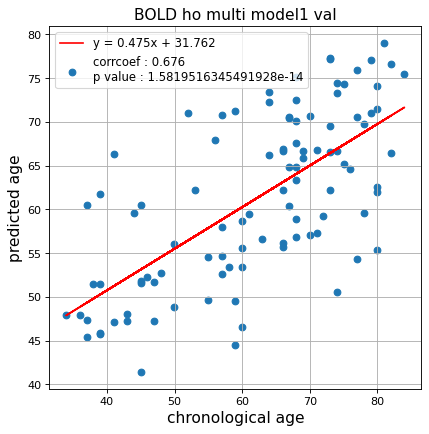

切片: 31.761638507712277
傾き: 0.4749921543297075
Kfold: 2 ::: epoch: 100, loss: 0.07033848819824365, val loss: 0.7155176997184753
Kfold: 2 ::: epoch: 200, loss: 0.02299843055124466, val loss: 0.6624073535203934
Kfold: 2 ::: epoch: 300, loss: 0.014838469931139396, val loss: 0.6148295402526855
Kfold: 2 ::: epoch: 400, loss: 0.008508556271688296, val loss: 0.6092558950185776
Kfold: 2 ::: epoch: 500, loss: 0.007934870019268531, val loss: 0.5810747519135475
Kfold: 2 ::: epoch: 600, loss: 0.007463858928531408, val loss: 0.5910927951335907
Kfold: 2 ::: epoch: 700, loss: 0.00676883846664658, val loss: 0.5892345309257507
Kfold: 2 ::: epoch: 800, loss: 0.005755497608333826, val loss: 0.5678382888436317
Kfold: 2 ::: epoch: 900, loss: 0.005184545736903181, val loss: 0.5612998753786087
Kfold: 2 ::: epoch: 1000, loss: 0.004452834514757762, val loss: 0.5507891029119492
save_epochs:954
best val loss:0.5475584268569946


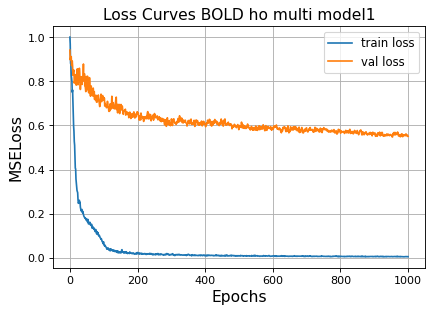

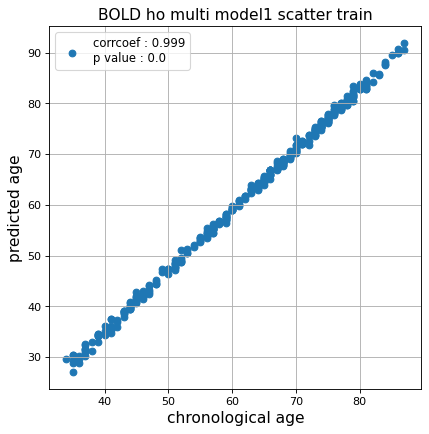

r^2 train data:  0.9589560978249425


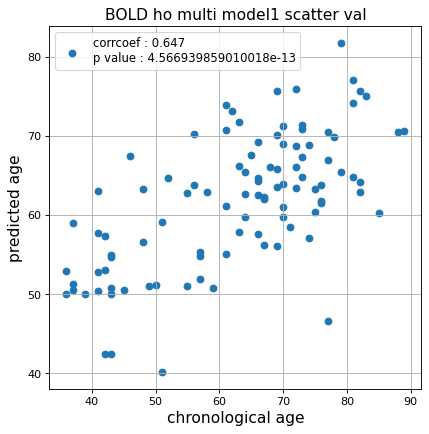

r^2 val data:  0.41270049028719513


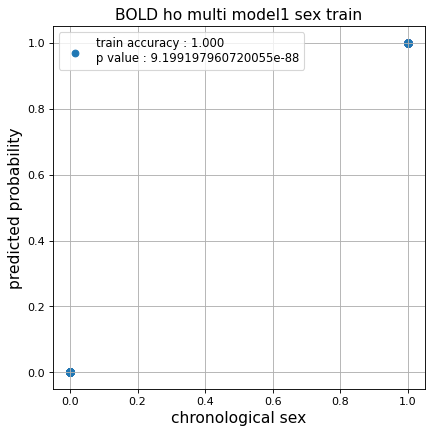

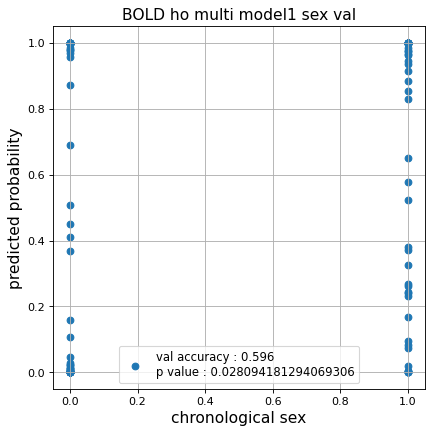

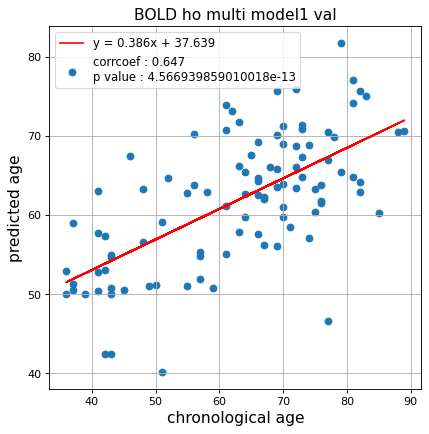

切片: 37.63867990011246
傾き: 0.3858045988394323
Kfold: 3 ::: epoch: 100, loss: 0.03719813333680996, val loss: 0.6546331271529198
Kfold: 3 ::: epoch: 200, loss: 0.014795818079549532, val loss: 0.6535396128892899
Kfold: 3 ::: epoch: 300, loss: 0.012144053605600046, val loss: 0.6592920571565628
Kfold: 3 ::: epoch: 400, loss: 0.010462473325717907, val loss: 0.6409166306257248
Kfold: 3 ::: epoch: 500, loss: 0.007201225443098407, val loss: 0.6253756284713745
Kfold: 3 ::: epoch: 600, loss: 0.006620339691065825, val loss: 0.621196061372757
early stopping
save_epochs:485
best val loss:0.5929157957434654


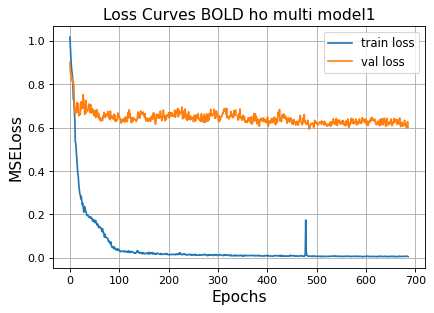

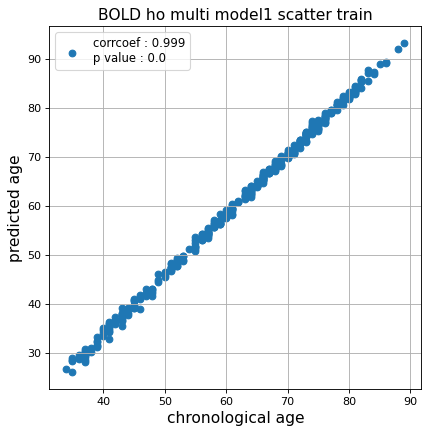

r^2 train data:  0.9401408687183349


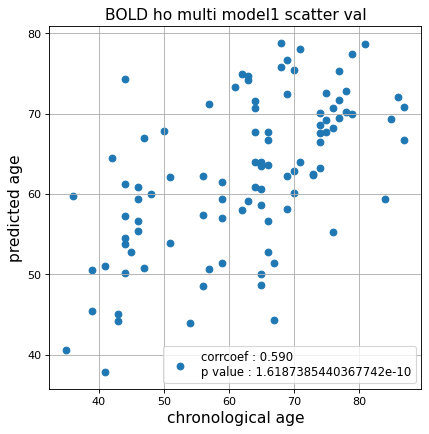

r^2 val data:  0.33075502992000727


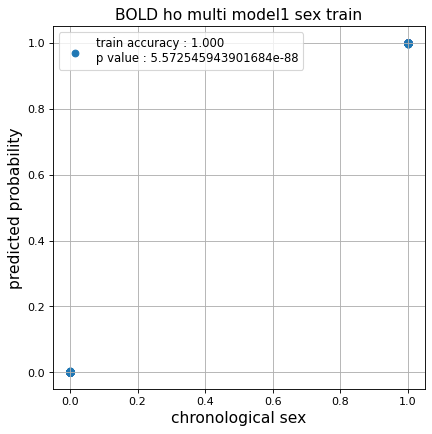

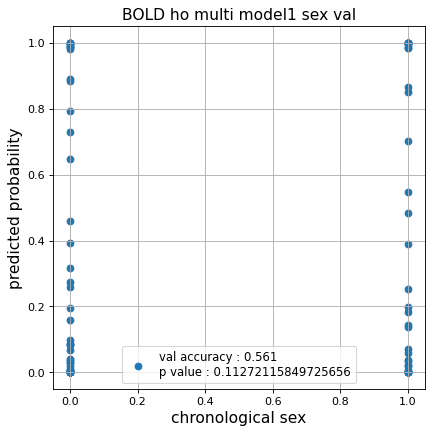

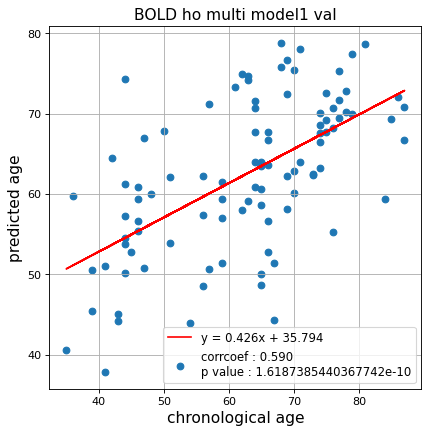

切片: 35.794261372388334
傾き: 0.42602352879118
Kfold: 4 ::: epoch: 100, loss: 0.05451107884828861, val loss: 1.1165663003921509
Kfold: 4 ::: epoch: 200, loss: 0.018644285173370287, val loss: 1.1692476272583008
Kfold: 4 ::: epoch: 300, loss: 0.010532289600143066, val loss: 1.0836931467056274
Kfold: 4 ::: epoch: 400, loss: 0.0092383731299868, val loss: 1.0080308318138123
Kfold: 4 ::: epoch: 500, loss: 0.007080911479603786, val loss: 1.0568672269582748
Kfold: 4 ::: epoch: 600, loss: 0.006276431511371181, val loss: 1.0378014296293259
early stopping
save_epochs:417
best val loss:0.9935978353023529


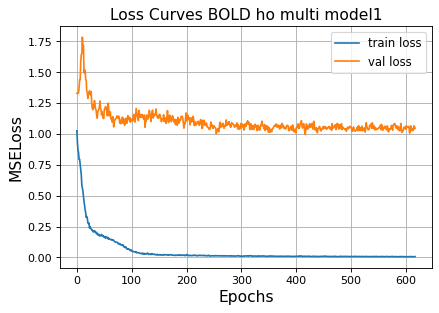

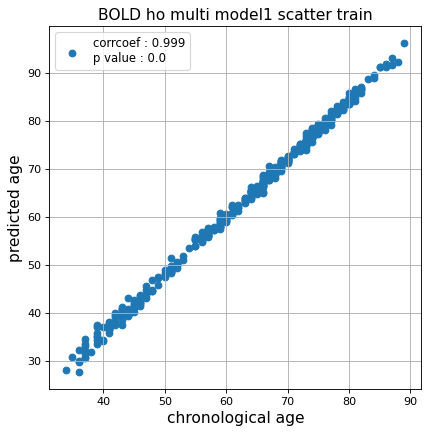

r^2 train data:  0.9490439705512151


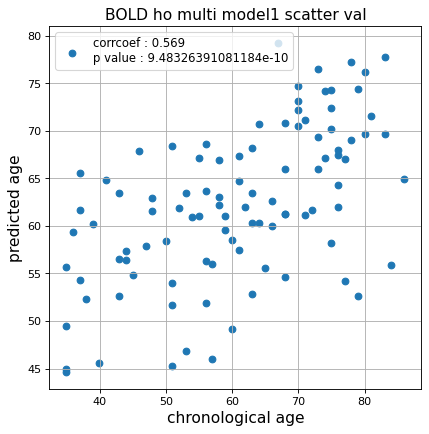

r^2 val data:  0.31267994530088317


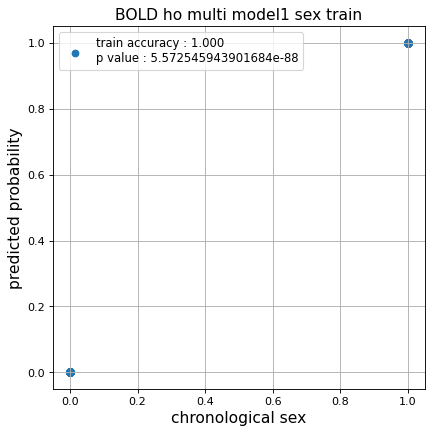

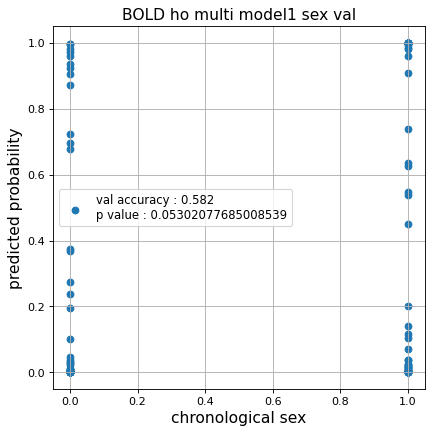

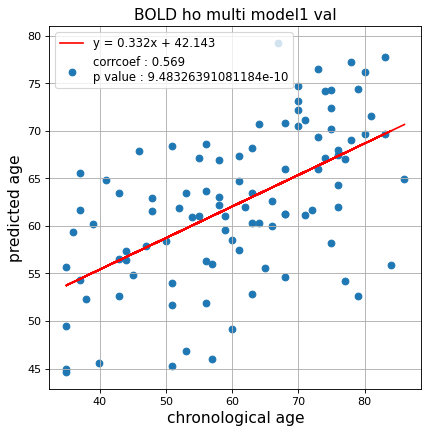

切片: 42.14342544734305
傾き: 0.331516551325048
Kfold: 5 ::: epoch: 100, loss: 0.04722045018122746, val loss: 0.8346313163638115
Kfold: 5 ::: epoch: 200, loss: 0.0183864592646177, val loss: 0.7613991126418114
Kfold: 5 ::: epoch: 300, loss: 0.01199463289231062, val loss: 0.7616764008998871
Kfold: 5 ::: epoch: 400, loss: 0.010431466051019155, val loss: 0.7371836230158806
Kfold: 5 ::: epoch: 500, loss: 0.007146314807379475, val loss: 0.7451813220977783
Kfold: 5 ::: epoch: 600, loss: 0.008386812566851195, val loss: 0.7428473979234695
Kfold: 5 ::: epoch: 700, loss: 0.007855107685407767, val loss: 0.729821190237999
Kfold: 5 ::: epoch: 800, loss: 0.004998758166598586, val loss: 0.7396636307239532
Kfold: 5 ::: epoch: 900, loss: 0.0052335492980021695, val loss: 0.7163792625069618
Kfold: 5 ::: epoch: 1000, loss: 0.004288136833705581, val loss: 0.7298582643270493
save_epochs:863
best val loss:0.7057165652513504


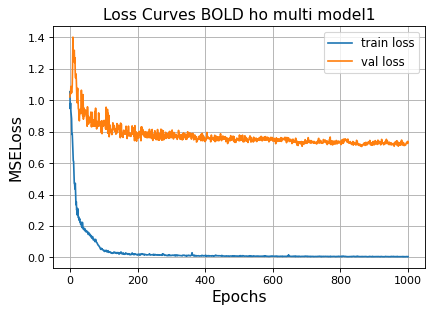

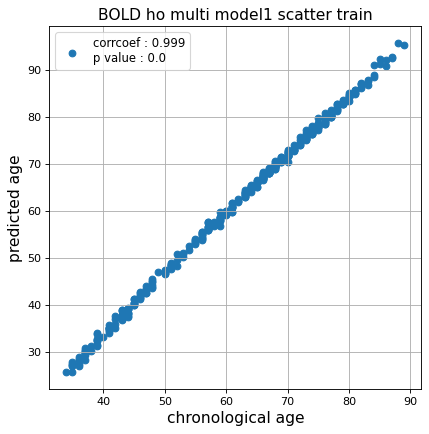

r^2 train data:  0.9273515106168235


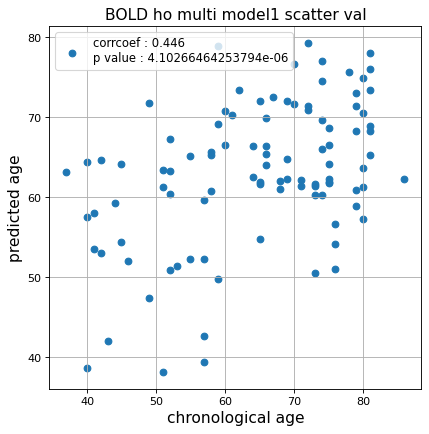

r^2 val data:  0.1177129216449252


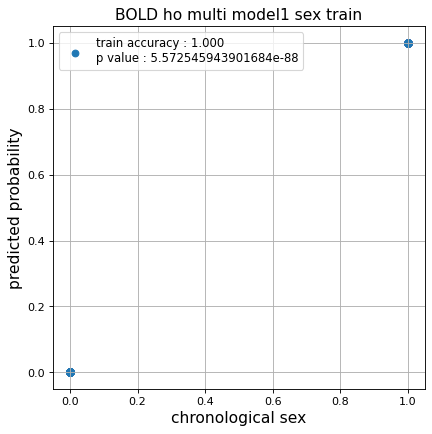

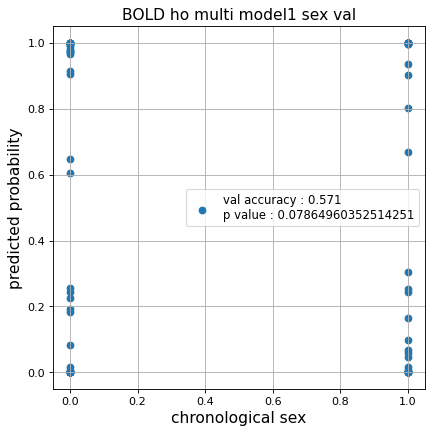

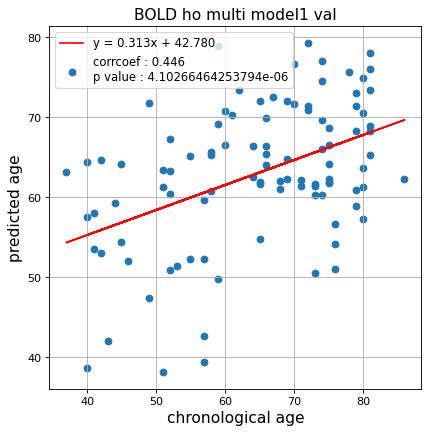

切片: 42.78000031764136
傾き: 0.3126558438417671
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03925784018177252, val loss: 0.5812925174832344
Kfold: 1 ::: epoch: 200, loss: 0.023581364908470556, val loss: 0.5621459484100342
Kfold: 1 ::: epoch: 300, loss: 0.014075524316957364, val loss: 0.5581375062465668
Kfold: 1 ::: epoch: 400, loss: 0.010902366063629206, val loss: 0.5677709802985191
Kfold: 1 ::: epoch: 500, loss: 0.008541673780060731, val loss: 0.5746373012661934
early stopping
save_epochs:390
best val loss:0.5439424701035023


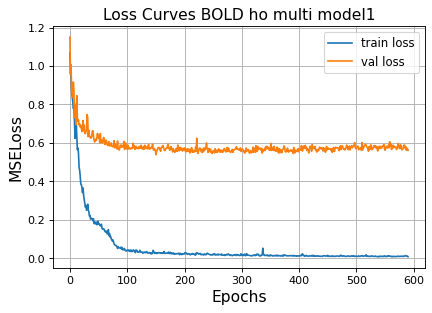

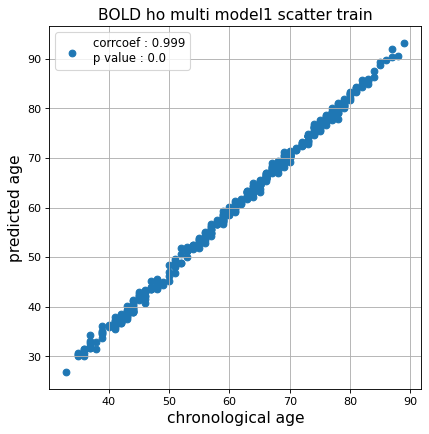

r^2 train data:  0.965303901869567


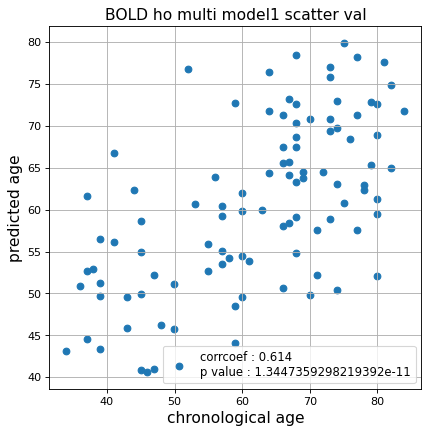

r^2 val data:  0.35433185595527605


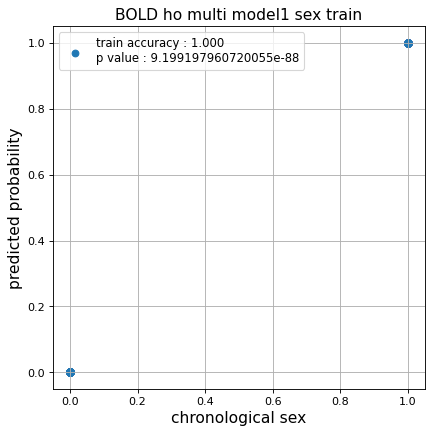

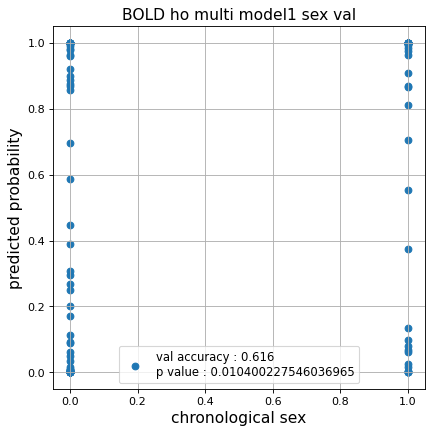

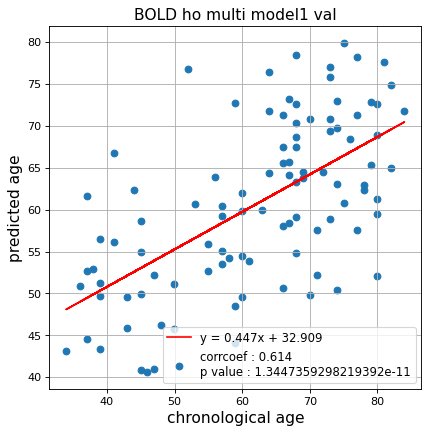

切片: 32.90884336947437
傾き: 0.44693354959520004
Kfold: 2 ::: epoch: 100, loss: 0.03903032753330011, val loss: 0.7914973646402359
Kfold: 2 ::: epoch: 200, loss: 0.01709845046011301, val loss: 0.7517433762550354
Kfold: 2 ::: epoch: 300, loss: 0.01504165747274573, val loss: 0.7450131252408028
Kfold: 2 ::: epoch: 400, loss: 0.009419662448076101, val loss: 0.744308739900589
Kfold: 2 ::: epoch: 500, loss: 0.008667646047587577, val loss: 0.7391936033964157
Kfold: 2 ::: epoch: 600, loss: 0.006778863366120136, val loss: 0.7038883715867996
Kfold: 2 ::: epoch: 700, loss: 0.0061697986764976615, val loss: 0.7041013836860657
Kfold: 2 ::: epoch: 800, loss: 0.005061861091794876, val loss: 0.7069690674543381
early stopping
save_epochs:653
best val loss:0.6691802591085434


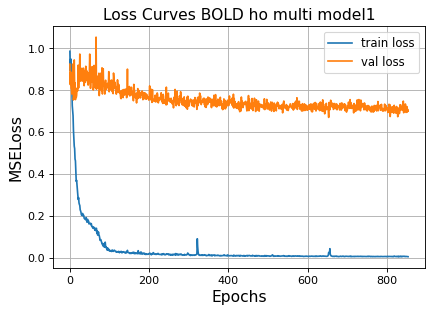

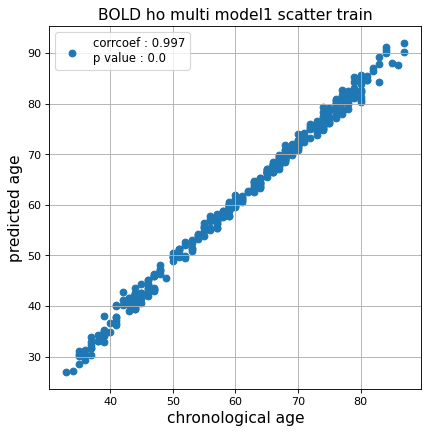

r^2 train data:  0.9592443038321026


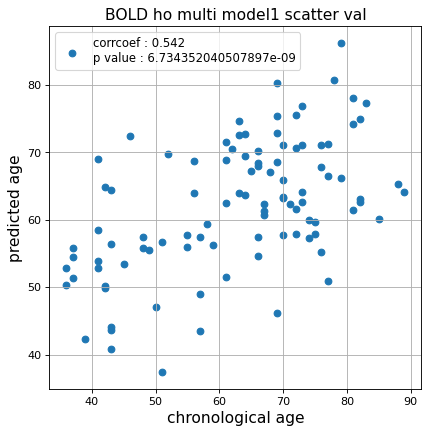

r^2 val data:  0.27149463427499154


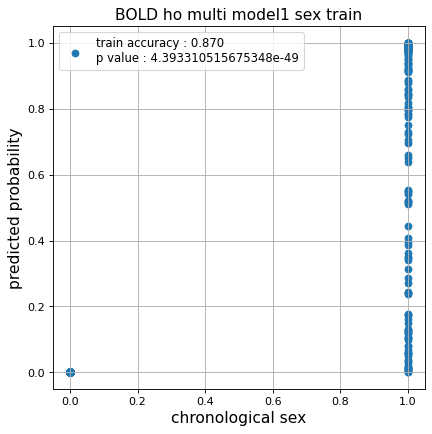

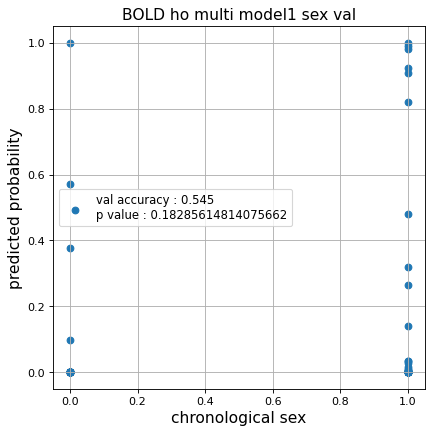

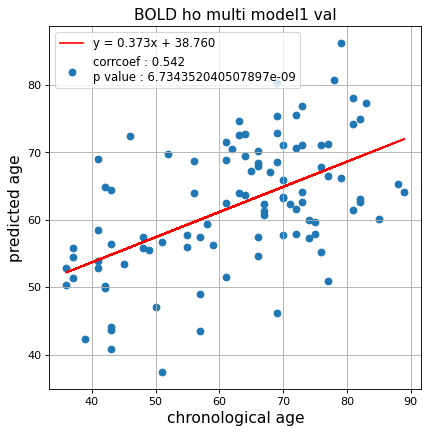

切片: 38.75950095927815
傾き: 0.37321028876458556
Kfold: 3 ::: epoch: 100, loss: 0.03519539721310139, val loss: 0.41759175434708595
Kfold: 3 ::: epoch: 200, loss: 0.018865954775649767, val loss: 0.428588580340147
Kfold: 3 ::: epoch: 300, loss: 0.01295301654877571, val loss: 0.4230054244399071
Kfold: 3 ::: epoch: 400, loss: 0.009411861224529834, val loss: 0.44271861761808395
early stopping
save_epochs:220
best val loss:0.41046561300754547


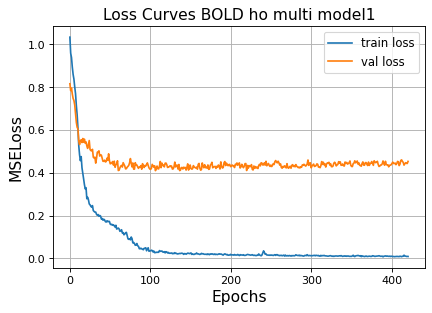

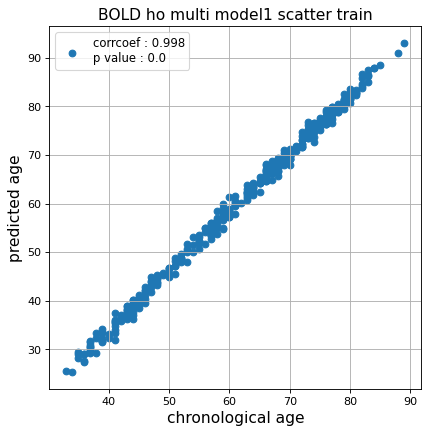

r^2 train data:  0.9423728549301083


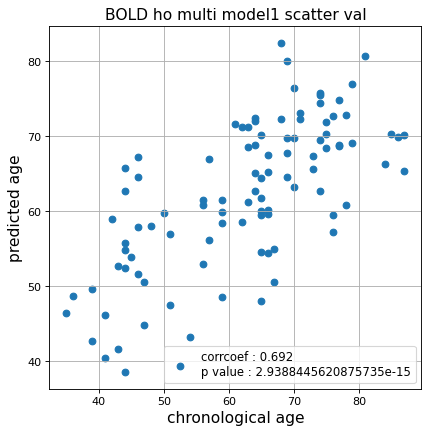

r^2 val data:  0.4762641042574386


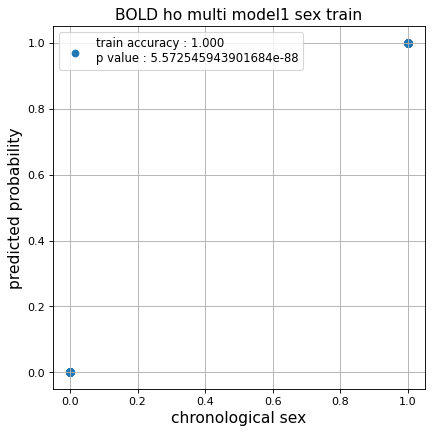

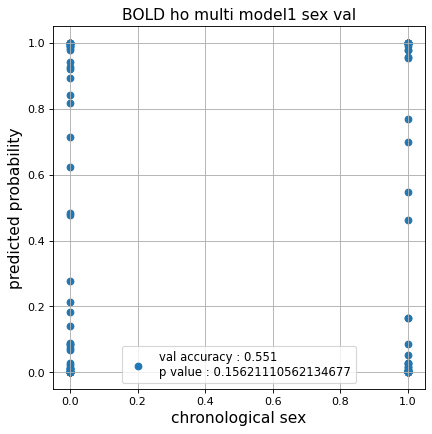

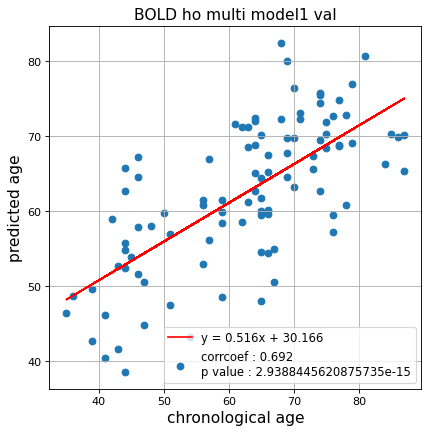

切片: 30.16627519699837
傾き: 0.5159981311527251
Kfold: 4 ::: epoch: 100, loss: 0.039277593103738934, val loss: 0.5550878494977951
Kfold: 4 ::: epoch: 200, loss: 0.017415003707775704, val loss: 0.4571315385401249
Kfold: 4 ::: epoch: 300, loss: 0.012387140439106869, val loss: 0.4454692043364048
Kfold: 4 ::: epoch: 400, loss: 0.009473427771948852, val loss: 0.4375547170639038
Kfold: 4 ::: epoch: 500, loss: 0.010515995932599673, val loss: 0.42725028097629547
Kfold: 4 ::: epoch: 600, loss: 0.007175438607541414, val loss: 0.4054867699742317
Kfold: 4 ::: epoch: 700, loss: 0.006213673838199331, val loss: 0.4082596004009247
Kfold: 4 ::: epoch: 800, loss: 0.006688849284098699, val loss: 0.40480611473321915
Kfold: 4 ::: epoch: 900, loss: 0.005372578134903541, val loss: 0.40841081738471985
early stopping
save_epochs:769
best val loss:0.39220481738448143


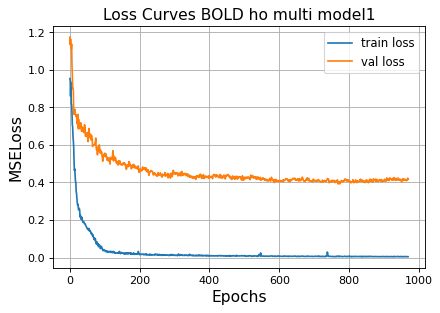

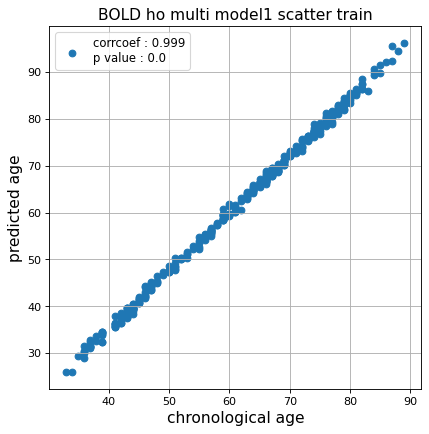

r^2 train data:  0.941577230059657


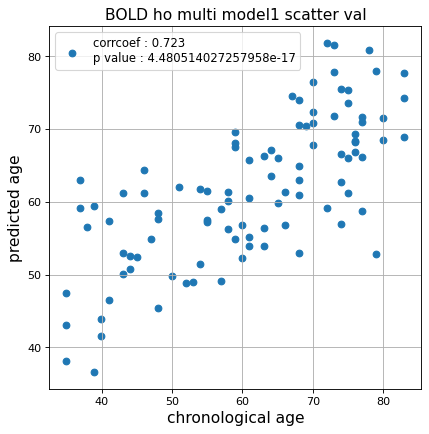

r^2 val data:  0.5207822907966728


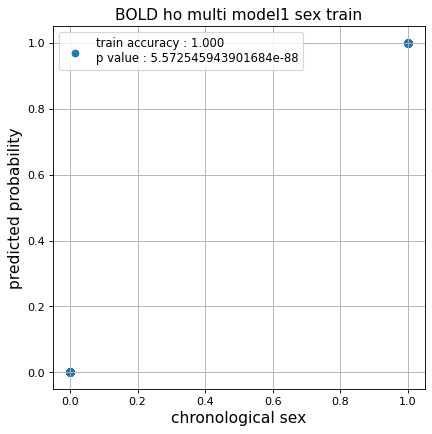

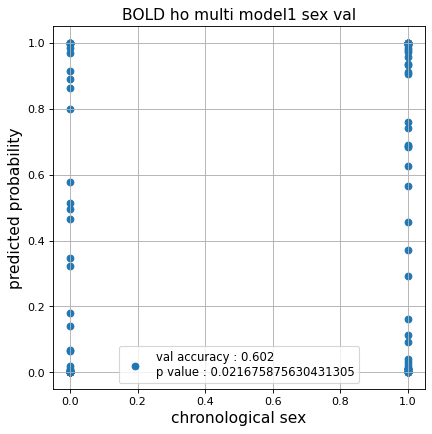

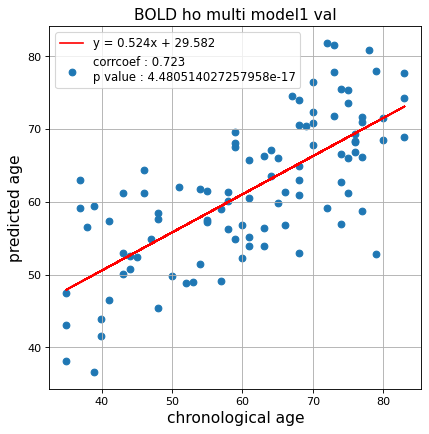

切片: 29.581952815350057
傾き: 0.5241315953768501
Kfold: 5 ::: epoch: 100, loss: 0.05211914531313456, val loss: 0.9954557567834854
Kfold: 5 ::: epoch: 200, loss: 0.018512221984565258, val loss: 1.0214866250753403
Kfold: 5 ::: epoch: 300, loss: 0.013396110528936753, val loss: 1.0137038379907608
Kfold: 5 ::: epoch: 400, loss: 0.009504860589424005, val loss: 1.0049648135900497
Kfold: 5 ::: epoch: 500, loss: 0.008014684901214562, val loss: 0.9265185296535492
Kfold: 5 ::: epoch: 600, loss: 0.007169204459597285, val loss: 0.9498497247695923
Kfold: 5 ::: epoch: 700, loss: 0.006154167824066603, val loss: 0.933570608496666
Kfold: 5 ::: epoch: 800, loss: 0.005458519865687077, val loss: 0.9451414197683334
early stopping
save_epochs:685
best val loss:0.8741158545017242


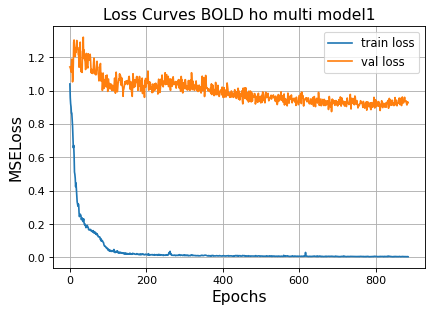

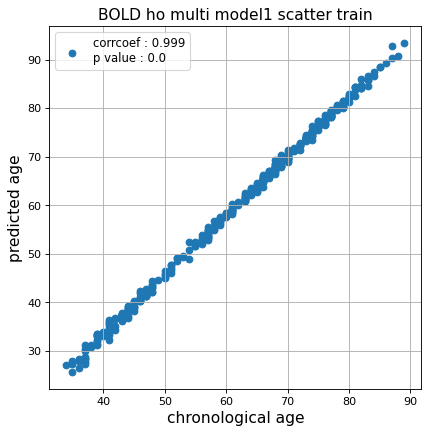

r^2 train data:  0.9325791810285575


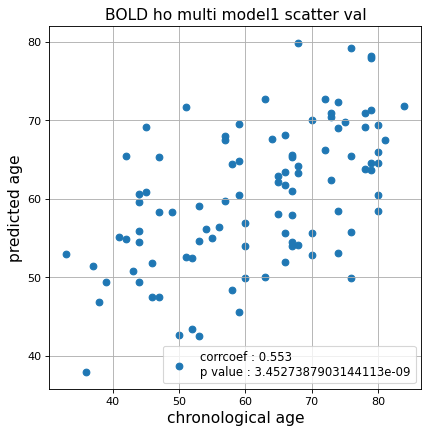

r^2 val data:  0.27814976800052393


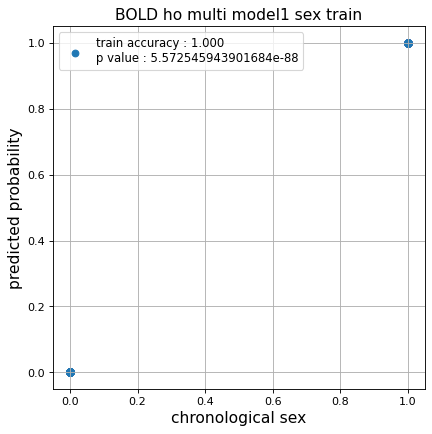

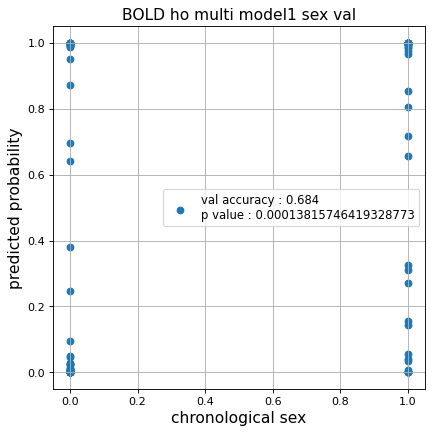

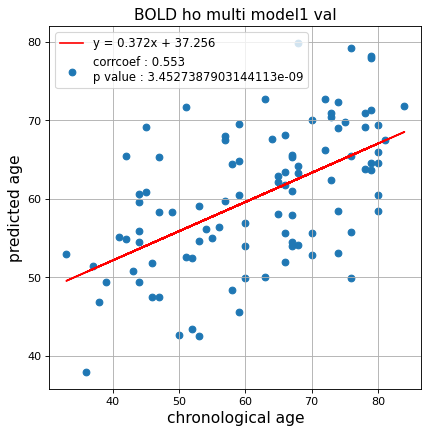

切片: 37.25579280843421
傾き: 0.3723395801821619
CPU times: user 1h 50min 28s, sys: 15min 24s, total: 2h 5min 52s
Wall time: 2h 6min 4s


In [25]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_1  = []
test_pred_ho_corrected_1  = []
test_label_ho_1 = []
test_idx_ho_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 256,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 1024,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.2,
                                                           fc_drop = 0.1,
                                                           title = 'ROI ho multi model1'
                                                          )
    
    test_pred_ho_1.append(test_pred)
    test_pred_ho_corrected_1.append(test_pred_corrected)
    test_label_ho_1.append(test_label)
    test_idx_ho_1.append(test_idx)

### ROI 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.14672482128326708, val loss: 0.7538908794522285
Kfold: 1 ::: epoch: 200, loss: 0.046926561886301406, val loss: 0.682807058095932
Kfold: 1 ::: epoch: 300, loss: 0.02114801244953504, val loss: 0.6571581363677979
Kfold: 1 ::: epoch: 400, loss: 0.01661857905296179, val loss: 0.6162846647202969
Kfold: 1 ::: epoch: 500, loss: 0.013782866155871978, val loss: 0.6169158294796944
Kfold: 1 ::: epoch: 600, loss: 0.011539341846051125, val loss: 0.594503290951252
Kfold: 1 ::: epoch: 700, loss: 0.00903726641375285, val loss: 0.5930323116481304
Kfold: 1 ::: epoch: 800, loss: 0.009056075977591367, val loss: 0.5799474120140076
Kfold: 1 ::: epoch: 900, loss: 0.009293412503141623, val loss: 0.5780777484178543
Kfold: 1 ::: epoch: 1000, loss: 0.006476364492510374, val loss: 0.5490584224462509
save_epochs:994
best val loss:0.5428289584815502


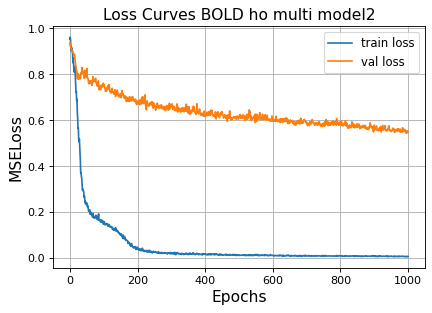

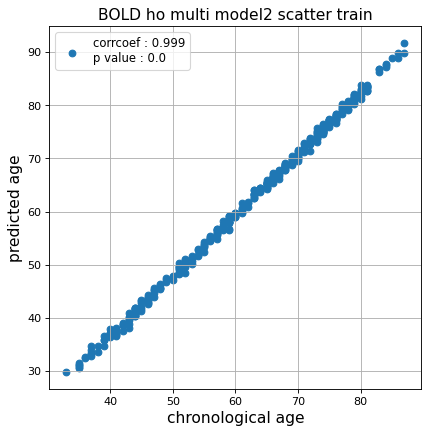

r^2 train data:  0.9767940079246425


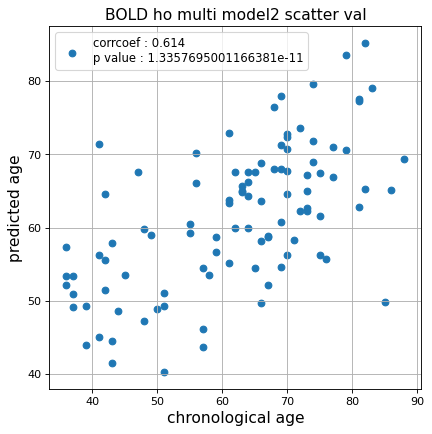

r^2 val data:  0.3681432835229802


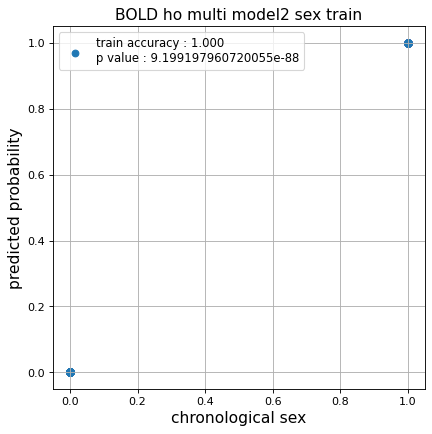

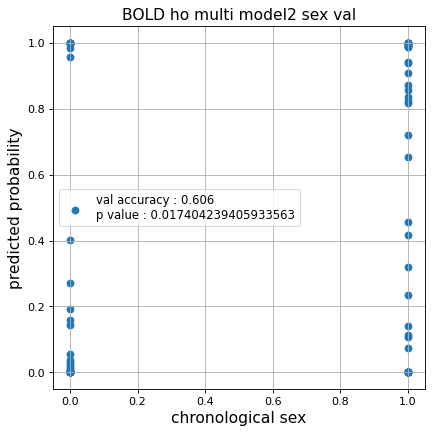

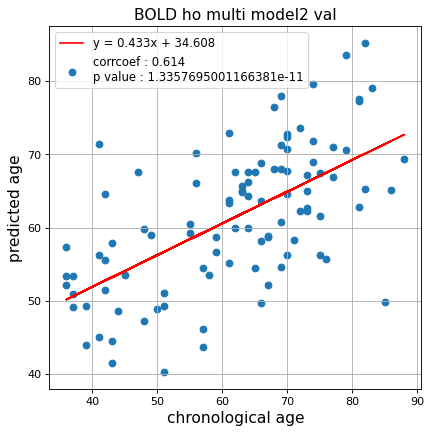

切片: 34.607800549861004
傾き: 0.43268734216511523
Kfold: 2 ::: epoch: 100, loss: 0.16314071416854858, val loss: 0.6584815680980682
Kfold: 2 ::: epoch: 200, loss: 0.032947481538240724, val loss: 0.7138450592756271
Kfold: 2 ::: epoch: 300, loss: 0.02088315297777836, val loss: 0.7310838103294373
Kfold: 2 ::: epoch: 400, loss: 0.015823662639237367, val loss: 0.7016407698392868
early stopping
save_epochs:254
best val loss:0.6609767228364944


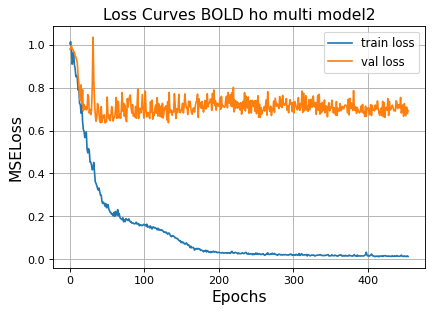

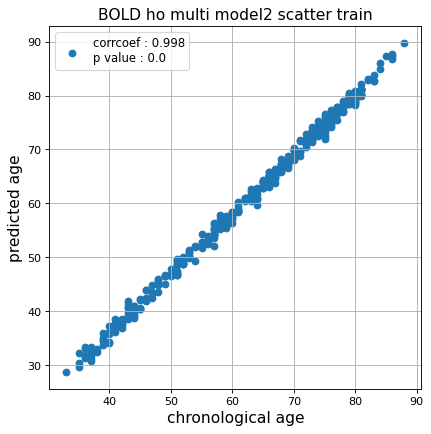

r^2 train data:  0.9685759928714418


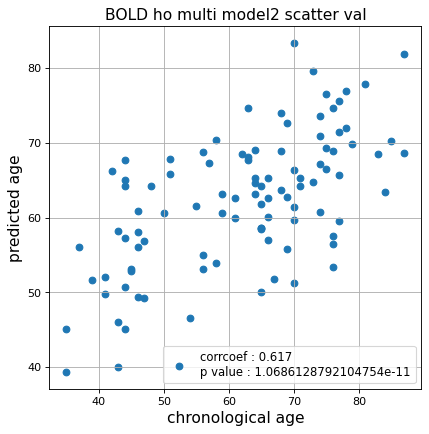

r^2 val data:  0.377555243184161


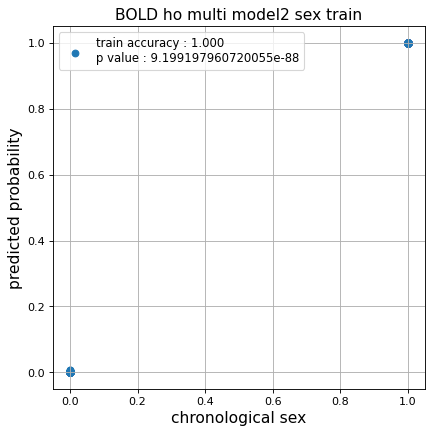

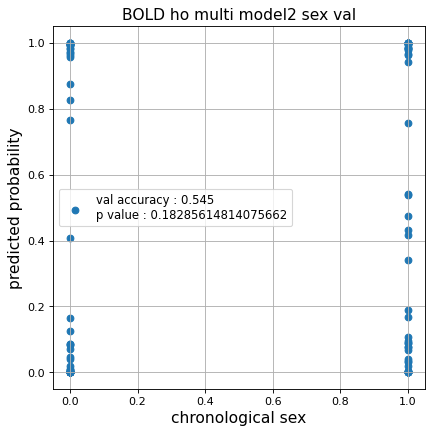

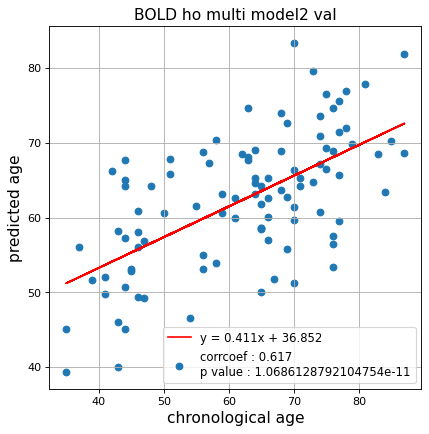

切片: 36.85188376847317
傾き: 0.4108541535890055
Kfold: 3 ::: epoch: 100, loss: 0.1544702179156817, val loss: 1.1712862104177475
Kfold: 3 ::: epoch: 200, loss: 0.03062776318536355, val loss: 1.0293669998645782
Kfold: 3 ::: epoch: 300, loss: 0.0202203059855562, val loss: 0.9173208028078079
Kfold: 3 ::: epoch: 400, loss: 0.015141787401472147, val loss: 0.8612965941429138
Kfold: 3 ::: epoch: 500, loss: 0.013706630203299798, val loss: 0.8341961205005646
Kfold: 3 ::: epoch: 600, loss: 0.010705972376924295, val loss: 0.749052569270134
Kfold: 3 ::: epoch: 700, loss: 0.00945123926234933, val loss: 0.7745196521282196
Kfold: 3 ::: epoch: 800, loss: 0.007589874215997183, val loss: 0.716681107878685
Kfold: 3 ::: epoch: 900, loss: 0.00692508566694764, val loss: 0.6971166580915451
Kfold: 3 ::: epoch: 1000, loss: 0.006449659784825949, val loss: 0.6694728285074234
save_epochs:954
best val loss:0.6552386730909348


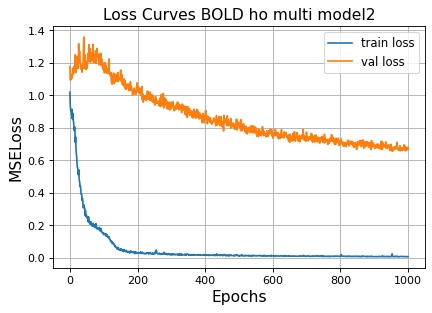

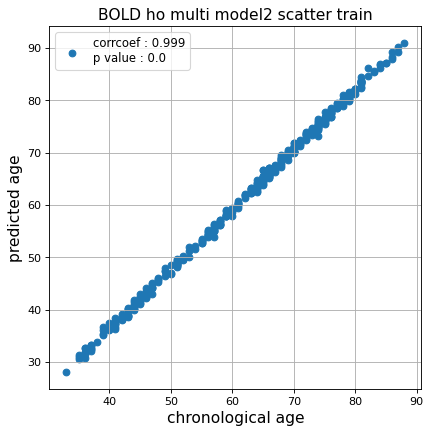

r^2 train data:  0.9759697631958976


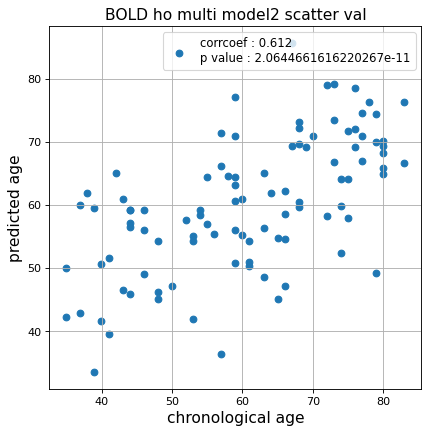

r^2 val data:  0.34524841593858724


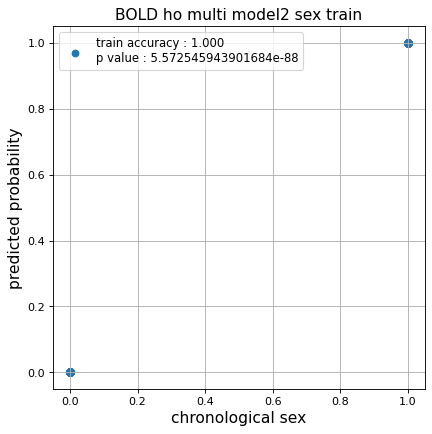

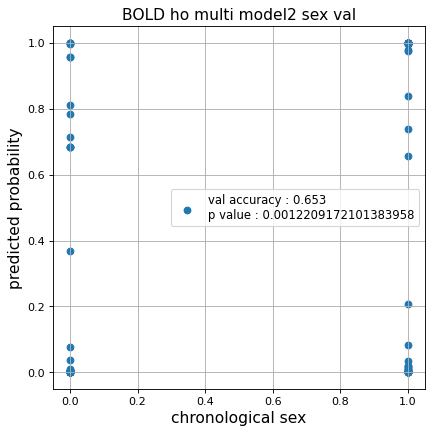

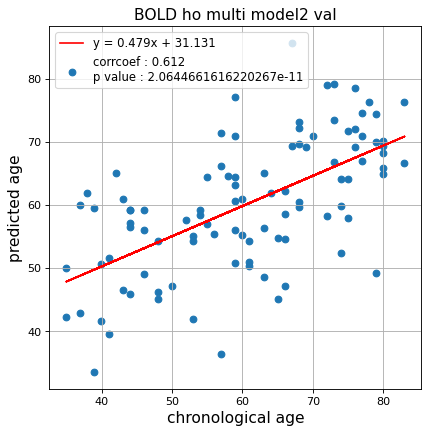

切片: 31.131472193019516
傾き: 0.47860796470528455
Kfold: 4 ::: epoch: 100, loss: 0.16980725297561058, val loss: 1.030378520488739
Kfold: 4 ::: epoch: 200, loss: 0.03472444071219517, val loss: 0.9670009911060333
Kfold: 4 ::: epoch: 300, loss: 0.02026462547767621, val loss: 1.0108734220266342
Kfold: 4 ::: epoch: 400, loss: 0.017328146415261123, val loss: 1.0475942492485046
early stopping
save_epochs:207
best val loss:0.9458569437265396


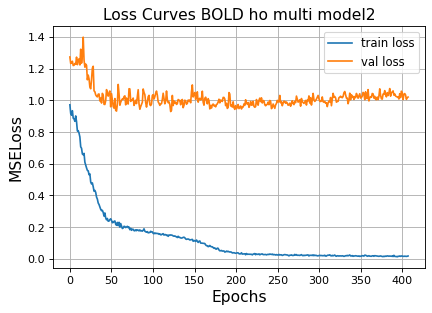

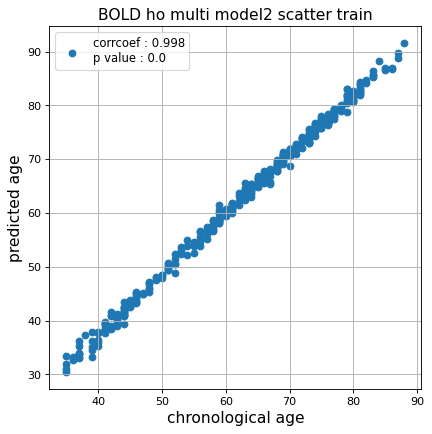

r^2 train data:  0.9822240307758676


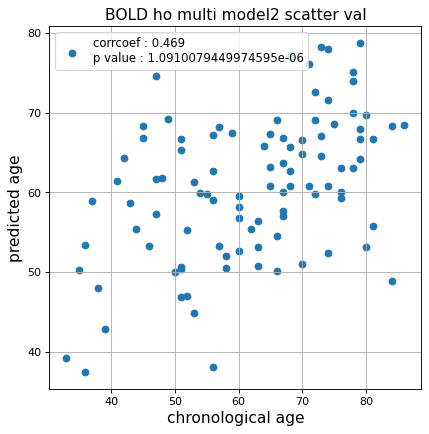

r^2 val data:  0.16714025494922236


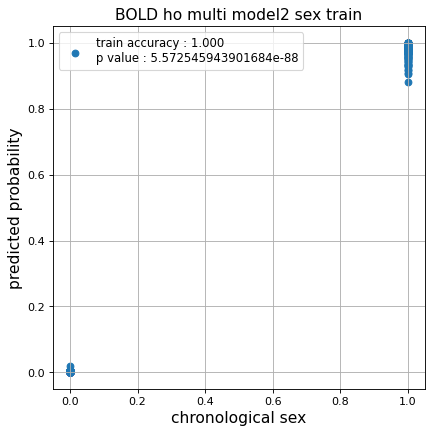

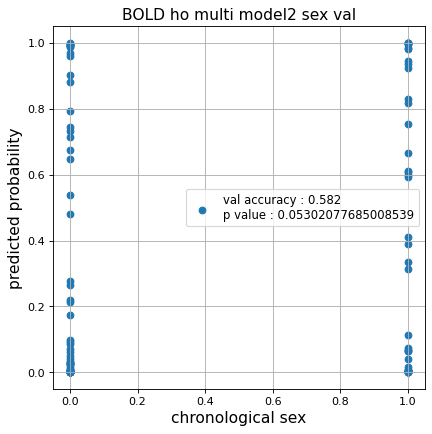

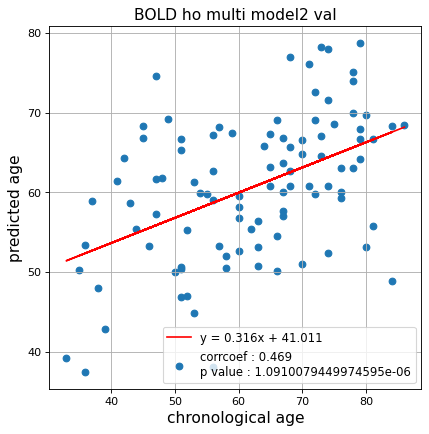

切片: 41.01137443387803
傾き: 0.3159537378014756
Kfold: 5 ::: epoch: 100, loss: 0.15815961475555712, val loss: 1.233994483947754
Kfold: 5 ::: epoch: 200, loss: 0.03734284266829491, val loss: 1.2039785832166672
Kfold: 5 ::: epoch: 300, loss: 0.02185104278704295, val loss: 1.0765940099954605
Kfold: 5 ::: epoch: 400, loss: 0.016117395331653264, val loss: 1.0150949656963348
Kfold: 5 ::: epoch: 500, loss: 0.01347146168924295, val loss: 0.979397639632225
Kfold: 5 ::: epoch: 600, loss: 0.009772060833011683, val loss: 0.9439436197280884
Kfold: 5 ::: epoch: 700, loss: 0.008850070164323999, val loss: 0.9228657931089401
Kfold: 5 ::: epoch: 800, loss: 0.00795091473712371, val loss: 0.9223983734846115
Kfold: 5 ::: epoch: 900, loss: 0.007340261676850228, val loss: 0.8820246011018753
Kfold: 5 ::: epoch: 1000, loss: 0.007044381103836573, val loss: 0.872872605919838
save_epochs:924
best val loss:0.8485136777162552


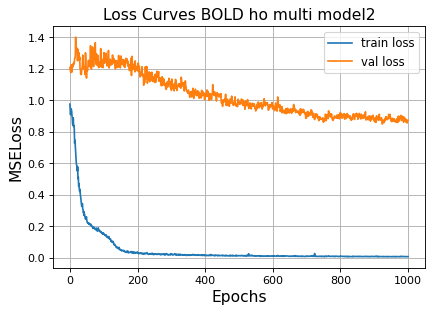

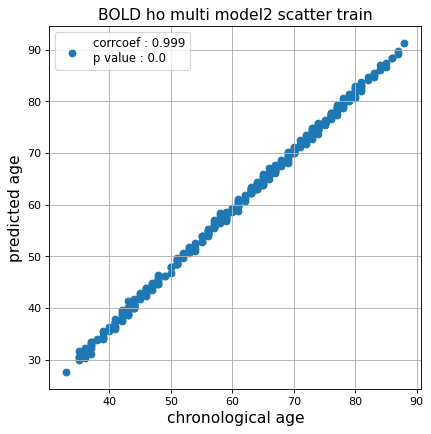

r^2 train data:  0.9753645648159772


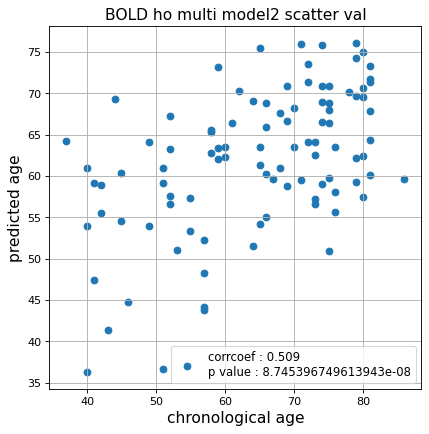

r^2 val data:  0.1907005422999476


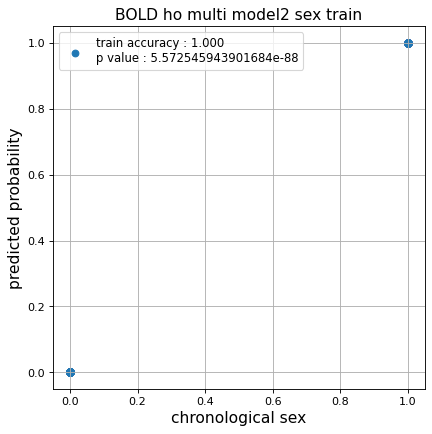

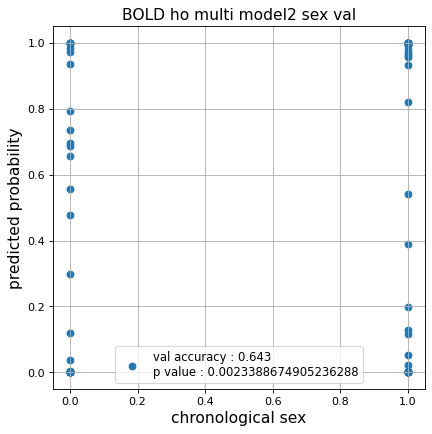

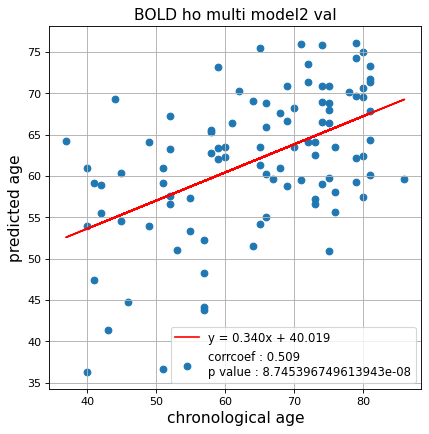

切片: 40.01930273644967
傾き: 0.340114076634801
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.1465998928134258, val loss: 0.7639052048325539
Kfold: 1 ::: epoch: 200, loss: 0.04151630401611328, val loss: 0.7114667408168316
Kfold: 1 ::: epoch: 300, loss: 0.021357199893547937, val loss: 0.6498422976583242
Kfold: 1 ::: epoch: 400, loss: 0.017249981227975626, val loss: 0.5814739279448986
Kfold: 1 ::: epoch: 500, loss: 0.012501679002665557, val loss: 0.5836531892418861
Kfold: 1 ::: epoch: 600, loss: 0.01403401827869507, val loss: 0.5480725737288594
Kfold: 1 ::: epoch: 700, loss: 0.010394844477279829, val loss: 0.542250894010067
Kfold: 1 ::: epoch: 800, loss: 0.009482528011386212, val loss: 0.5229404643177986
Kfold: 1 ::: epoch: 900, loss: 0.00845989932377751, val loss: 0.5156804909929633
Kfold: 1 ::: epoch: 1000, loss: 0.006183996975708466, val loss: 0.4995950497686863
save_epochs:979
best val loss:0.4900249931961298


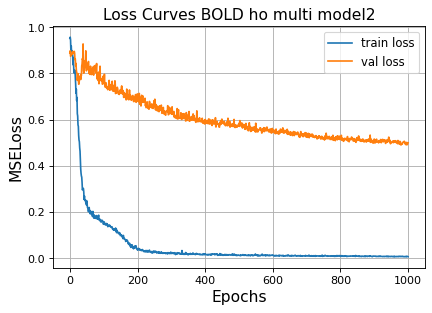

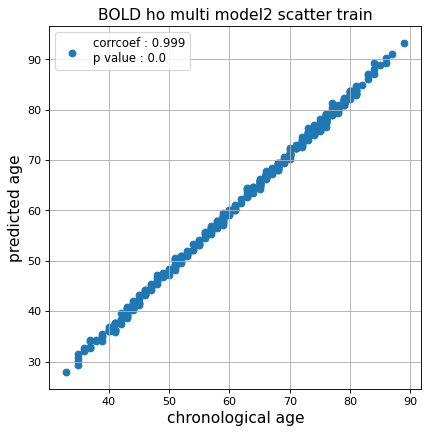

r^2 train data:  0.9718812970238276


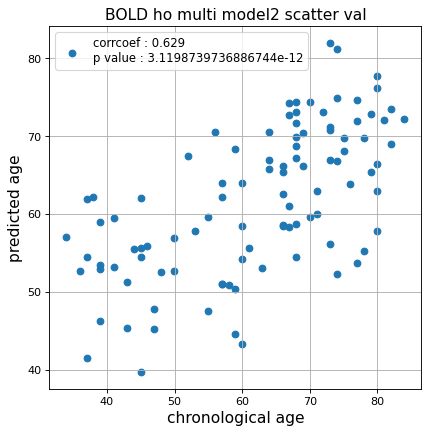

r^2 val data:  0.3915129257031167


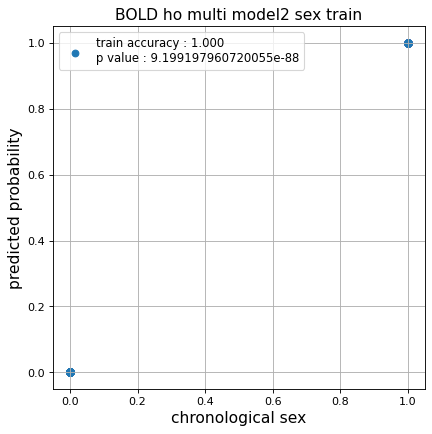

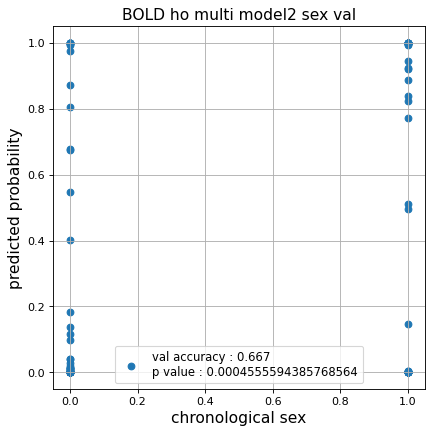

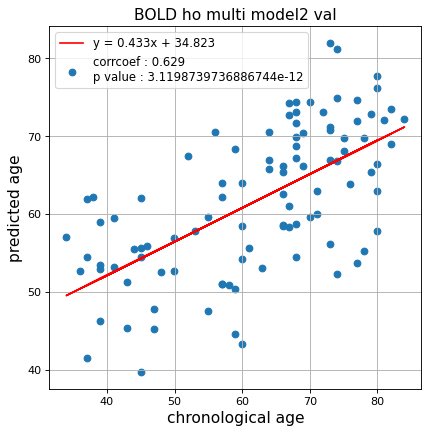

切片: 34.82348290651998
傾き: 0.4327819065035817
Kfold: 2 ::: epoch: 100, loss: 0.16136056184768677, val loss: 0.9275753498077393
Kfold: 2 ::: epoch: 200, loss: 0.028889110813347194, val loss: 0.9743847399950027
Kfold: 2 ::: epoch: 300, loss: 0.02049497249894417, val loss: 1.0080360919237137
Kfold: 2 ::: epoch: 400, loss: 0.015424736703817662, val loss: 0.9060445874929428
Kfold: 2 ::: epoch: 500, loss: 0.013883781691010181, val loss: 0.9124139696359634
Kfold: 2 ::: epoch: 600, loss: 0.015746003625771172, val loss: 0.9591576904058456
Kfold: 2 ::: epoch: 700, loss: 0.010101586042975005, val loss: 0.8758618086576462
Kfold: 2 ::: epoch: 800, loss: 0.006934350392279716, val loss: 0.8913494646549225
Kfold: 2 ::: epoch: 900, loss: 0.007728667034266086, val loss: 0.9025368392467499
Kfold: 2 ::: epoch: 1000, loss: 0.007208284438372805, val loss: 0.8726077079772949
save_epochs:962
best val loss:0.8124269023537636


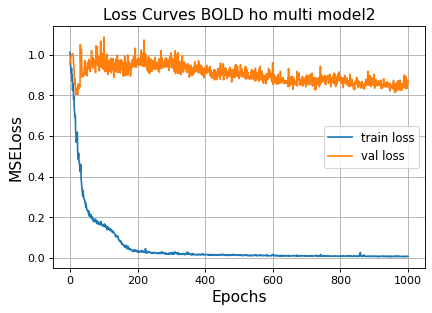

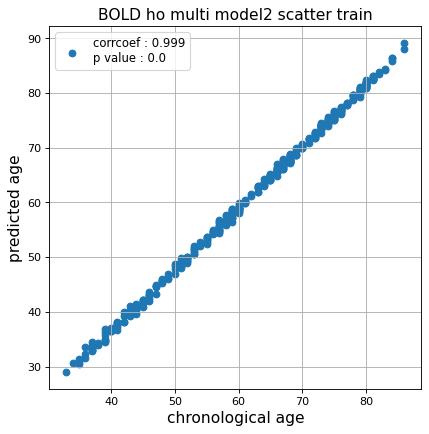

r^2 train data:  0.9801081355908627


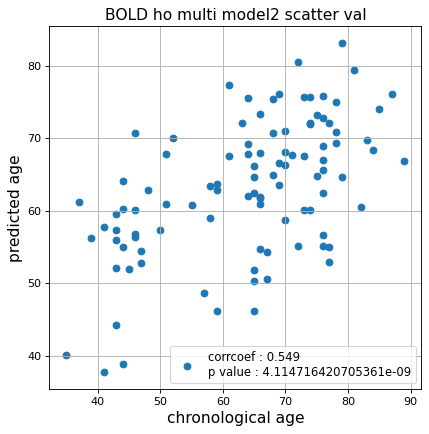

r^2 val data:  0.2759526779193797


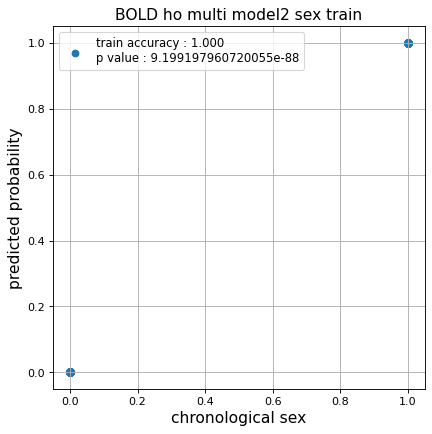

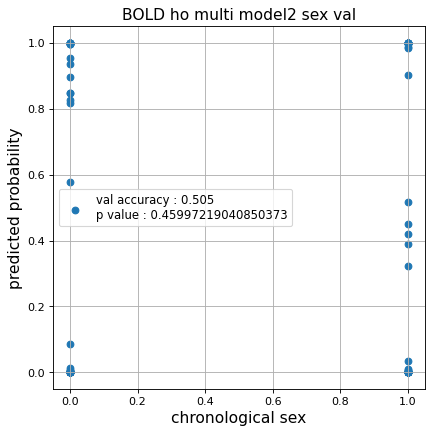

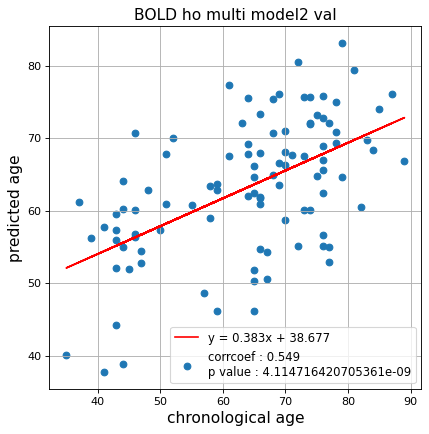

切片: 38.677028377598916
傾き: 0.3834274633407694
Kfold: 3 ::: epoch: 100, loss: 0.1595620558812068, val loss: 0.9822192490100861
Kfold: 3 ::: epoch: 200, loss: 0.03575775242195679, val loss: 0.8959202915430069
Kfold: 3 ::: epoch: 300, loss: 0.025964492215560034, val loss: 0.916624128818512
Kfold: 3 ::: epoch: 400, loss: 0.02050316434067029, val loss: 0.8782285749912262
Kfold: 3 ::: epoch: 500, loss: 0.012546019557003792, val loss: 0.8270813971757889
Kfold: 3 ::: epoch: 600, loss: 0.011192593150413953, val loss: 0.8097913265228271
Kfold: 3 ::: epoch: 700, loss: 0.008075893820764927, val loss: 0.8194533586502075
Kfold: 3 ::: epoch: 800, loss: 0.0078073164018300865, val loss: 0.7905535995960236
Kfold: 3 ::: epoch: 900, loss: 0.009703476304331651, val loss: 0.781450979411602
early stopping
save_epochs:766
best val loss:0.7654245793819427


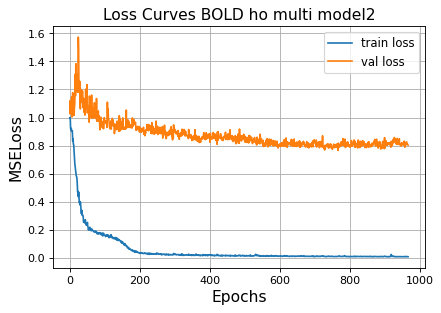

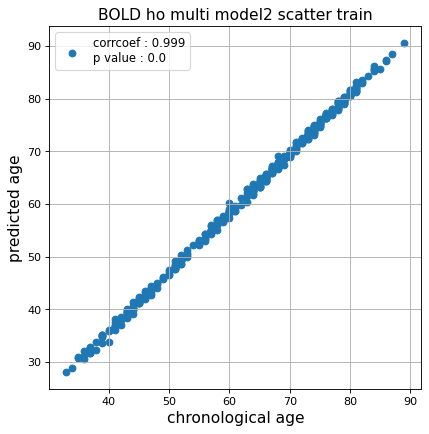

r^2 train data:  0.9734179655939783


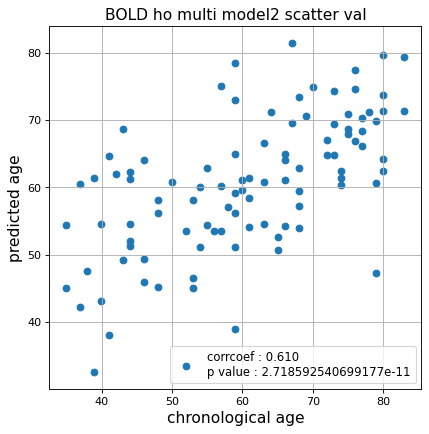

r^2 val data:  0.3546601596877432


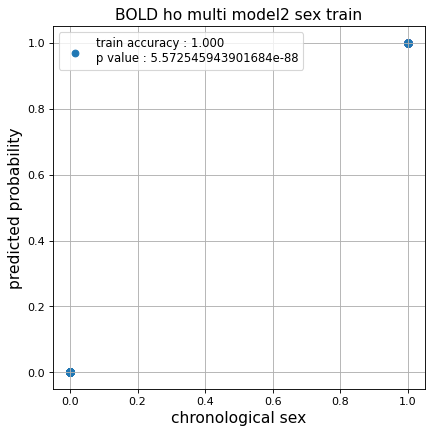

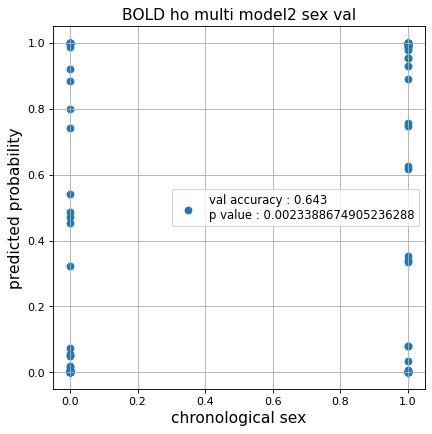

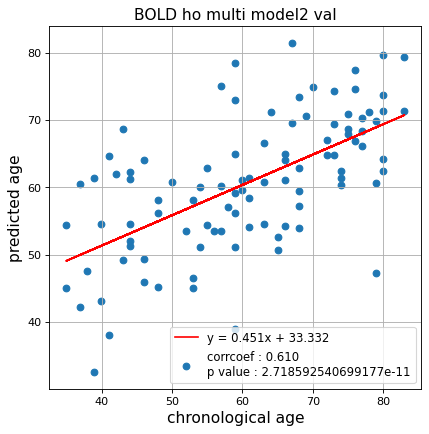

切片: 33.33172811058223
傾き: 0.4507666938340166
Kfold: 4 ::: epoch: 100, loss: 0.1552295025724631, val loss: 1.1411834955215454
Kfold: 4 ::: epoch: 200, loss: 0.03724119009879919, val loss: 1.0928923189640045
Kfold: 4 ::: epoch: 300, loss: 0.022647863970353052, val loss: 1.1523535251617432
Kfold: 4 ::: epoch: 400, loss: 0.019433449810514085, val loss: 1.0648067146539688
early stopping
save_epochs:205
best val loss:1.0539085566997528


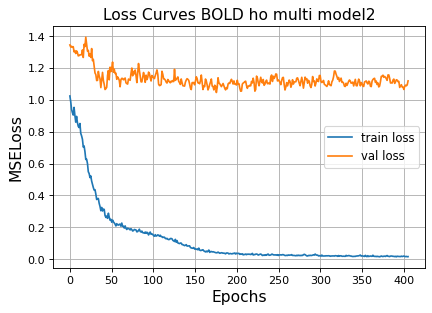

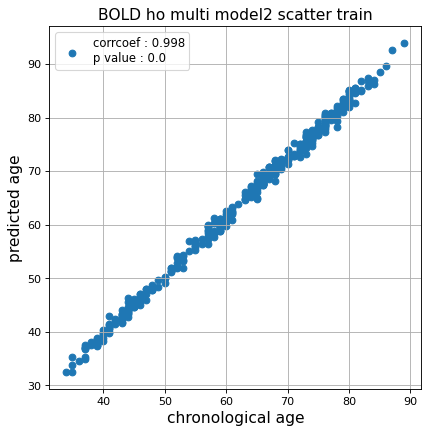

r^2 train data:  0.9689848922673531


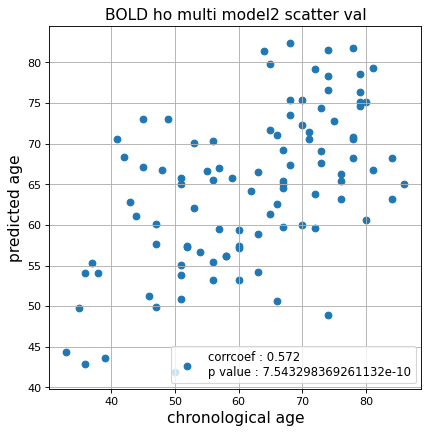

r^2 val data:  0.27437940167754526


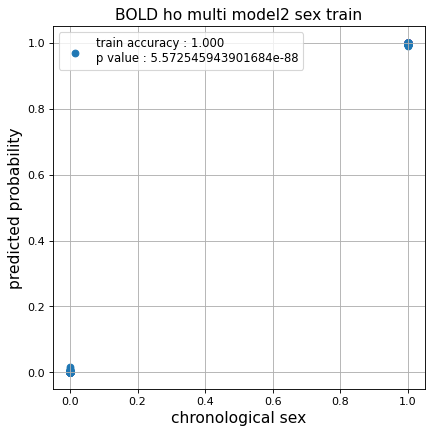

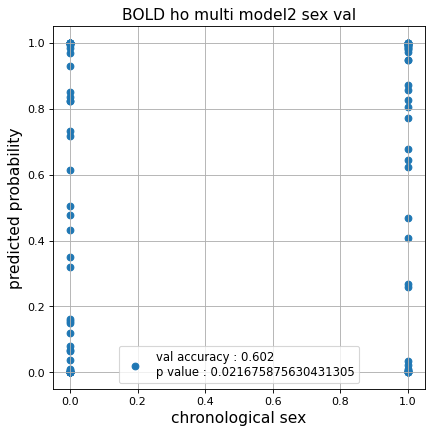

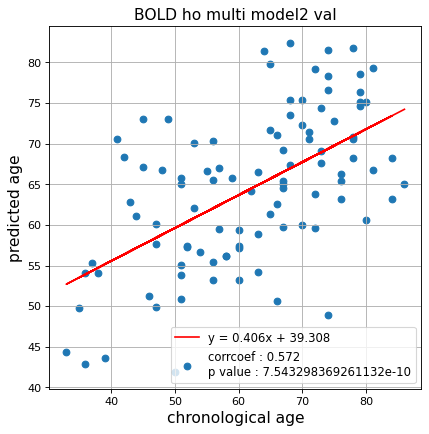

切片: 39.307912912662246
傾き: 0.4059991279963141
Kfold: 5 ::: epoch: 100, loss: 0.17000407782884744, val loss: 0.8186610341072083
Kfold: 5 ::: epoch: 200, loss: 0.03065000746685725, val loss: 0.8014621660113335
Kfold: 5 ::: epoch: 300, loss: 0.019140010269788597, val loss: 0.7270887494087219
Kfold: 5 ::: epoch: 400, loss: 0.016397439086666472, val loss: 0.6779644172638655
Kfold: 5 ::: epoch: 500, loss: 0.010868960382560125, val loss: 0.6691243164241314
Kfold: 5 ::: epoch: 600, loss: 0.009559910529508041, val loss: 0.650572219863534
Kfold: 5 ::: epoch: 700, loss: 0.008592644634728249, val loss: 0.651795569807291
Kfold: 5 ::: epoch: 800, loss: 0.008421616772046456, val loss: 0.6413944344967604
Kfold: 5 ::: epoch: 900, loss: 0.008600907400250435, val loss: 0.636477142572403
Kfold: 5 ::: epoch: 1000, loss: 0.008845075248525692, val loss: 0.6457723509520292
save_epochs:881
best val loss:0.6280020074918866


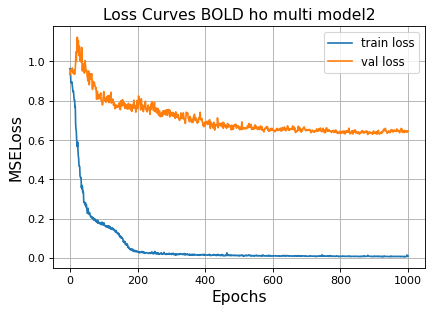

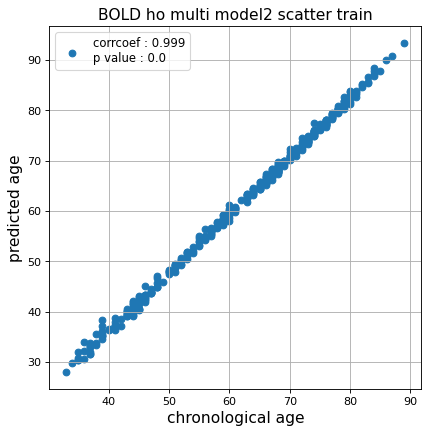

r^2 train data:  0.9738447465394591


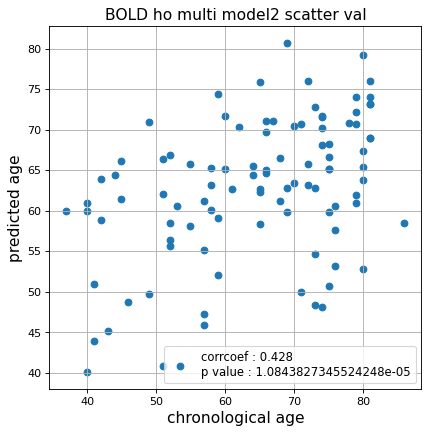

r^2 val data:  0.10321740130635648


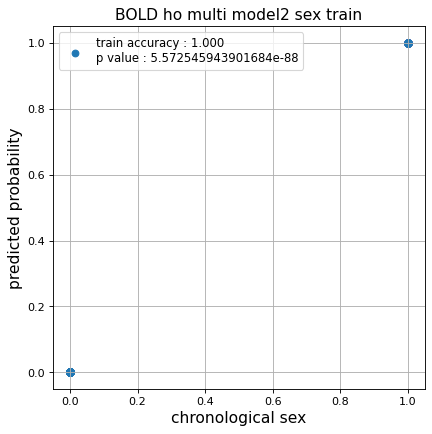

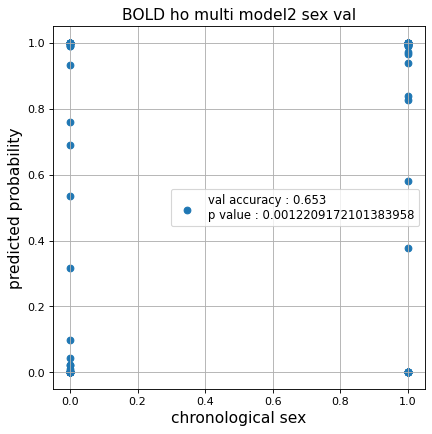

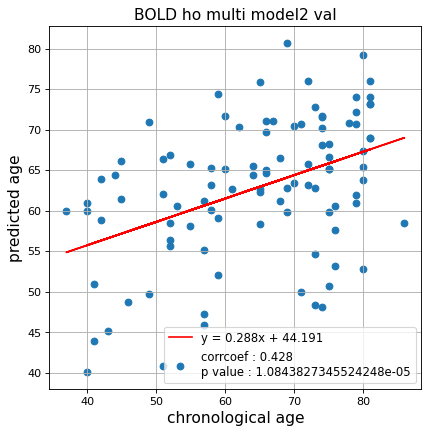

切片: 44.19082766866382
傾き: 0.2884505291245593
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.1516960458113597, val loss: 0.7693087160587311
Kfold: 1 ::: epoch: 200, loss: 0.04556191254120607, val loss: 0.6598136126995087
Kfold: 1 ::: epoch: 300, loss: 0.019612300352981456, val loss: 0.6221925094723701
Kfold: 1 ::: epoch: 400, loss: 0.019368905359162733, val loss: 0.5989890396595001
Kfold: 1 ::: epoch: 500, loss: 0.013602512387128977, val loss: 0.5736590679734945
Kfold: 1 ::: epoch: 600, loss: 0.012198551701238522, val loss: 0.5538456048816442
Kfold: 1 ::: epoch: 700, loss: 0.013168110619657315, val loss: 0.5476364511996508
Kfold: 1 ::: epoch: 800, loss: 0.009838346356096176, val loss: 0.5399187803268433
Kfold: 1 ::: epoch: 900, loss: 0.007495355971444111, val loss: 0.5269663538783789
Kfold: 1 ::: epoch: 1000, loss: 0.00752310286490963, val loss: 0.5298291612416506
save_epochs:992
best val loss:0.5146931549534202


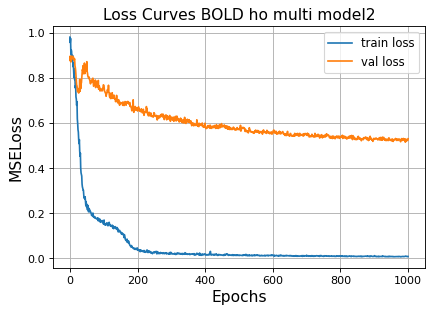

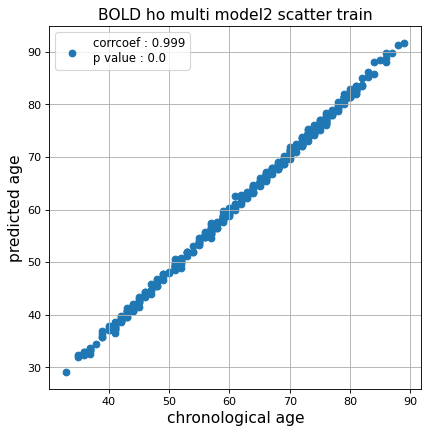

r^2 train data:  0.9827118244647844


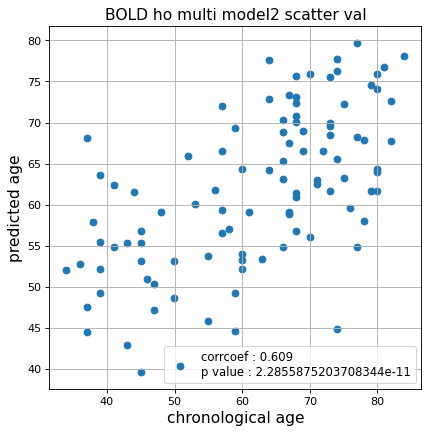

r^2 val data:  0.3646669904554929


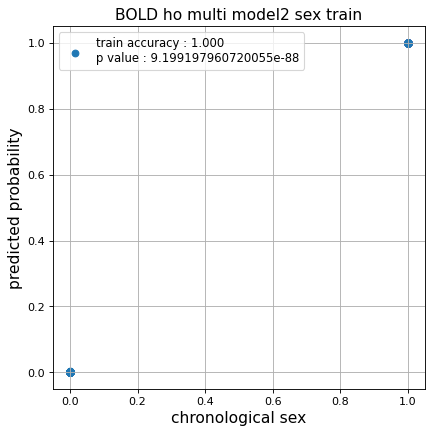

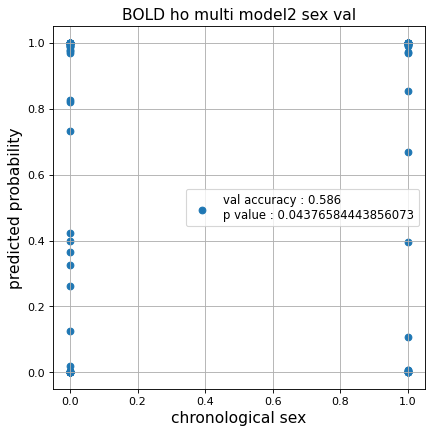

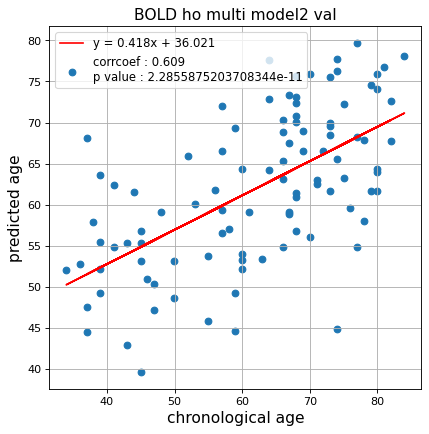

切片: 36.020985733723535
傾き: 0.41809174325294346
Kfold: 2 ::: epoch: 100, loss: 0.1605982528283046, val loss: 1.0946424007415771
Kfold: 2 ::: epoch: 200, loss: 0.030553706778356664, val loss: 0.9598743766546249
Kfold: 2 ::: epoch: 300, loss: 0.020442850386294033, val loss: 0.876077264547348
Kfold: 2 ::: epoch: 400, loss: 0.01463606495123643, val loss: 0.813126266002655
Kfold: 2 ::: epoch: 500, loss: 0.015161766993025174, val loss: 0.7807446718215942
Kfold: 2 ::: epoch: 600, loss: 0.012071670247958256, val loss: 0.7208500429987907
Kfold: 2 ::: epoch: 700, loss: 0.009049785001060138, val loss: 0.7117479741573334
Kfold: 2 ::: epoch: 800, loss: 0.008727284148335457, val loss: 0.6912500634789467
Kfold: 2 ::: epoch: 900, loss: 0.009483166934492497, val loss: 0.6837164163589478
Kfold: 2 ::: epoch: 1000, loss: 0.0062578290056150695, val loss: 0.6713021993637085
save_epochs:997
best val loss:0.6596892327070236


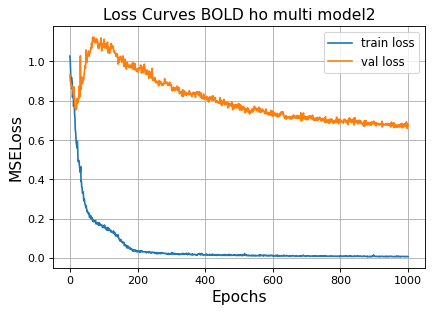

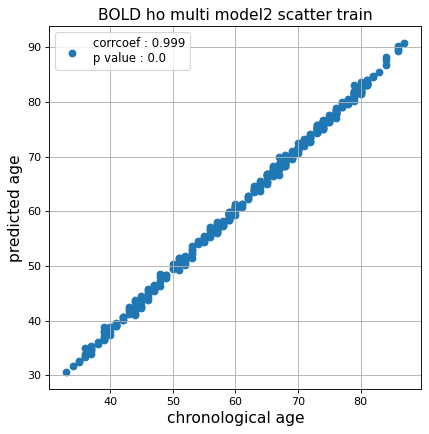

r^2 train data:  0.9840360734970153


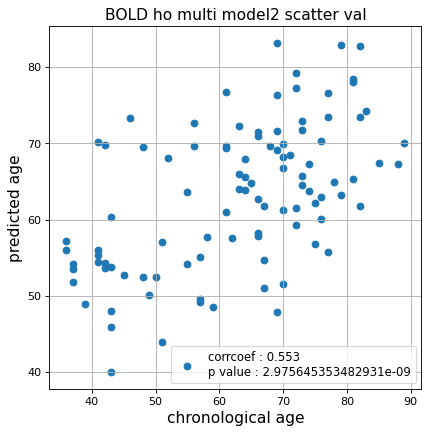

r^2 val data:  0.28955602690429383


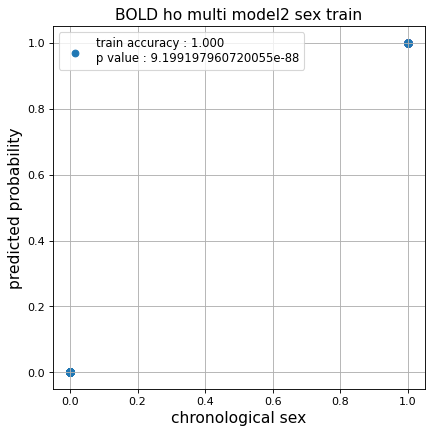

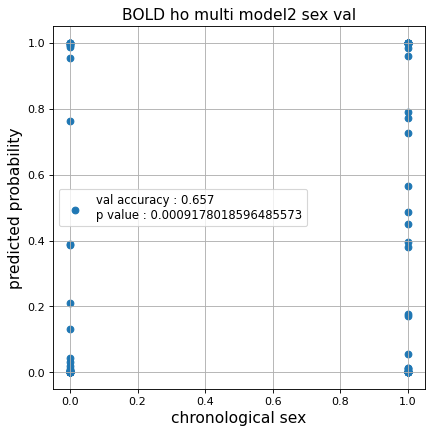

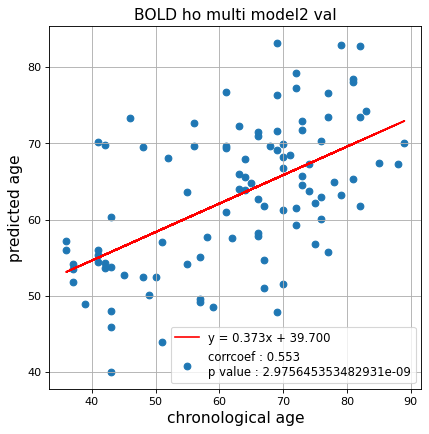

切片: 39.69992085723954
傾き: 0.3733456729065792
Kfold: 3 ::: epoch: 100, loss: 0.15412634725754076, val loss: 1.126884251832962
Kfold: 3 ::: epoch: 200, loss: 0.04004315057626137, val loss: 0.9981959164142609
Kfold: 3 ::: epoch: 300, loss: 0.02184503797728282, val loss: 1.048871859908104
Kfold: 3 ::: epoch: 400, loss: 0.01662887052561228, val loss: 0.9647834002971649
Kfold: 3 ::: epoch: 500, loss: 0.012247007626753587, val loss: 0.963236391544342
early stopping
save_epochs:373
best val loss:0.899743378162384


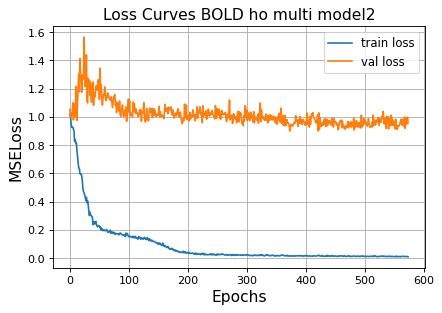

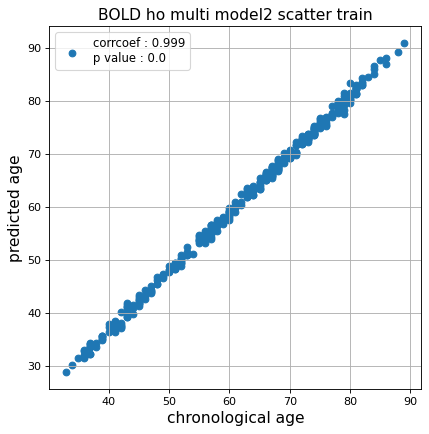

r^2 train data:  0.9813458723789295


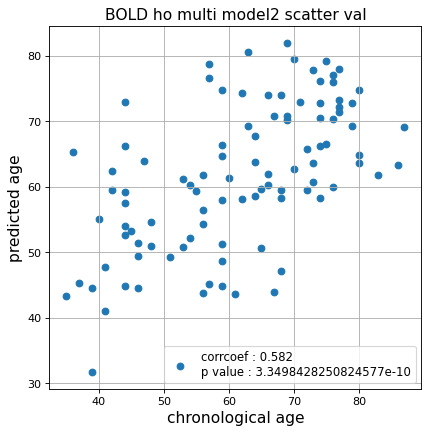

r^2 val data:  0.27496610947933764


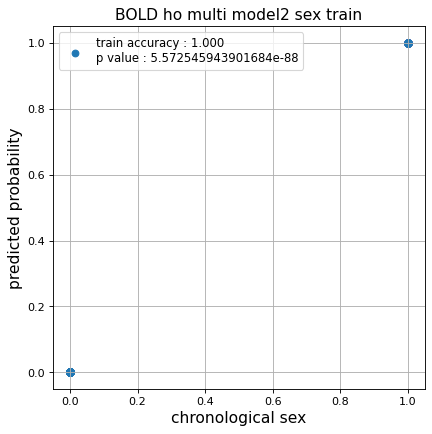

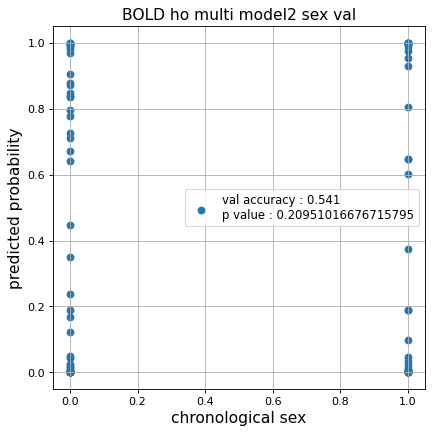

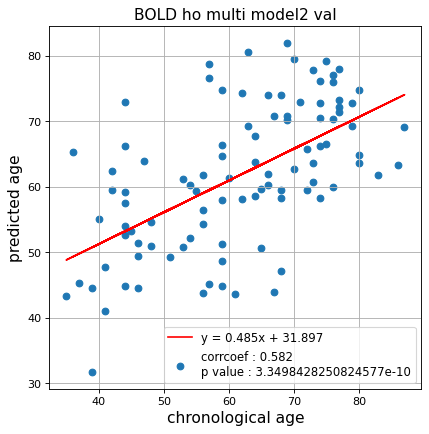

切片: 31.896964994111716
傾き: 0.48453621803230695
Kfold: 4 ::: epoch: 100, loss: 0.15300899056287912, val loss: 1.6461106538772583
Kfold: 4 ::: epoch: 200, loss: 0.03456604638351844, val loss: 1.6161542534828186
Kfold: 4 ::: epoch: 300, loss: 0.019604157441510603, val loss: 1.5858377516269684
Kfold: 4 ::: epoch: 400, loss: 0.018263208966415662, val loss: 1.6094389855861664
Kfold: 4 ::: epoch: 500, loss: 0.013071140095304985, val loss: 1.6458499729633331
Kfold: 4 ::: epoch: 600, loss: 0.010063857556535648, val loss: 1.542668178677559
Kfold: 4 ::: epoch: 700, loss: 0.009193263804683318, val loss: 1.6321171671152115
Kfold: 4 ::: epoch: 800, loss: 0.010234905514292993, val loss: 1.5573259890079498
Kfold: 4 ::: epoch: 900, loss: 0.02146097072041952, val loss: 1.5613842904567719
Kfold: 4 ::: epoch: 1000, loss: 0.007233681963183559, val loss: 1.5502174496650696
save_epochs:860
best val loss:1.4897530823946


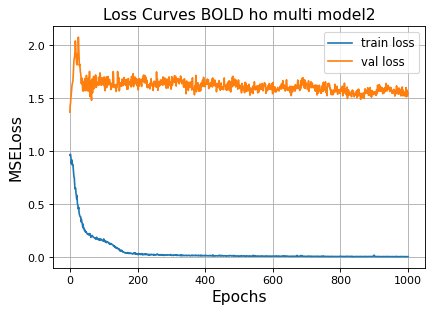

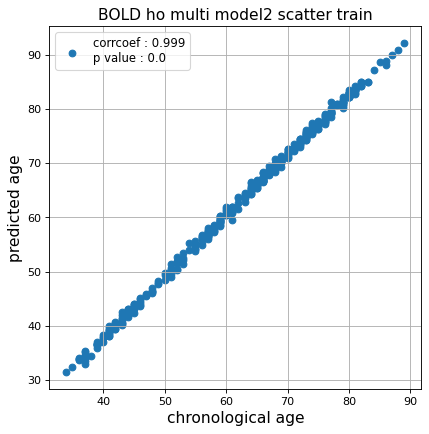

r^2 train data:  0.9810813035471578


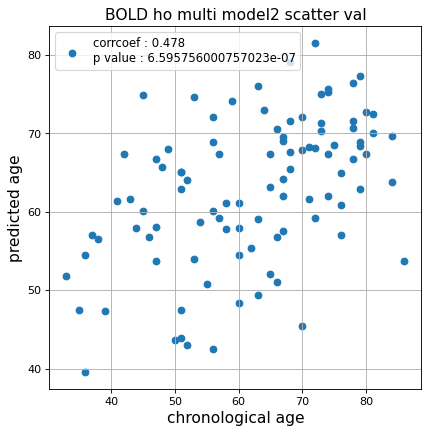

r^2 val data:  0.17815098425634446


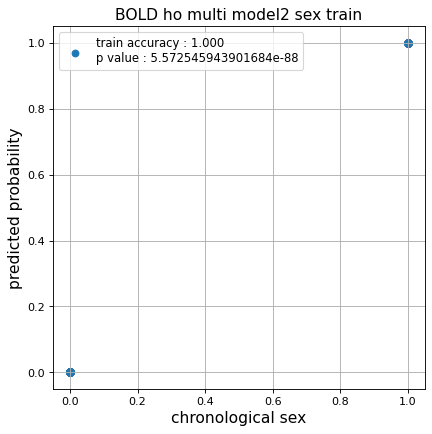

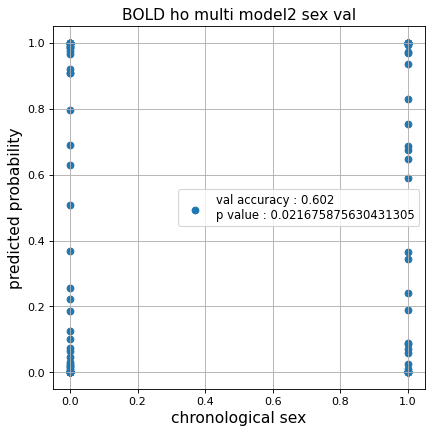

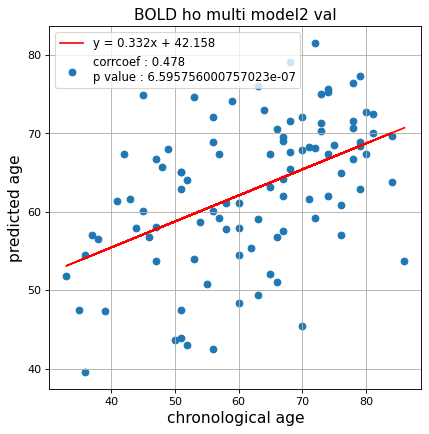

切片: 42.15847456724076
傾き: 0.3318294842806324
Kfold: 5 ::: epoch: 100, loss: 0.16063930094242096, val loss: 0.7936378046870232
Kfold: 5 ::: epoch: 200, loss: 0.03285658388183667, val loss: 0.7458245679736137
Kfold: 5 ::: epoch: 300, loss: 0.02134541615557212, val loss: 0.7155784927308559
Kfold: 5 ::: epoch: 400, loss: 0.015936194775769345, val loss: 0.6843934915959835
Kfold: 5 ::: epoch: 500, loss: 0.013116862051762067, val loss: 0.6593382023274899
Kfold: 5 ::: epoch: 600, loss: 0.011505665508313822, val loss: 0.6486393213272095
Kfold: 5 ::: epoch: 700, loss: 0.008420823392673181, val loss: 0.6439682841300964
Kfold: 5 ::: epoch: 800, loss: 0.009737625216635374, val loss: 0.6289103142917156
Kfold: 5 ::: epoch: 900, loss: 0.007124000873703223, val loss: 0.6107810586690903
Kfold: 5 ::: epoch: 1000, loss: 0.00941212704548469, val loss: 0.6108604148030281
save_epochs:950
best val loss:0.6046663895249367


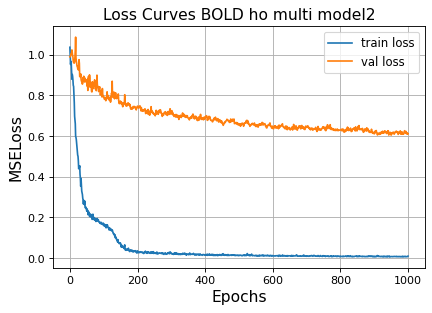

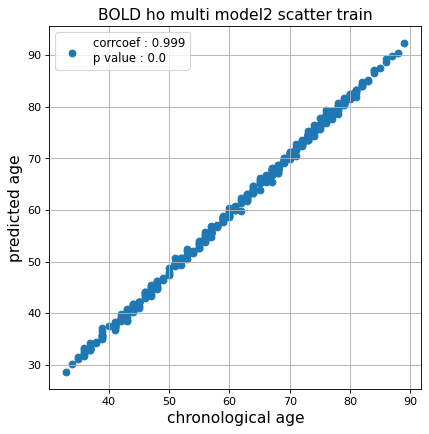

r^2 train data:  0.9791250674582211


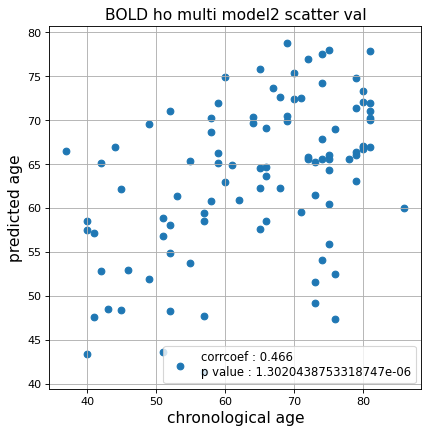

r^2 val data:  0.1653708395363871


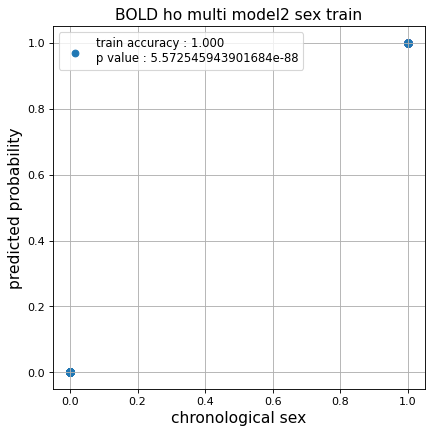

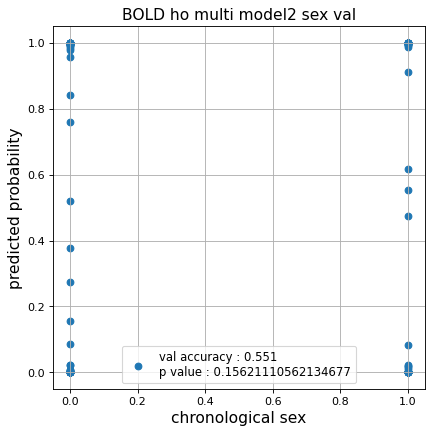

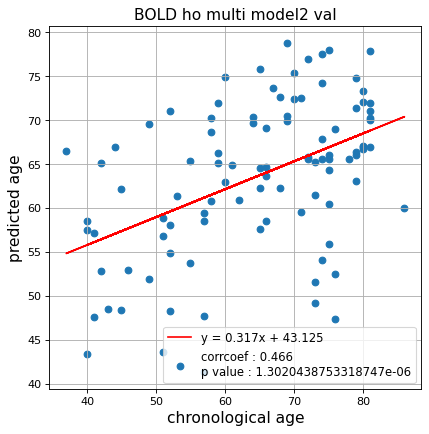

切片: 43.12545741502623
傾き: 0.317201222442487
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.1553022265434265, val loss: 0.8122997060418129
Kfold: 1 ::: epoch: 200, loss: 0.06951677655944458, val loss: 0.7055802047252655
Kfold: 1 ::: epoch: 300, loss: 0.023914211644576147, val loss: 0.6821411997079849
Kfold: 1 ::: epoch: 400, loss: 0.019345236512330864, val loss: 0.6630367338657379
Kfold: 1 ::: epoch: 500, loss: 0.012813262927990694, val loss: 0.6466276794672012
Kfold: 1 ::: epoch: 600, loss: 0.010856724845675321, val loss: 0.6154199838638306
Kfold: 1 ::: epoch: 700, loss: 0.010194619544423543, val loss: 0.5984641090035439
Kfold: 1 ::: epoch: 800, loss: 0.008266886982780237, val loss: 0.5818333141505718
Kfold: 1 ::: epoch: 900, loss: 0.0069989966801725905, val loss: 0.5539103746414185
Kfold: 1 ::: epoch: 1000, loss: 0.006588577722700743, val loss: 0.551945261657238
save_epochs:996
best val loss:0.5393806025385857


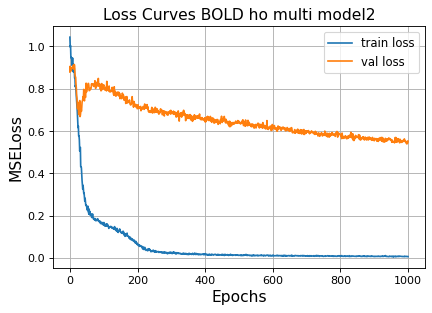

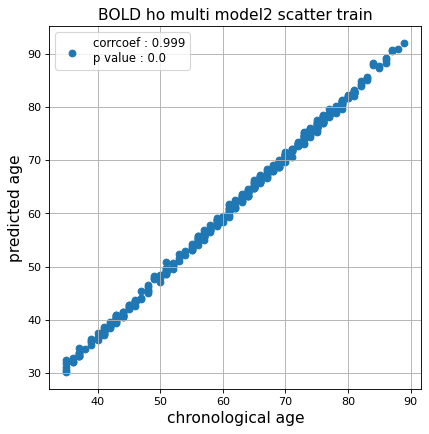

r^2 train data:  0.9814618146728935


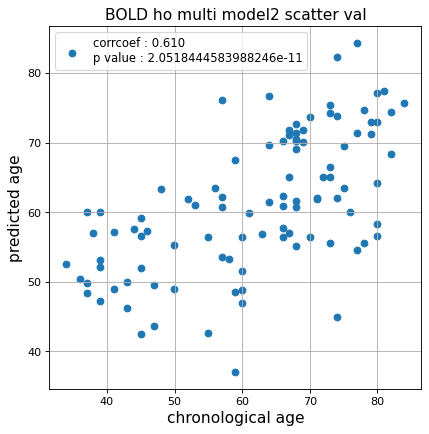

r^2 val data:  0.3556496831540522


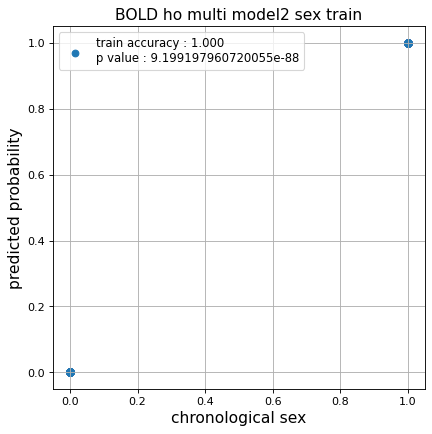

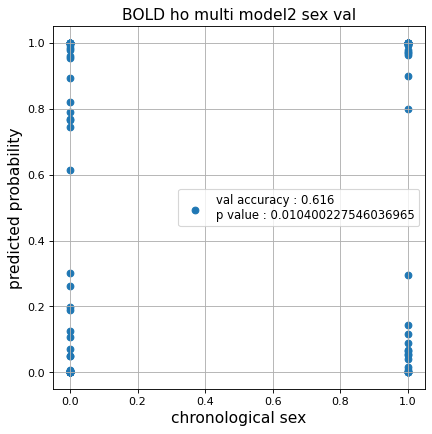

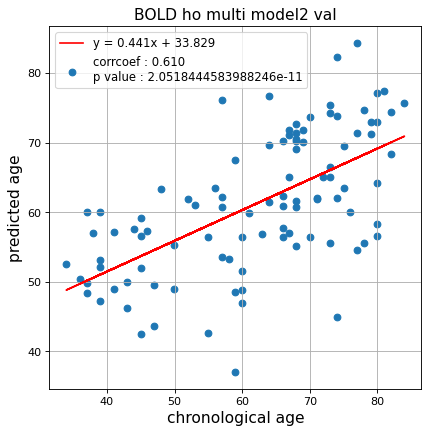

切片: 33.82900063975845
傾き: 0.44132683177410587
Kfold: 2 ::: epoch: 100, loss: 0.16834909640825713, val loss: 0.8707170933485031
Kfold: 2 ::: epoch: 200, loss: 0.0354871555016591, val loss: 0.7374539971351624
Kfold: 2 ::: epoch: 300, loss: 0.01986268857637277, val loss: 0.7077512368559837
Kfold: 2 ::: epoch: 400, loss: 0.016659390467863817, val loss: 0.6773393303155899
Kfold: 2 ::: epoch: 500, loss: 0.012785396037193445, val loss: 0.6609431579709053
Kfold: 2 ::: epoch: 600, loss: 0.013381448717644582, val loss: 0.6488239914178848
Kfold: 2 ::: epoch: 700, loss: 0.009592213417188479, val loss: 0.6331707760691643
Kfold: 2 ::: epoch: 800, loss: 0.007335440954193473, val loss: 0.64775350689888
Kfold: 2 ::: epoch: 900, loss: 0.007424812119167585, val loss: 0.6347237154841423
early stopping
save_epochs:716
best val loss:0.6259308978915215


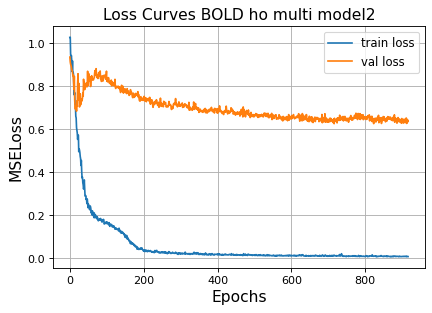

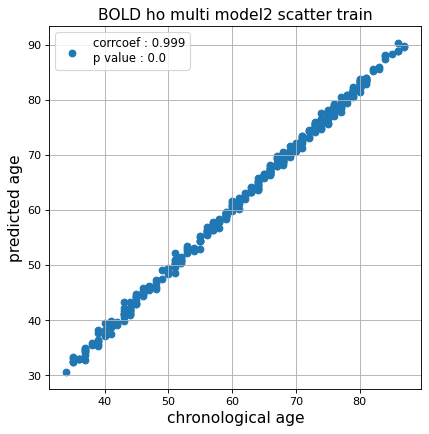

r^2 train data:  0.9801186714265158


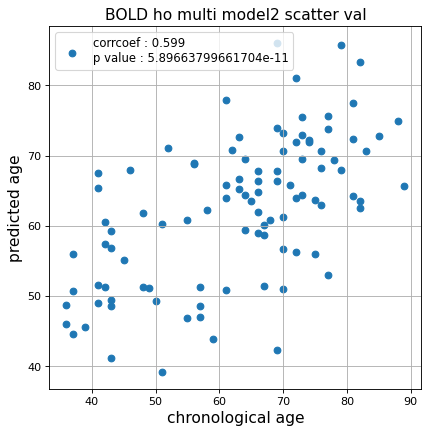

r^2 val data:  0.3393773716365386


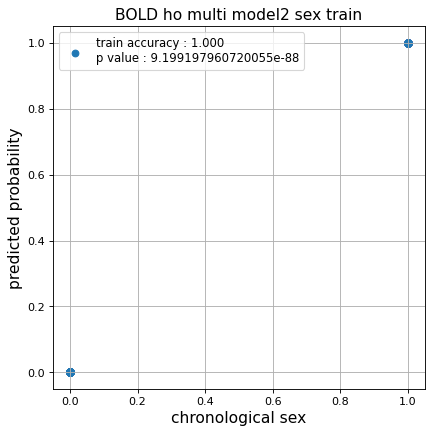

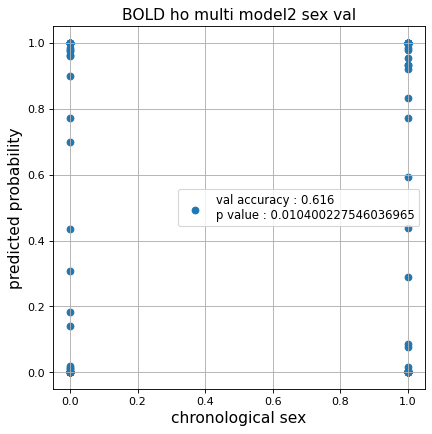

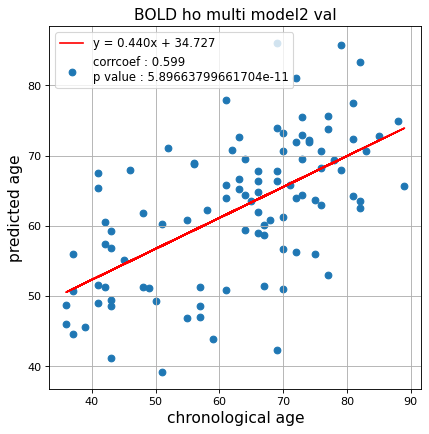

切片: 34.726610128144245
傾き: 0.4400977453832096
Kfold: 3 ::: epoch: 100, loss: 0.17140002090197343, val loss: 0.642957054078579
Kfold: 3 ::: epoch: 200, loss: 0.03268878992933493, val loss: 0.6430807560682297
Kfold: 3 ::: epoch: 300, loss: 0.021568272334451858, val loss: 0.6192804574966431
Kfold: 3 ::: epoch: 400, loss: 0.017045093557009332, val loss: 0.5775104984641075
Kfold: 3 ::: epoch: 500, loss: 0.012317135500220152, val loss: 0.5757833570241928
Kfold: 3 ::: epoch: 600, loss: 0.01027971445224606, val loss: 0.5468474105000496
Kfold: 3 ::: epoch: 700, loss: 0.007640226994856046, val loss: 0.5346558541059494
Kfold: 3 ::: epoch: 800, loss: 0.007708414368188152, val loss: 0.5298404693603516
Kfold: 3 ::: epoch: 900, loss: 0.006430031624264442, val loss: 0.51654864102602
early stopping
save_epochs:736
best val loss:0.5029037594795227


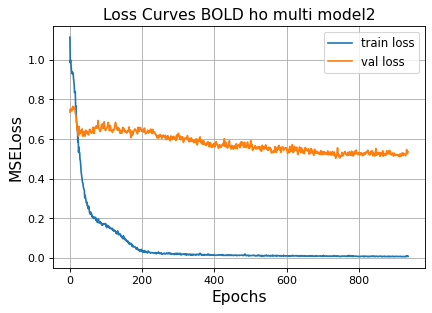

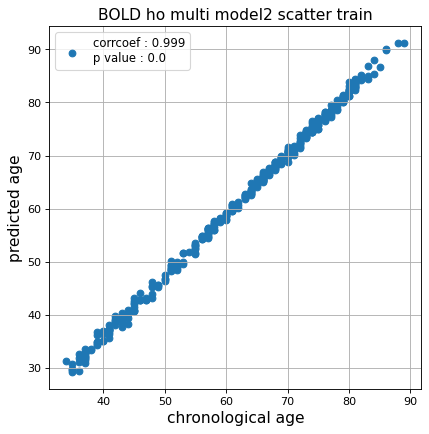

r^2 train data:  0.971167492894827


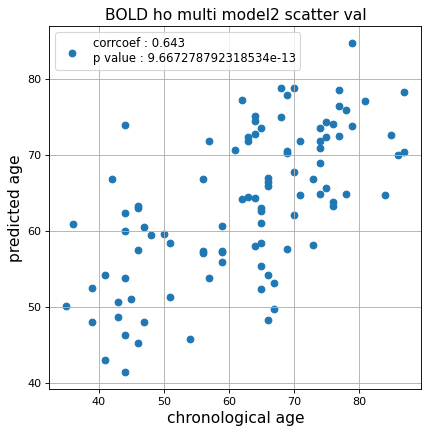

r^2 val data:  0.3961343395474568


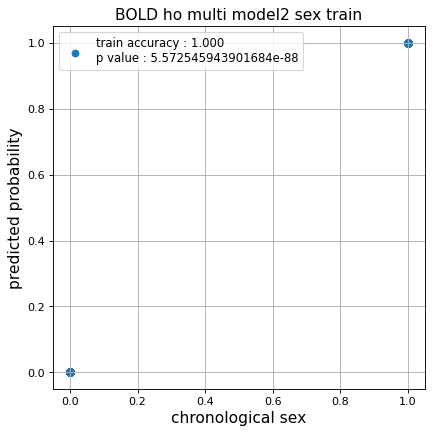

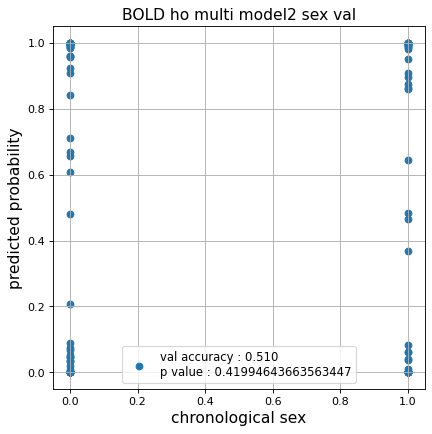

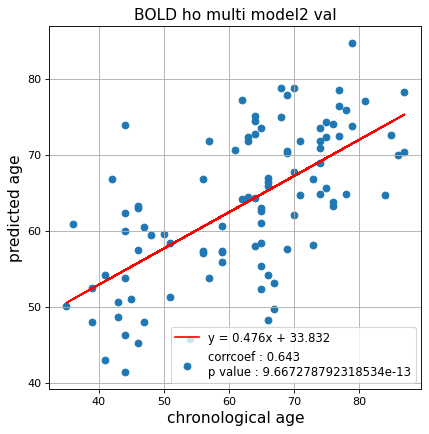

切片: 33.83236745565228
傾き: 0.47620452114056433
Kfold: 4 ::: epoch: 100, loss: 0.16140480224902815, val loss: 1.3374910056591034
Kfold: 4 ::: epoch: 200, loss: 0.03410043151905903, val loss: 1.2856788635253906
Kfold: 4 ::: epoch: 300, loss: 0.02081885403738572, val loss: 1.2554975003004074
Kfold: 4 ::: epoch: 400, loss: 0.016811618796334818, val loss: 1.208045780658722
Kfold: 4 ::: epoch: 500, loss: 0.011884179073744096, val loss: 1.2543005645275116
Kfold: 4 ::: epoch: 600, loss: 0.009836860896589665, val loss: 1.2094830125570297
Kfold: 4 ::: epoch: 700, loss: 0.008905198568334946, val loss: 1.1776624470949173
Kfold: 4 ::: epoch: 800, loss: 0.008688472175540833, val loss: 1.1495850682258606
early stopping
save_epochs:679
best val loss:1.1000647693872452


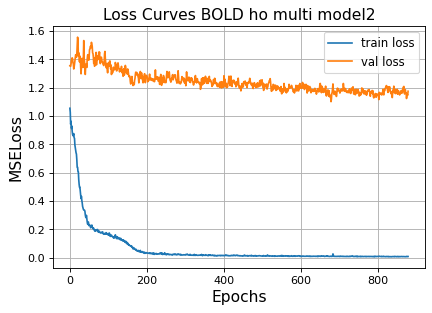

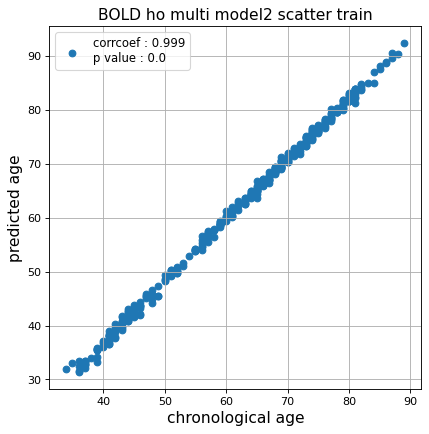

r^2 train data:  0.9803872815638601


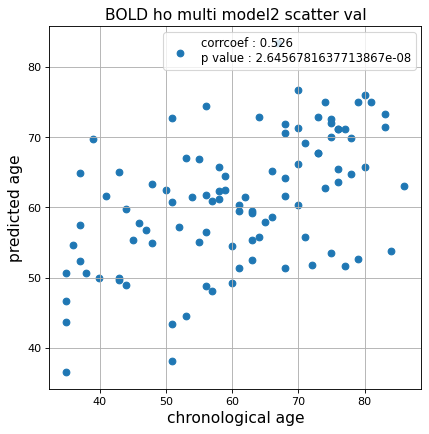

r^2 val data:  0.25686045629370535


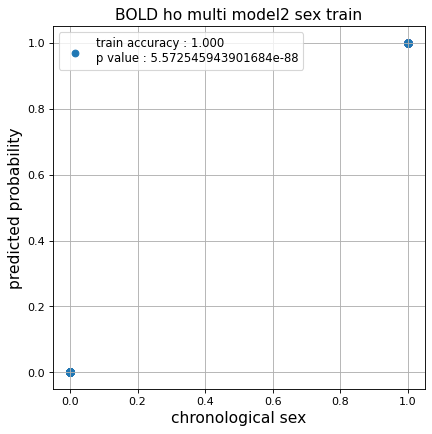

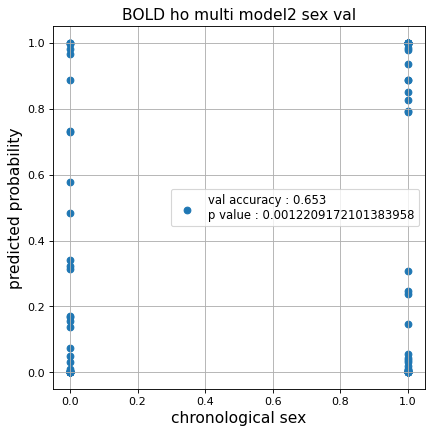

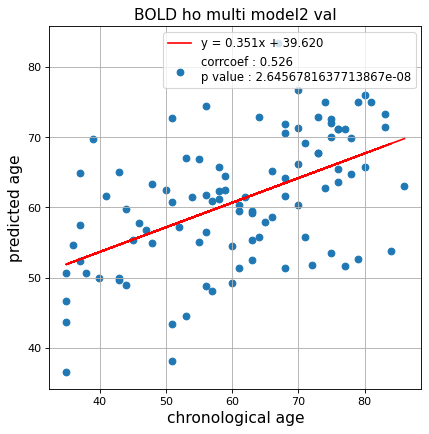

切片: 39.61965482008202
傾き: 0.3508680437339806
Kfold: 5 ::: epoch: 100, loss: 0.13027030630753592, val loss: 0.7639400586485863
Kfold: 5 ::: epoch: 200, loss: 0.032122116249341234, val loss: 0.6925250291824341
Kfold: 5 ::: epoch: 300, loss: 0.023644735750097495, val loss: 0.6844967976212502
Kfold: 5 ::: epoch: 400, loss: 0.01665401551872492, val loss: 0.6750540509819984
Kfold: 5 ::: epoch: 500, loss: 0.012571961654780002, val loss: 0.6490701362490654
Kfold: 5 ::: epoch: 600, loss: 0.010013778335773028, val loss: 0.6512458771467209
Kfold: 5 ::: epoch: 700, loss: 0.010050909271320472, val loss: 0.640463799238205
Kfold: 5 ::: epoch: 800, loss: 0.007964249736127945, val loss: 0.6418633535504341
Kfold: 5 ::: epoch: 900, loss: 0.010197125912572328, val loss: 0.6323801651597023
early stopping
save_epochs:772
best val loss:0.621418297290802


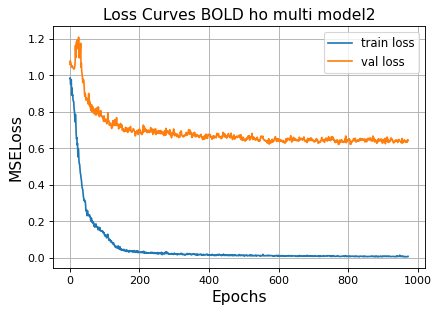

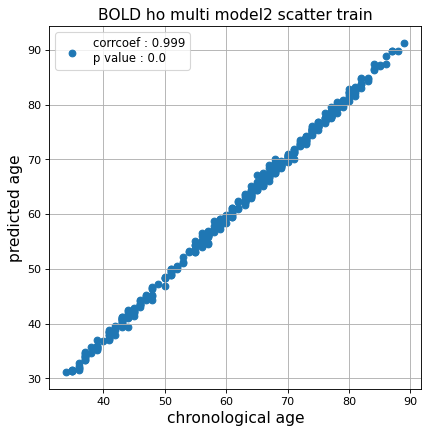

r^2 train data:  0.983684258137856


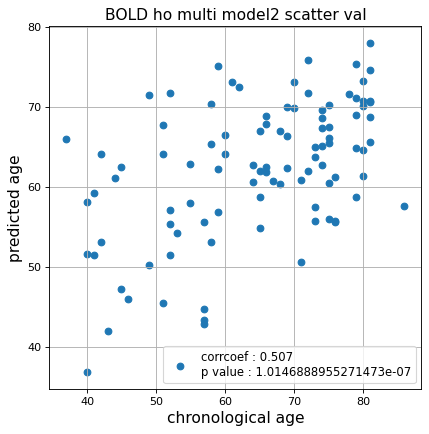

r^2 val data:  0.19697347179300806


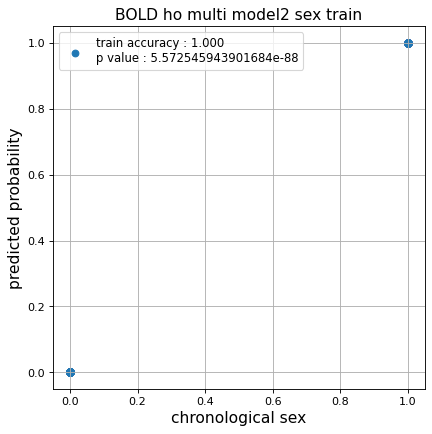

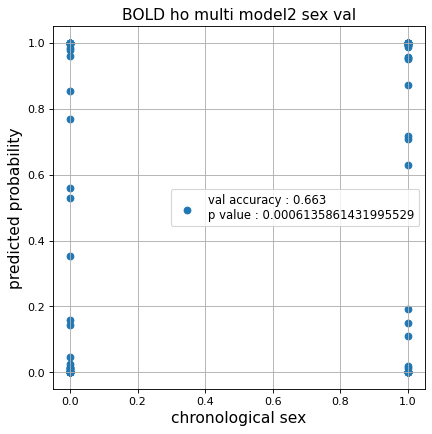

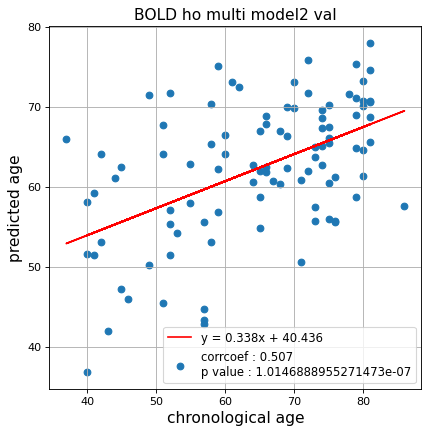

切片: 40.43640400132429
傾き: 0.3381333979137558
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.1593112017099674, val loss: 0.766999214887619
Kfold: 1 ::: epoch: 200, loss: 0.04860143821973067, val loss: 0.6791859418153763
Kfold: 1 ::: epoch: 300, loss: 0.01847510842176584, val loss: 0.6598901897668839
Kfold: 1 ::: epoch: 400, loss: 0.015931808676284093, val loss: 0.6416984125971794
Kfold: 1 ::: epoch: 500, loss: 0.012016563568837367, val loss: 0.6129676103591919
Kfold: 1 ::: epoch: 600, loss: 0.010434026471697368, val loss: 0.6015611216425896
Kfold: 1 ::: epoch: 700, loss: 0.009001148470605794, val loss: 0.5765762329101562
Kfold: 1 ::: epoch: 800, loss: 0.008756926784721704, val loss: 0.5575761534273624
Kfold: 1 ::: epoch: 900, loss: 0.006424076246240964, val loss: 0.5376572944223881
Kfold: 1 ::: epoch: 1000, loss: 0.007460872248674815, val loss: 0.5227829217910767
save_epochs:992
best val loss:0.5168942268937826


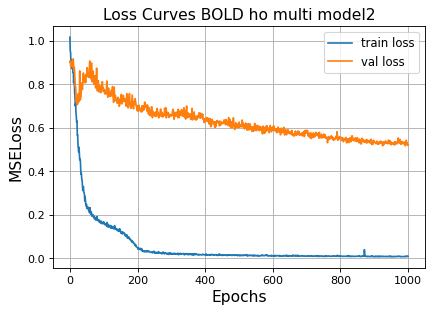

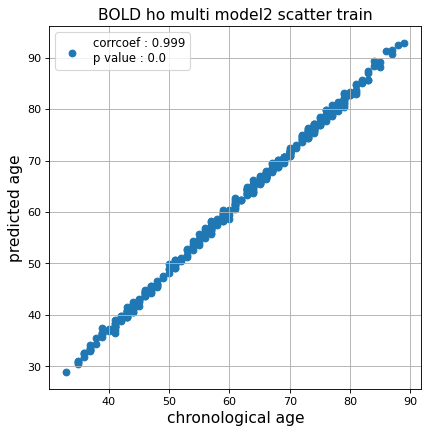

r^2 train data:  0.9734125457894807


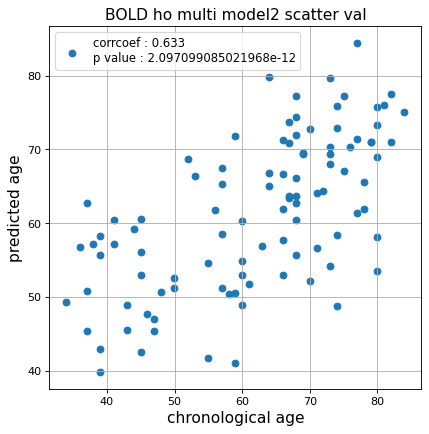

r^2 val data:  0.384804534760641


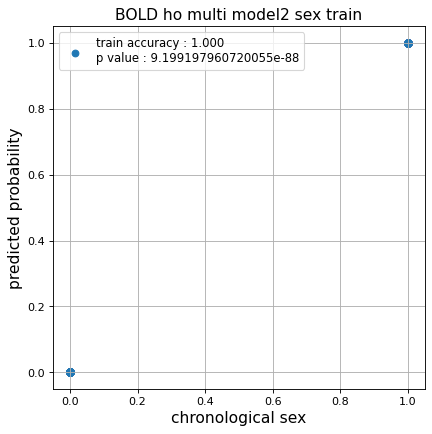

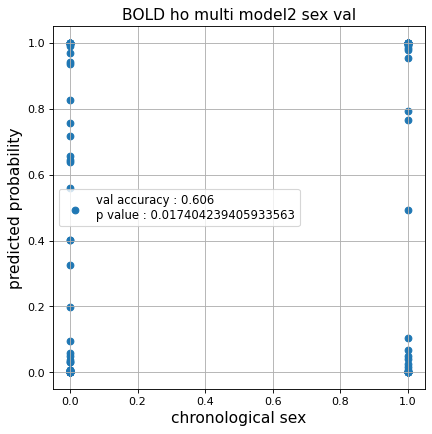

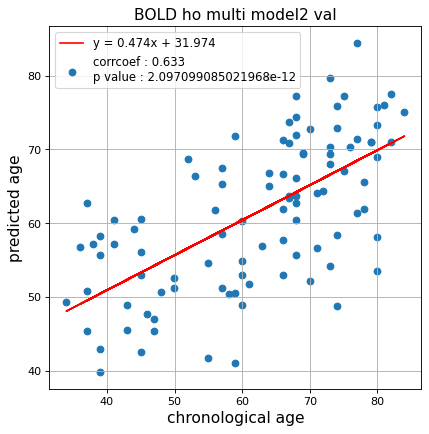

切片: 31.974004327986066
傾き: 0.4740614362644088
Kfold: 2 ::: epoch: 100, loss: 0.16587518957945016, val loss: 0.8829171881079674
Kfold: 2 ::: epoch: 200, loss: 0.03140516163638005, val loss: 0.8474586308002472
Kfold: 2 ::: epoch: 300, loss: 0.018270438680282004, val loss: 0.7805861607193947
Kfold: 2 ::: epoch: 400, loss: 0.016822162478302535, val loss: 0.7474136054515839
Kfold: 2 ::: epoch: 500, loss: 0.011526813802237693, val loss: 0.7326704412698746
Kfold: 2 ::: epoch: 600, loss: 0.011270208105158348, val loss: 0.7170908600091934
Kfold: 2 ::: epoch: 700, loss: 0.008851045509800315, val loss: 0.7093208134174347
Kfold: 2 ::: epoch: 800, loss: 0.006648053755410588, val loss: 0.6975458115339279
Kfold: 2 ::: epoch: 900, loss: 0.006334314516817148, val loss: 0.6965963020920753
early stopping
save_epochs:792
best val loss:0.6775494515895844


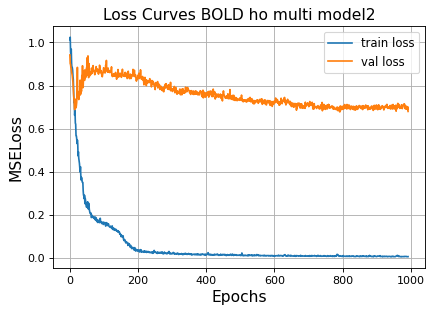

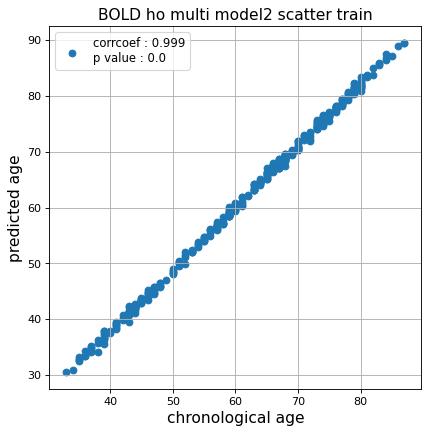

r^2 train data:  0.9860997598929825


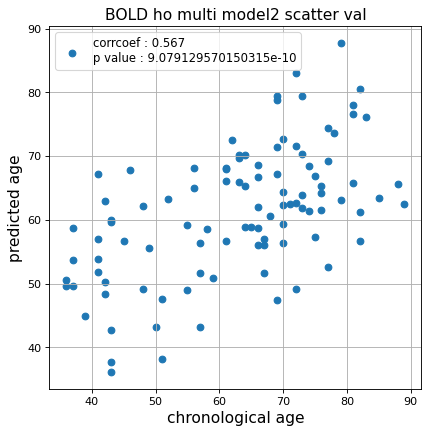

r^2 val data:  0.28627000991820695


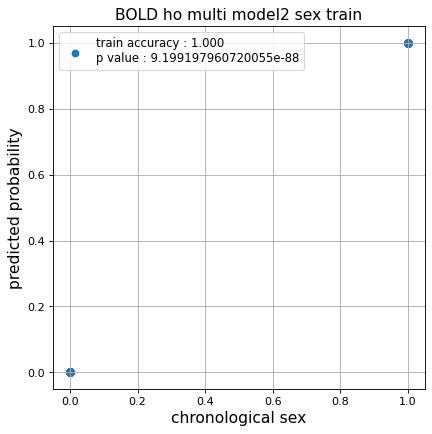

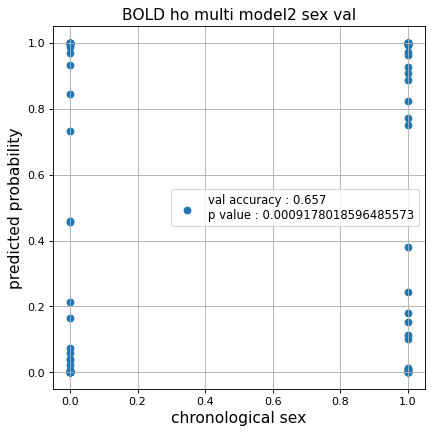

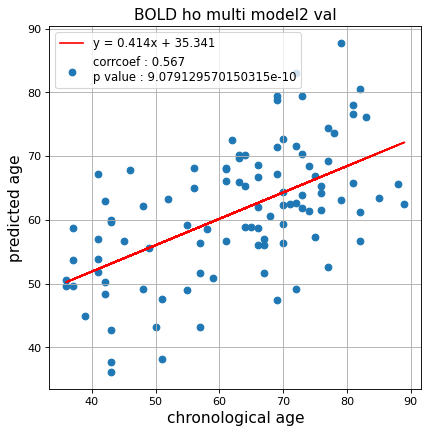

切片: 35.34096702354007
傾き: 0.41376774430326185
Kfold: 3 ::: epoch: 100, loss: 0.16841034476573652, val loss: 0.9470971003174782
Kfold: 3 ::: epoch: 200, loss: 0.03373633783597212, val loss: 0.8433667719364166
Kfold: 3 ::: epoch: 300, loss: 0.02166609079218828, val loss: 0.8321389406919479
Kfold: 3 ::: epoch: 400, loss: 0.017774025408121254, val loss: 0.808744877576828
Kfold: 3 ::: epoch: 500, loss: 0.015730514119450863, val loss: 0.7917340397834778
Kfold: 3 ::: epoch: 600, loss: 0.011631369769859772, val loss: 0.8580470159649849
Kfold: 3 ::: epoch: 700, loss: 0.0098239194888335, val loss: 0.7936120480298996
Kfold: 3 ::: epoch: 800, loss: 0.010003359737591101, val loss: 0.7602368593215942
Kfold: 3 ::: epoch: 900, loss: 0.007680879296878209, val loss: 0.7733229771256447
Kfold: 3 ::: epoch: 1000, loss: 0.0074354248085560706, val loss: 0.7556569501757622
save_epochs:836
best val loss:0.7333978489041328


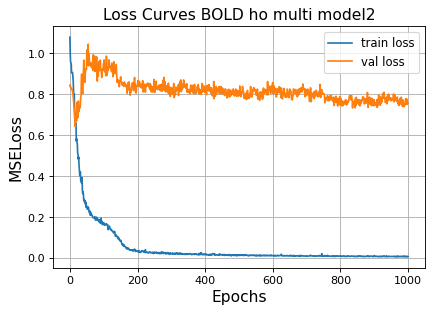

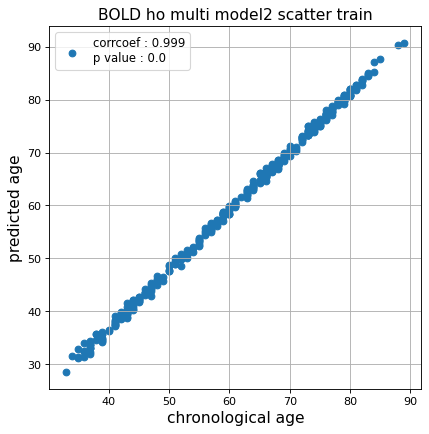

r^2 train data:  0.9823104739056613


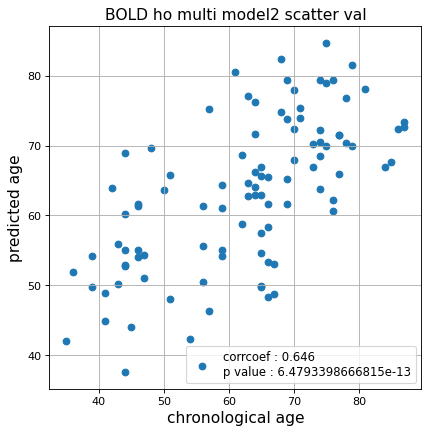

r^2 val data:  0.3869504363827512


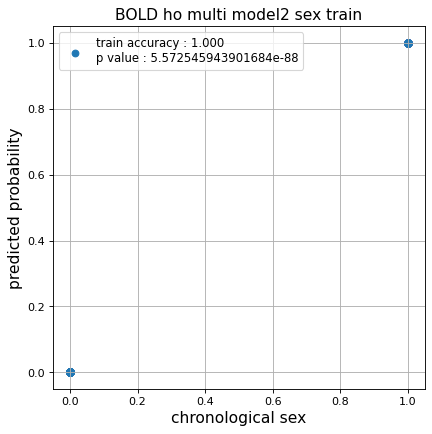

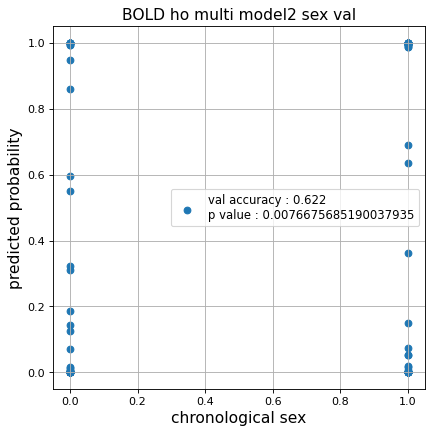

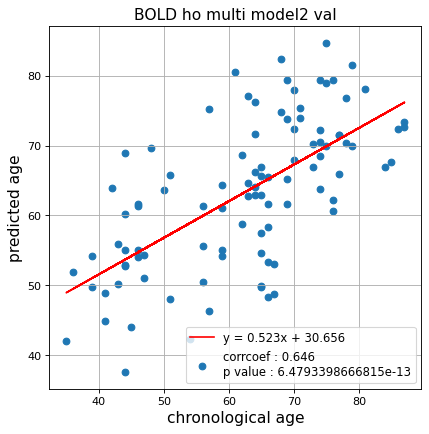

切片: 30.65563658189963
傾き: 0.5231457904534986
Kfold: 4 ::: epoch: 100, loss: 0.14542374244103065, val loss: 0.5425497097894549
Kfold: 4 ::: epoch: 200, loss: 0.030285712904655017, val loss: 0.5123521564528346
Kfold: 4 ::: epoch: 300, loss: 0.02021707923939595, val loss: 0.49049306474626064
Kfold: 4 ::: epoch: 400, loss: 0.01671560753423434, val loss: 0.4790524709969759
Kfold: 4 ::: epoch: 500, loss: 0.012976802670611786, val loss: 0.46072396636009216
Kfold: 4 ::: epoch: 600, loss: 0.012066605393416606, val loss: 0.43726349901407957
Kfold: 4 ::: epoch: 700, loss: 0.009088213501784664, val loss: 0.424708254635334
Kfold: 4 ::: epoch: 800, loss: 0.008840022322077017, val loss: 0.42538498155772686
Kfold: 4 ::: epoch: 900, loss: 0.00812213670892211, val loss: 0.41406249813735485
Kfold: 4 ::: epoch: 1000, loss: 0.0069542322666026075, val loss: 0.42049212008714676
save_epochs:999
best val loss:0.40461681224405766


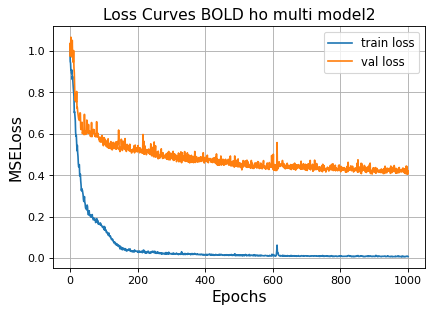

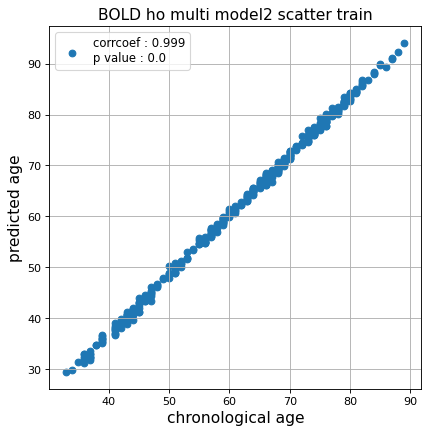

r^2 train data:  0.9675101707411684


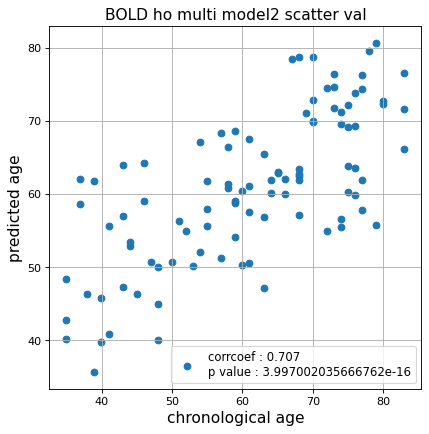

r^2 val data:  0.49737231764049394


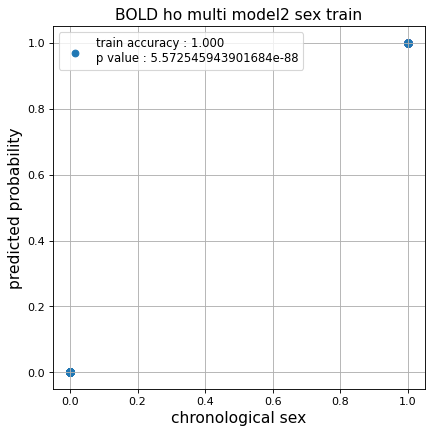

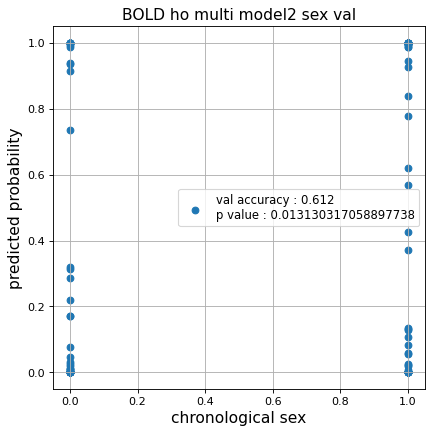

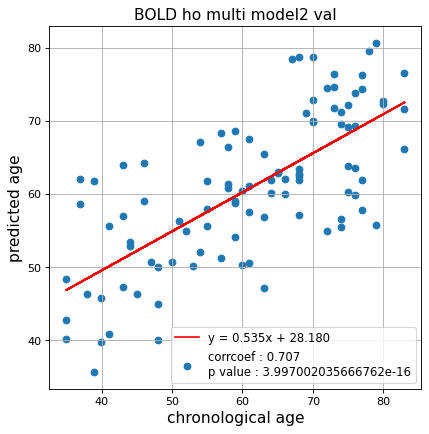

切片: 28.180165112407146
傾き: 0.5345127385323404
Kfold: 5 ::: epoch: 100, loss: 0.16856221854686737, val loss: 0.7055373340845108
Kfold: 5 ::: epoch: 200, loss: 0.03444799565925048, val loss: 0.6762424111366272
Kfold: 5 ::: epoch: 300, loss: 0.019772089874515168, val loss: 0.7182523459196091
Kfold: 5 ::: epoch: 400, loss: 0.014437733862835627, val loss: 0.709489107131958
early stopping
save_epochs:204
best val loss:0.6416182368993759


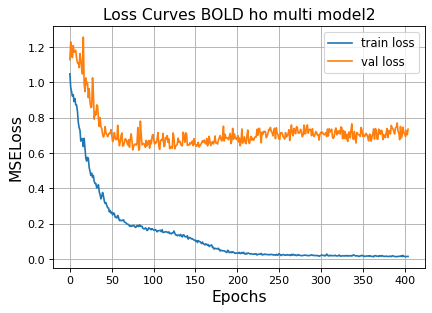

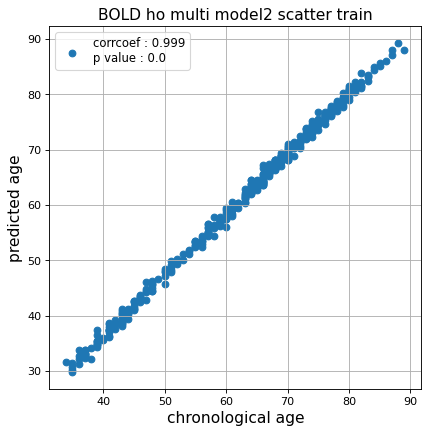

r^2 train data:  0.9764077811235125


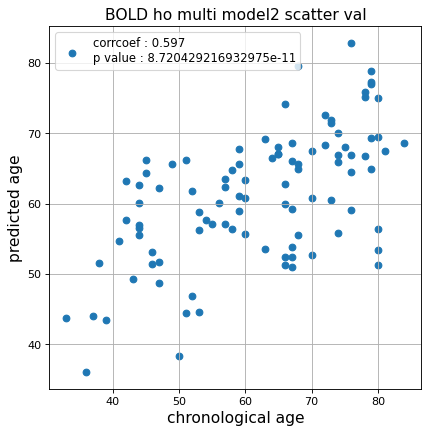

r^2 val data:  0.3425172266578418


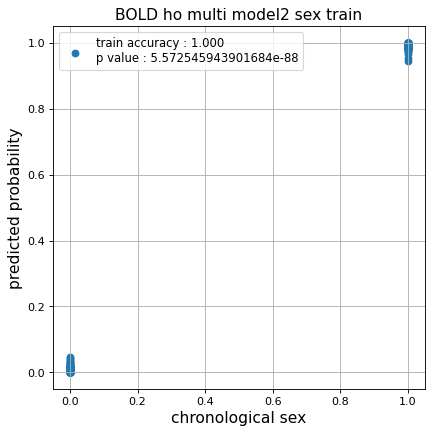

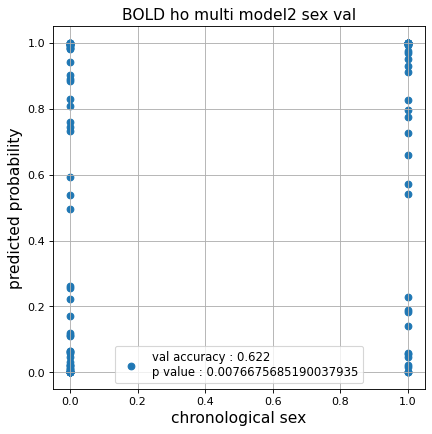

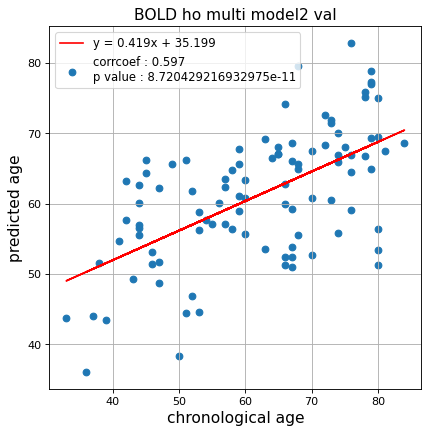

切片: 35.19888541896192
傾き: 0.41949602751947995
CPU times: user 1h 30min 35s, sys: 7min 56s, total: 1h 38min 32s
Wall time: 1h 38min 41s


In [26]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_2  = []
test_pred_ho_corrected_2  = []
test_label_ho_2 = []
test_idx_ho_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 128,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 128,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.1,
                                                           fc_drop = 0.1,
                                                           title = 'ROI ho multi model2'
                                                          )
    
    test_pred_ho_2.append(test_pred)
    test_pred_ho_corrected_2.append(test_pred_corrected)
    test_label_ho_2.append(test_label)
    test_idx_ho_2.append(test_idx)

### データ保存

In [27]:
test_pred_ho_1 = np.array(test_pred_ho_1, dtype=object)
test_pred_ho_corrected_1 = np.array(test_pred_ho_corrected_1, dtype=object)

test_pred_ho_2 = np.array(test_pred_ho_2, dtype=object)
test_pred_ho_corrected_2 = np.array(test_pred_ho_corrected_2, dtype=object)

In [28]:
np.savez('../02_data_analysis/temp/multi_ho_1',
         test_pred_ho_1,
         test_pred_ho_corrected_1,
         test_label_ho_1,
         test_idx_ho_1)
np.savez('../02_data_analysis/temp/multi_ho_2',
         test_pred_ho_2,
         test_pred_ho_corrected_2,
         test_label_ho_2,
         test_idx_ho_2)

### Data定義(dynamic FC)

In [29]:
%%time
df_dynamic_ho = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_ho.csv')
data_dynamic_ho = make_data(df_dynamic_ho)
print(data_dynamic_ho.shape)

(615, 123, 5995)
CPU times: user 2min 43s, sys: 2.65 s, total: 2min 46s
Wall time: 2min 46s


### Dynamic FC 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.05125897950851, val loss: 0.5463574677705765
Kfold: 1 ::: epoch: 200, loss: 0.023683255180143394, val loss: 0.47390036284923553
Kfold: 1 ::: epoch: 300, loss: 0.012618415165119447, val loss: 0.44732373766601086
Kfold: 1 ::: epoch: 400, loss: 0.009267433313652873, val loss: 0.4326256476342678
Kfold: 1 ::: epoch: 500, loss: 0.008326560652886447, val loss: 0.4322108803316951
Kfold: 1 ::: epoch: 600, loss: 0.006370570438985641, val loss: 0.43509834818542004
Kfold: 1 ::: epoch: 700, loss: 0.005952694417478947, val loss: 0.45033226534724236
save_epochs:517
best val loss:0.41617416217923164


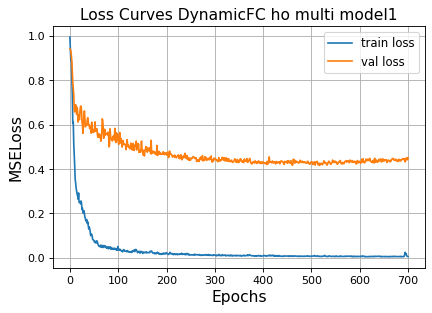

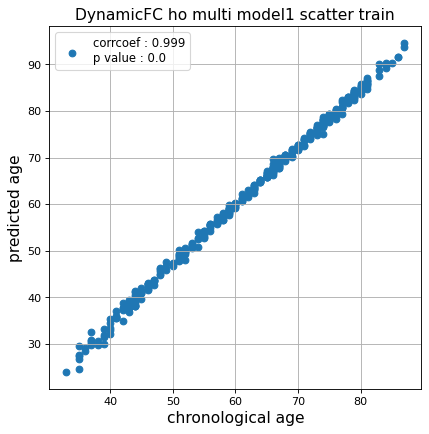

r^2 train data:  0.9279163241735945


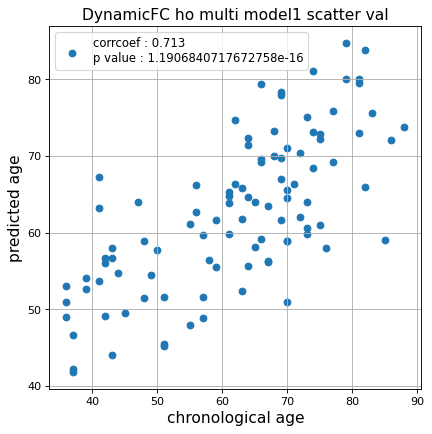

r^2 val data:  0.5058104504428782


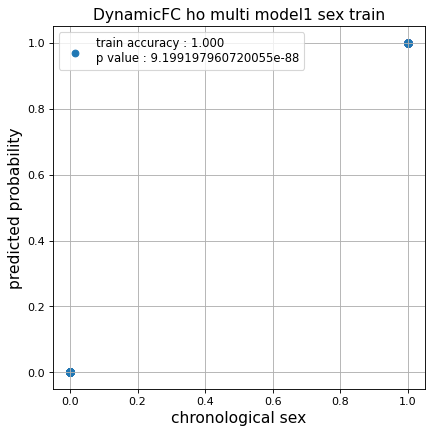

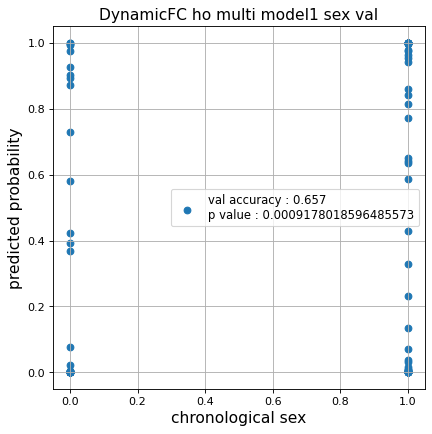

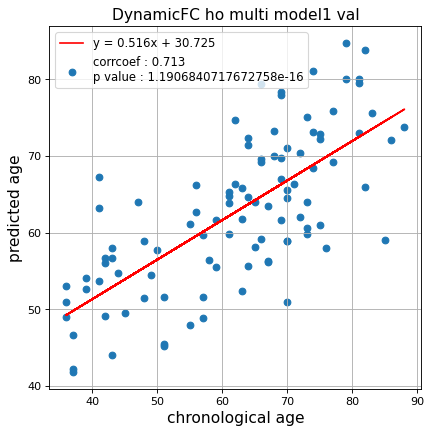

切片: 30.724775843999375
傾き: 0.5155928696380925
Kfold: 2 ::: epoch: 100, loss: 0.044796089426829264, val loss: 0.7445173859596252
Kfold: 2 ::: epoch: 200, loss: 0.022298897688205425, val loss: 0.6871695294976234
Kfold: 2 ::: epoch: 300, loss: 0.01245416679347937, val loss: 0.6369497552514076
Kfold: 2 ::: epoch: 400, loss: 0.011493070373454919, val loss: 0.6254044324159622
Kfold: 2 ::: epoch: 500, loss: 0.008827125044682851, val loss: 0.61653783172369
Kfold: 2 ::: epoch: 600, loss: 0.006731048262176605, val loss: 0.5963031053543091
Kfold: 2 ::: epoch: 700, loss: 0.004675170155958488, val loss: 0.6261148601770401
save_epochs:560
best val loss:0.5649090260267258


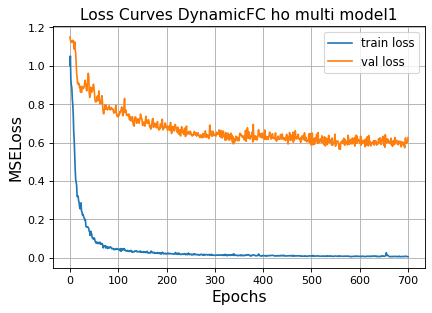

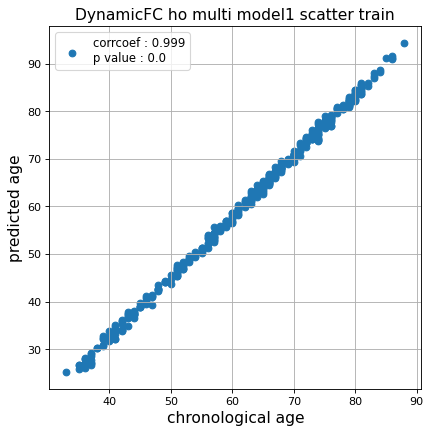

r^2 train data:  0.9095157441829408


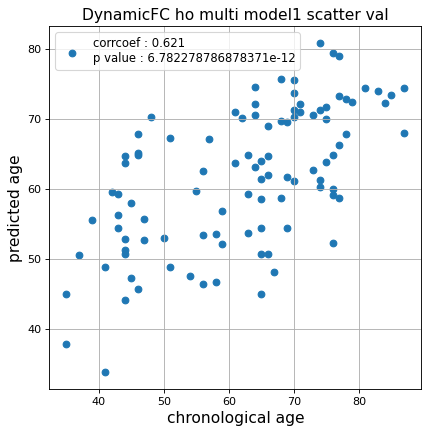

r^2 val data:  0.37038859326018825


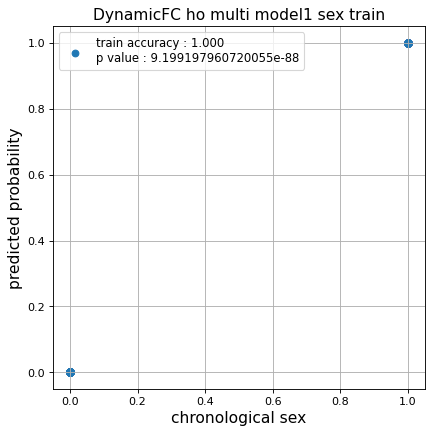

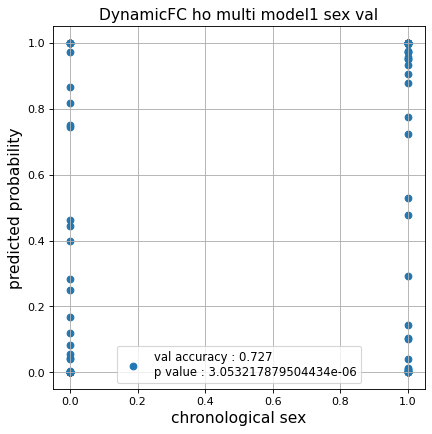

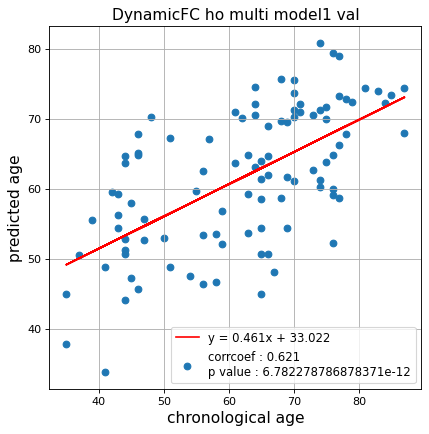

切片: 33.02238360271477
傾き: 0.46068940285682575
Kfold: 3 ::: epoch: 100, loss: 0.03720509662077977, val loss: 0.4825807213783264
Kfold: 3 ::: epoch: 200, loss: 0.01834736241457554, val loss: 0.43036775663495064
Kfold: 3 ::: epoch: 300, loss: 0.012537685652764944, val loss: 0.3947252668440342
Kfold: 3 ::: epoch: 400, loss: 0.011763256437216815, val loss: 0.4054686911404133
Kfold: 3 ::: epoch: 500, loss: 0.006738660642160819, val loss: 0.3899053055793047
Kfold: 3 ::: epoch: 600, loss: 0.006380284742380564, val loss: 0.3988766297698021
Kfold: 3 ::: epoch: 700, loss: 0.006002402810666423, val loss: 0.42516399174928665
save_epochs:505
best val loss:0.3695927504450083


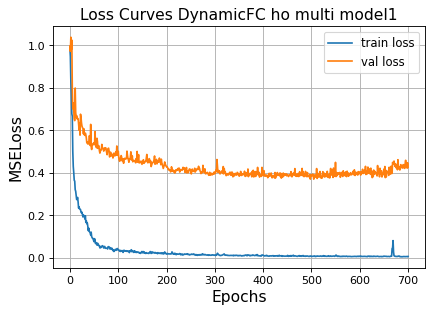

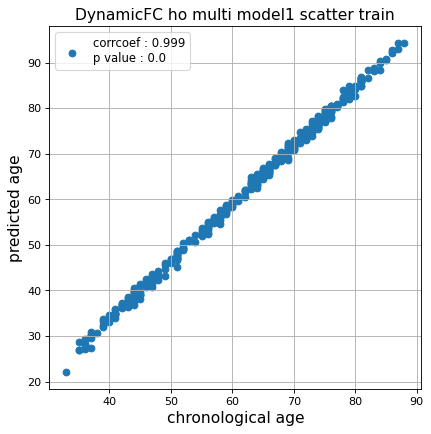

r^2 train data:  0.9220227696947272


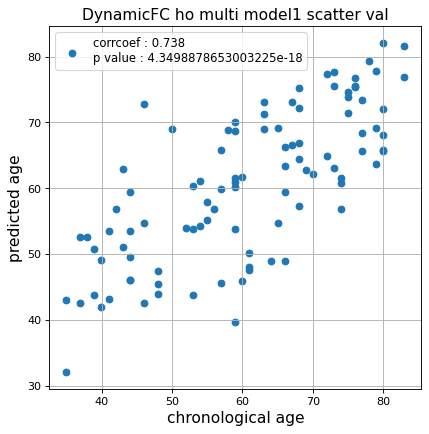

r^2 val data:  0.5340868432232094


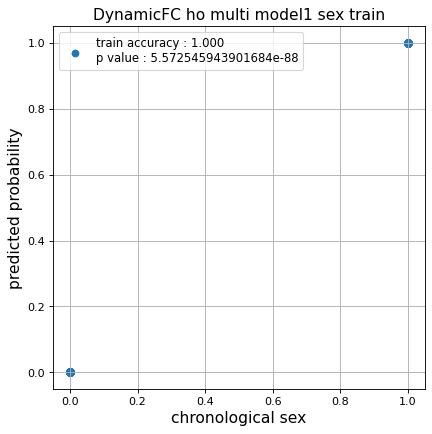

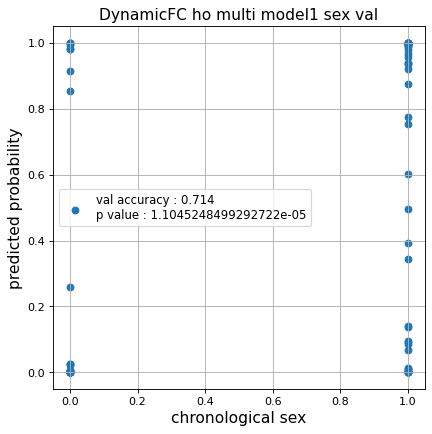

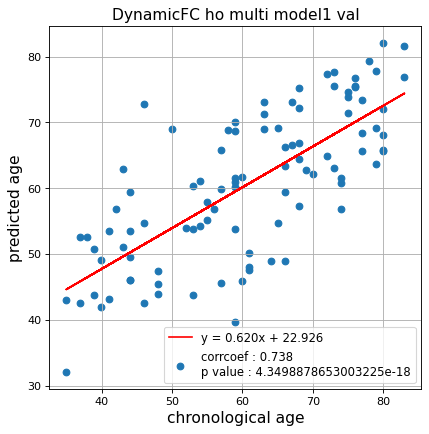

切片: 22.925522368362792
傾き: 0.620333766746441
Kfold: 4 ::: epoch: 100, loss: 0.03912046838265199, val loss: 1.649853378534317
Kfold: 4 ::: epoch: 200, loss: 0.018314031454233024, val loss: 1.6358572244644165
Kfold: 4 ::: epoch: 300, loss: 0.01174409519164608, val loss: 1.523258537054062
Kfold: 4 ::: epoch: 400, loss: 0.008404688193247868, val loss: 1.563445046544075
Kfold: 4 ::: epoch: 500, loss: 0.008881269237742974, val loss: 1.5054640471935272
Kfold: 4 ::: epoch: 600, loss: 0.0065733002892767005, val loss: 1.3560522943735123
Kfold: 4 ::: epoch: 700, loss: 0.006088823366623659, val loss: 1.3763790726661682
save_epochs:609
best val loss:1.2901462316513062


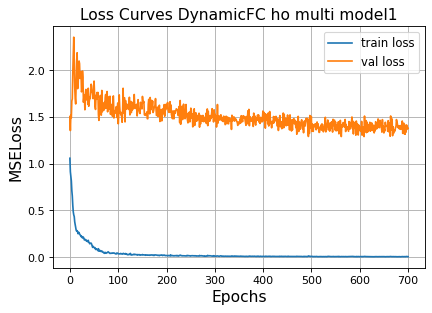

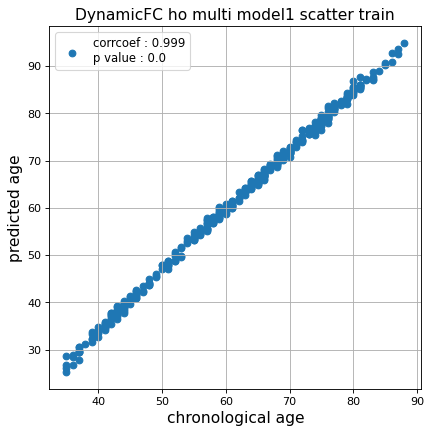

r^2 train data:  0.9262492086756413


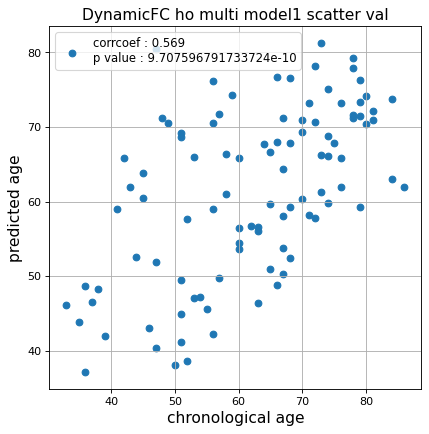

r^2 val data:  0.241815365369069


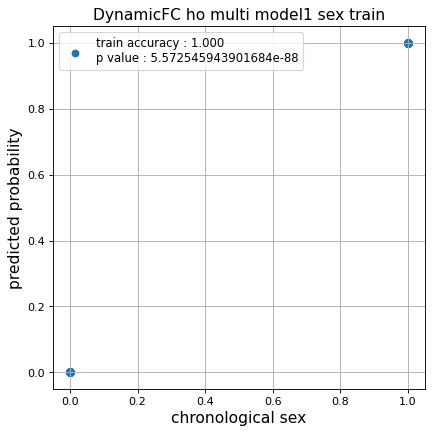

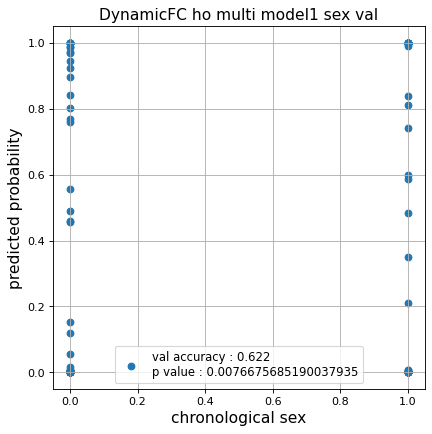

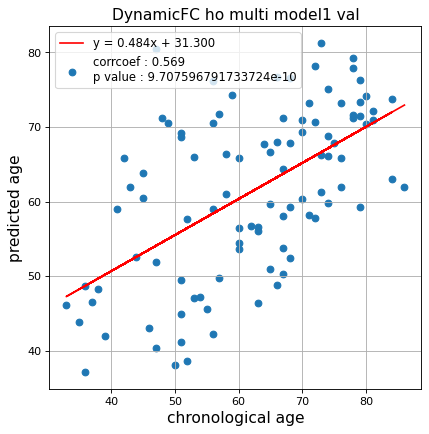

切片: 31.300008906468527
傾き: 0.48402510121909986
Kfold: 5 ::: epoch: 100, loss: 0.04243149207188533, val loss: 1.0915021002292633
Kfold: 5 ::: epoch: 200, loss: 0.02136516420600506, val loss: 1.1011860370635986
Kfold: 5 ::: epoch: 300, loss: 0.017513869903408565, val loss: 1.1227853000164032
Kfold: 5 ::: epoch: 400, loss: 0.014262155056572877, val loss: 1.1027162969112396
early stopping
save_epochs:263
best val loss:1.0539387911558151


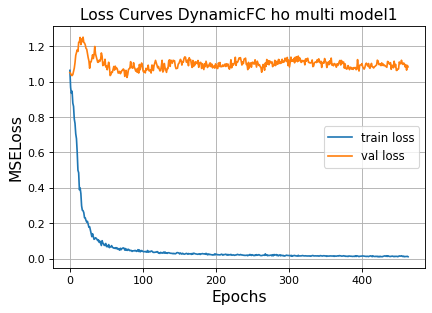

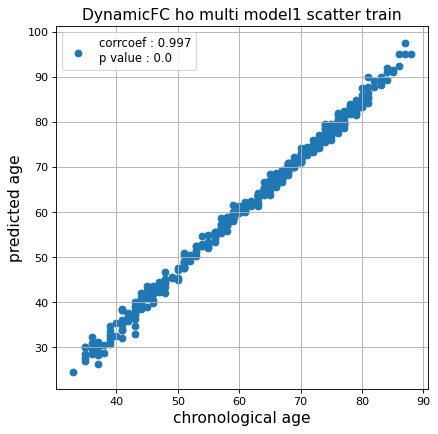

r^2 train data:  0.9221045715905982


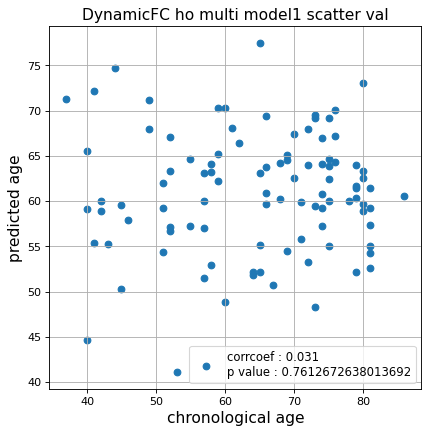

r^2 val data:  -0.31905800671345586


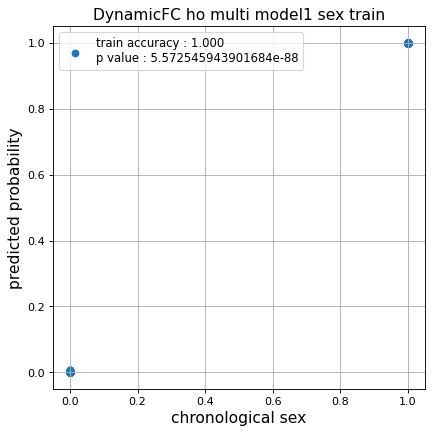

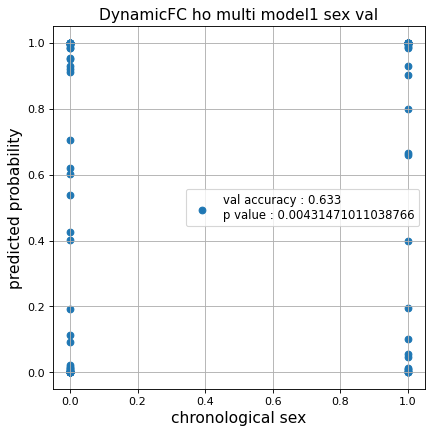

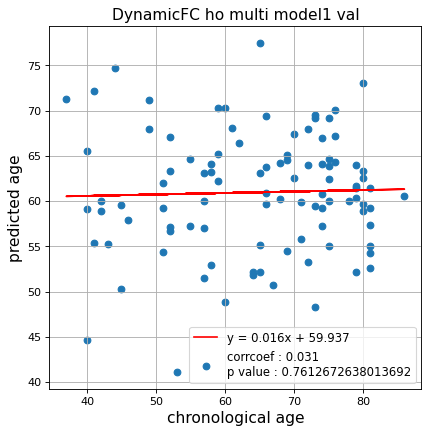

切片: 59.93720973627053
傾き: 0.016101616146745136
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.054825429732982926, val loss: 0.5921530723571777
Kfold: 1 ::: epoch: 200, loss: 0.023348291762746297, val loss: 0.4934360571205616
Kfold: 1 ::: epoch: 300, loss: 0.012252337048546625, val loss: 0.4983530417084694
Kfold: 1 ::: epoch: 400, loss: 0.00888297208943046, val loss: 0.4565473385155201
Kfold: 1 ::: epoch: 500, loss: 0.007346841220099192, val loss: 0.4514843448996544
Kfold: 1 ::: epoch: 600, loss: 0.0072550833261070344, val loss: 0.43408071249723434
Kfold: 1 ::: epoch: 700, loss: 0.0056736215483397245, val loss: 0.4374235272407532
save_epochs:565
best val loss:0.42300664260983467


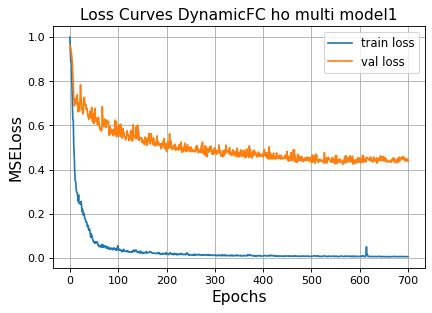

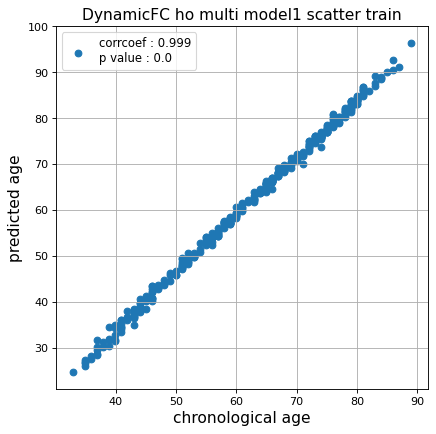

r^2 train data:  0.9312837434062459


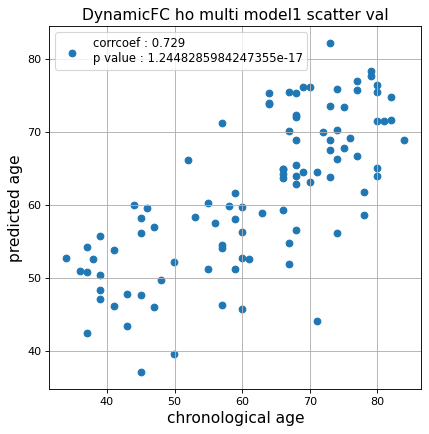

r^2 val data:  0.5289088714326479


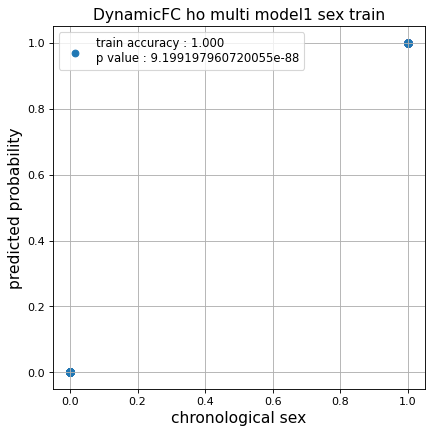

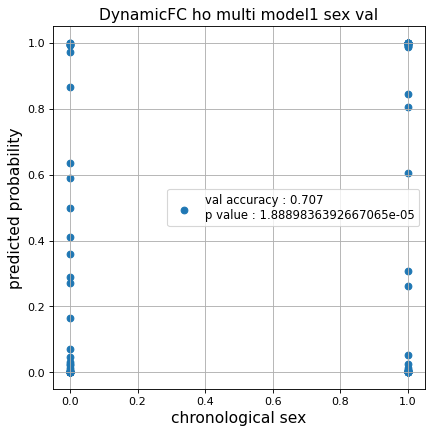

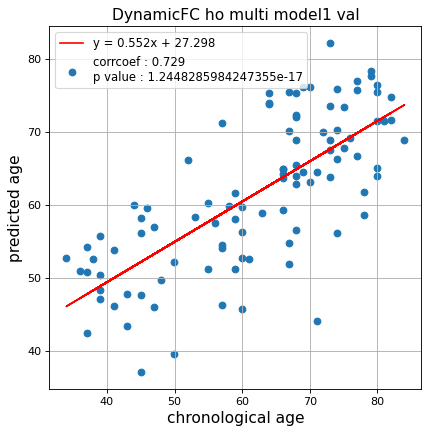

切片: 27.298215287262764
傾き: 0.5522372419357023
Kfold: 2 ::: epoch: 100, loss: 0.04961881643304458, val loss: 0.964572548866272
Kfold: 2 ::: epoch: 200, loss: 0.022090611836084954, val loss: 0.9065263867378235
Kfold: 2 ::: epoch: 300, loss: 0.017276714985760357, val loss: 0.8657026290893555
Kfold: 2 ::: epoch: 400, loss: 0.013217429702098552, val loss: 0.8211789429187775
Kfold: 2 ::: epoch: 500, loss: 0.010253350966824936, val loss: 0.81633260846138
Kfold: 2 ::: epoch: 600, loss: 0.008160725128478728, val loss: 0.7889074385166168
Kfold: 2 ::: epoch: 700, loss: 0.0068239363877532575, val loss: 0.7869405746459961
save_epochs:638
best val loss:0.7473414838314056


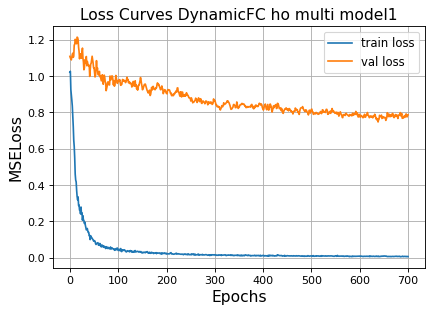

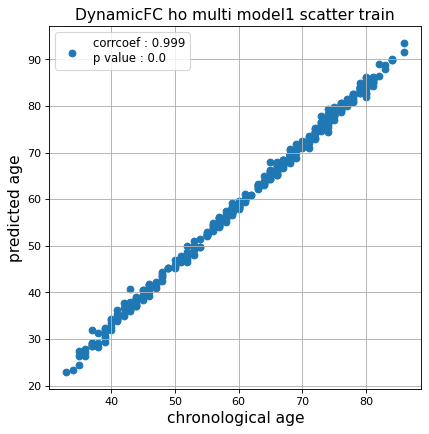

r^2 train data:  0.9105412628506769


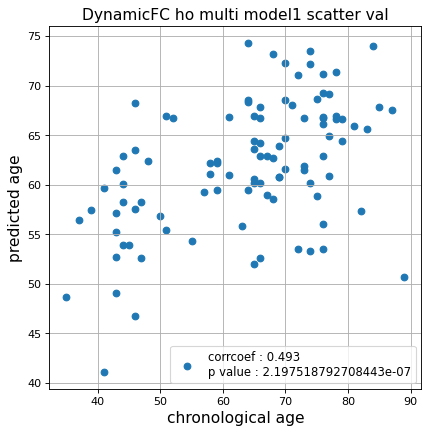

r^2 val data:  0.2230603442147493


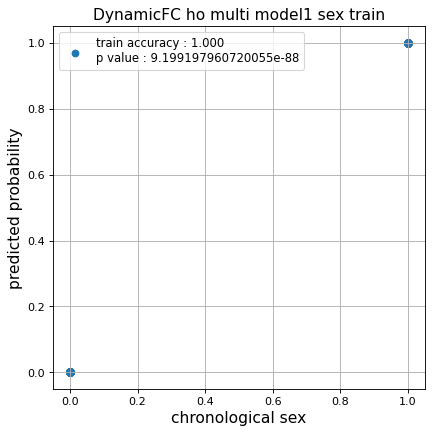

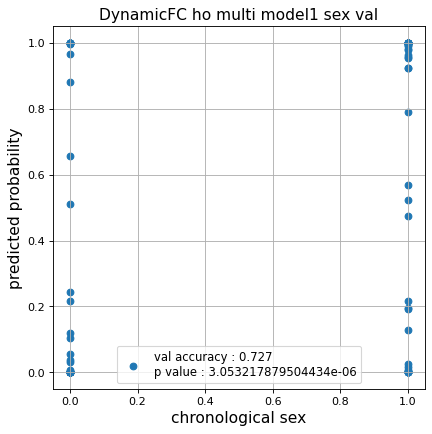

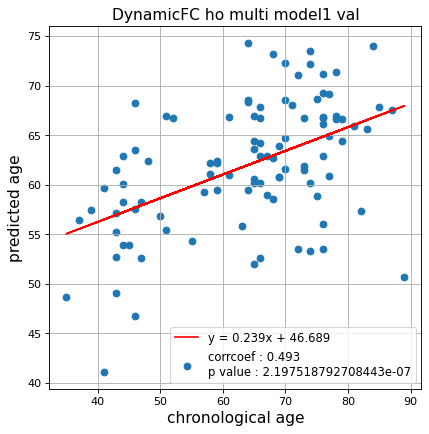

切片: 46.6889101078568
傾き: 0.23907112361374527
Kfold: 3 ::: epoch: 100, loss: 0.037120153267796226, val loss: 0.5280685406178236
Kfold: 3 ::: epoch: 200, loss: 0.01720866410491558, val loss: 0.47516100481152534
Kfold: 3 ::: epoch: 300, loss: 0.012870655359270481, val loss: 0.4493607170879841
Kfold: 3 ::: epoch: 400, loss: 0.008540229728588691, val loss: 0.4527831422165036
Kfold: 3 ::: epoch: 500, loss: 0.0063402105946666915, val loss: 0.4366889735683799
Kfold: 3 ::: epoch: 600, loss: 0.007074759843257757, val loss: 0.44388832338154316
Kfold: 3 ::: epoch: 700, loss: 0.006140417688024731, val loss: 0.4307036707177758
save_epochs:512
best val loss:0.4219567785039544


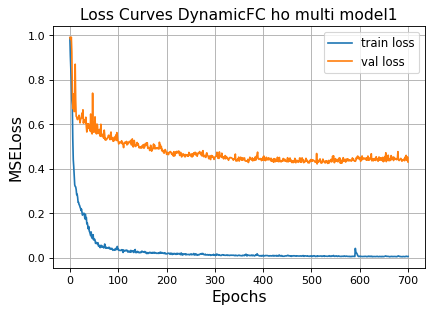

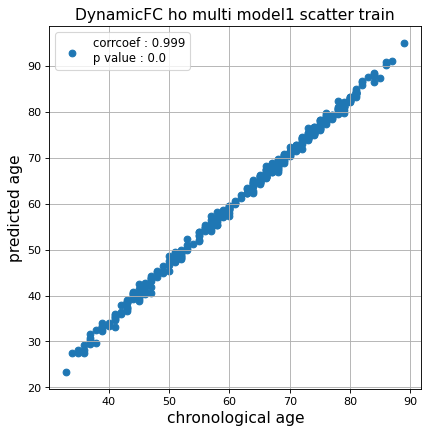

r^2 train data:  0.9475429498561904


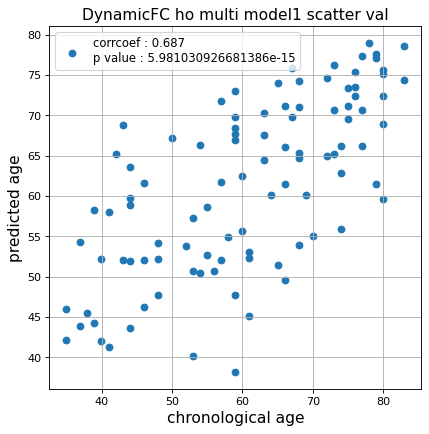

r^2 val data:  0.45772946629114575


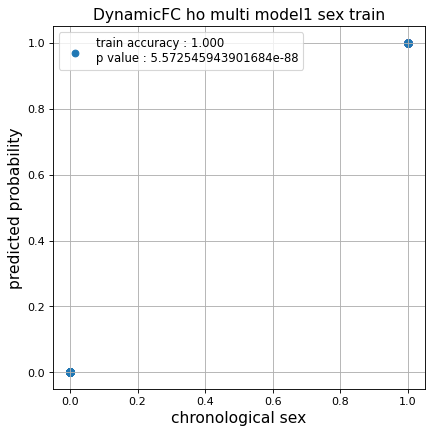

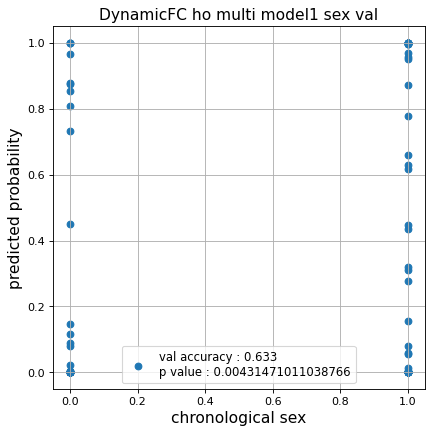

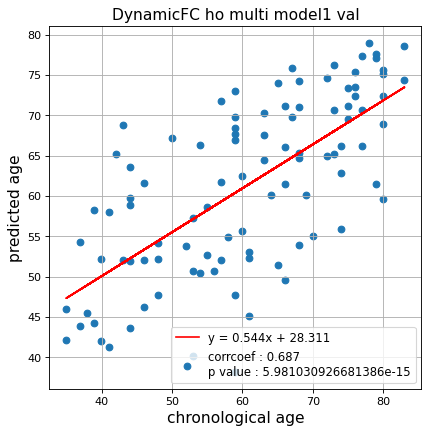

切片: 28.310669056447324
傾き: 0.544171878251925
Kfold: 4 ::: epoch: 100, loss: 0.040743616911081165, val loss: 1.3254192471504211
Kfold: 4 ::: epoch: 200, loss: 0.01964299839276534, val loss: 1.3726970106363297
Kfold: 4 ::: epoch: 300, loss: 0.01286408663369142, val loss: 1.3421428799629211
Kfold: 4 ::: epoch: 400, loss: 0.009115551168528887, val loss: 1.3442245423793793
Kfold: 4 ::: epoch: 500, loss: 0.007779569633734914, val loss: 1.2838740646839142
Kfold: 4 ::: epoch: 600, loss: 0.006462248651167521, val loss: 1.1637476086616516
Kfold: 4 ::: epoch: 700, loss: 0.005417557809358606, val loss: 1.179196074604988
save_epochs:553
best val loss:1.1259981095790863


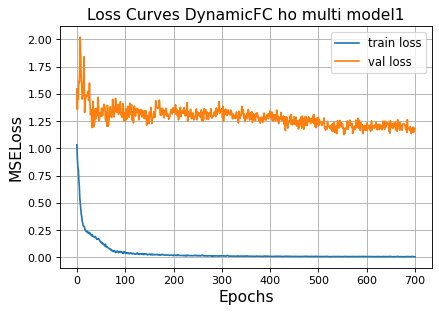

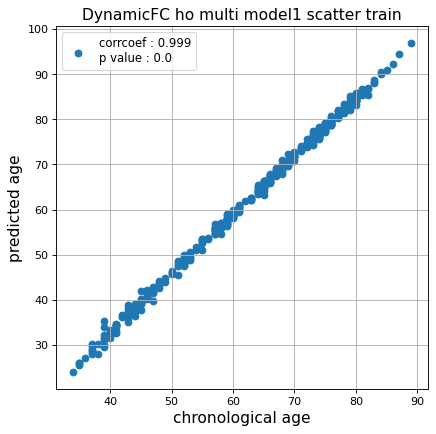

r^2 train data:  0.9092908197880881


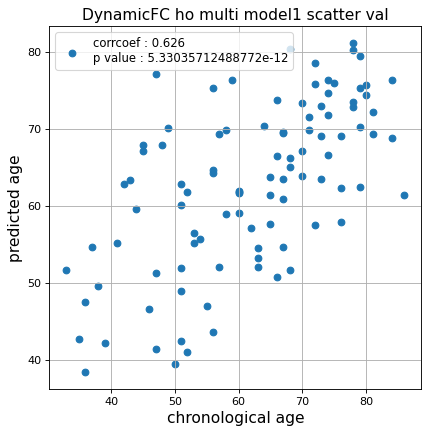

r^2 val data:  0.35838926910906344


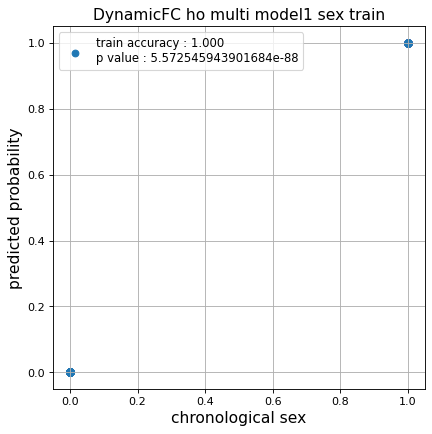

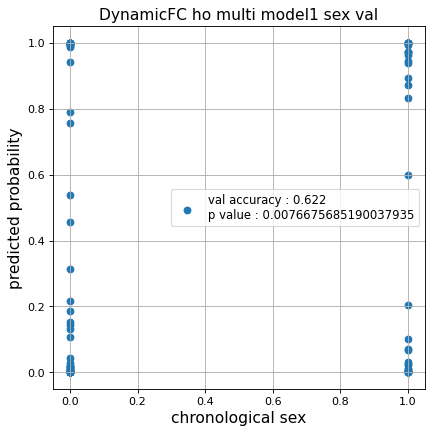

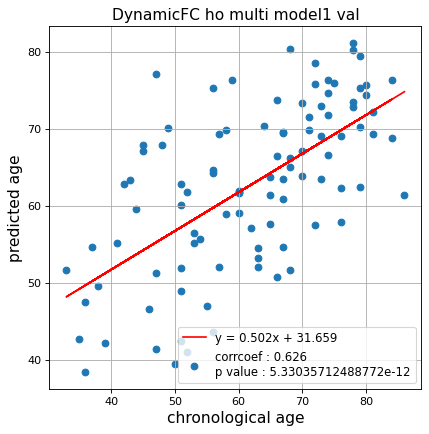

切片: 31.6589795695298
傾き: 0.5018047928052769
Kfold: 5 ::: epoch: 100, loss: 0.0423922583174247, val loss: 1.0115526616573334
Kfold: 5 ::: epoch: 200, loss: 0.022137317161720533, val loss: 0.9956802427768707
Kfold: 5 ::: epoch: 300, loss: 0.01713552035821172, val loss: 0.9417205154895782
Kfold: 5 ::: epoch: 400, loss: 0.013919074159975234, val loss: 0.903755821287632
Kfold: 5 ::: epoch: 500, loss: 0.008668783729752669, val loss: 0.8165684752166271
Kfold: 5 ::: epoch: 600, loss: 0.009361386191673003, val loss: 0.7781665176153183
Kfold: 5 ::: epoch: 700, loss: 0.008458689177552095, val loss: 0.7453566268086433
save_epochs:694
best val loss:0.7203132659196854


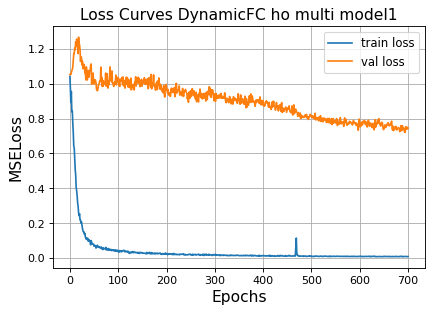

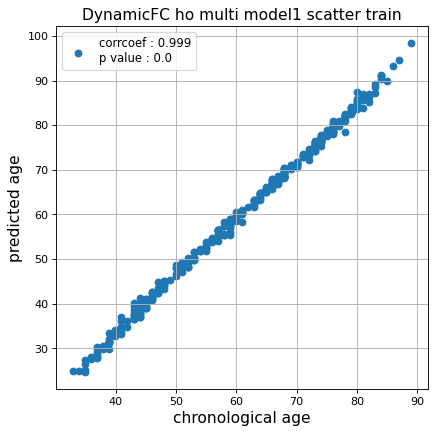

r^2 train data:  0.9198486996200947


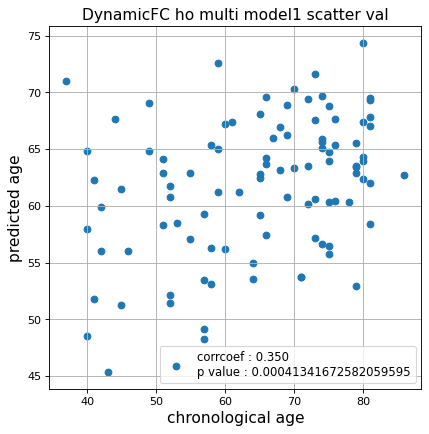

r^2 val data:  0.05806195037524042


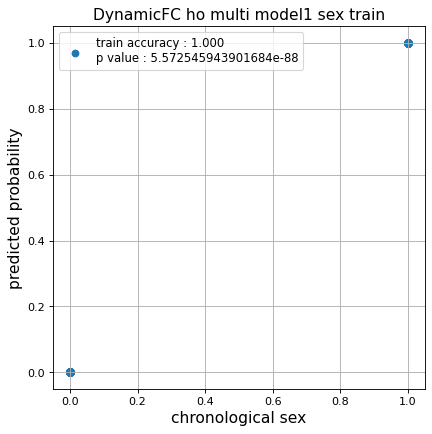

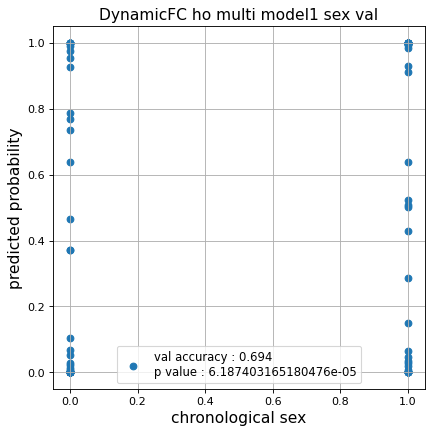

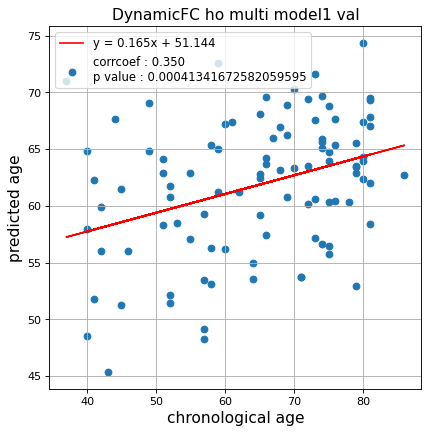

切片: 51.14371637764889
傾き: 0.16501062103185982
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.04745085064608317, val loss: 0.7285858988761902
Kfold: 1 ::: epoch: 200, loss: 0.022967002354562283, val loss: 0.6143499091267586
Kfold: 1 ::: epoch: 300, loss: 0.01118803035038022, val loss: 0.592779316008091
Kfold: 1 ::: epoch: 400, loss: 0.010228633665694641, val loss: 0.5741586908698082
Kfold: 1 ::: epoch: 500, loss: 0.006799166216156804, val loss: 0.5634661540389061
Kfold: 1 ::: epoch: 600, loss: 0.006908129435032606, val loss: 0.5394499748945236
Kfold: 1 ::: epoch: 700, loss: 0.006141593035023946, val loss: 0.5597919821739197
save_epochs:665
best val loss:0.5261209234595299


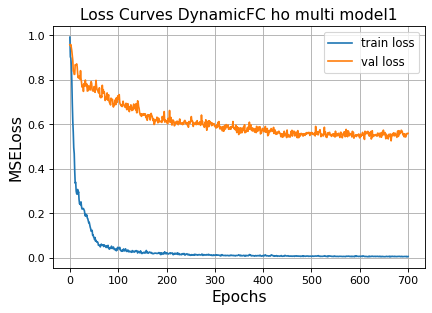

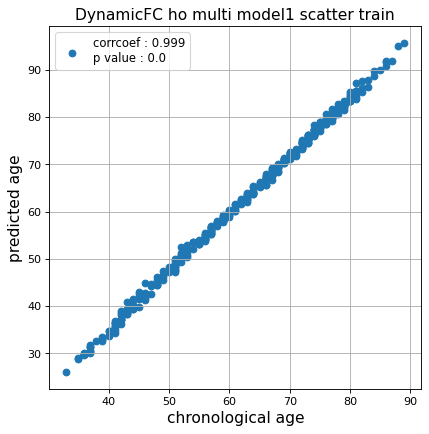

r^2 train data:  0.9481458892510883


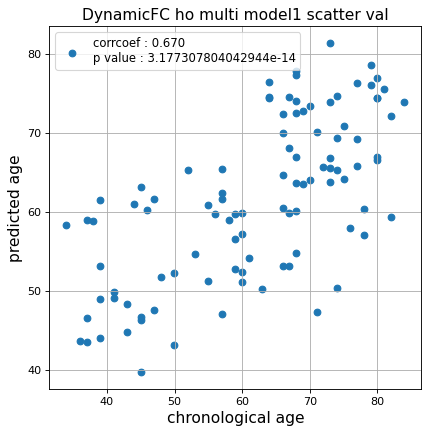

r^2 val data:  0.44282930728173475


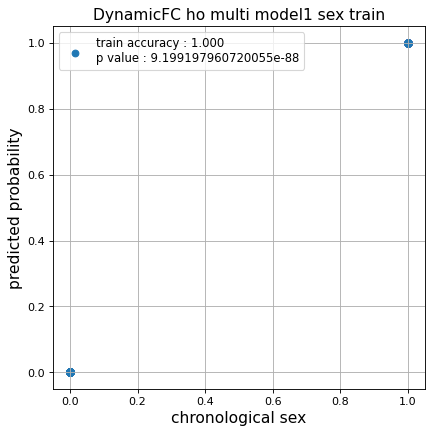

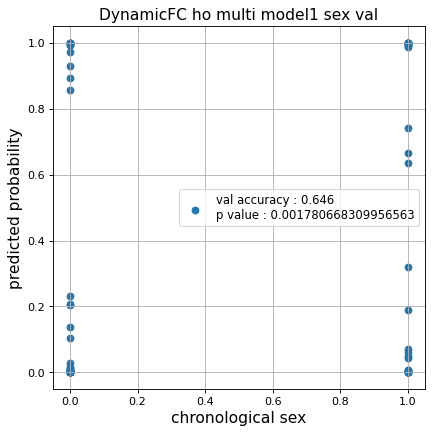

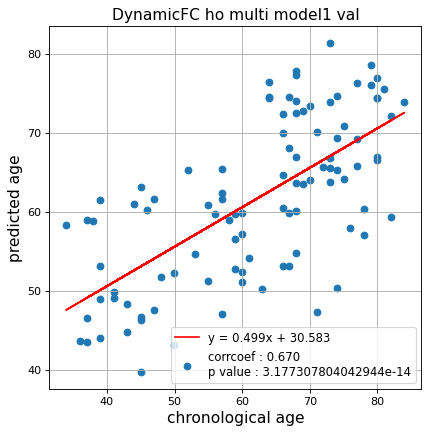

切片: 30.582537416085557
傾き: 0.49947289860238175
Kfold: 2 ::: epoch: 100, loss: 0.04726427249037302, val loss: 0.8869429845362902
Kfold: 2 ::: epoch: 200, loss: 0.019088267706907712, val loss: 0.8163431510329247
Kfold: 2 ::: epoch: 300, loss: 0.017224752594931766, val loss: 0.7658977042883635
Kfold: 2 ::: epoch: 400, loss: 0.01150120053297052, val loss: 0.7286413423717022
Kfold: 2 ::: epoch: 500, loss: 0.009428784287033172, val loss: 0.6710677780210972
Kfold: 2 ::: epoch: 600, loss: 0.007122291825138605, val loss: 0.6454247236251831
Kfold: 2 ::: epoch: 700, loss: 0.005911213184635227, val loss: 0.6161569803953171
save_epochs:688
best val loss:0.6054945923388004


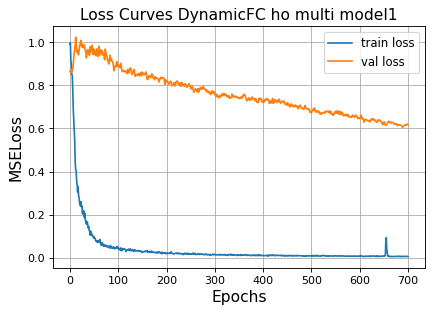

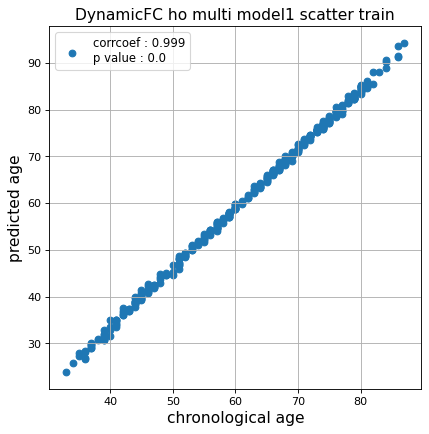

r^2 train data:  0.9242837708505307


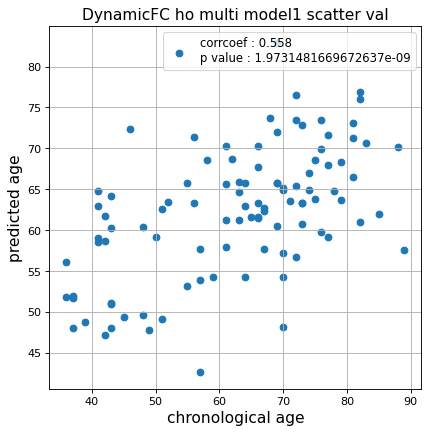

r^2 val data:  0.31058458324701177


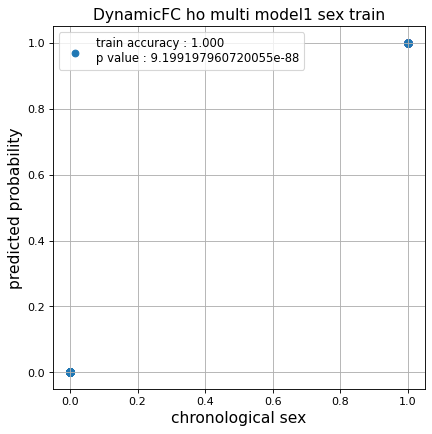

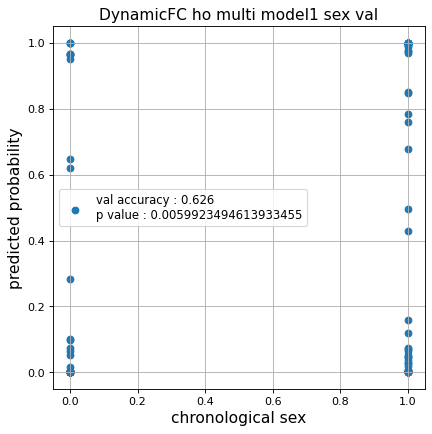

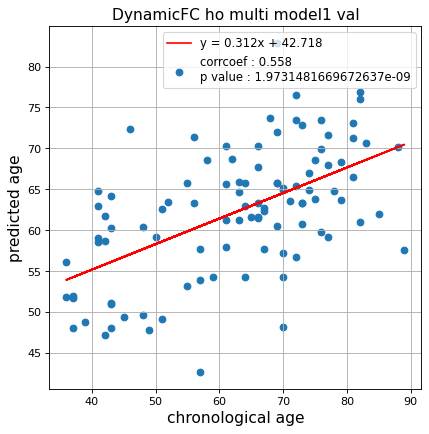

切片: 42.71823546490812
傾き: 0.31188590292605833
Kfold: 3 ::: epoch: 100, loss: 0.03446523787883612, val loss: 0.5444571645930409
Kfold: 3 ::: epoch: 200, loss: 0.018863308458374098, val loss: 0.4960477012209594
Kfold: 3 ::: epoch: 300, loss: 0.012453418654891161, val loss: 0.4719939490314573
Kfold: 3 ::: epoch: 400, loss: 0.008193343197210478, val loss: 0.4947741338983178
Kfold: 3 ::: epoch: 500, loss: 0.00678410090935918, val loss: 0.4763444447889924
Kfold: 3 ::: epoch: 600, loss: 0.007606223977815647, val loss: 0.46582984551787376
early stopping
save_epochs:401
best val loss:0.4559986492386088


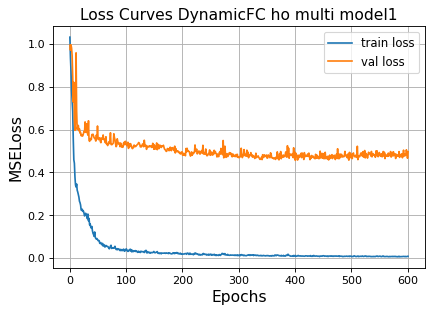

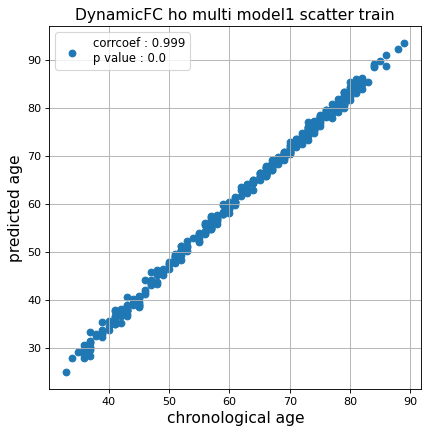

r^2 train data:  0.9507502945712164


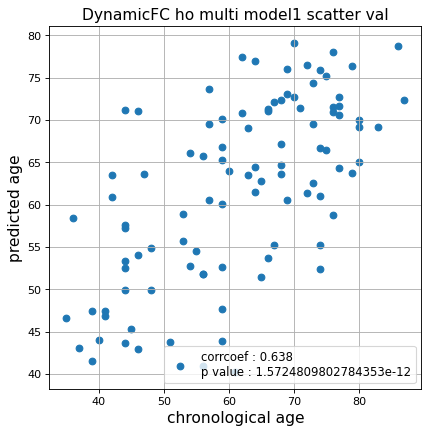

r^2 val data:  0.3800369173931005


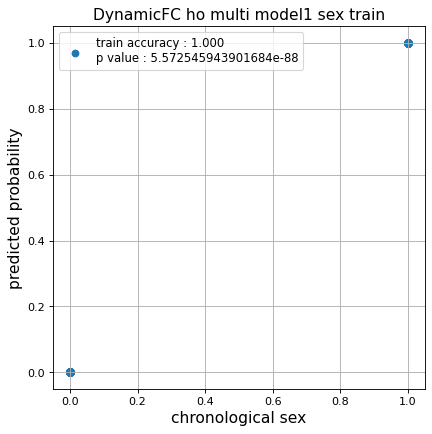

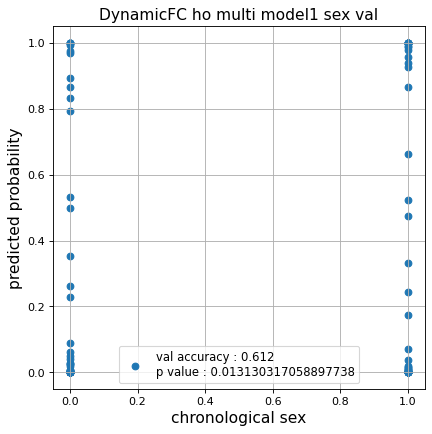

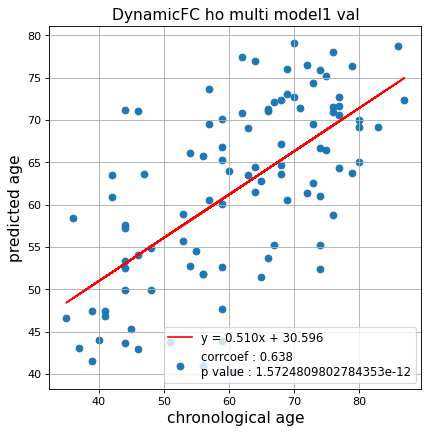

切片: 30.59649185812634
傾き: 0.509769920725373
Kfold: 4 ::: epoch: 100, loss: 0.03314003620583277, val loss: 1.0036333873867989
Kfold: 4 ::: epoch: 200, loss: 0.019784747837827757, val loss: 1.0255915820598602
Kfold: 4 ::: epoch: 300, loss: 0.01285897446079896, val loss: 1.014080934226513
Kfold: 4 ::: epoch: 400, loss: 0.009602245426951693, val loss: 1.0950879082083702
early stopping
save_epochs:244
best val loss:0.9557867348194122


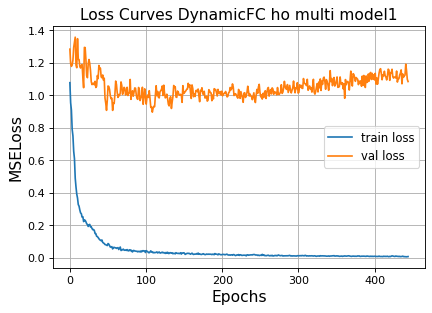

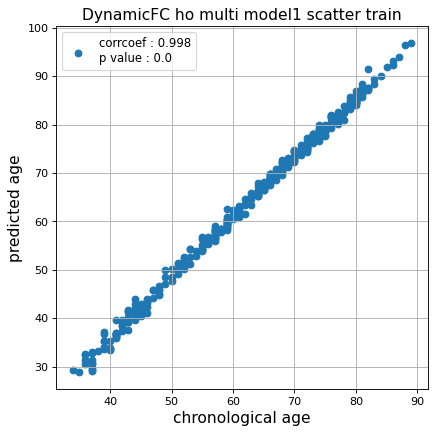

r^2 train data:  0.9242828941222


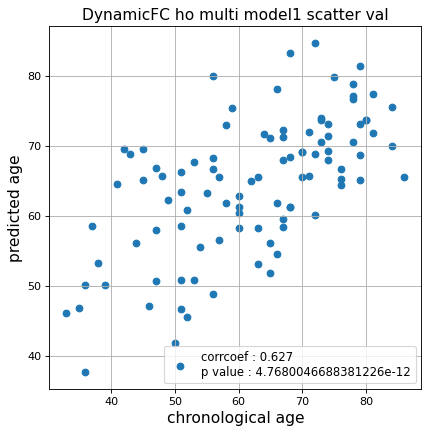

r^2 val data:  0.3510077926985591


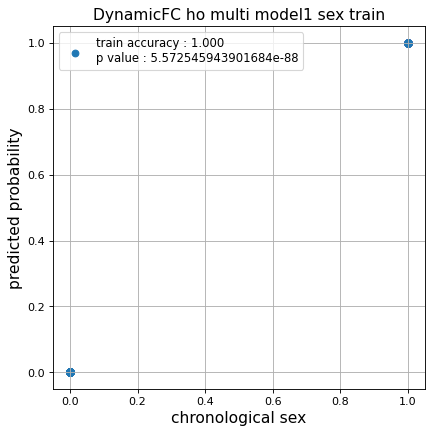

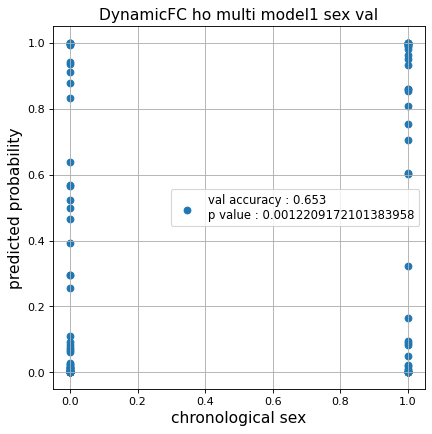

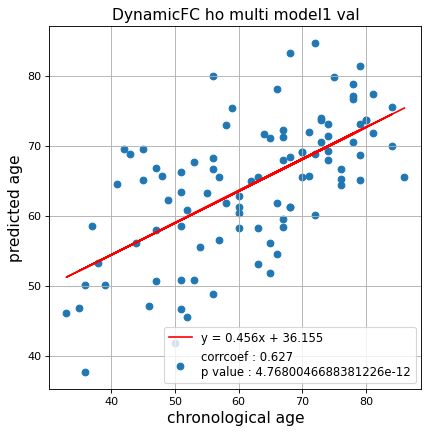

切片: 36.155330433202586
傾き: 0.4560042596939217
Kfold: 5 ::: epoch: 100, loss: 0.04567851011569683, val loss: 1.2153698801994324
Kfold: 5 ::: epoch: 200, loss: 0.014975582536023397, val loss: 1.2006360441446304
Kfold: 5 ::: epoch: 300, loss: 0.012600494477038201, val loss: 1.1182764768600464
Kfold: 5 ::: epoch: 400, loss: 0.008228790731384205, val loss: 1.1030316054821014
Kfold: 5 ::: epoch: 500, loss: 0.006807058386934491, val loss: 1.1032374799251556
Kfold: 5 ::: epoch: 600, loss: 0.004657285668564817, val loss: 1.036471426486969
Kfold: 5 ::: epoch: 700, loss: 0.004808986093848944, val loss: 1.0421500205993652
save_epochs:692
best val loss:1.0192874819040298


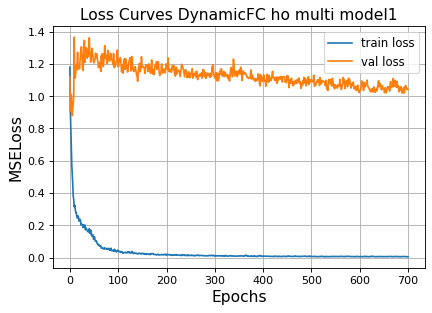

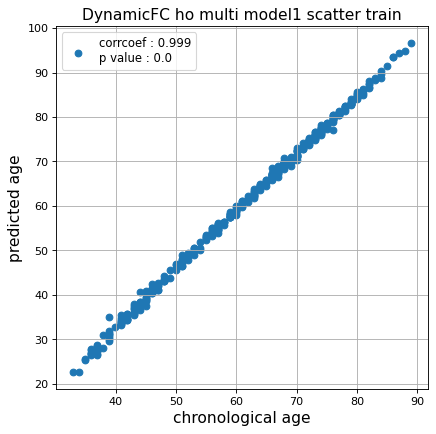

r^2 train data:  0.9033643403642175


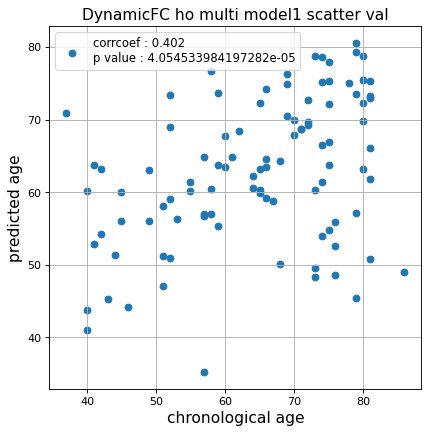

r^2 val data:  -0.0015331670541376408


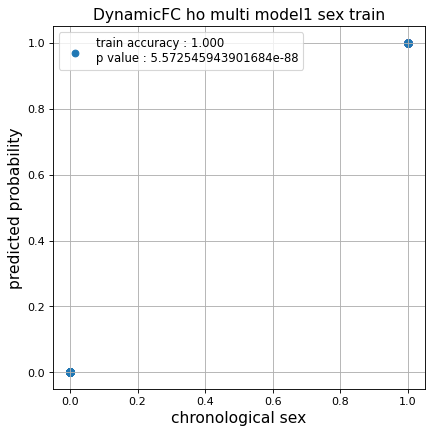

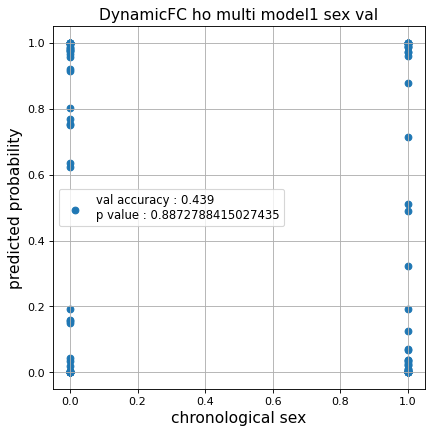

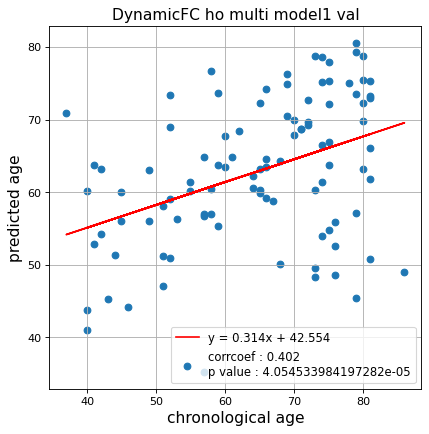

切片: 42.55427630209414
傾き: 0.31396822763879295
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.03900619066105439, val loss: 0.6190688610076904
Kfold: 1 ::: epoch: 200, loss: 0.021968079086106557, val loss: 0.5560169368982315
Kfold: 1 ::: epoch: 300, loss: 0.012116812518797815, val loss: 0.510164387524128
Kfold: 1 ::: epoch: 400, loss: 0.010741026749691138, val loss: 0.4867337495088577
Kfold: 1 ::: epoch: 500, loss: 0.006809840695216105, val loss: 0.4694025218486786
Kfold: 1 ::: epoch: 600, loss: 0.006583402184053109, val loss: 0.4525771960616112
Kfold: 1 ::: epoch: 700, loss: 0.006367901501317437, val loss: 0.4708809331059456
save_epochs:654
best val loss:0.44456207752227783


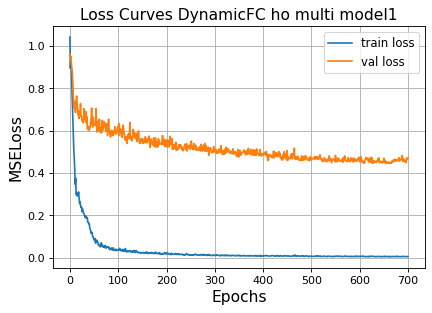

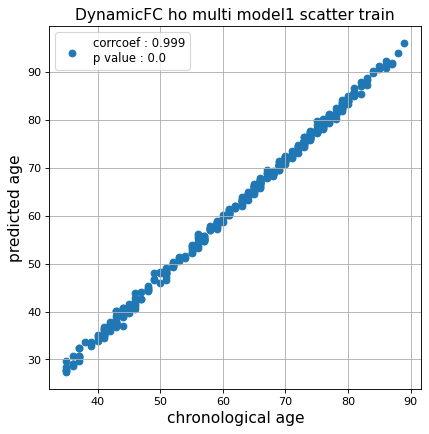

r^2 train data:  0.9408067998722761


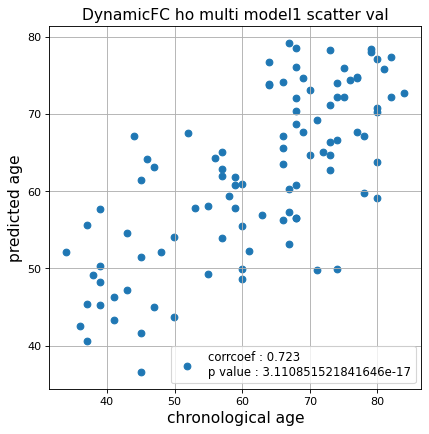

r^2 val data:  0.5186295266217593


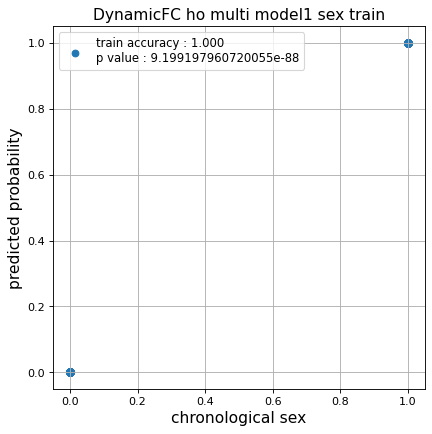

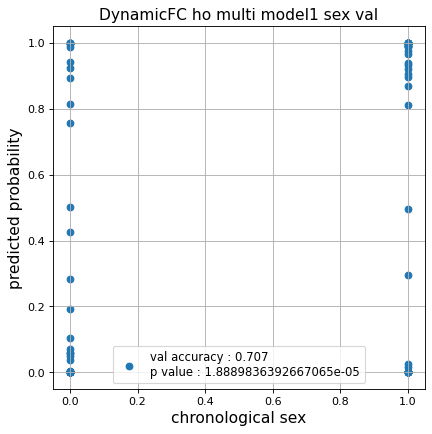

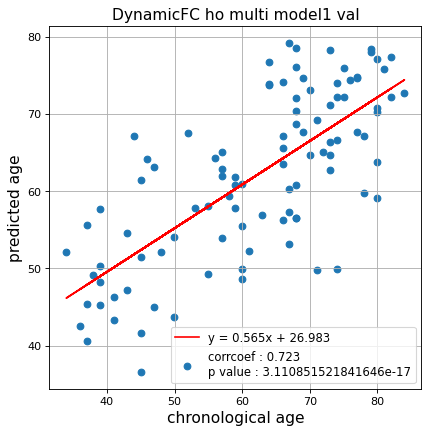

切片: 26.983335273094625
傾き: 0.5645872613991694
Kfold: 2 ::: epoch: 100, loss: 0.05029438292750946, val loss: 0.9537318050861359
Kfold: 2 ::: epoch: 200, loss: 0.02345260218358957, val loss: 0.8495708052068949
Kfold: 2 ::: epoch: 300, loss: 0.017544651260742776, val loss: 0.7980642220936716
Kfold: 2 ::: epoch: 400, loss: 0.012297231775636856, val loss: 0.7490050680935383
Kfold: 2 ::: epoch: 500, loss: 0.009536252751086768, val loss: 0.6904908893629909
Kfold: 2 ::: epoch: 600, loss: 0.007063092019122381, val loss: 0.6407270487397909
Kfold: 2 ::: epoch: 700, loss: 0.006560453894333198, val loss: 0.6090309545397758
save_epochs:700
best val loss:0.6090309545397758


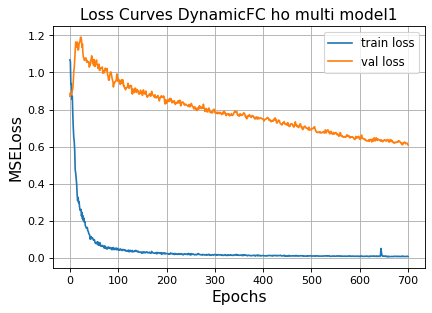

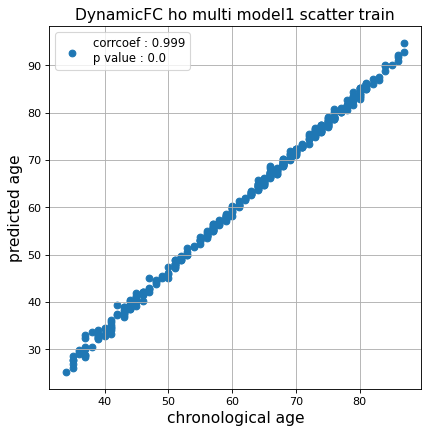

r^2 train data:  0.9328752239824255


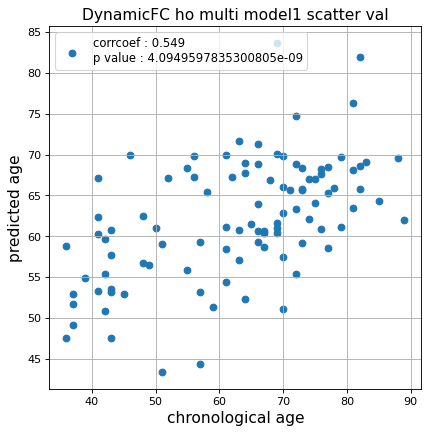

r^2 val data:  0.2991240047745447


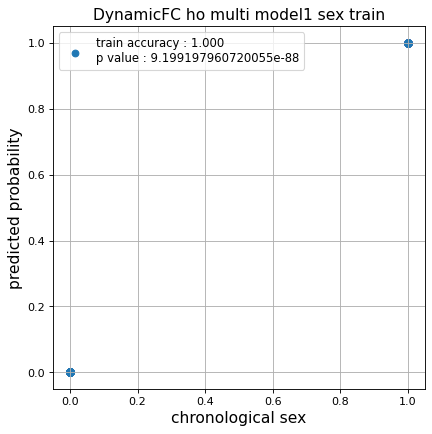

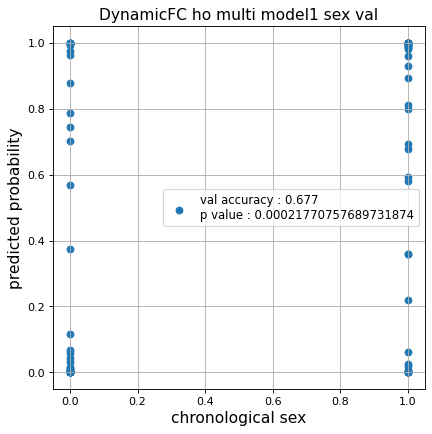

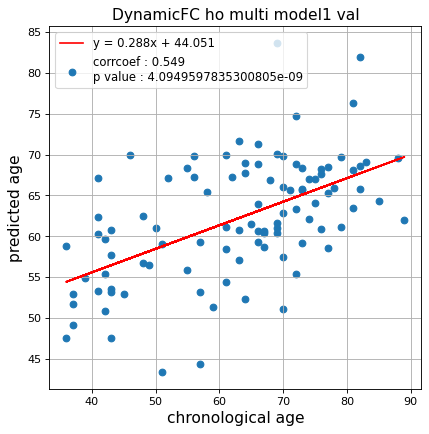

切片: 44.05146828988062
傾き: 0.2882249651550889
Kfold: 3 ::: epoch: 100, loss: 0.03610890659575279, val loss: 0.5284234844148159
Kfold: 3 ::: epoch: 200, loss: 0.019744887948036194, val loss: 0.5302692353725433
Kfold: 3 ::: epoch: 300, loss: 0.011656920819614943, val loss: 0.5749904662370682
Kfold: 3 ::: epoch: 400, loss: 0.007464514400523443, val loss: 0.5938441604375839
early stopping
save_epochs:203
best val loss:0.5249356180429459


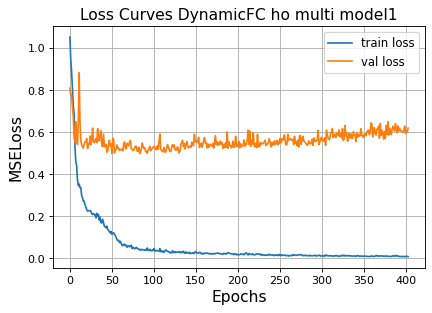

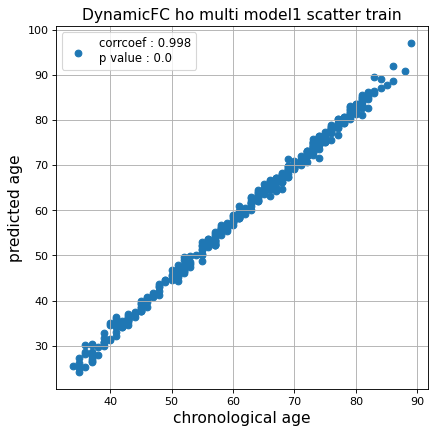

r^2 train data:  0.913484356456199


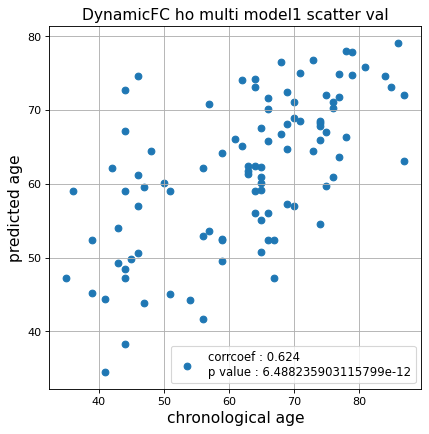

r^2 val data:  0.36600181454738234


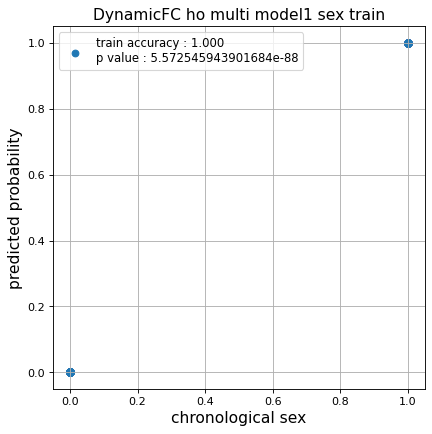

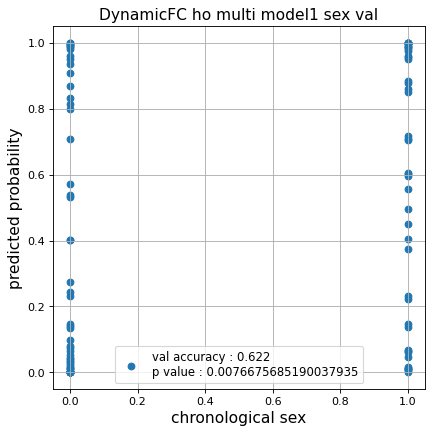

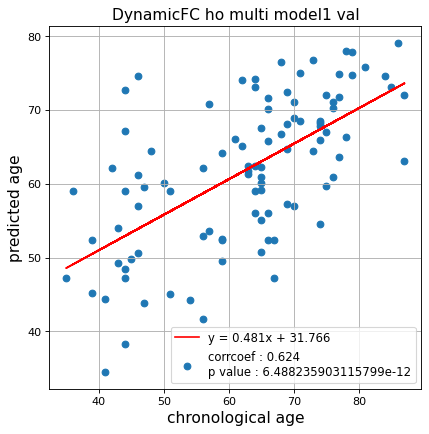

切片: 31.766097342354442
傾き: 0.4812349421004552
Kfold: 4 ::: epoch: 100, loss: 0.036571895417112574, val loss: 1.0147901773452759
Kfold: 4 ::: epoch: 200, loss: 0.017118393801725827, val loss: 0.9180492758750916
Kfold: 4 ::: epoch: 300, loss: 0.01044026049427115, val loss: 1.0033389553427696
Kfold: 4 ::: epoch: 400, loss: 0.00833573649959782, val loss: 0.9541063606739044
early stopping
save_epochs:213
best val loss:0.9016217589378357


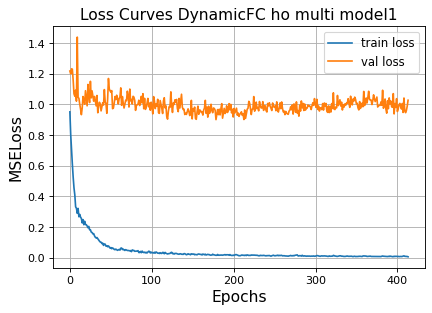

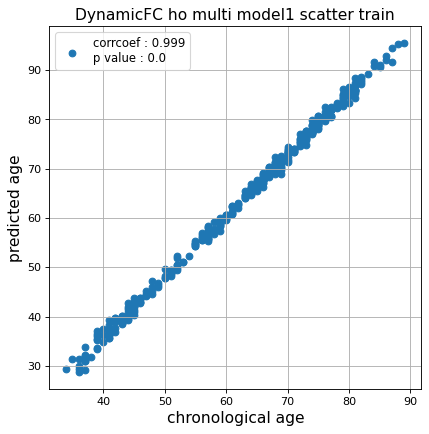

r^2 train data:  0.9314151139033782


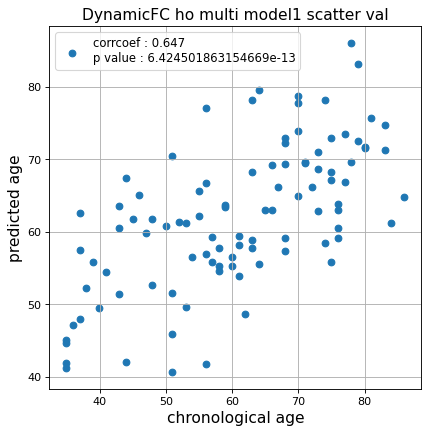

r^2 val data:  0.4061905265101715


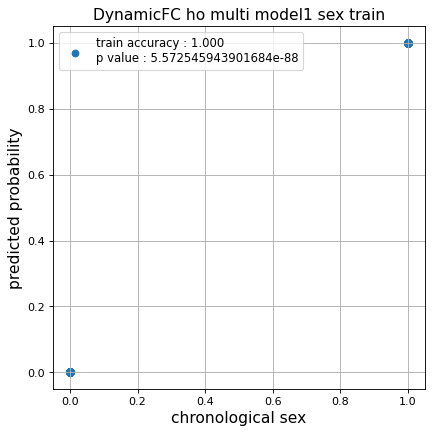

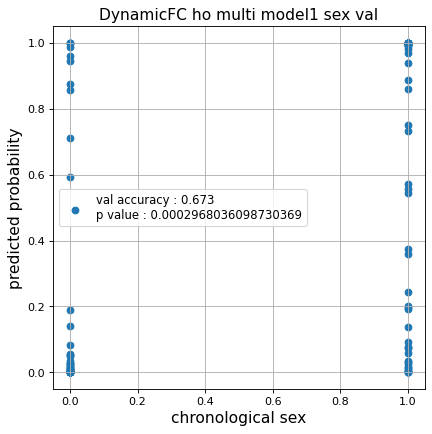

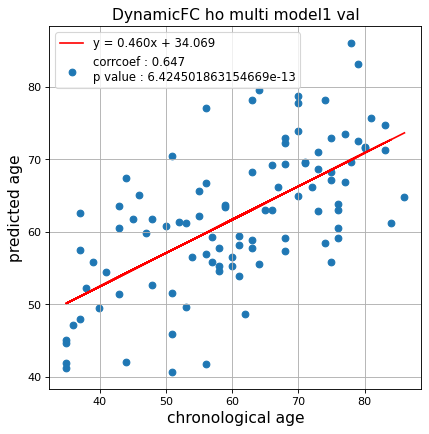

切片: 34.0689533461978
傾き: 0.45991512637516185
Kfold: 5 ::: epoch: 100, loss: 0.03427176507046589, val loss: 1.0351037085056305
Kfold: 5 ::: epoch: 200, loss: 0.01989008106577855, val loss: 0.8270701169967651
Kfold: 5 ::: epoch: 300, loss: 0.016693468707112167, val loss: 0.8439748883247375
Kfold: 5 ::: epoch: 400, loss: 0.013914154555935126, val loss: 0.7482286244630814
Kfold: 5 ::: epoch: 500, loss: 0.008983260593735255, val loss: 0.7645869106054306
Kfold: 5 ::: epoch: 600, loss: 0.006359638091033468, val loss: 0.739473894238472
Kfold: 5 ::: epoch: 700, loss: 0.005715677729592874, val loss: 0.7085753530263901
save_epochs:576
best val loss:0.6969452649354935


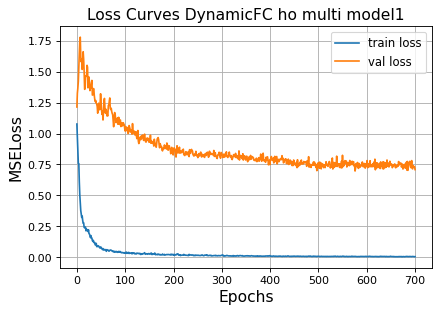

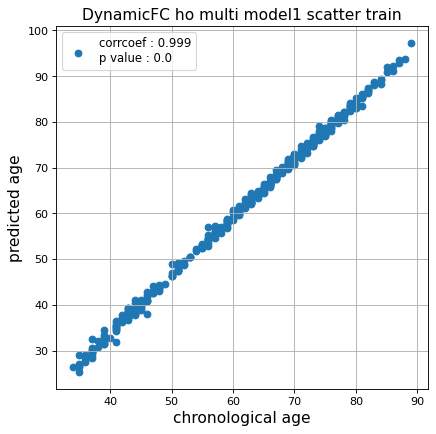

r^2 train data:  0.9271416975594547


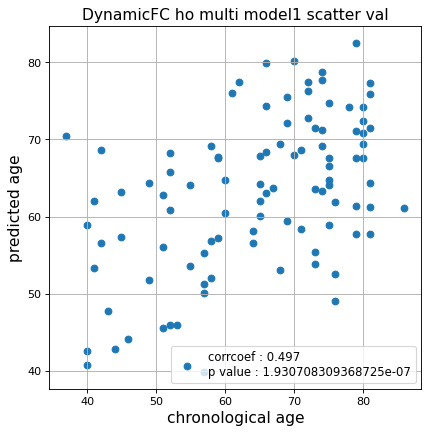

r^2 val data:  0.1592953137880142


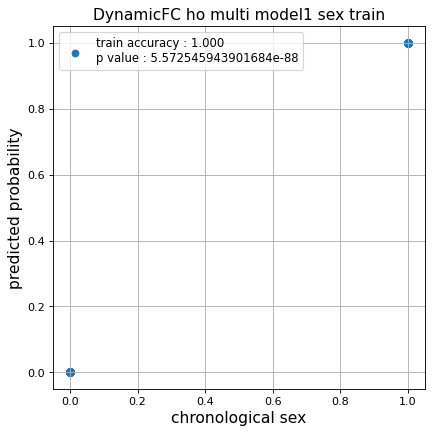

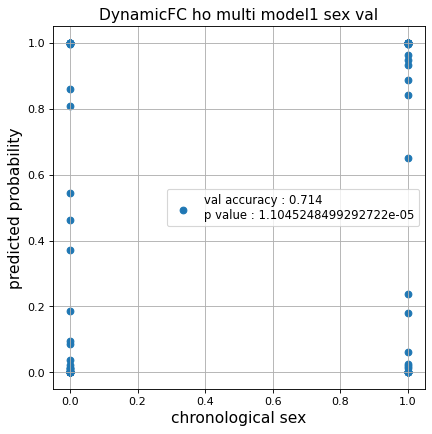

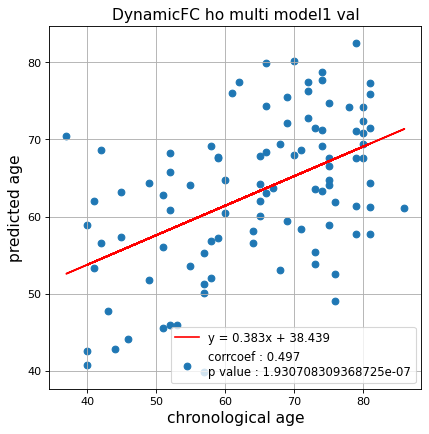

切片: 38.43910798077373
傾き: 0.3827370451930738
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.03581041928667288, val loss: 0.535493902862072
Kfold: 1 ::: epoch: 200, loss: 0.020974376453803137, val loss: 0.49471522867679596
Kfold: 1 ::: epoch: 300, loss: 0.011497385038707692, val loss: 0.4797923043370247
Kfold: 1 ::: epoch: 400, loss: 0.012102889434362833, val loss: 0.4778320789337158
Kfold: 1 ::: epoch: 500, loss: 0.0076484221141212266, val loss: 0.47984225302934647
Kfold: 1 ::: epoch: 600, loss: 0.006168056315240951, val loss: 0.4847336411476135
early stopping
save_epochs:443
best val loss:0.4583136737346649


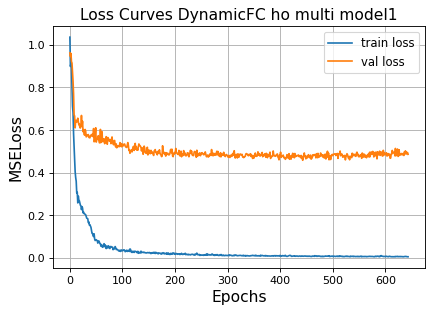

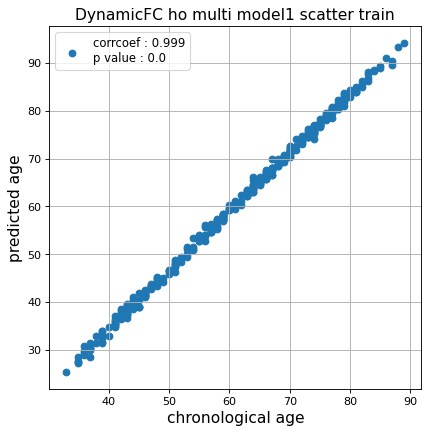

r^2 train data:  0.9447508341252597


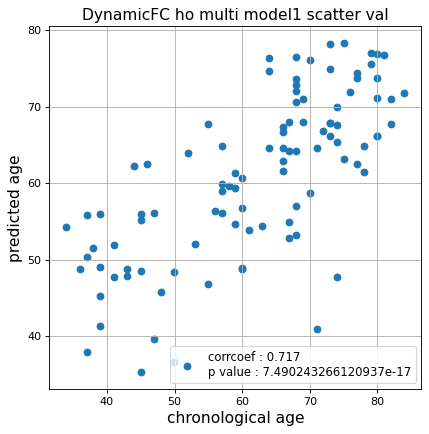

r^2 val data:  0.5034369794211412


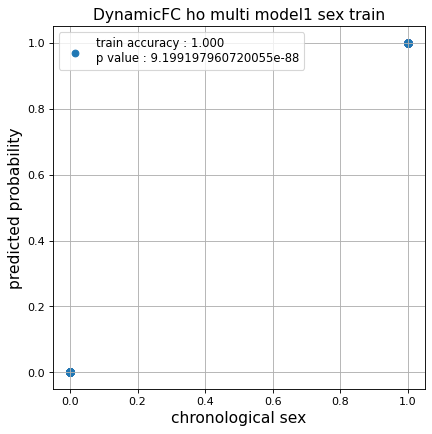

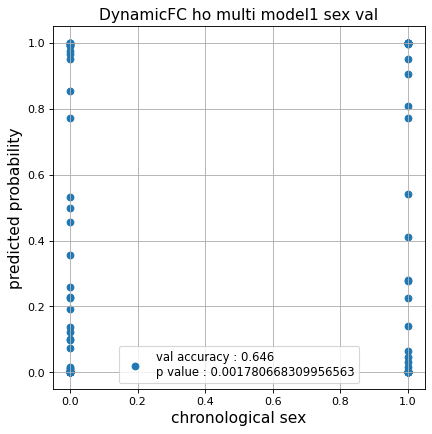

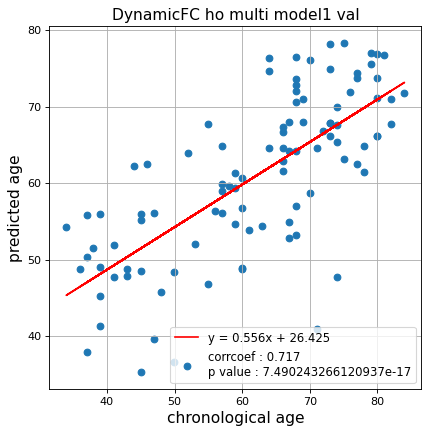

切片: 26.424847047082736
傾き: 0.5562501330147466
Kfold: 2 ::: epoch: 100, loss: 0.03241592516692785, val loss: 0.7035451233386993
Kfold: 2 ::: epoch: 200, loss: 0.01557792300501695, val loss: 0.6546109691262245
Kfold: 2 ::: epoch: 300, loss: 0.012304738343048554, val loss: 0.6211433559656143
Kfold: 2 ::: epoch: 400, loss: 0.011469314806163311, val loss: 0.5925266072154045
Kfold: 2 ::: epoch: 500, loss: 0.006425019192437713, val loss: 0.5876923203468323
Kfold: 2 ::: epoch: 600, loss: 0.008509946091530414, val loss: 0.5835230350494385
Kfold: 2 ::: epoch: 700, loss: 0.005823729237398276, val loss: 0.5726852715015411
save_epochs:679
best val loss:0.5536641702055931


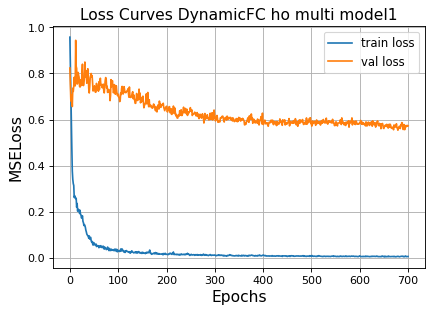

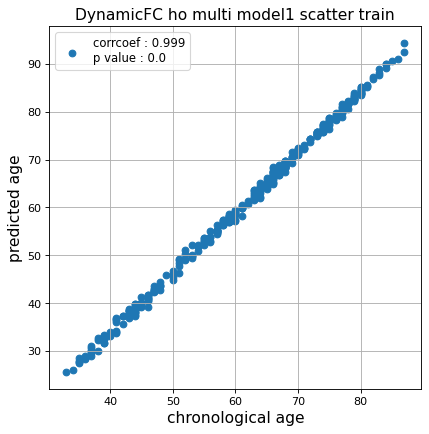

r^2 train data:  0.9302832874353729


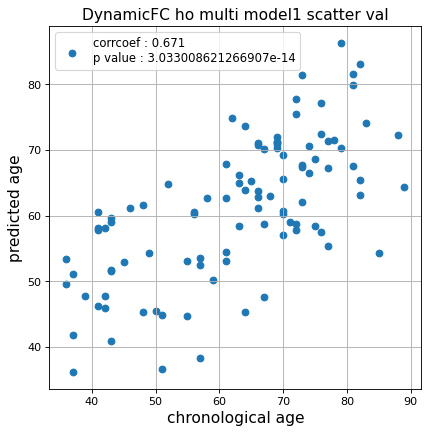

r^2 val data:  0.4297745123328064


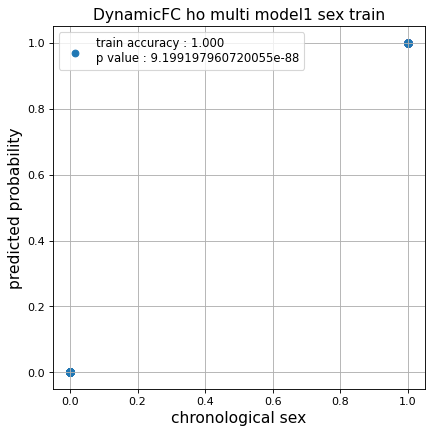

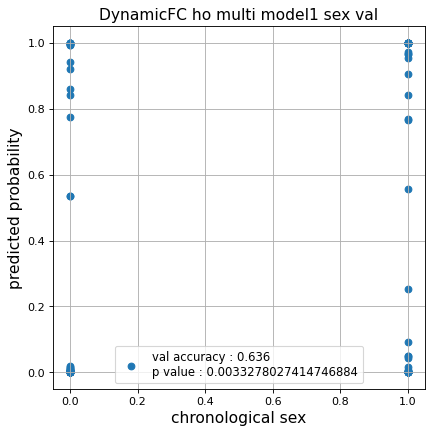

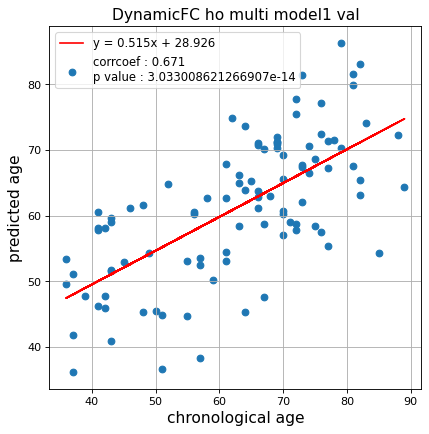

切片: 28.92647833553233
傾き: 0.514720518448506
Kfold: 3 ::: epoch: 100, loss: 0.031475277474293344, val loss: 0.7594699189066887
Kfold: 3 ::: epoch: 200, loss: 0.013734720933895845, val loss: 0.7837042957544327
Kfold: 3 ::: epoch: 300, loss: 0.013014621137139889, val loss: 0.8143071681261063
Kfold: 3 ::: epoch: 400, loss: 0.00862998298655909, val loss: 0.874894380569458
early stopping
save_epochs:221
best val loss:0.7146474942564964


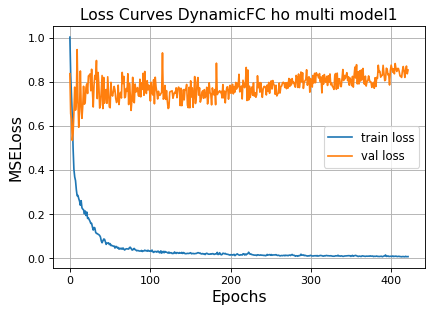

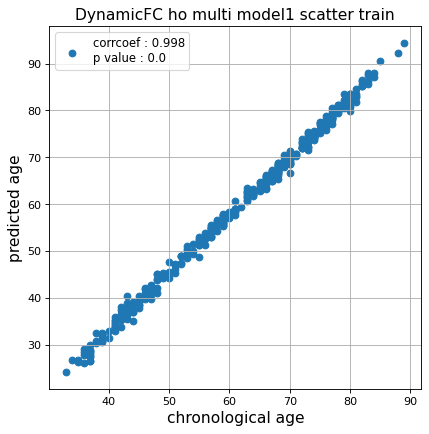

r^2 train data:  0.9228857428067614


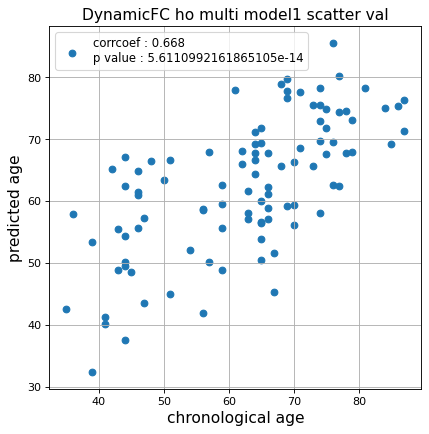

r^2 val data:  0.4196354647689037


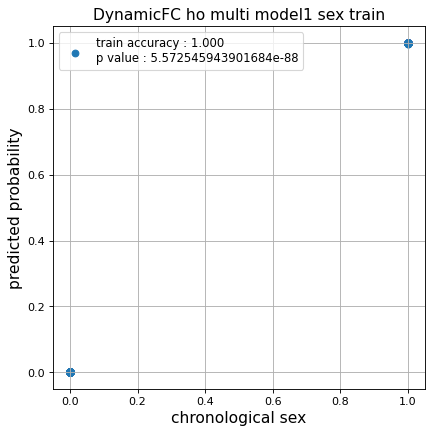

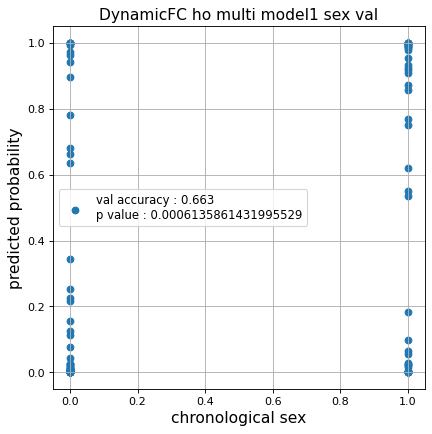

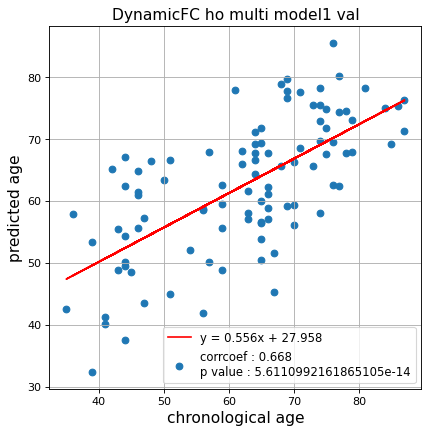

切片: 27.95753779017351
傾き: 0.5555253244871473
Kfold: 4 ::: epoch: 100, loss: 0.03555000859957475, val loss: 0.47770050913095474
Kfold: 4 ::: epoch: 200, loss: 0.017943984757249173, val loss: 0.4321432113647461
Kfold: 4 ::: epoch: 300, loss: 0.016461386416967098, val loss: 0.4514802321791649
Kfold: 4 ::: epoch: 400, loss: 0.0100827282294631, val loss: 0.5056122690439224
early stopping
save_epochs:204
best val loss:0.4164687469601631


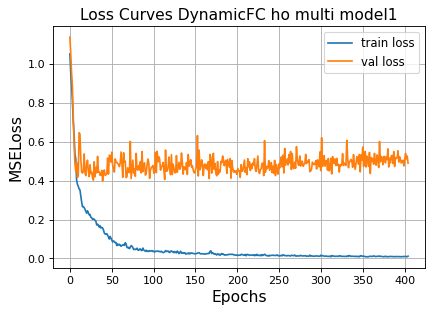

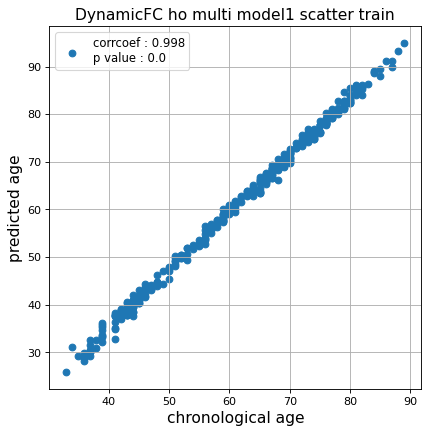

r^2 train data:  0.953166248084912


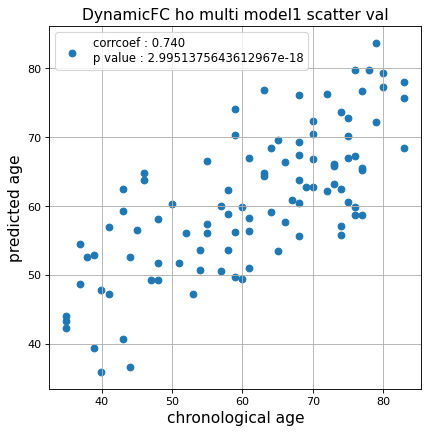

r^2 val data:  0.5473157032518223


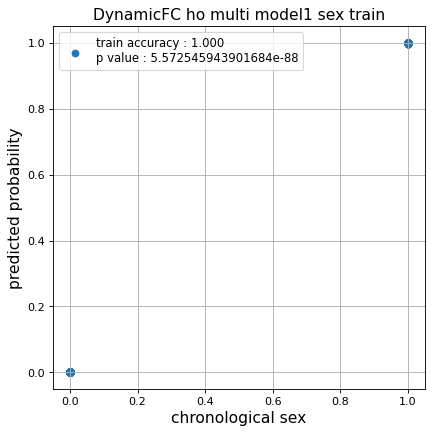

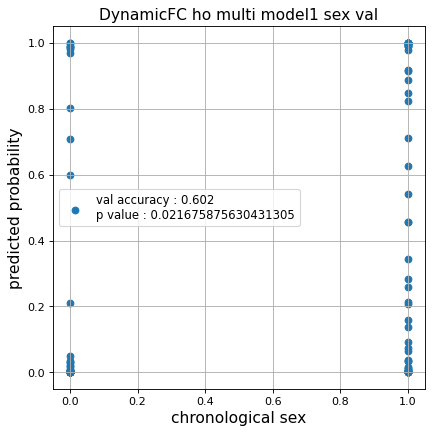

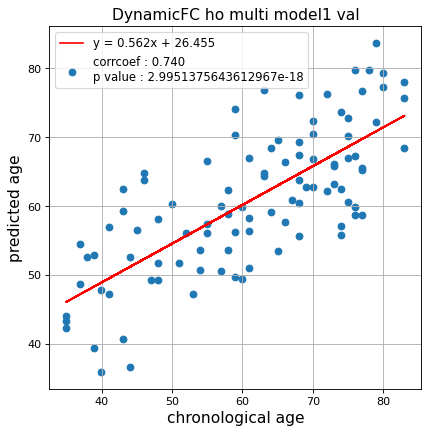

切片: 26.455265022343205
傾き: 0.5622004135036084
Kfold: 5 ::: epoch: 100, loss: 0.03139441847228087, val loss: 0.8306792378425598
Kfold: 5 ::: epoch: 200, loss: 0.016886907128187325, val loss: 0.8186030387878418
Kfold: 5 ::: epoch: 300, loss: 0.010469062432933312, val loss: 0.8482678383588791
Kfold: 5 ::: epoch: 400, loss: 0.00861359341070056, val loss: 0.8728180080652237
early stopping
save_epochs:207
best val loss:0.7986049950122833


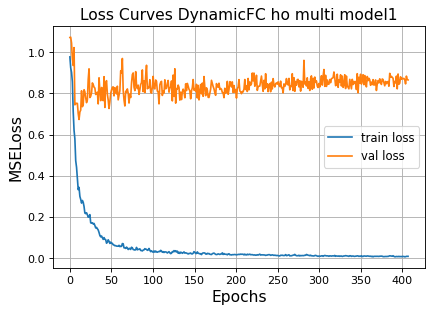

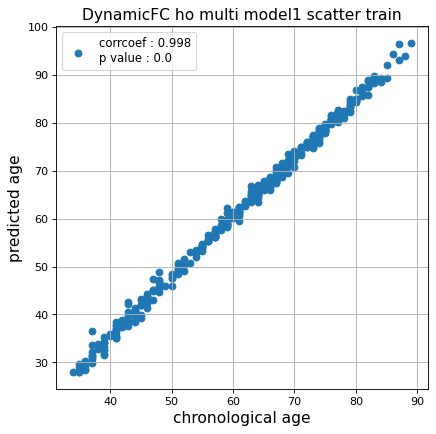

r^2 train data:  0.9320640198981962


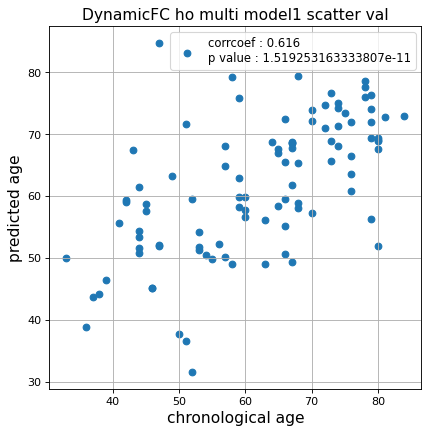

r^2 val data:  0.3324175099168285


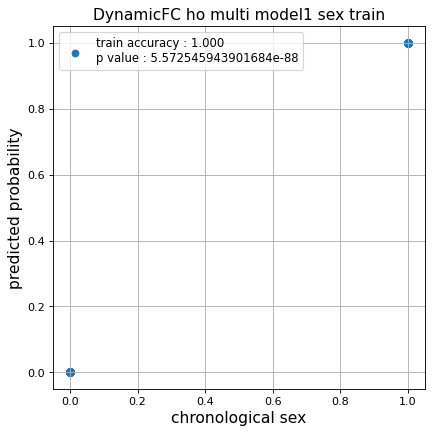

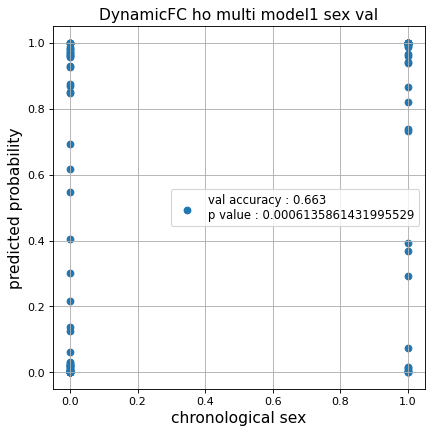

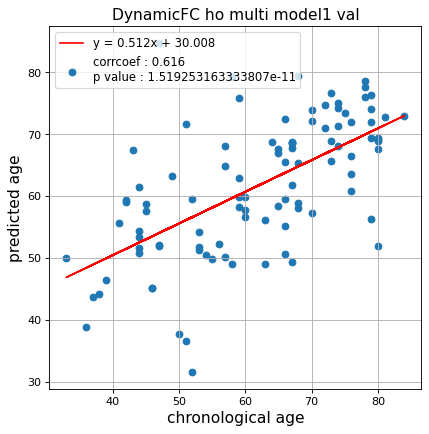

切片: 30.00834315653716
傾き: 0.5116256336532393
CPU times: user 23h 23min 38s, sys: 1min 35s, total: 23h 25min 13s
Wall time: 3h 21min 38s


In [30]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_dynamic_1  = []
test_pred_ho_dynamic_corrected_1  = []
test_label_ho_dynamic_1 = []
test_idx_ho_dynamic_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop   = 0.3,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC ho multi model1'
                                                          )
    
    test_pred_ho_dynamic_1.append(test_pred)
    test_pred_ho_dynamic_corrected_1.append(test_pred_corrected)
    test_label_ho_dynamic_1.append(test_label)
    test_idx_ho_dynamic_1.append(test_idx)

### Dynamic FC 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.05165086586314898, val loss: 0.5394496526569128
Kfold: 1 ::: epoch: 200, loss: 0.024784187141519327, val loss: 0.4798021484166384
Kfold: 1 ::: epoch: 300, loss: 0.013478156752311267, val loss: 0.4850054085254669
Kfold: 1 ::: epoch: 400, loss: 0.009552489106471721, val loss: 0.4670977145433426
early stopping
save_epochs:265
best val loss:0.4483463792130351


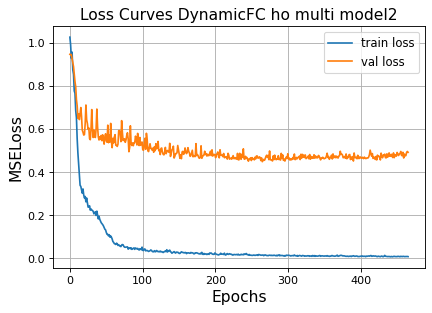

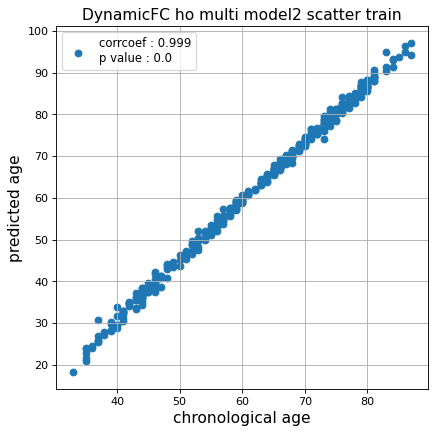

r^2 train data:  0.8269053874397544


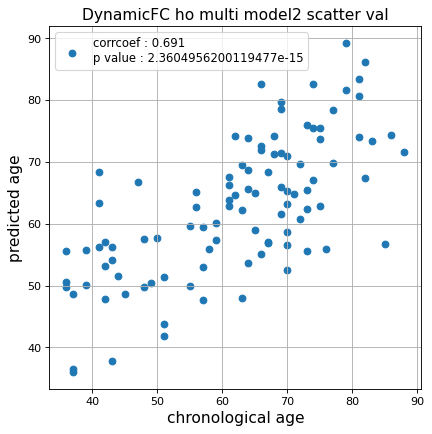

r^2 val data:  0.45963951745684795


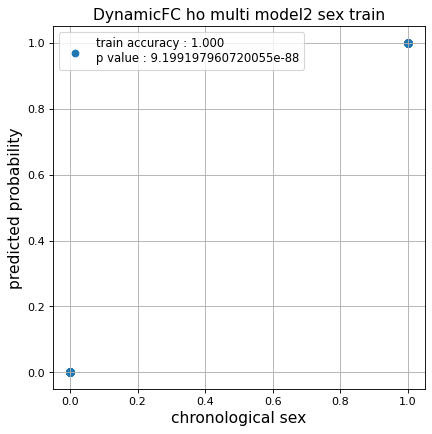

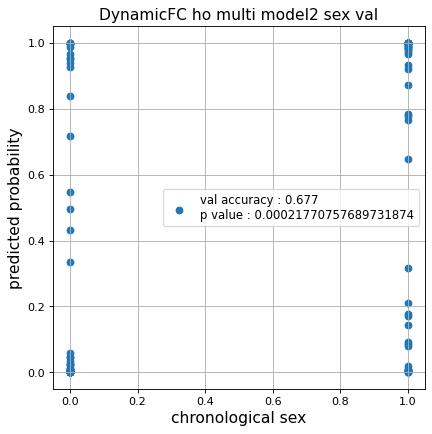

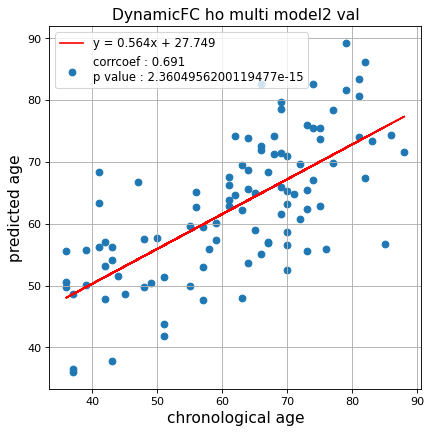

切片: 27.749379177849946
傾き: 0.5636668097754295
Kfold: 2 ::: epoch: 100, loss: 0.0407484107865737, val loss: 0.85723876953125
Kfold: 2 ::: epoch: 200, loss: 0.021652870417500917, val loss: 0.7687321454286575
Kfold: 2 ::: epoch: 300, loss: 0.013505003343407925, val loss: 0.7738318592309952
Kfold: 2 ::: epoch: 400, loss: 0.010778172120738488, val loss: 0.7572557032108307
early stopping
save_epochs:263
best val loss:0.6559448540210724


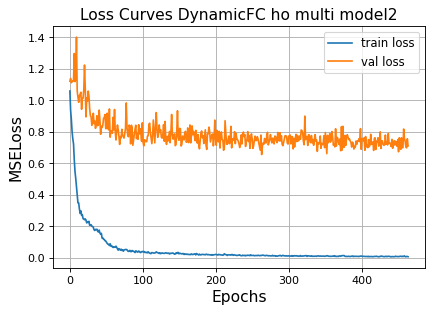

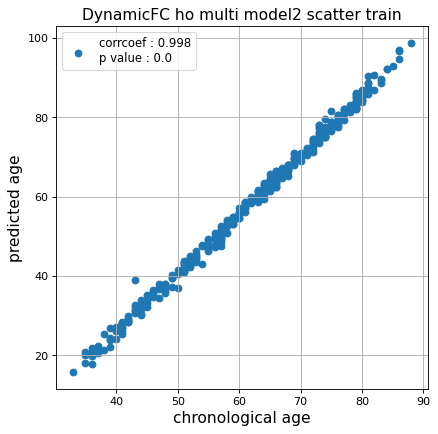

r^2 train data:  0.7004521677184438


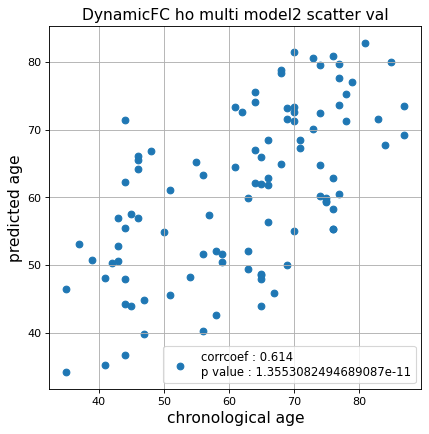

r^2 val data:  0.29397241800399176


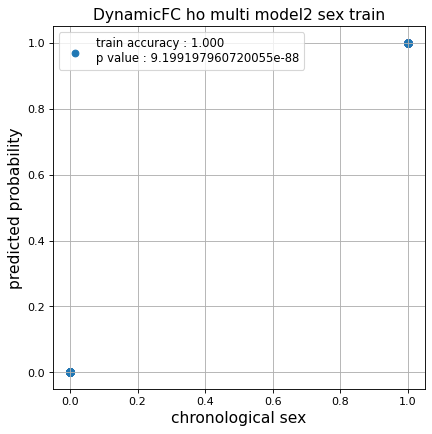

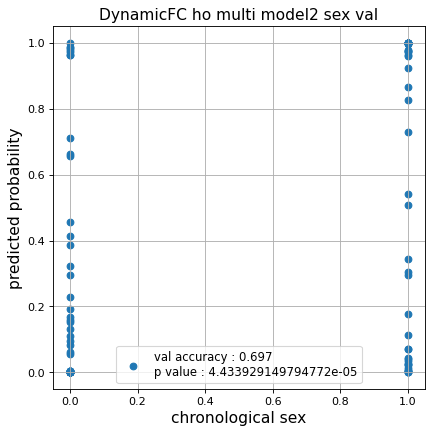

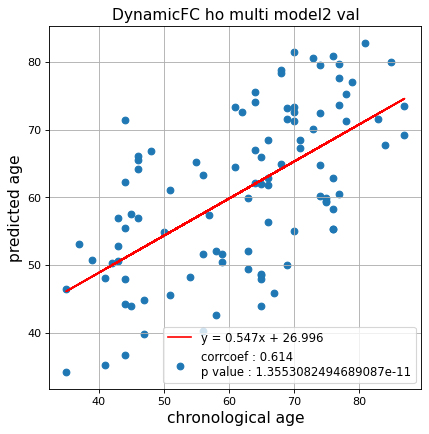

切片: 26.996124080746874
傾き: 0.546526196425397
Kfold: 3 ::: epoch: 100, loss: 0.036189402668521956, val loss: 0.8425134569406509
Kfold: 3 ::: epoch: 200, loss: 0.021089971208801635, val loss: 0.7165276855230331
Kfold: 3 ::: epoch: 300, loss: 0.013488558837427543, val loss: 0.5600163005292416
Kfold: 3 ::: epoch: 400, loss: 0.010847269055935053, val loss: 0.5052554048597813
Kfold: 3 ::: epoch: 500, loss: 0.008663732164467756, val loss: 0.47060425393283367
Kfold: 3 ::: epoch: 600, loss: 0.006830291625542136, val loss: 0.49609944224357605
Kfold: 3 ::: epoch: 700, loss: 0.006252850799892957, val loss: 0.42554981727153063
save_epochs:698
best val loss:0.42430991493165493


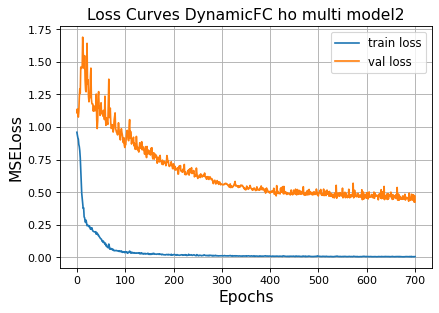

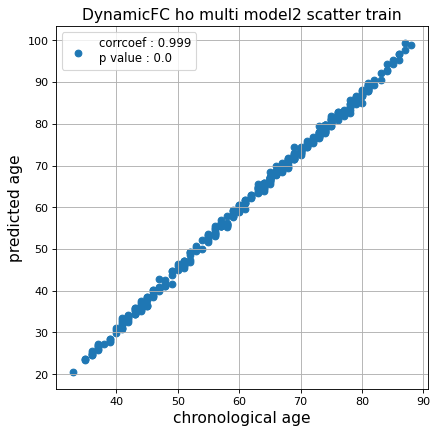

r^2 train data:  0.8205060995605137


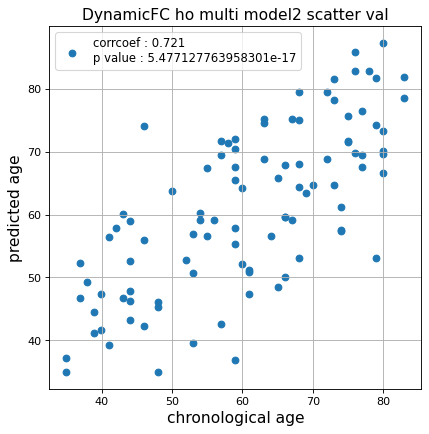

r^2 val data:  0.4606398984402421


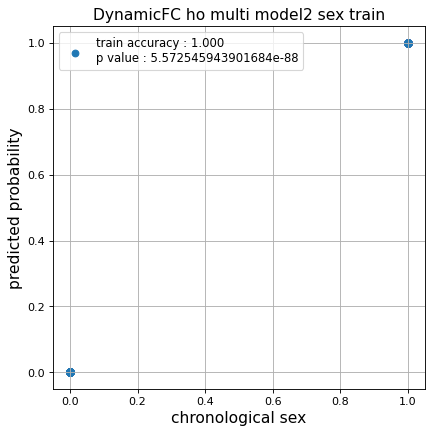

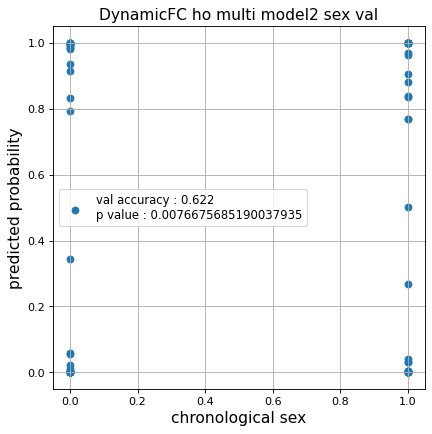

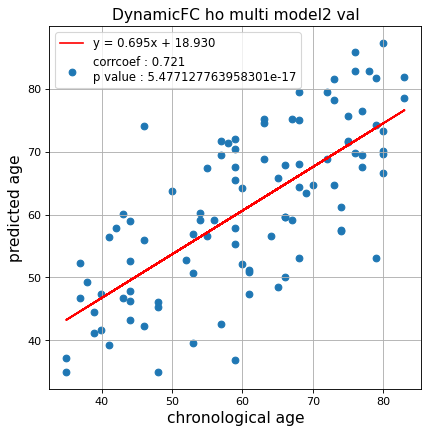

切片: 18.92955214994236
傾き: 0.6947626836960745
Kfold: 4 ::: epoch: 100, loss: 0.037022580607579306, val loss: 1.830287590622902
Kfold: 4 ::: epoch: 200, loss: 0.0194673568296891, val loss: 1.508966863155365
Kfold: 4 ::: epoch: 300, loss: 0.01139086617443424, val loss: 1.4873593151569366
Kfold: 4 ::: epoch: 400, loss: 0.010443386478492847, val loss: 1.5089040398597717
Kfold: 4 ::: epoch: 500, loss: 0.006402375534749948, val loss: 1.373070165514946
Kfold: 4 ::: epoch: 600, loss: 0.006031865057033988, val loss: 1.3681277632713318
Kfold: 4 ::: epoch: 700, loss: 0.004813128831581428, val loss: 1.332924798130989
save_epochs:668
best val loss:1.2908885627985


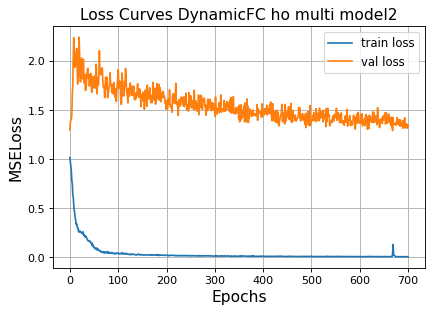

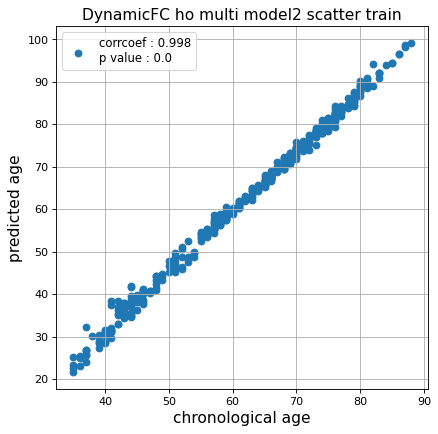

r^2 train data:  0.8233036513157473


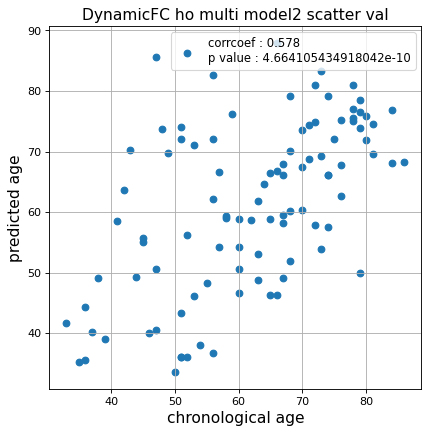

r^2 val data:  0.11719066492488417


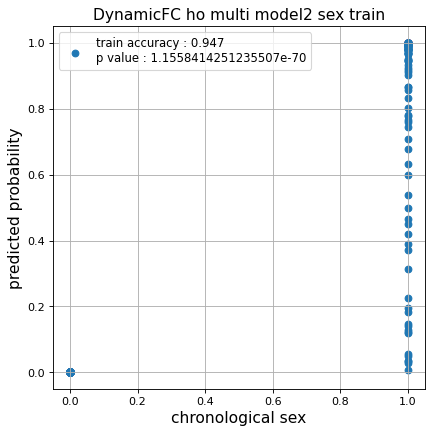

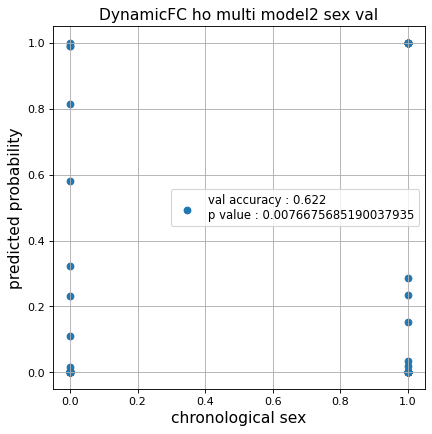

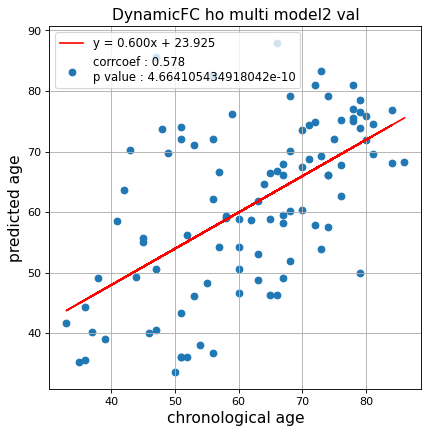

切片: 23.924954723481648
傾き: 0.6002167550152309
Kfold: 5 ::: epoch: 100, loss: 0.03821503800841478, val loss: 1.1415689140558243
Kfold: 5 ::: epoch: 200, loss: 0.018766061761058293, val loss: 1.0593273788690567
Kfold: 5 ::: epoch: 300, loss: 0.012785372969049674, val loss: 1.0742329210042953
Kfold: 5 ::: epoch: 400, loss: 0.008615994897599403, val loss: 1.0378739088773727
Kfold: 5 ::: epoch: 500, loss: 0.0063856609631329775, val loss: 1.017087072134018
Kfold: 5 ::: epoch: 600, loss: 0.006643404109546771, val loss: 0.9711211174726486
early stopping
save_epochs:411
best val loss:0.9697592854499817


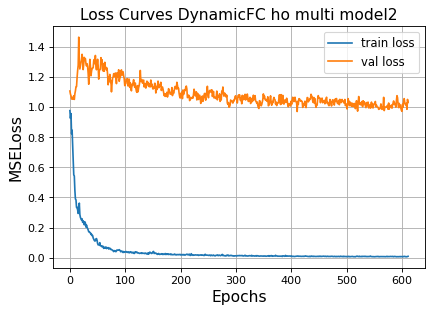

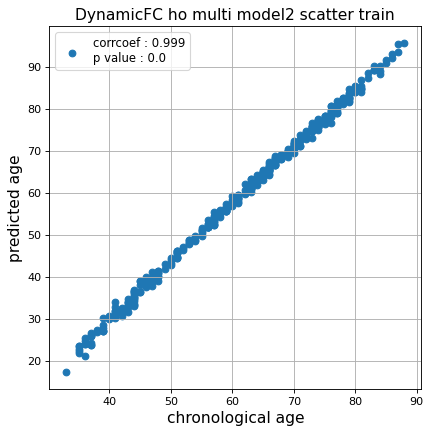

r^2 train data:  0.8350004034569227


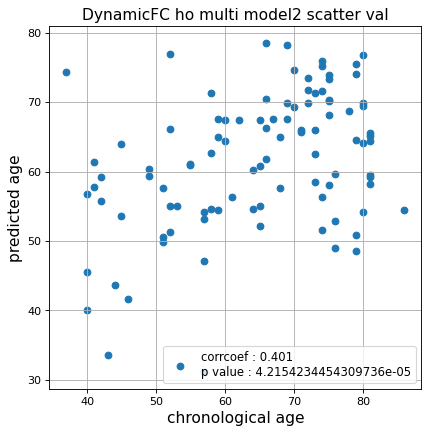

r^2 val data:  -0.025220224494007182


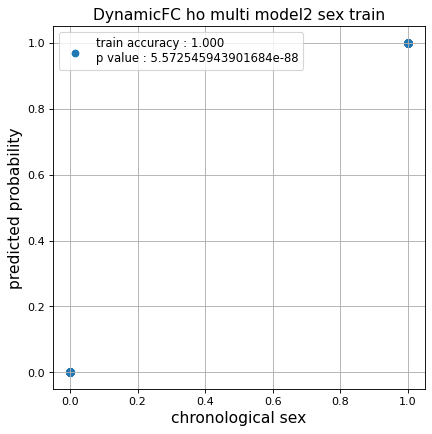

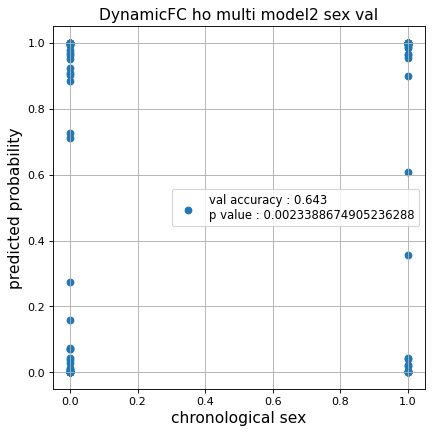

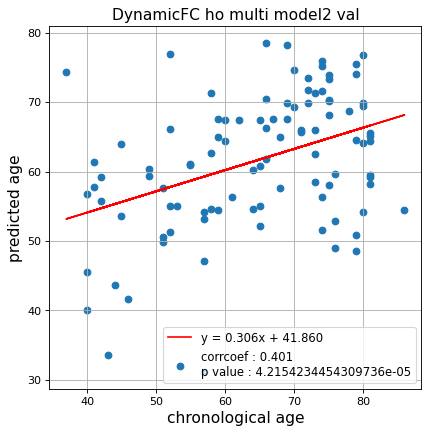

切片: 41.85951705438893
傾き: 0.3057035209746259
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.05633547386297813, val loss: 0.600405178964138
Kfold: 1 ::: epoch: 200, loss: 0.025901060479764756, val loss: 0.47962016984820366
Kfold: 1 ::: epoch: 300, loss: 0.013201006974738378, val loss: 0.5537327155470848
Kfold: 1 ::: epoch: 400, loss: 0.009012242814955803, val loss: 0.4650004878640175
Kfold: 1 ::: epoch: 500, loss: 0.006752721768302413, val loss: 0.49435071647167206
early stopping
save_epochs:319
best val loss:0.4471837542951107


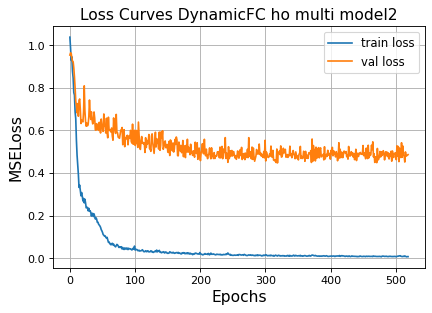

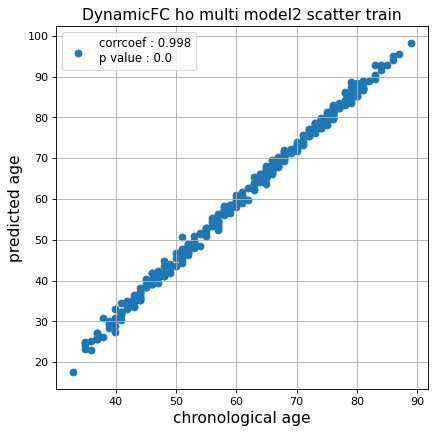

r^2 train data:  0.836217810956152


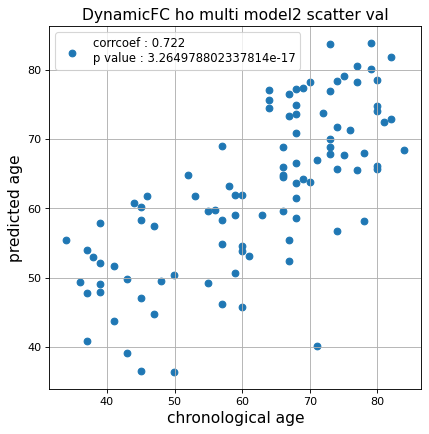

r^2 val data:  0.5056559462563884


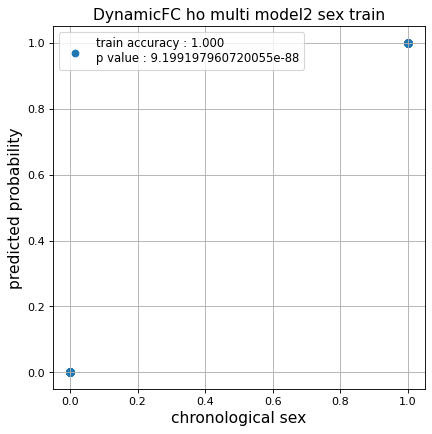

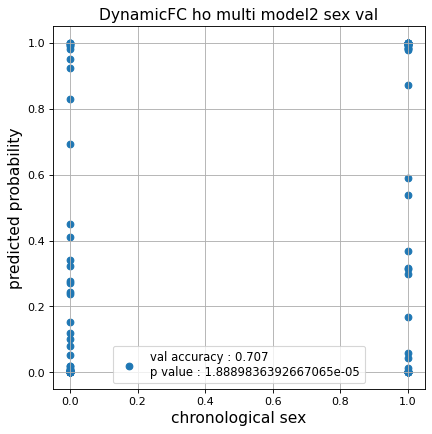

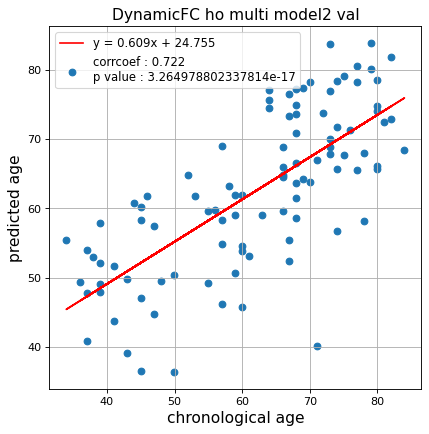

切片: 24.755278366955565
傾き: 0.6089378646279404
Kfold: 2 ::: epoch: 100, loss: 0.028649778176958744, val loss: 0.8683855086565018
Kfold: 2 ::: epoch: 200, loss: 0.017597320417945202, val loss: 0.8847533762454987
Kfold: 2 ::: epoch: 300, loss: 0.008123062121180387, val loss: 0.9596376866102219
Kfold: 2 ::: epoch: 400, loss: 0.008899827416126545, val loss: 0.9774690270423889
early stopping
save_epochs:236
best val loss:0.8643732517957687


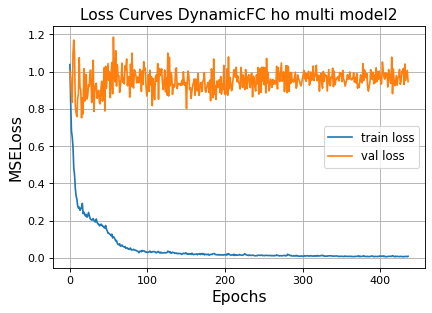

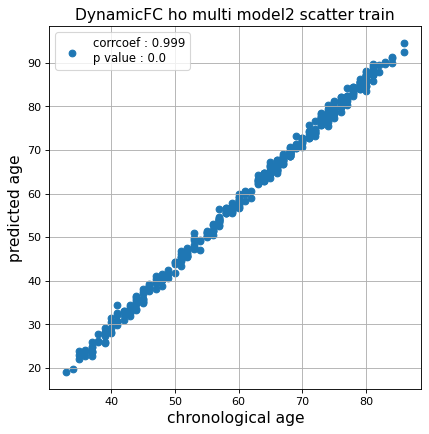

r^2 train data:  0.8075593755158692


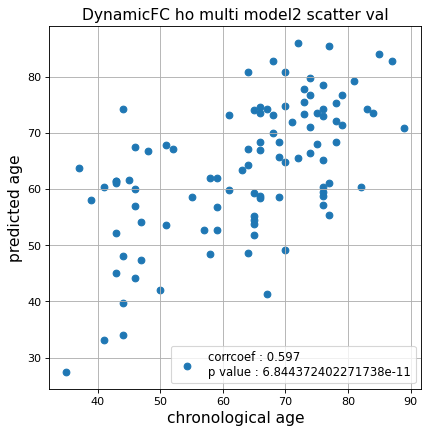

r^2 val data:  0.26483670489605105


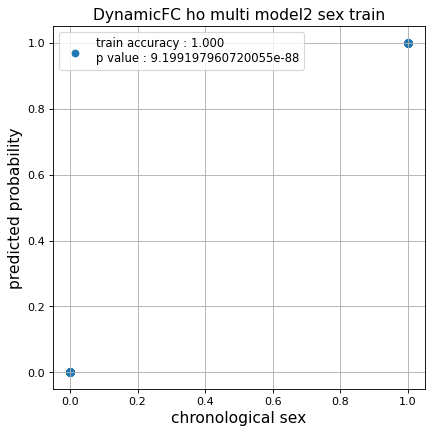

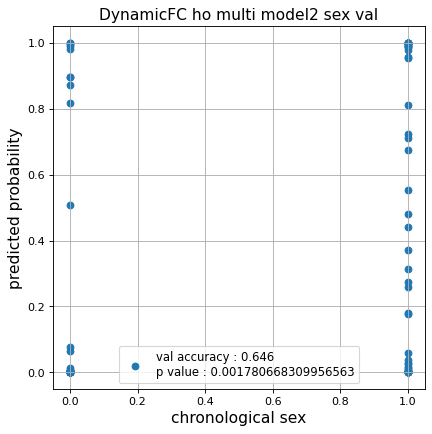

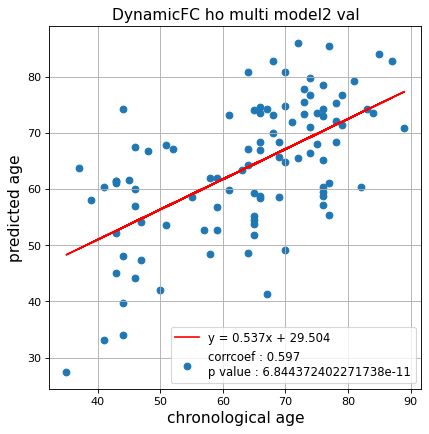

切片: 29.504244614175846
傾き: 0.5374767198036807
Kfold: 3 ::: epoch: 100, loss: 0.04083753534807609, val loss: 0.5178128555417061
Kfold: 3 ::: epoch: 200, loss: 0.018845616123424128, val loss: 0.510201558470726
Kfold: 3 ::: epoch: 300, loss: 0.012594783786111154, val loss: 0.5136434659361839
Kfold: 3 ::: epoch: 400, loss: 0.012116699407880124, val loss: 0.5128070265054703
early stopping
save_epochs:289
best val loss:0.47356805950403214


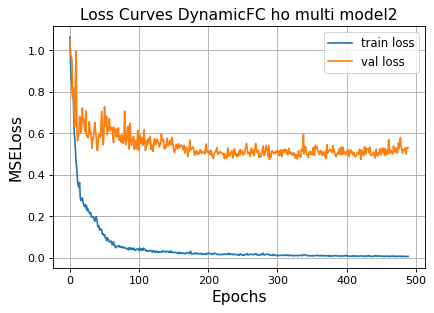

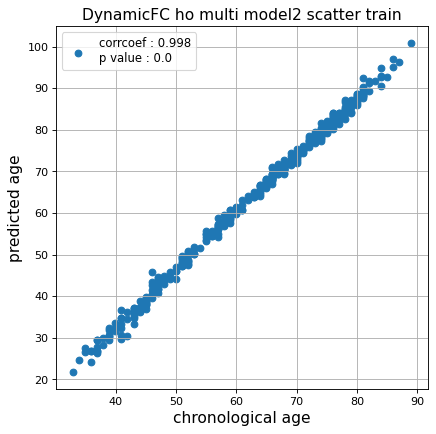

r^2 train data:  0.8374384722058689


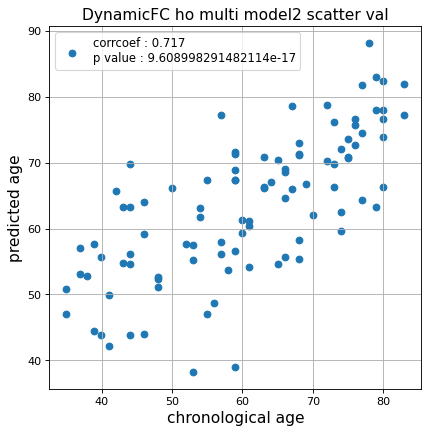

r^2 val data:  0.46536087269127535


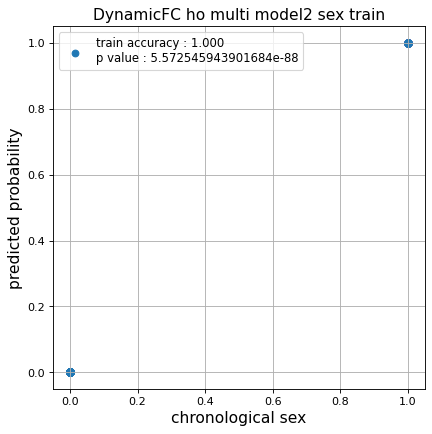

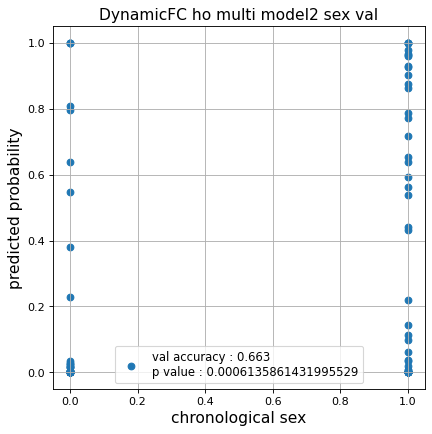

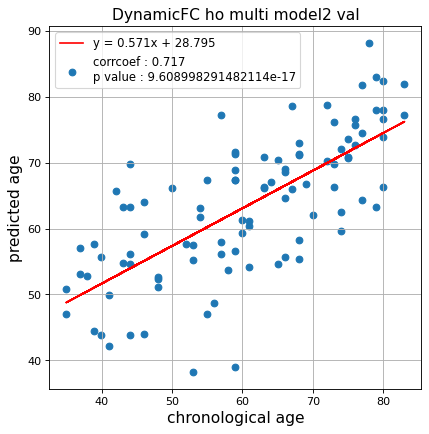

切片: 28.795153283999568
傾き: 0.5712624693218187
Kfold: 4 ::: epoch: 100, loss: 0.0358442787367564, val loss: 1.2516978830099106
Kfold: 4 ::: epoch: 200, loss: 0.01816863860361851, val loss: 1.1422776728868484
Kfold: 4 ::: epoch: 300, loss: 0.010841242789935607, val loss: 1.2170764803886414
Kfold: 4 ::: epoch: 400, loss: 0.009286359310723268, val loss: 1.2599827498197556
Kfold: 4 ::: epoch: 500, loss: 0.007221628302851548, val loss: 1.0836324095726013
Kfold: 4 ::: epoch: 600, loss: 0.0066204213250715, val loss: 1.2322186827659607
Kfold: 1 ::: epoch: 100, loss: 0.048564010801223606, val loss: 0.7471287027001381
Kfold: 1 ::: epoch: 200, loss: 0.028293838939414576, val loss: 0.6426365375518799
Kfold: 1 ::: epoch: 300, loss: 0.011408814157430943, val loss: 0.6550360098481178
Kfold: 1 ::: epoch: 400, loss: 0.010012864636687132, val loss: 0.6295888125896454
Kfold: 1 ::: epoch: 500, loss: 0.007189121670447863, val loss: 0.6499112322926521
early stopping
save_epochs:350
best val loss:0.5819831117

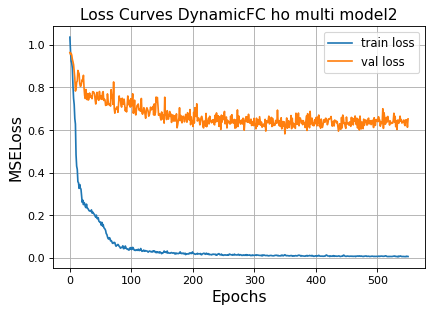

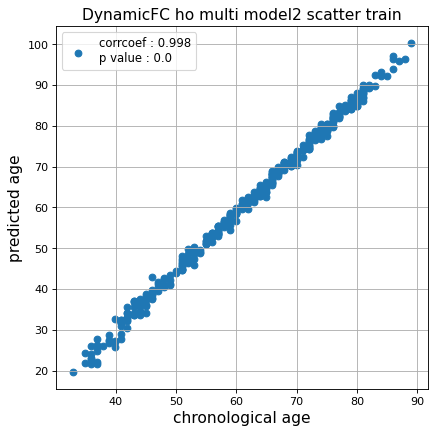

r^2 train data:  0.8113645396195174


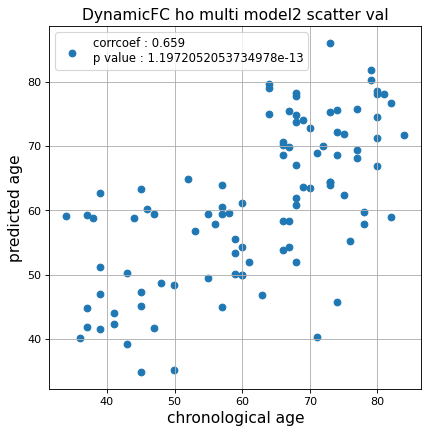

r^2 val data:  0.37811470936626457


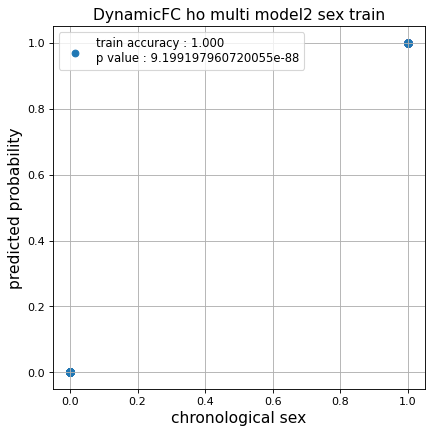

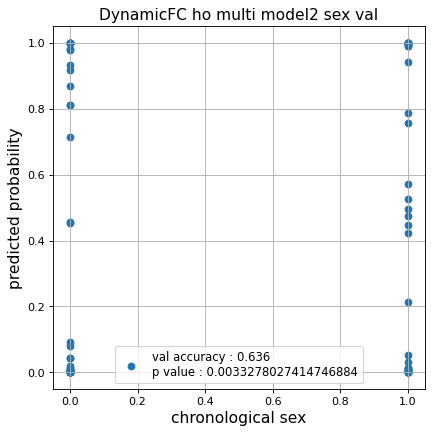

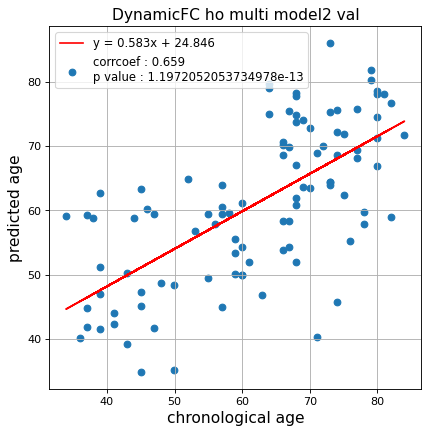

切片: 24.84648080574126
傾き: 0.5833756610423674
Kfold: 2 ::: epoch: 100, loss: 0.056758819004664056, val loss: 0.7409072667360306
Kfold: 2 ::: epoch: 200, loss: 0.01605603503636443, val loss: 0.6298442557454109
Kfold: 2 ::: epoch: 300, loss: 0.012390694939173184, val loss: 0.630642831325531
Kfold: 2 ::: epoch: 400, loss: 0.00730915183129792, val loss: 0.6154538691043854
Kfold: 2 ::: epoch: 500, loss: 0.005764168167773347, val loss: 0.6129623651504517
Kfold: 2 ::: epoch: 600, loss: 0.005064589741568153, val loss: 0.6362975090742111
Kfold: 2 ::: epoch: 700, loss: 0.007504171530644481, val loss: 0.5928381681442261
save_epochs:555
best val loss:0.5716042742133141


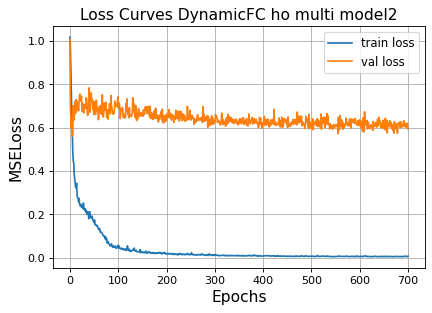

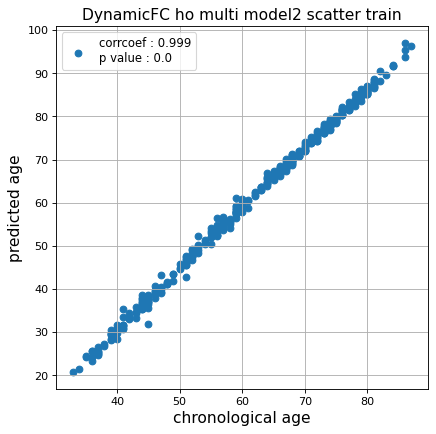

r^2 train data:  0.8398316108322874


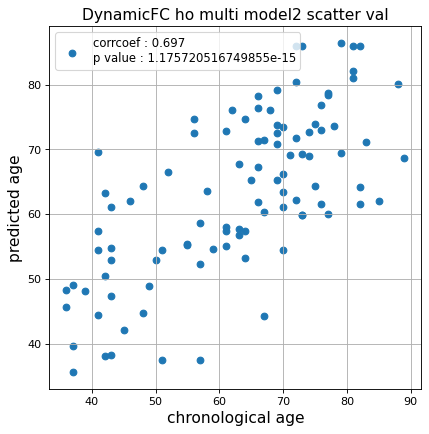

r^2 val data:  0.4454769118994958


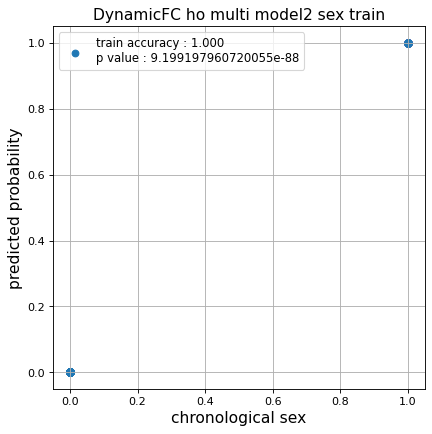

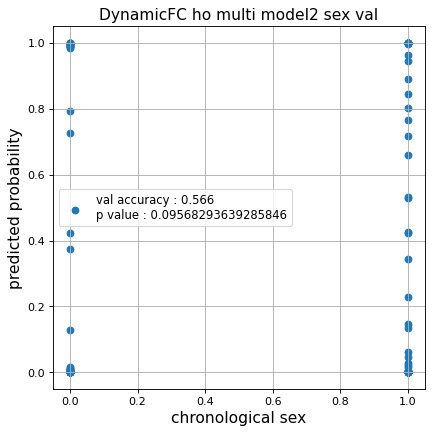

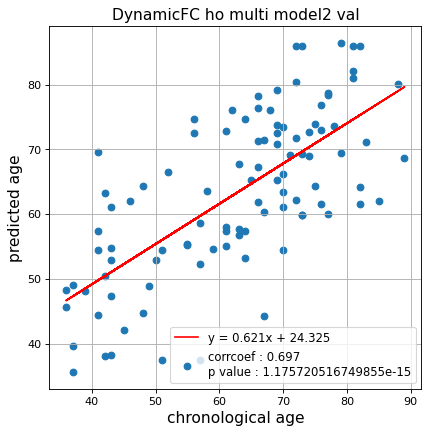

切片: 24.324779083418413
傾き: 0.6211469883595931
Kfold: 3 ::: epoch: 100, loss: 0.0347890594544319, val loss: 0.7332050800323486
Kfold: 3 ::: epoch: 200, loss: 0.01996378632835471, val loss: 0.7498601078987122
Kfold: 3 ::: epoch: 300, loss: 0.011982809859686173, val loss: 0.6436788439750671
Kfold: 3 ::: epoch: 400, loss: 0.011077332776039839, val loss: 0.6431744694709778
Kfold: 3 ::: epoch: 500, loss: 0.006696816408433593, val loss: 0.6010462045669556
Kfold: 3 ::: epoch: 600, loss: 0.006374949016250097, val loss: 0.6005053892731667
Kfold: 3 ::: epoch: 700, loss: 0.006596993171395018, val loss: 0.5991135947406292
save_epochs:645
best val loss:0.5824982449412346


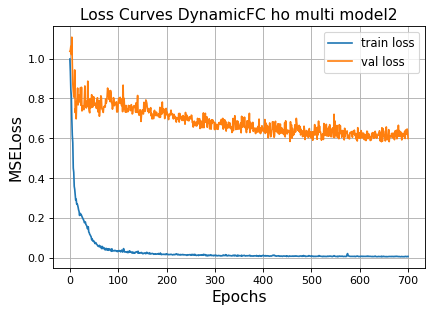

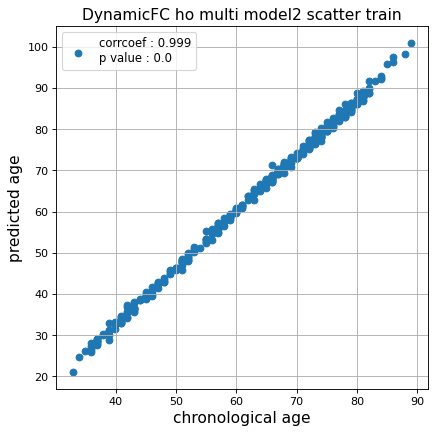

r^2 train data:  0.8607621541863909


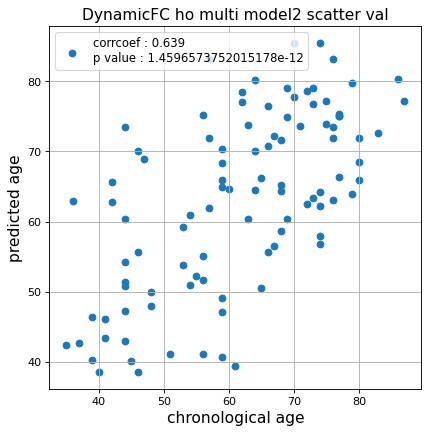

r^2 val data:  0.2862229991297486


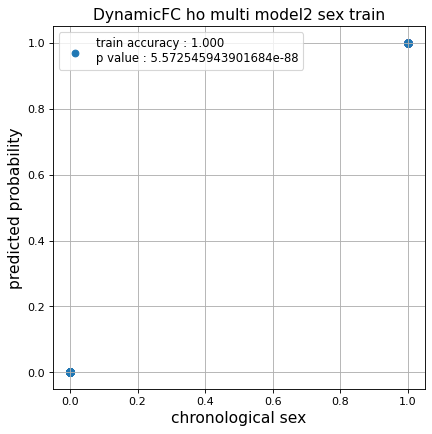

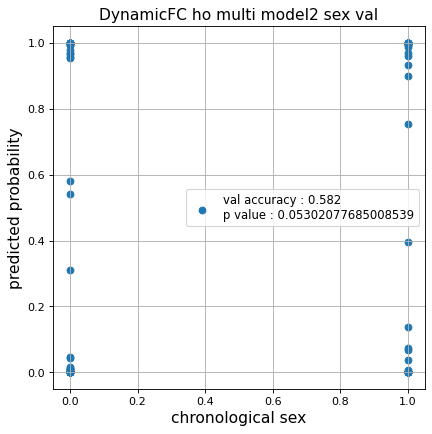

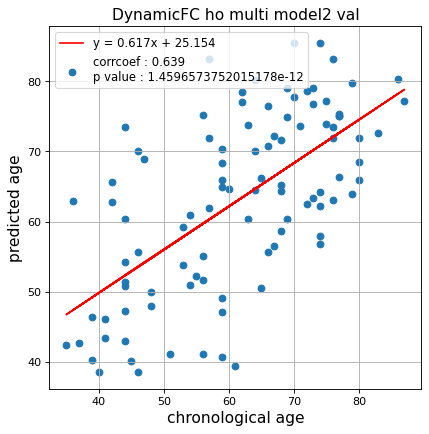

切片: 25.15420559315001
傾き: 0.6168618166001603
Kfold: 4 ::: epoch: 100, loss: 0.03176888723212939, val loss: 1.3473971039056778
Kfold: 4 ::: epoch: 200, loss: 0.01733006680240998, val loss: 1.2713439762592316
Kfold: 4 ::: epoch: 300, loss: 0.010332377914052743, val loss: 1.2684492766857147
Kfold: 4 ::: epoch: 400, loss: 0.007398727618587704, val loss: 1.1928080171346664
early stopping
save_epochs:255
best val loss:1.1336117386817932


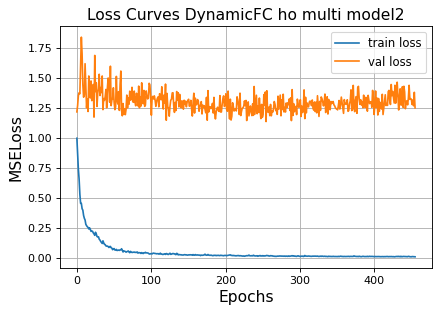

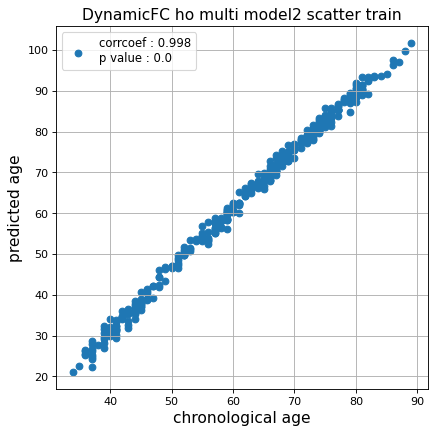

r^2 train data:  0.7518819918183185


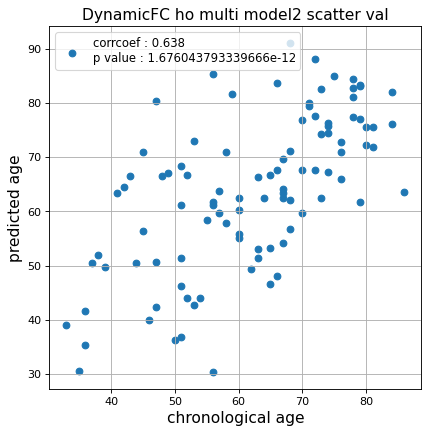

r^2 val data:  0.21361703678246857


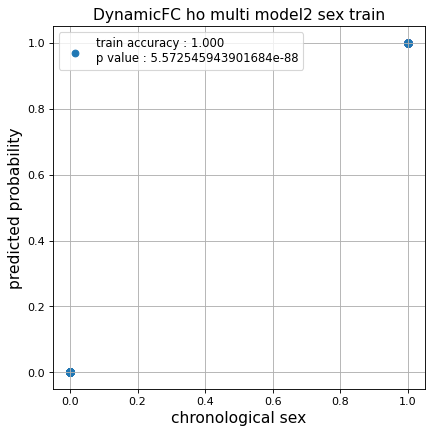

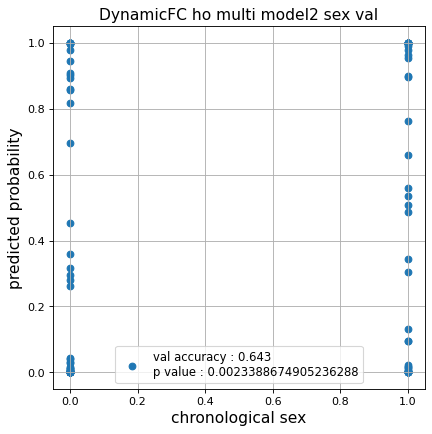

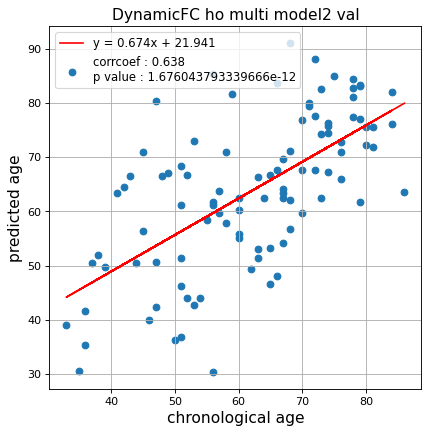

切片: 21.940783089713
傾き: 0.6740540073995763
Kfold: 5 ::: epoch: 100, loss: 0.03544866415457083, val loss: 1.4157918989658356
Kfold: 5 ::: epoch: 200, loss: 0.01994074587352001, val loss: 1.430600345134735
Kfold: 5 ::: epoch: 300, loss: 0.015534117746238526, val loss: 1.5256614685058594
Kfold: 5 ::: epoch: 400, loss: 0.010957405329323731, val loss: 1.7235864996910095
early stopping
save_epochs:209
best val loss:1.3827459514141083


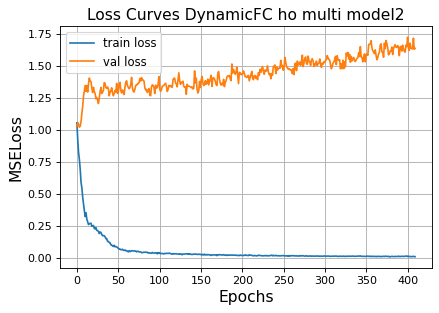

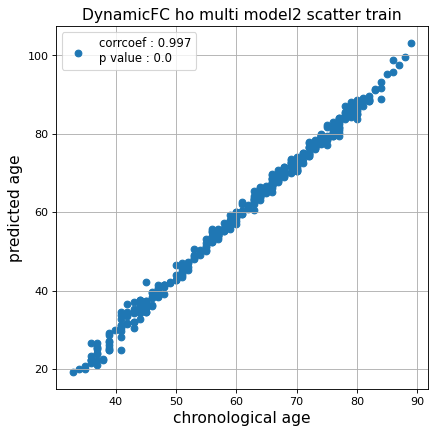

r^2 train data:  0.7891655849207119


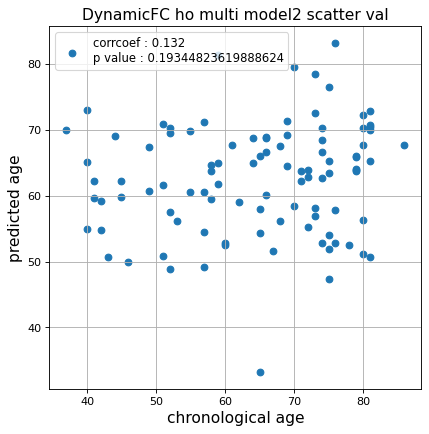

r^2 val data:  -0.27775032661752963


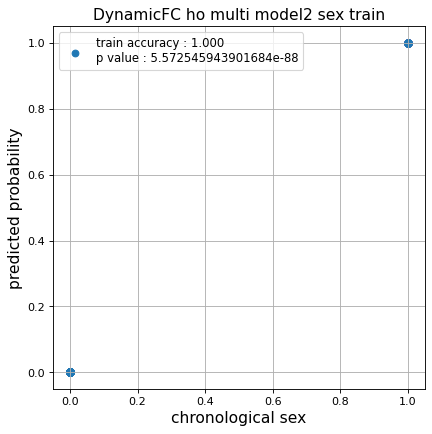

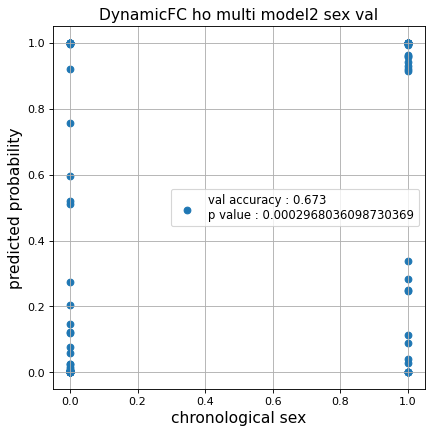

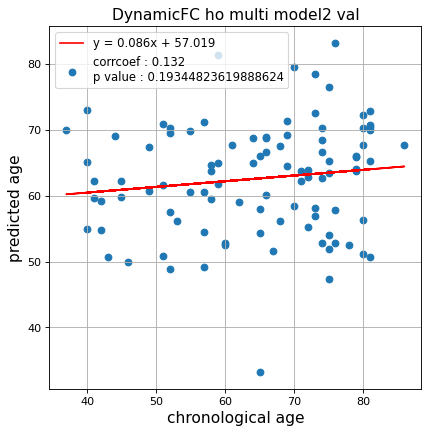

切片: 57.01897141067511
傾き: 0.08633252769546364
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.04254107750379122, val loss: 0.6579416617751122
Kfold: 1 ::: epoch: 200, loss: 0.022769372480419967, val loss: 0.5856928378343582
Kfold: 1 ::: epoch: 300, loss: 0.012876931971942004, val loss: 0.5838737338781357
Kfold: 1 ::: epoch: 400, loss: 0.01046838484203013, val loss: 0.5444483384490013
Kfold: 1 ::: epoch: 500, loss: 0.0064289340247901585, val loss: 0.5306135043501854
Kfold: 1 ::: epoch: 600, loss: 0.00650702015711711, val loss: 0.5252075642347336
early stopping
save_epochs:497
best val loss:0.49942566454410553


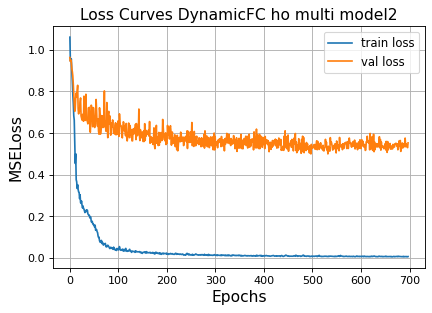

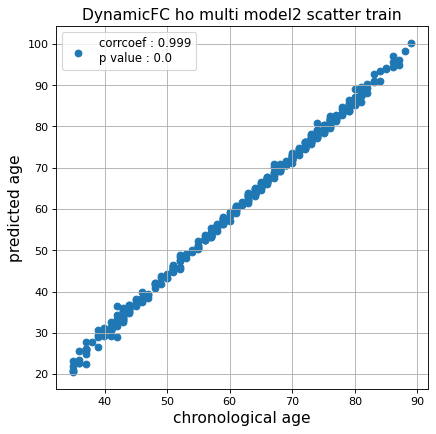

r^2 train data:  0.818434320137281


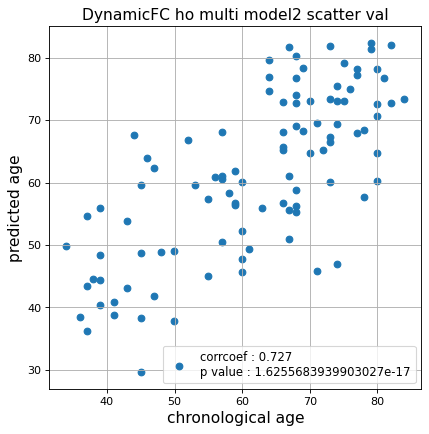

r^2 val data:  0.47815703023739153


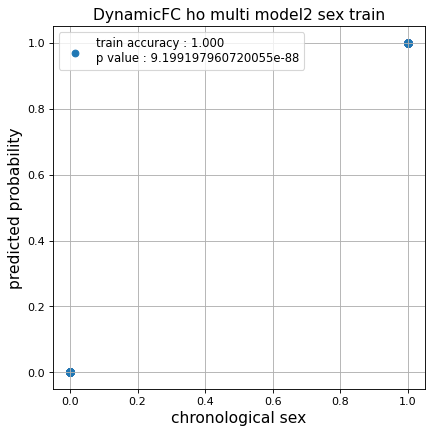

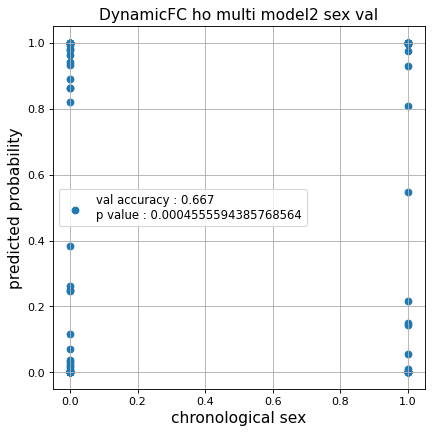

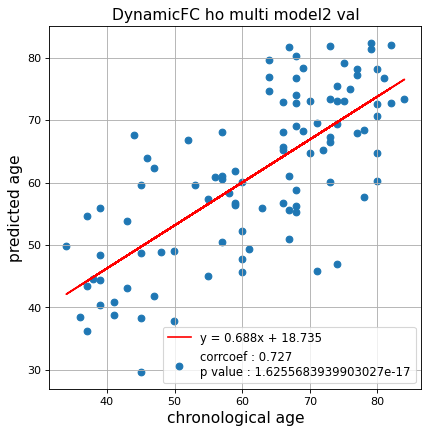

切片: 18.73536724277151
傾き: 0.6879749930115515
Kfold: 2 ::: epoch: 100, loss: 0.0444137525673096, val loss: 0.7176064848899841
Kfold: 2 ::: epoch: 200, loss: 0.02111773157062439, val loss: 0.599918432533741
Kfold: 2 ::: epoch: 300, loss: 0.013042253773444546, val loss: 0.5990538597106934
Kfold: 2 ::: epoch: 400, loss: 0.007827880362478586, val loss: 0.6804146617650986
early stopping
save_epochs:221
best val loss:0.5781714022159576


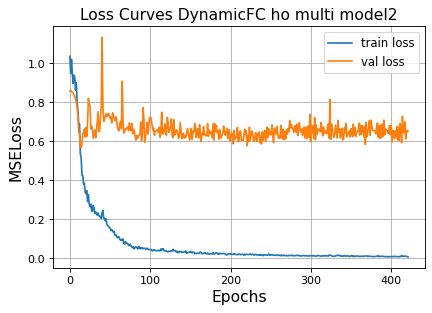

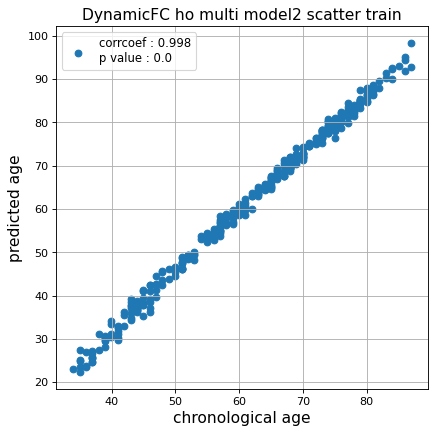

r^2 train data:  0.8566531949138992


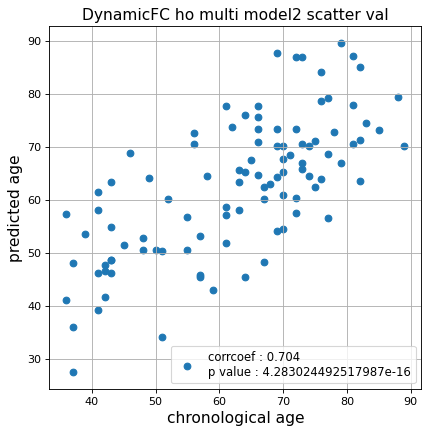

r^2 val data:  0.44912286877749363


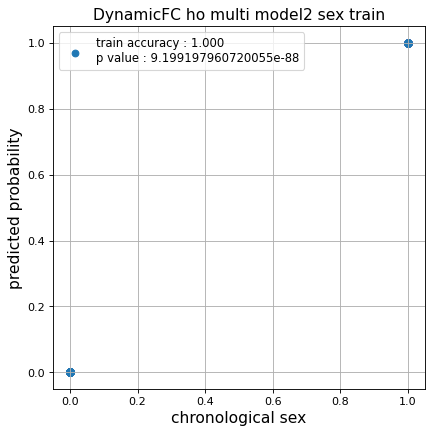

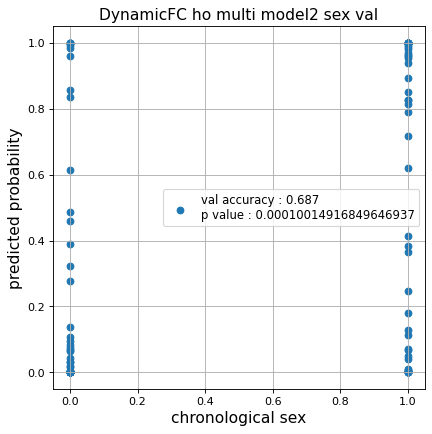

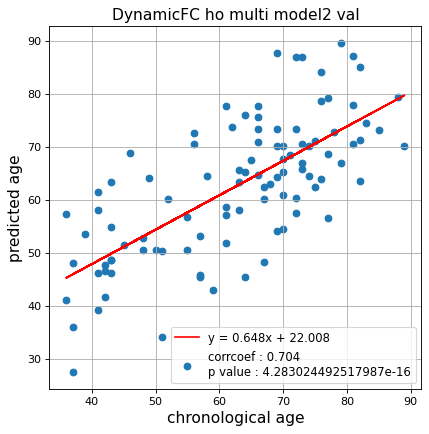

切片: 22.008497400060158
傾き: 0.6479038108078301
Kfold: 3 ::: epoch: 100, loss: 0.039401364584381766, val loss: 0.9413036704063416
Kfold: 3 ::: epoch: 200, loss: 0.01924335748816912, val loss: 0.9117021709680557
Kfold: 3 ::: epoch: 300, loss: 0.01134475084164968, val loss: 0.9105399549007416
Kfold: 3 ::: epoch: 400, loss: 0.01021365001081274, val loss: 0.8879963457584381
Kfold: 3 ::: epoch: 500, loss: 0.007537313987715886, val loss: 0.8804782032966614
early stopping
save_epochs:342
best val loss:0.8162081986665726


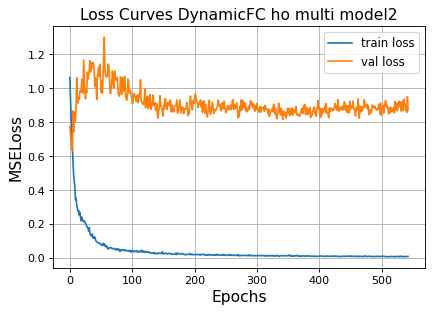

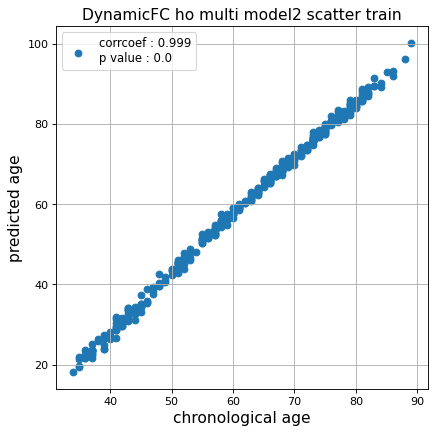

r^2 train data:  0.7858143099335559


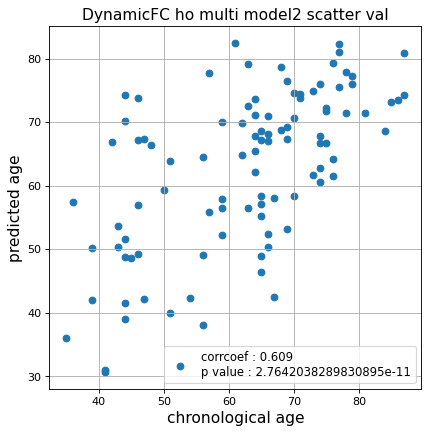

r^2 val data:  0.2552059926457628


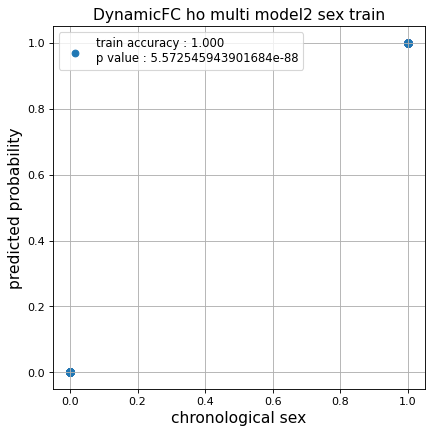

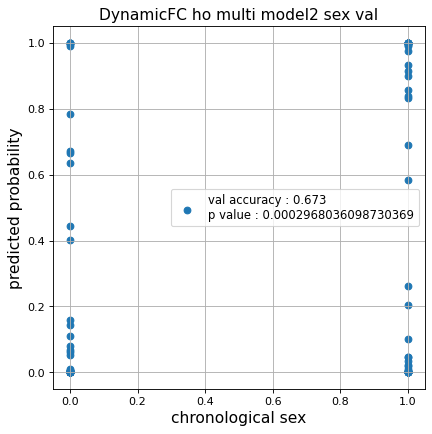

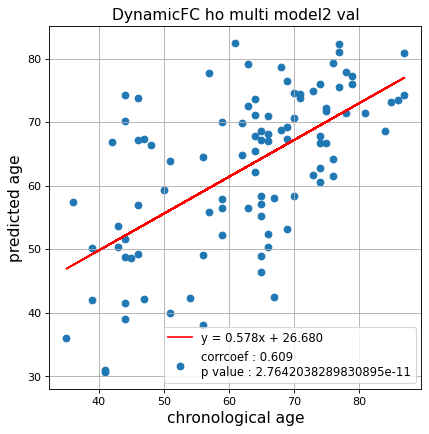

切片: 26.680284872435692
傾き: 0.5783552503257493
Kfold: 4 ::: epoch: 100, loss: 0.04182518302248074, val loss: 1.8392379730939865
Kfold: 4 ::: epoch: 200, loss: 0.02429151004896714, val loss: 1.644244909286499
Kfold: 4 ::: epoch: 300, loss: 0.018585017165885523, val loss: 1.5882183462381363
Kfold: 4 ::: epoch: 400, loss: 0.01025106765043277, val loss: 1.5034176707267761
Kfold: 4 ::: epoch: 500, loss: 0.009083905436385136, val loss: 1.6098603308200836
Kfold: 4 ::: epoch: 600, loss: 0.009332793693129834, val loss: 1.4065229445695877
Kfold: 4 ::: epoch: 700, loss: 0.006245582292859371, val loss: 1.2710914611816406
save_epochs:665
best val loss:1.2475940138101578


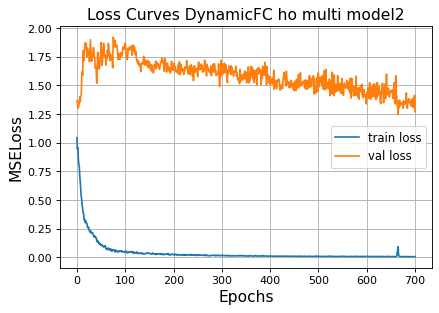

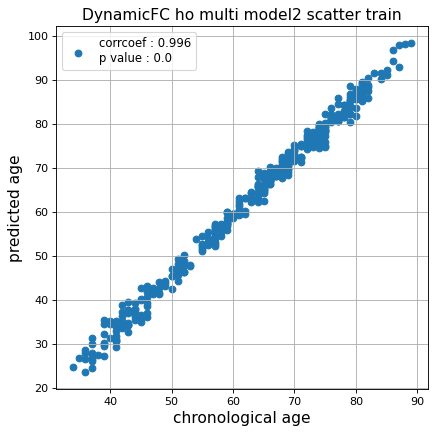

r^2 train data:  0.8603796475464199


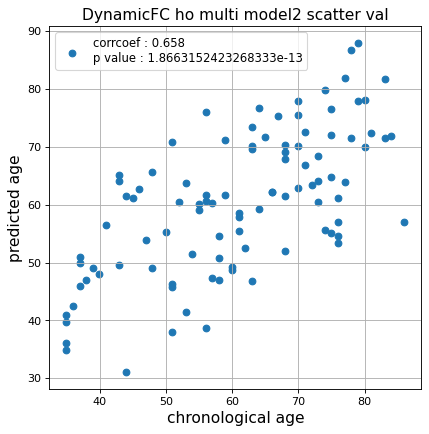

r^2 val data:  0.38415685406404787


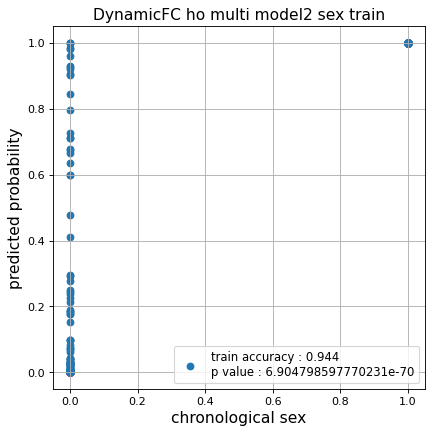

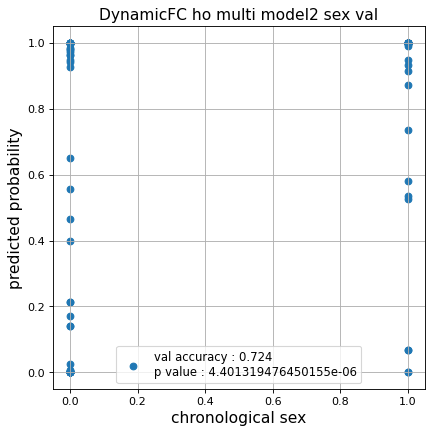

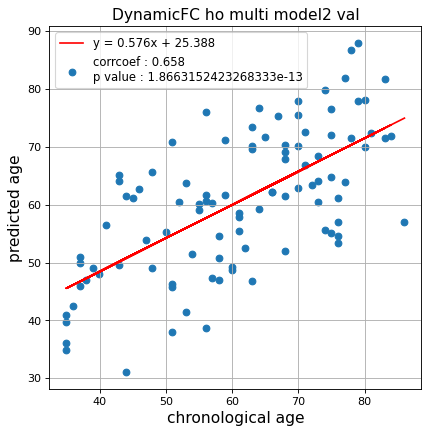

切片: 25.388470746994614
傾き: 0.5763761354393389
Kfold: 5 ::: epoch: 100, loss: 0.045087674919229284, val loss: 0.9363018870353699
Kfold: 5 ::: epoch: 200, loss: 0.01849305622566205, val loss: 0.921898141503334
Kfold: 5 ::: epoch: 300, loss: 0.0109574138186872, val loss: 0.9419839531183243
Kfold: 5 ::: epoch: 400, loss: 0.008385652891145302, val loss: 0.9230849146842957
Kfold: 5 ::: epoch: 500, loss: 0.006876311408212552, val loss: 0.9076466262340546
Kfold: 5 ::: epoch: 600, loss: 0.00564536670796, val loss: 0.9132757186889648
Kfold: 5 ::: epoch: 700, loss: 0.004985107968632991, val loss: 0.9117283076047897
save_epochs:694
best val loss:0.793900802731514


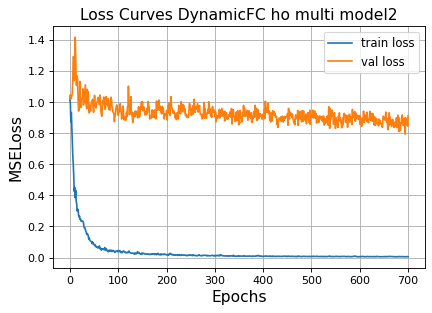

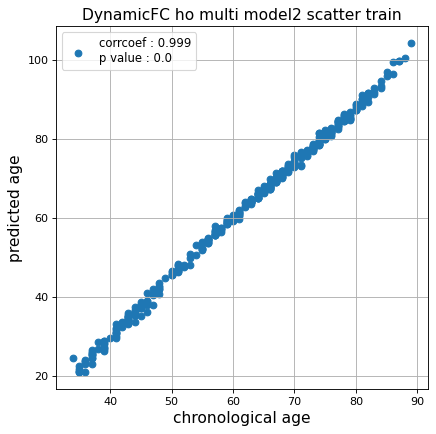

r^2 train data:  0.7867247630221725


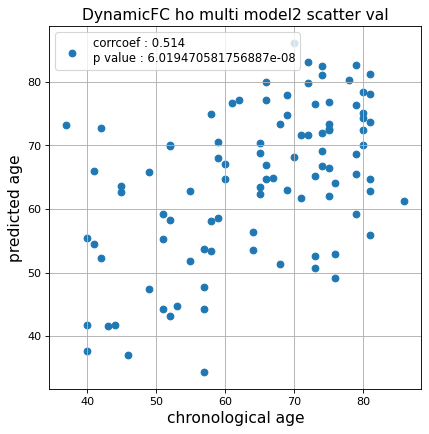

r^2 val data:  0.08514164435686489


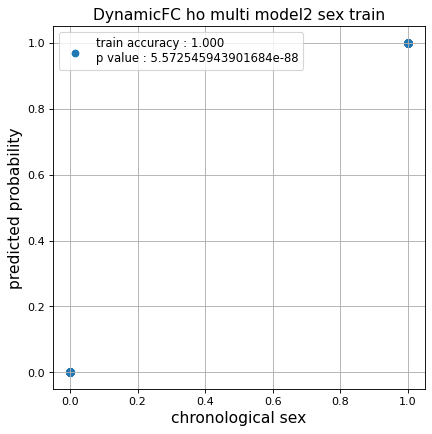

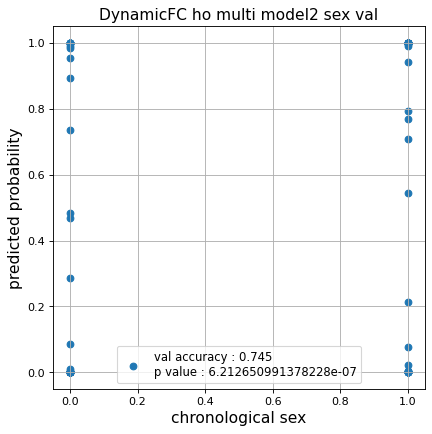

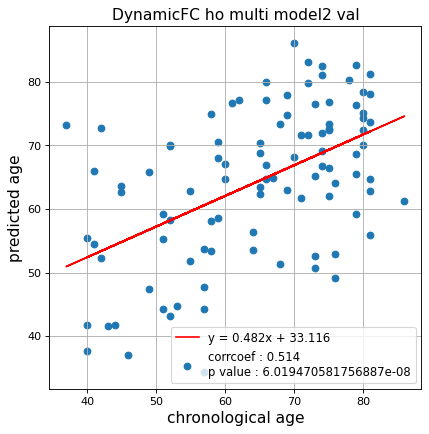

切片: 33.11615248362652
傾き: 0.4820299080861136
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.0371173254858989, val loss: 0.541155181825161
Kfold: 1 ::: epoch: 200, loss: 0.020983420097484037, val loss: 0.5223928764462471
Kfold: 1 ::: epoch: 300, loss: 0.01203276188327716, val loss: 0.5312125384807587
Kfold: 1 ::: epoch: 400, loss: 0.011674685367884545, val loss: 0.5377878546714783
early stopping
save_epochs:223
best val loss:0.4936111979186535


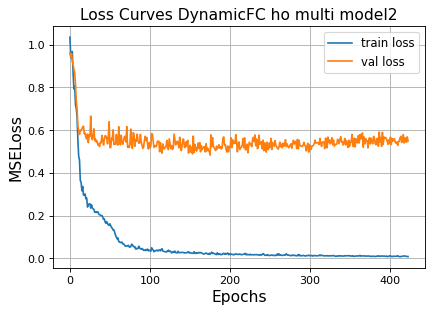

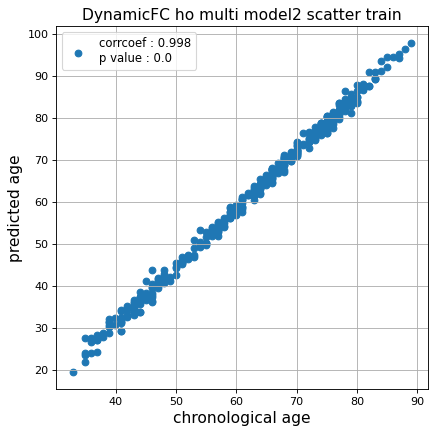

r^2 train data:  0.8526310515343825


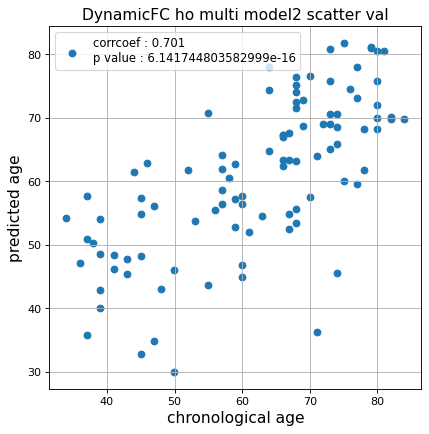

r^2 val data:  0.44860872469901725


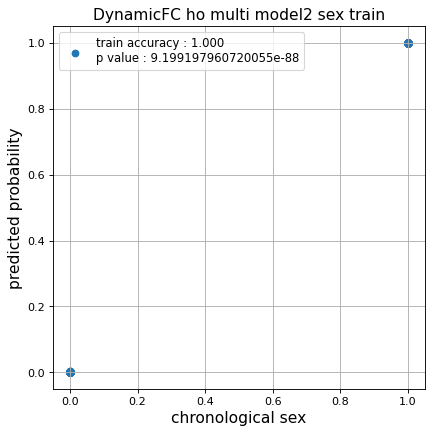

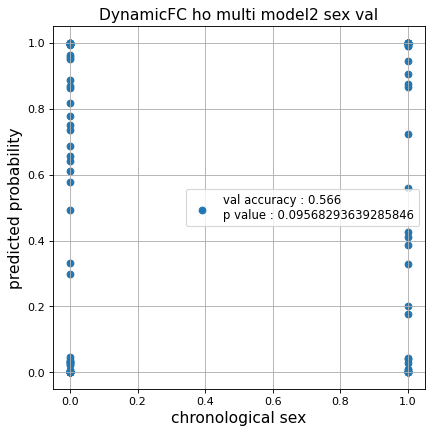

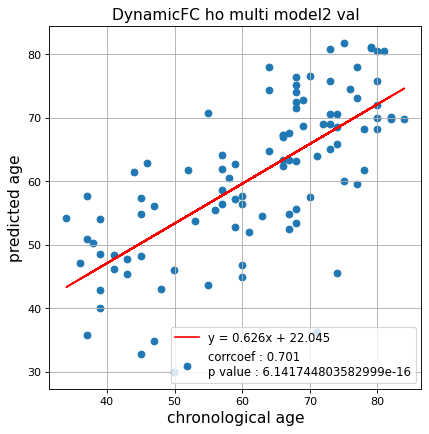

切片: 22.04490990854223
傾き: 0.6262814033040431
Kfold: 2 ::: epoch: 100, loss: 0.03303713910281658, val loss: 0.5757435970008373
Kfold: 2 ::: epoch: 200, loss: 0.018344843545212194, val loss: 0.5881083458662033
Kfold: 2 ::: epoch: 300, loss: 0.01092250612922586, val loss: 0.6371593475341797
Kfold: 2 ::: epoch: 400, loss: 0.008254413636258015, val loss: 0.6515324488282204
early stopping
save_epochs:215
best val loss:0.5779390931129456


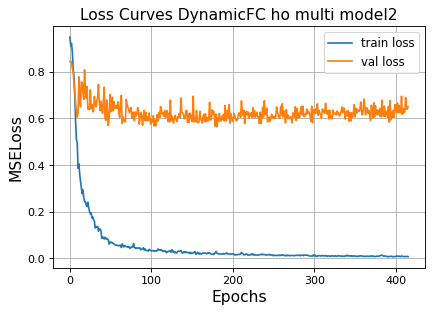

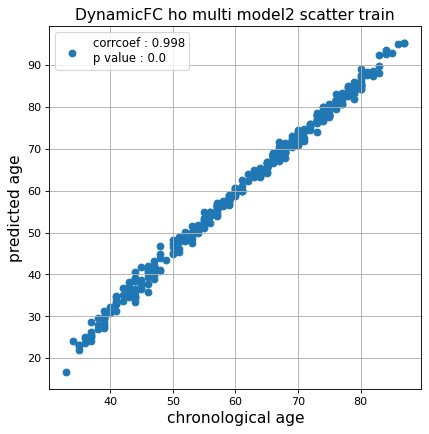

r^2 train data:  0.8506464768795967


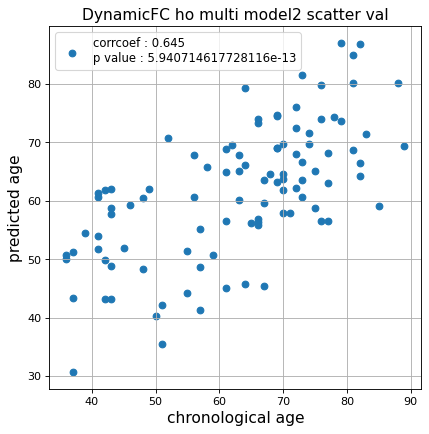

r^2 val data:  0.3819147103696313


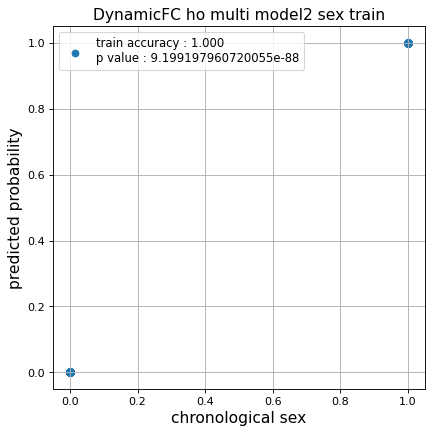

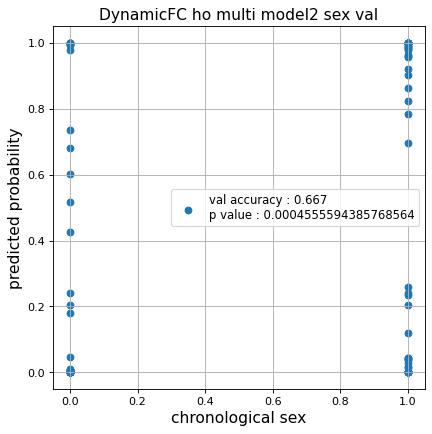

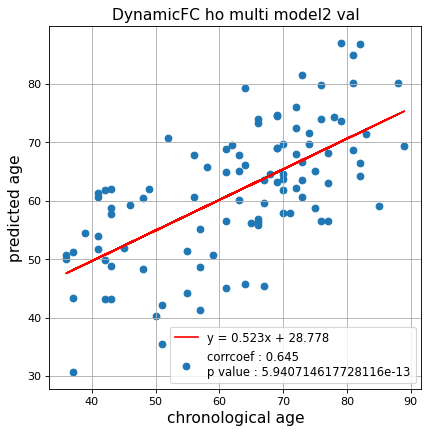

切片: 28.77752887362319
傾き: 0.5232765632171907
Kfold: 3 ::: epoch: 100, loss: 0.041017116978764534, val loss: 0.8088987246155739
Kfold: 3 ::: epoch: 200, loss: 0.016065050346347, val loss: 0.9077112153172493
Kfold: 3 ::: epoch: 300, loss: 0.014878143269855242, val loss: 0.9584834426641464
Kfold: 3 ::: epoch: 400, loss: 0.009572431194381071, val loss: 0.9619067534804344
early stopping
save_epochs:277
best val loss:0.8647375255823135


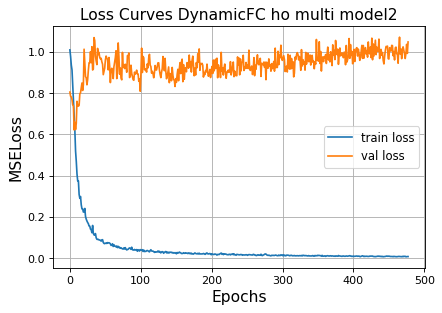

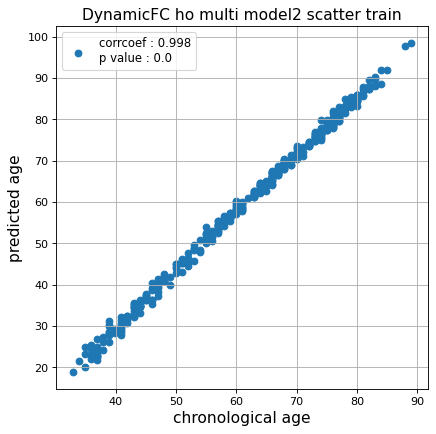

r^2 train data:  0.8200773962789445


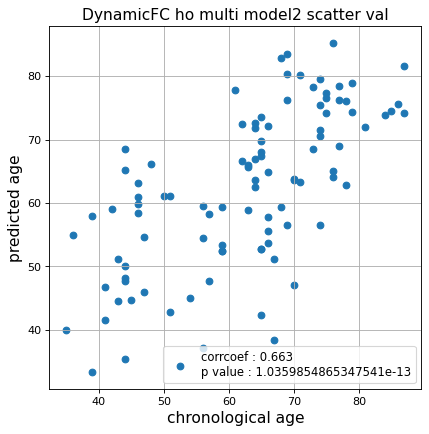

r^2 val data:  0.36065088227831554


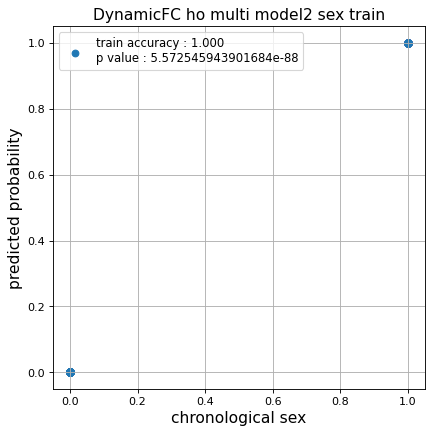

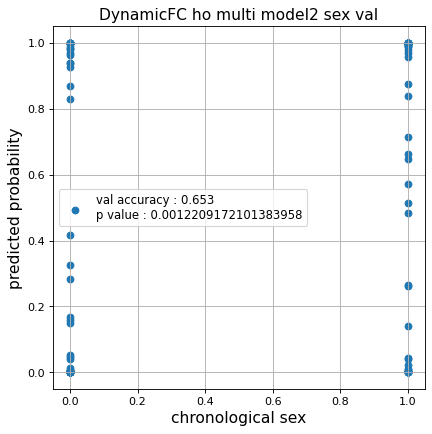

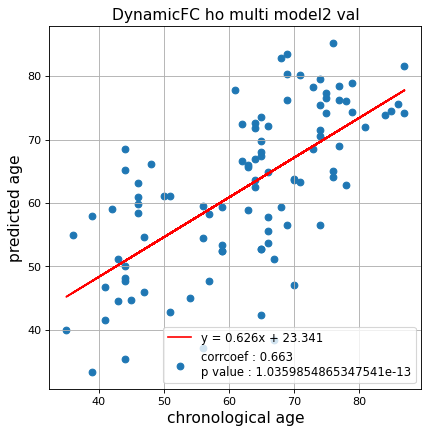

切片: 23.340546738717435
傾き: 0.6255823017989067
Kfold: 4 ::: epoch: 100, loss: 0.04186964006378101, val loss: 0.6423466503620148
Kfold: 4 ::: epoch: 200, loss: 0.016718440151845034, val loss: 0.617824524641037
Kfold: 4 ::: epoch: 300, loss: 0.011446048505604267, val loss: 0.6831748485565186
Kfold: 4 ::: epoch: 400, loss: 0.009011419579529991, val loss: 0.6798494458198547
early stopping
save_epochs:203
best val loss:0.5349851846694946


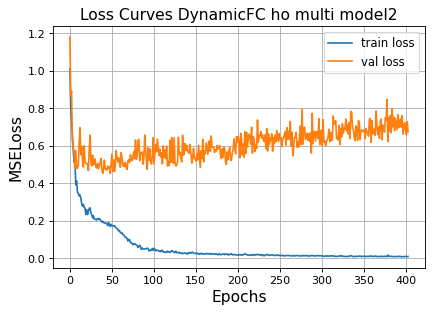

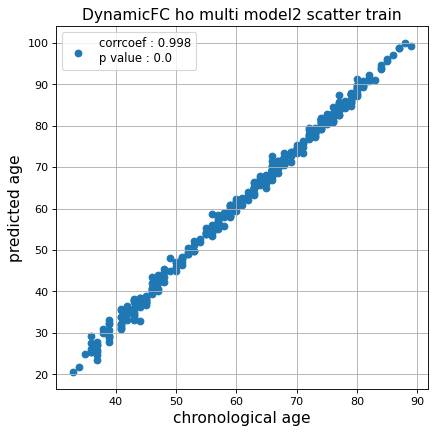

r^2 train data:  0.8085881886921831


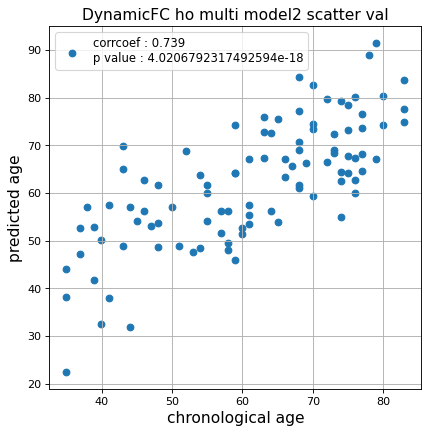

r^2 val data:  0.4974929022246044


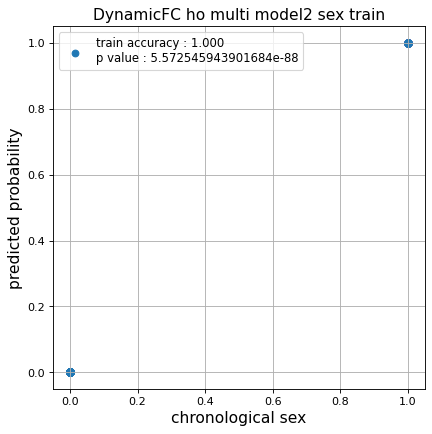

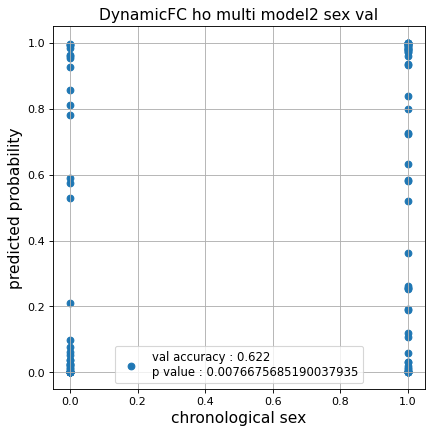

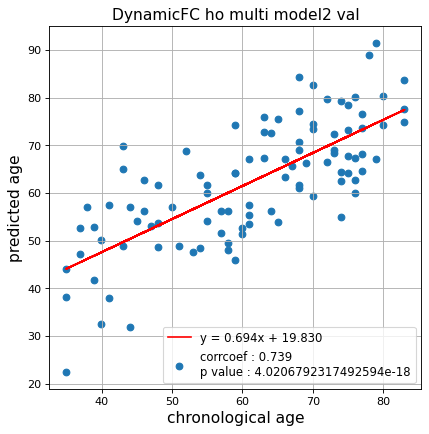

切片: 19.830271289280176
傾き: 0.6943138730629234
Kfold: 5 ::: epoch: 100, loss: 0.05034714750945568, val loss: 1.307628870010376
Kfold: 5 ::: epoch: 200, loss: 0.021885213227226183, val loss: 1.344823643565178
Kfold: 5 ::: epoch: 300, loss: 0.015115547781953445, val loss: 1.392990455031395
Kfold: 5 ::: epoch: 400, loss: 0.011919362363047324, val loss: 1.436399668455124
Kfold: 5 ::: epoch: 500, loss: 0.01691088005183981, val loss: 1.4392634630203247
early stopping
save_epochs:325
best val loss:1.3119241893291473


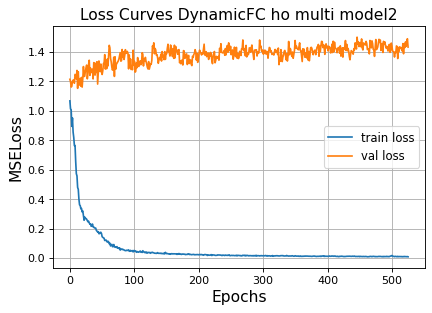

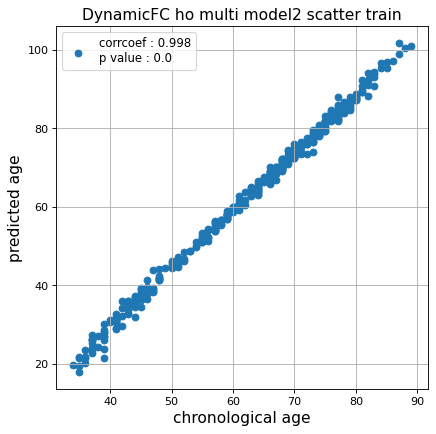

r^2 train data:  0.7675832244536923


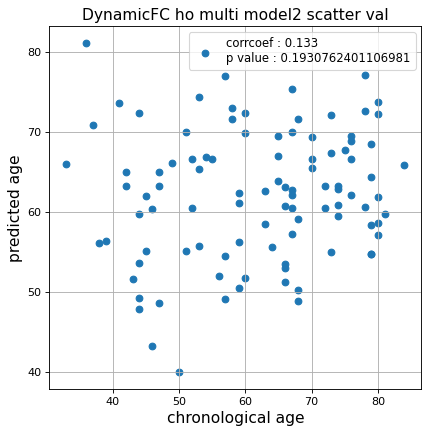

r^2 val data:  -0.2122792309750019


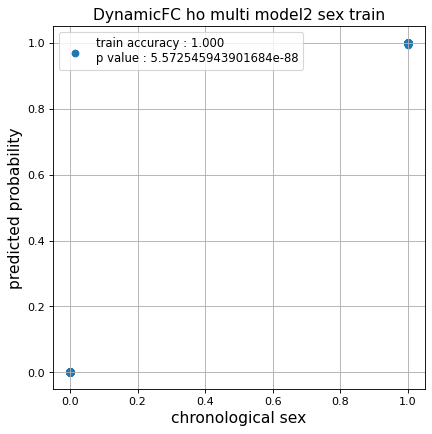

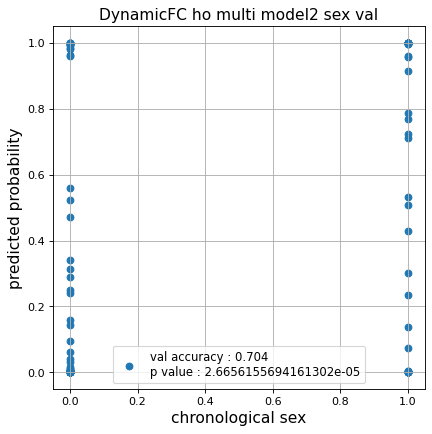

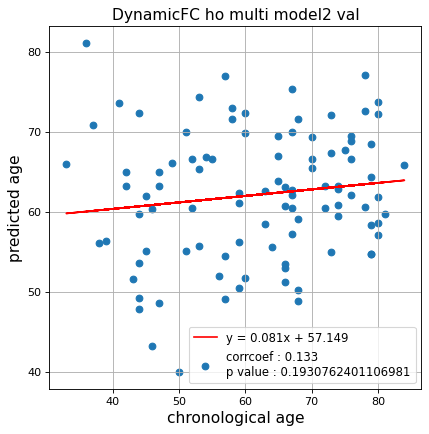

切片: 57.14923254593826
傾き: 0.08105227473181897
CPU times: user 21h 15min 1s, sys: 1min 26s, total: 21h 16min 28s
Wall time: 3h 2min 52s


In [31]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_dynamic_2  = []
test_pred_ho_dynamic_corrected_2  = []
test_label_ho_dynamic_2 = []
test_idx_ho_dynamic_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.5,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC ho multi model2'
                                                          )
    
    test_pred_ho_dynamic_2.append(test_pred)
    test_pred_ho_dynamic_corrected_2.append(test_pred_corrected)
    test_label_ho_dynamic_2.append(test_label)
    test_idx_ho_dynamic_2.append(test_idx)

### データ保存

In [32]:
test_pred_ho_dynamic_1 = np.array(test_pred_ho_dynamic_1, dtype=object)
test_pred_ho_dynamic_corrected_1 = np.array(test_pred_ho_dynamic_corrected_1, dtype=object)

test_pred_ho_dynamic_2 = np.array(test_pred_ho_dynamic_2, dtype=object)
test_pred_ho_dynamic_corrected_2 = np.array(test_pred_ho_dynamic_corrected_2, dtype=object)

In [33]:
np.savez('../02_data_analysis/temp/multi_dynamic_ho_1',
         test_pred_ho_dynamic_1,
         test_pred_ho_dynamic_corrected_1,
         test_label_ho_dynamic_1,
         test_idx_ho_dynamic_1)
np.savez('../02_data_analysis/temp/multi_dynamic_ho_2',
         test_pred_ho_dynamic_2,
         test_pred_ho_dynamic_corrected_2,
         test_label_ho_dynamic_2,
         test_idx_ho_dynamic_2)